In [3]:
import numpy as np  
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import lightgbm as lgb
from sklearn.model_selection import KFold
import warnings
import time
import sys
import datetime
from sklearn.metrics import mean_squared_error
warnings.simplefilter(action="ignore")
pd.set_option("display.max_columns", 500)
plt.style.use("ggplot")
# font = {"family": "meiryo"}
#matplotlib.rc("font" , **font)

In [4]:
# 各種データ読み込み
df_eval = pd.read_csv("../input/test.csv")
df_train = pd.read_csv("../input/sales_train.csv")

In [4]:
df_train.head(3)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day
0,02.01.2013,0,59,22154,999.0,1.0
1,03.01.2013,0,25,2552,899.0,1.0
2,05.01.2013,0,25,2552,899.0,-1.0


In [5]:
df_eval.head(3)

,ID,shop_id,item_id
0,0,5,5037
1,1,5,5320
2,2,5,5233


In [6]:
df_sample_submmit = pd.read_csv("../input/sample_submission.csv")

In [7]:
df_sample_submmit.head(3)

,ID,item_cnt_month
0,0,0.5
1,1,0.5
2,2,0.5


In [5]:
df_items = pd.read_csv("../input/items.csv")

In [6]:
df_item_cagegories = pd.read_csv("../input/item_categories.csv")

In [10]:
df_items.head(3)

,item_name,item_id,item_category_id
0,! ВО ВЛАСТИ НАВАЖДЕНИЯ (ПЛАСТ.) D,0,40
1,!ABBYY FineReader 12 Professional Edition Full...,1,76
2,***В ЛУЧАХ СЛАВЫ (UNV) D,2,40


In [11]:
df_item_cagegories.head(3)

,item_category_name,item_category_id
0,PC - Гарнитуры/Наушники,0
1,Аксессуары - PS2,1
2,Аксессуары - PS3,2


In [7]:
df_shops = pd.read_csv("../input/shops.csv")

In [13]:
df_shops.head(3)

,shop_name,shop_id
0,"!Якутск Орджоникидзе, 56 фран",0
1,"!Якутск ТЦ ""Центральный"" фран",1
2,"Адыгея ТЦ ""Мега""",2


## item_priceとiten_cnt_dayの相関を見るよ

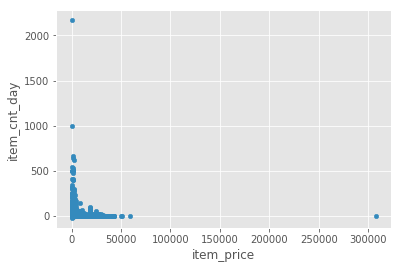

In [8]:
df_train.plot(x="item_price", y="item_cnt_day",  kind="scatter")

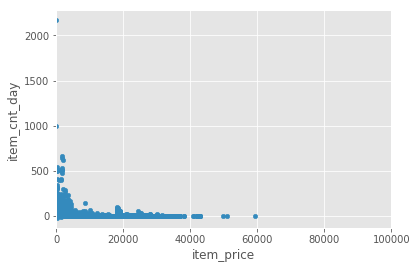

In [15]:
df_train.plot(x="item_price", y="item_cnt_day",  kind="scatter", xlim=(-10, 100000))

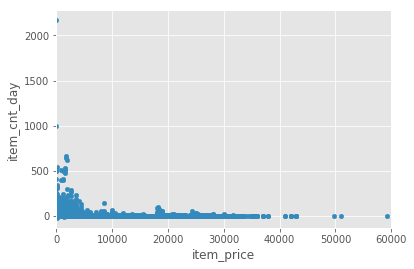

In [16]:
df_train.plot(x="item_price", y="item_cnt_day",  kind="scatter", xlim=(0, 60000))

In [17]:
len(df_train)

2935849

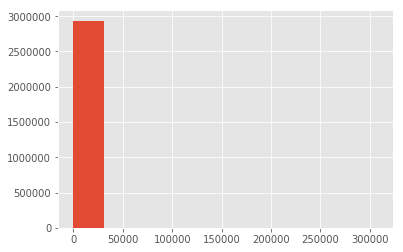

In [18]:
df_train["item_price"].hist()

In [19]:
df_train.columns

Index(['date', 'date_block_num', 'shop_id', 'item_id', 'item_price',
       'item_cnt_day'],
      dtype='object')

In [20]:
df_train.dtypes

date               object
date_block_num      int64
shop_id             int64
item_id             int64
item_price        float64
item_cnt_day      float64
dtype: object

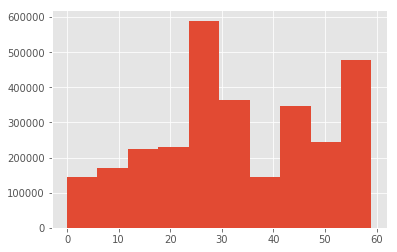

In [21]:
df_train["shop_id"].hist()

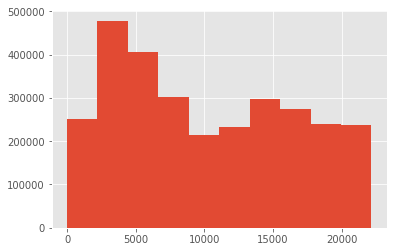

In [22]:
df_train["item_id"].hist()

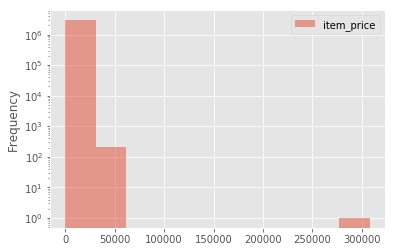

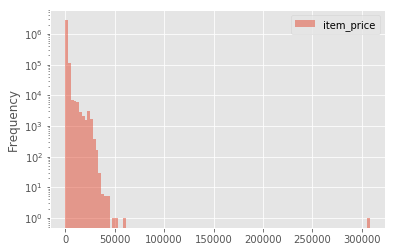

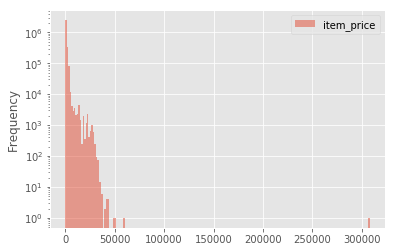

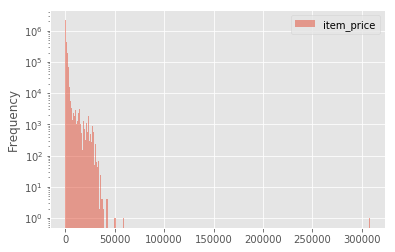

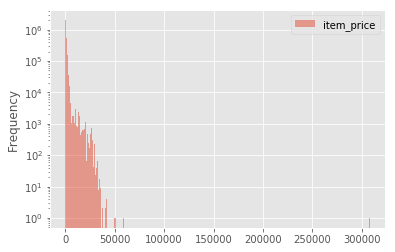

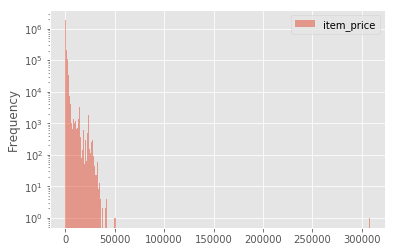

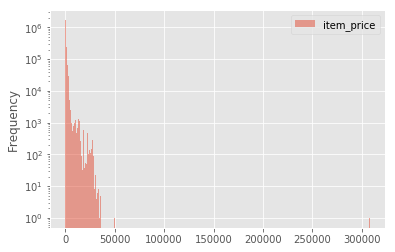

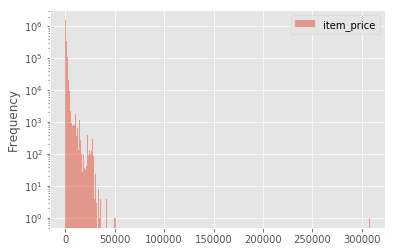

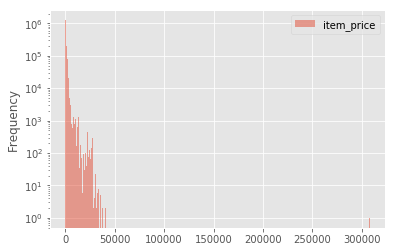

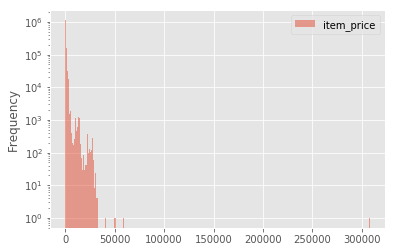

In [23]:
for i in range(10):
    df_train.plot(y="item_price", bins=i*100 + 10, alpha=0.5, logy=True, kind="hist")

In [24]:
sorted(df_train["item_id"].value_counts(), reverse=True)

[31340,
 9408,
 9067,
 7479,
 6853,
 6602,
 6475,
 6320,
 5811,
 5805,
 5681,
 5389,
 5283,
 5122,
 5107,
 5056,
 4976,
 4974,
 4904,
 4853,
 4804,
 4675,
 4615,
 4527,
 4487,
 4380,
 4324,
 4278,
 4274,
 4269,
 4164,
 4106,
 4057,
 4006,
 3942,
 3881,
 3794,
 3763,
 3696,
 3568,
 3533,
 3505,
 3503,
 3464,
 3456,
 3419,
 3396,
 3395,
 3374,
 3334,
 3325,
 3280,
 3269,
 3257,
 3247,
 3160,
 3136,
 3129,
 3122,
 3068,
 3021,
 3012,
 3011,
 2990,
 2980,
 2953,
 2922,
 2880,
 2867,
 2748,
 2724,
 2709,
 2707,
 2683,
 2678,
 2673,
 2645,
 2605,
 2604,
 2587,
 2550,
 2540,
 2512,
 2499,
 2489,
 2475,
 2456,
 2447,
 2430,
 2420,
 2406,
 2392,
 2371,
 2368,
 2362,
 2354,
 2326,
 2325,
 2323,
 2311,
 2299,
 2299,
 2286,
 2279,
 2278,
 2276,
 2273,
 2269,
 2264,
 2258,
 2240,
 2240,
 2207,
 2190,
 2162,
 2110,
 2106,
 2096,
 2095,
 2083,
 2072,
 2061,
 2054,
 2050,
 2046,
 2036,
 2016,
 1998,
 1992,
 1986,
 1985,
 1976,
 1971,
 1964,
 1957,
 1947,
 1935,
 1927,
 1925,
 1911,
 1908,
 1905,
 1884

In [25]:
sorted(df_train["item_price"].value_counts(), reverse=True)

[291352,
 242603,
 218432,
 184044,
 101461,
 95673,
 82784,
 77882,
 77685,
 76493,
 73078,
 57156,
 55448,
 49672,
 48955,
 47857,
 47196,
 43205,
 39080,
 29702,
 28929,
 22381,
 20848,
 18924,
 17645,
 17351,
 17292,
 16713,
 15694,
 14293,
 14209,
 13880,
 12460,
 12102,
 11215,
 11141,
 10732,
 9353,
 8697,
 7958,
 7876,
 7779,
 7725,
 7683,
 7540,
 7468,
 6517,
 5970,
 5869,
 5701,
 5656,
 5648,
 5642,
 5567,
 5401,
 5352,
 5151,
 5146,
 5018,
 4921,
 4782,
 4549,
 4543,
 4351,
 4286,
 4237,
 4237,
 4217,
 4086,
 3825,
 3773,
 3756,
 3681,
 3669,
 3665,
 3646,
 3575,
 3569,
 3538,
 3514,
 3445,
 3195,
 3178,
 3150,
 3084,
 3078,
 3066,
 3026,
 2965,
 2950,
 2932,
 2893,
 2823,
 2744,
 2695,
 2648,
 2615,
 2548,
 2548,
 2548,
 2506,
 2419,
 2393,
 2389,
 2359,
 2337,
 2280,
 2223,
 2218,
 2205,
 2165,
 2131,
 2123,
 2105,
 2063,
 2057,
 2054,
 2022,
 2005,
 1958,
 1948,
 1933,
 1915,
 1878,
 1848,
 1823,
 1776,
 1766,
 1763,
 1754,
 1738,
 1736,
 1692,
 1649,
 1638,
 1626,
 1616,

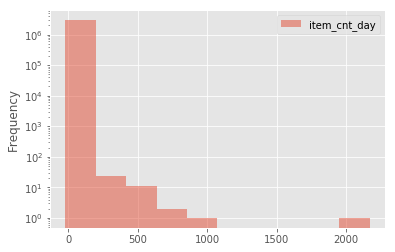

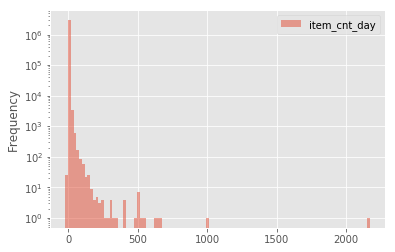

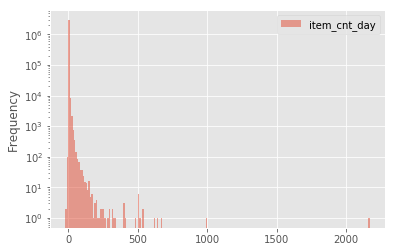

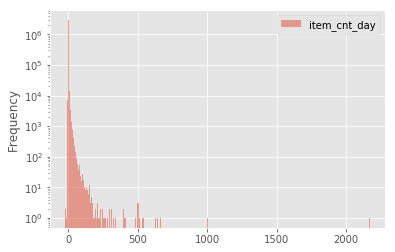

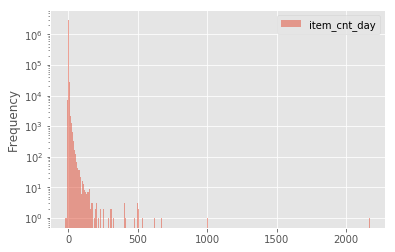

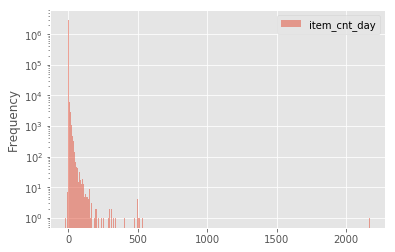

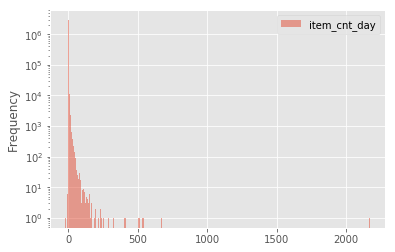

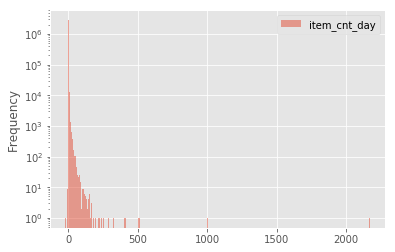

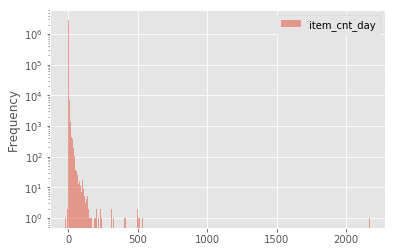

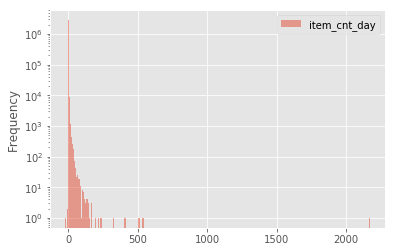

In [26]:
for i in range(10):
    df_train.plot(y="item_cnt_day", bins=i*100 + 10, alpha=0.5, logy=True, kind="hist")

In [ ]:
for _ in df_train.columns:
    for _2 in df_train.columns:
        if _ != _2:
            try:
                df_train.plot(x=_, y= _2,  kind="scatter", xlim=(-10, 100000))
            except:
                continue

In [2]:
df_train.loc[:, ["shop_id", "item_id"]].duplicated()

NameError: name 'df_train' is not defined

In [ ]:
df_train.loc[2, ["shop_id", "item_id"]]

In [ ]:
df_train.loc[(df_train["shop_id"] == 25) & (df_train["item_id"] == 2552)]

In [ ]:
df_train[df_train.loc[:, ["shop_id", "item_id"]].duplicated()]

In [9]:
df_grouped = df_train.groupby(["shop_id", "item_id"]).groups

In [ ]:
print(df_grouped)

In [ ]:
for group_name, group in df_grouped:
    print(f"group_name:{group_name}, group: {group}")

In [10]:
df_grouped.keys()

dict_keys([(0, 30), (0, 31), (0, 32), (0, 33), (0, 35), (0, 36), (0, 40), (0, 42), (0, 43), (0, 49), (0, 51), (0, 57), (0, 59), (0, 61), (0, 75), (0, 85), (0, 88), (0, 95), (0, 96), (0, 97), (0, 98), (0, 111), (0, 115), (0, 136), (0, 149), (0, 151), (0, 152), (0, 153), (0, 198), (0, 199), (0, 210), (0, 228), (0, 282), (0, 306), (0, 308), (0, 351), (0, 407), (0, 421), (0, 438), (0, 471), (0, 479), (0, 482), (0, 484), (0, 491), (0, 496), (0, 498), (0, 534), (0, 545), (0, 556), (0, 560), (0, 582), (0, 642), (0, 651), (0, 657), (0, 668), (0, 677), (0, 687), (0, 699), (0, 700), (0, 715), (0, 783), (0, 785), (0, 810), (0, 814), (0, 816), (0, 825), (0, 831), (0, 835), (0, 839), (0, 944), (0, 947), (0, 952), (0, 963), (0, 965), (0, 970), (0, 971), (0, 987), (0, 989), (0, 990), (0, 991), (0, 992), (0, 993), (0, 996), (0, 997), (0, 998), (0, 999), (0, 1000), (0, 1001), (0, 1002), (0, 1003), (0, 1004), (0, 1005), (0, 1013), (0, 1015), (0, 1016), (0, 1017), (0, 1018), (0, 1022), (0, 1025), (0, 102

In [12]:
df_grouped = df_train.groupby(["shop_id", "item_id"])

In [13]:
df_grouped.size()

shop_id  item_id
0        30           9
         31           7
         32          11
         33           6
         35          12
         36           1
         40           1
         42           1
         43           1
         49           2
         51           4
         57           1
         59           1
         61           1
         75           1
         85           1
         88           1
         95           1
         96           1
         97           1
         98          18
         111          2
         115          1
         136          1
         149          3
         151          1
         152          1
         153          3
         198          1
         199          1
                   ... 
59       22079        1
         22087      133
         22088      133
         22091       29
         22092       52
         22100        2
         22102        4
         22104        1
         22105        3
         22106        1

In [14]:
type(df_grouped)

pandas.core.groupby.groupby.DataFrameGroupBy

In [ ]:
for name, group in df_grouped:
    print(name)
    print(group)

(0, 30)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
173344  21.02.2013               1        0       30       265.0           2.0
173345  20.02.2013               1        0       30       265.0           2.0
173346  18.02.2013               1        0       30       265.0           4.0
173347  17.02.2013               1        0       30       265.0           4.0
173348  16.02.2013               1        0       30       265.0           9.0
173349  15.02.2013               1        0       30       265.0           2.0
173361  22.02.2013               1        0       30       265.0           2.0
173402  23.02.2013               1        0       30       265.0           3.0
173441  26.02.2013               1        0       30       265.0           3.0
(0, 31)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
173403  15.02.2013               1        0       31       434.0           3.0
173454  26.02.2013               1  

40128  12.01.2013               0        0      952       321.0           1.0
(0, 963)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40129   04.01.2013               0        0      963        36.0           1.0
40130   06.01.2013               0        0      963        36.0           2.0
40131   07.01.2013               0        0      963        36.0           1.0
40132   12.01.2013               0        0      963        36.0           1.0
40133   13.01.2013               0        0      963        36.0           1.0
40134   17.01.2013               0        0      963        36.0           1.0
175102  24.02.2013               1        0      963        36.0           1.0
175104  01.02.2013               1        0      963        36.0           1.0
(0, 965)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40135  31.01.2013               0        0      965       190.0           1.0
(0, 970)
              date  date_blo

175224  12.02.2013               1        0     1235       173.0           1.0
(0, 1243)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39957   30.01.2013               0        0     1243       263.0           1.0
175225  20.02.2013               1        0     1243       263.0           1.0
(0, 1247)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39958   03.01.2013               0        0     1247       179.0           1.0
39959   07.01.2013               0        0     1247       179.0           1.0
39960   19.01.2013               0        0     1247       179.0           1.0
175243  15.02.2013               1        0     1247       179.0           1.0
(0, 1249)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39961   03.01.2013               0        0     1249       170.0           1.0
39962   08.01.2013               0        0     1249       170.0           1.0
39964   15.01.2013    

(0, 1780)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
175018  16.02.2013               1        0     1780        55.0           1.0
(0, 1782)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40172  14.01.2013               0        0     1782       483.0           1.0
40346  04.01.2013               0        0     1782       483.0           1.0
(0, 1790)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40319   03.01.2013               0        0     1790      1399.0           1.0
40320   10.01.2013               0        0     1790      1399.0           1.0
175000  17.02.2013               1        0     1790      1399.0           1.0
175001  10.02.2013               1        0     1790      1399.0           1.0
175002  08.02.2013               1        0     1790      1399.0           1.0
(0, 1791)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40321   14.01.2

175453  04.02.2013               1        0     2258       210.0           1.0
(0, 2281)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40199   05.01.2013               0        0     2281       777.0           2.0
40228   06.01.2013               0        0     2281       777.0           1.0
40229   12.01.2013               0        0     2281       777.0           1.0
40230   20.01.2013               0        0     2281       777.0           1.0
40260   25.01.2013               0        0     2281       777.0           2.0
40261   26.01.2013               0        0     2281       777.0           2.0
175448  22.02.2013               1        0     2281       777.0           1.0
175449  21.02.2013               1        0     2281       777.0           2.0
175450  20.02.2013               1        0     2281       777.0           2.0
175451  16.02.2013               1        0     2281       777.0           1.0
175452  13.02.2013               1        

175323  05.02.2013               1        0     2822       246.0           1.0
(0, 2827)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39585  26.01.2013               0        0     2827       368.0           1.0
39586  31.01.2013               0        0     2827       368.0           1.0
39610  24.01.2013               0        0     2827       368.0           1.0
39611  15.01.2013               0        0     2827       368.0           1.0
(0, 2833)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39587   07.01.2013               0        0     2833       368.0           1.0
39588   20.01.2013               0        0     2833       368.0           1.0
39589   25.01.2013               0        0     2833       368.0           1.0
39590   26.01.2013               0        0     2833       368.0           1.0
175321  24.02.2013               1        0     2833       368.0           1.0
175322  22.02.2013               1   

             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39864  09.01.2013               0        0     3279       180.0           1.0
(0, 3280)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
174580  27.02.2013               1        0     3280       190.0           1.0
(0, 3281)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
174579  18.02.2013               1        0     3281       190.0           1.0
(0, 3286)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39865   19.01.2013               0        0     3286       190.0           2.0
39866   20.01.2013               0        0     3286       190.0           1.0
39867   27.01.2013               0        0     3286       190.0           1.0
174578  27.02.2013               1        0     3286       190.0           1.0
(0, 3289)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
174577  16.02.

174350  01.02.2013               1        0     3705      1228.0           1.0
(0, 3718)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39741   04.01.2013               0        0     3718       206.0           1.0
39742   08.01.2013               0        0     3718       206.0           1.0
39743   13.01.2013               0        0     3718       206.0           1.0
39744   30.01.2013               0        0     3718       206.0           1.0
174300  23.02.2013               1        0     3718       206.0           1.0
174301  20.02.2013               1        0     3718       206.0           1.0
174303  19.02.2013               1        0     3718       206.0           1.0
174324  18.02.2013               1        0     3718       206.0           1.0
174325  01.02.2013               1        0     3718       206.0           1.0
174343  16.02.2013               1        0     3718       206.0           1.0
(0, 3719)
              date  date_block_n

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
174779  22.02.2013               1        0     4245       734.0           1.0
174780  01.02.2013               1        0     4245      1040.0           1.0
(0, 4248)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41005   17.01.2013               0        0     4248      1469.0           1.0
41006   18.01.2013               0        0     4248      1469.0           2.0
41007   19.01.2013               0        0     4248      1469.0           2.0
41008   30.01.2013               0        0     4248      1469.0           2.0
174770  24.02.2013               1        0     4248      1469.0           1.0
174771  23.02.2013               1        0     4248      1469.0           1.0
174772  21.02.2013               1        0     4248      1469.0           2.0
174774  09.02.2013               1        0     4248      1469.0           1.0
174775  05.02.2013               1        

41257  10.01.2013               0        0     4688      1004.0           1.0
(0, 4690)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41255  30.01.2013               0        0     4690       469.0           1.0
(0, 4691)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41230  08.01.2013               0        0     4691       469.0           2.0
(0, 4694)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41232   21.01.2013               0        0     4694       130.0           1.0
41233   26.01.2013               0        0     4694       130.0           1.0
174751  11.02.2013               1        0     4694       127.0           1.0
(0, 4695)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41234  25.01.2013               0        0     4695       130.0           1.0
(0, 4697)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
174750  1

181557  17.02.2013               1        0     5361       328.0           1.0
(0, 5363)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41308  03.01.2013               0        0     5363      1710.0           1.0
(0, 5364)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181538  16.02.2013               1        0     5364      2050.0           1.0
(0, 5371)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181517  08.02.2013               1        0     5371      6621.0           2.0
(0, 5374)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181515  06.02.2013               1        0     5374      8058.0           1.0
(0, 5378)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41228  23.01.2013               0        0     5378      2266.0           1.0
41229  21.01.2013               0        0     5378      2266.0           1.0
41309  

181638  22.02.2013               1        0     5862       869.0           1.0
(0, 5863)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41135   22.01.2013               0        0     5863       869.0           1.0
181639  16.02.2013               1        0     5863       869.0           1.0
181656  28.02.2013               1        0     5863       869.0           1.0
(0, 5865)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41136   20.01.2013               0        0     5865      1214.0           1.0
181655  09.02.2013               1        0     5865      1214.0           1.0
(0, 5867)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41137  04.01.2013               0        0     5867      1260.0           1.0
(0, 5868)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181653  22.02.2013               1        0     5868       984.0           1.0
181654  03.02.

181495  09.02.2013               1        0     6406       216.0           2.0
(0, 6412)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40584  14.01.2013               0        0     6412       663.0           1.0
(0, 6425)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40586  23.01.2013               0        0     6425       457.0           1.0
(0, 6432)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181492  12.02.2013               1        0     6432       159.0           1.0
(0, 6448)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181491  07.02.2013               1        0     6448      1166.0           1.0
(0, 6451)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40588  11.01.2013               0        0     6451      1399.0           1.0
(0, 6452)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day

181935  28.02.2013               1        0     6761       336.0           1.0
(0, 6765)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40767   05.01.2013               0        0     6765       311.0           1.0
40768   19.01.2013               0        0     6765       311.0           1.0
181933  23.02.2013               1        0     6765       311.0           1.0
181934  08.02.2013               1        0     6765       311.0           1.0
(0, 6771)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181932  23.02.2013               1        0     6771       985.0           1.0
(0, 6777)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40770   05.01.2013               0        0     6777       389.0           1.0
40771   28.01.2013               0        0     6777       177.0           1.0
181930  08.02.2013               1        0     6777       177.0           1.0
181931  03.02.2013    

181755  20.02.2013               1        0     7511       173.0           1.0
(0, 7512)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40644   14.01.2013               0        0     7512       175.0           1.0
40645   19.01.2013               0        0     7512       175.0           1.0
181754  15.02.2013               1        0     7512       173.0           1.0
(0, 7513)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40646   14.01.2013               0        0     7513       173.0           1.0
40647   19.01.2013               0        0     7513       173.0           1.0
40648   30.01.2013               0        0     7513       173.0           1.0
181753  15.02.2013               1        0     7513       173.0           1.0
(0, 7516)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
40649   26.01.2013               0        0     7516       173.0           1.0
181752  21.02.2013    

38277  16.01.2013               0        0     8092        70.0           1.0
(0, 8093)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38278   08.01.2013               0        0     8093       958.0           1.0
38279   21.01.2013               0        0     8093       958.0           2.0
180955  17.02.2013               1        0     8093       958.0           1.0
(0, 8094)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38280   20.01.2013               0        0     8094       788.0           1.0
180944  27.02.2013               1        0     8094       788.0           1.0
180945  07.02.2013               1        0     8094       788.0           1.0
180947  02.02.2013               1        0     8094       788.0           1.0
(0, 8095)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
180942  09.02.2013               1        0     8095       312.0           1.0
180943  01.02.2013     

180710  02.02.2013               1        0     8628        77.0           1.0
(0, 8630)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38067   06.01.2013               0        0     8630        77.0           1.0
180709  01.02.2013               1        0     8630        77.0           1.0
(0, 8631)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38068  11.01.2013               0        0     8631        77.0           1.0
(0, 8634)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38069   26.01.2013               0        0     8634        77.0           1.0
180708  21.02.2013               1        0     8634        77.0           1.0
(0, 8640)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38070  28.01.2013               0        0     8640        27.0           1.0
(0, 8643)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38071  

180756  06.02.2013               1        0     9172       235.0           1.0
(0, 9174)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
180716  21.02.2013               1        0     9174       186.0           1.0
(0, 9181)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38082   04.01.2013               0        0     9181       158.0           1.0
38084   06.01.2013               0        0     9181       158.0           1.0
38113   08.01.2013               0        0     9181       158.0           1.0
38114   21.01.2013               0        0     9181       158.0           1.0
38115   28.01.2013               0        0     9181       158.0           2.0
180729  20.02.2013               1        0     9181       158.0           1.0
180730  19.02.2013               1        0     9181       158.0           1.0
180731  05.02.2013               1        0     9181       158.0           1.0
180732  02.02.2013              

38470  27.01.2013               0        0     9676       123.0           1.0
(0, 9678)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181237  14.02.2013               1        0     9678       322.0           1.0
(0, 9687)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38471  18.01.2013               0        0     9687       426.0           1.0
(0, 9690)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38472  20.01.2013               0        0     9690       123.0           1.0
(0, 9693)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38473  29.01.2013               0        0     9693       322.0           1.0
(0, 9696)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38474  05.01.2013               0        0     9696       331.0           1.0
38475  11.01.2013               0        0     9696       331.0           1.0
(0, 9698)
  

(0, 10063)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38391  09.01.2013               0        0    10063        69.0           1.0
38393  22.01.2013               0        0    10063        69.0           1.0
38406  25.01.2013               0        0    10063        69.0           1.0
(0, 10064)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38394   17.01.2013               0        0    10064       190.0           1.0
38395   26.01.2013               0        0    10064       190.0           1.0
181304  21.02.2013               1        0    10064       190.0           1.0
181305  09.02.2013               1        0    10064       190.0           1.0
(0, 10080)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38396  13.01.2013               0        0    10080       265.0           1.0
(0, 10081)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38397  11.01.20

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181281  06.02.2013               1        0    10638       648.0           1.0
(0, 10641)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181280  17.02.2013               1        0    10641       412.0           1.0
(0, 10642)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181279  15.02.2013               1        0    10642       621.0           1.0
(0, 10650)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181178  10.02.2013               1        0    10650       540.0           1.0
(0, 10651)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181177  23.02.2013               1        0    10651       480.0           1.0
(0, 10657)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181176  20.02.2013               1        0    10657       228.0           1

181138  11.02.2013               1        0    11025       231.0           1.0
(0, 11027)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37631   18.01.2013               0        0    11027       263.0           1.0
181156  13.02.2013               1        0    11027       263.0           1.0
(0, 11029)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
181137  23.02.2013               1        0    11029      1050.0           1.0
(0, 11030)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37632   21.01.2013               0        0    11030        77.0           1.0
181114  19.02.2013               1        0    11030        77.0           1.0
181116  04.02.2013               1        0    11030        77.0           1.0
(0, 11031)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37633   04.01.2013               0        0    11031      1536.0           1.0
181113  

182840  08.02.2013               1        0    11441        75.0           1.0
(0, 11447)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37969   30.01.2013               0        0    11447        77.0           1.0
182821  24.02.2013               1        0    11447        77.0           1.0
(0, 11456)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37970  19.01.2013               0        0    11456        77.0           1.0
(0, 11464)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37971   20.01.2013               0        0    11464        76.0           1.0
37972   31.01.2013               0        0    11464        76.0           1.0
182800  07.02.2013               1        0    11464        76.0           1.0
(0, 11468)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37973  12.01.2013               0        0    11468        69.0           1.0
(0, 11471)
 

38045  15.01.2013               0        0    11757        63.0           1.0
(0, 11758)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182926  17.02.2013               1        0    11758        76.0           1.0
(0, 11776)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38046   08.01.2013               0        0    11776       260.0           2.0
38047   25.01.2013               0        0    11776       260.0           1.0
182924  17.02.2013               1        0    11776       260.0           1.0
182925  08.02.2013               1        0    11776       260.0           1.0
(0, 11777)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38048   03.01.2013               0        0    11777       325.0           1.0
38049   21.01.2013               0        0    11777       325.0           1.0
182923  16.02.2013               1        0    11777       325.0           1.0
(0, 11778)
         

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37917   05.01.2013               0        0    12286        40.0           1.0
37918   17.01.2013               0        0    12286        40.0           1.0
37919   23.01.2013               0        0    12286        40.0           1.0
182631  28.02.2013               1        0    12286        40.0           1.0
182639  24.02.2013               1        0    12286        40.0           1.0
(0, 12297)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37920  22.01.2013               0        0    12297       574.0           1.0
(0, 12313)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37925  10.01.2013               0        0    12313       203.0           1.0
37926  12.01.2013               0        0    12313       203.0           2.0
37927  18.01.2013               0        0    12313       203.0           1.0
(0, 12318)
             date  date_b

(0, 12651)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
183144  15.02.2013               1        0    12651       231.0           1.0
183145  09.02.2013               1        0    12651       231.0           1.0
183146  08.02.2013               1        0    12651       231.0           1.0
183147  07.02.2013               1        0    12651       231.0           1.0
183148  05.02.2013               1        0    12651       231.0           1.0
183149  03.02.2013               1        0    12651       231.0           4.0
183150  02.02.2013               1        0    12651       231.0           1.0
183151  17.02.2013               1        0    12651       231.0           1.0
183152  01.02.2013               1        0    12651       231.0           1.0
183162  19.02.2013               1        0    12651       231.0           1.0
183163  24.02.2013               1        0    12651       231.0           2.0
183171  23.02.2013               1       

(0, 12965)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182946  12.02.2013               1        0    12965       110.0           1.0
(0, 12967)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182945  12.02.2013               1        0    12967       110.0           1.0
(0, 12970)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39364  09.01.2013               0        0    12970       110.0           1.0
(0, 12972)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39365   03.01.2013               0        0    12972       110.0           1.0
182963  27.02.2013               1        0    12972       110.0           1.0
182971  12.02.2013               1        0    12972       110.0           1.0
(0, 12974)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182979  10.02.2013               1        0    12974       173.0           1.0

183250  05.02.2013               1        0    13484     13678.0           1.0
(0, 13487)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39021  12.01.2013               0        0    13487     13679.0           1.0
39022  13.01.2013               0        0    13487     13679.0           1.0
(0, 13490)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39024   05.01.2013               0        0    13490     13679.0           1.0
39053   06.01.2013               0        0    13490     13679.0           1.0
39054   08.01.2013               0        0    13490     13679.0           1.0
39055   29.01.2013               0        0    13490     13679.0           1.0
183221  23.02.2013               1        0    13490     13679.0           1.0
183222  21.02.2013               1        0    13490     13679.0           1.0
183223  16.02.2013               1        0    13490     13679.0           1.0
183244  13.02.2013               

39346  31.01.2013               0        0    14043        58.0           1.0
(0, 14050)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39334   07.01.2013               0        0    14050       217.0           1.0
39335   08.01.2013               0        0    14050       231.0           1.0
39336   15.01.2013               0        0    14050       231.0           1.0
39337   20.01.2013               0        0    14050       231.0           1.0
182213  23.02.2013               1        0    14050       231.0           1.0
182214  11.02.2013               1        0    14050       231.0           1.0
(0, 14063)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39338  13.01.2013               0        0    14063       346.0           1.0
(0, 14066)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
39339   13.01.2013               0        0    14066        69.0           1.0
39340   22.01.2013    

182030  08.02.2013               1        0    14544        77.0           1.0
(0, 14548)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38578  23.01.2013               0        0    14548       139.0           1.0
(0, 14549)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38579   17.01.2013               0        0    14549        79.0           1.0
38580   18.01.2013               0        0    14549        79.0           1.0
38581   20.01.2013               0        0    14549        79.0           1.0
182026  23.02.2013               1        0    14549        79.0           1.0
182027  09.02.2013               1        0    14549        79.0           1.0
182028  06.02.2013               1        0    14549        79.0           1.0
(0, 14550)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182025  25.02.2013               1        0    14550        70.0           1.0
(0, 14561)
          

182520  28.02.2013               1        0    15358        27.0           1.0
(0, 15369)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38933  24.01.2013               0        0    15369       245.0           1.0
(0, 15377)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38907  11.01.2013               0        0    15377       410.0           1.0
38908  09.01.2013               0        0    15377       410.0           1.0
38934  05.01.2013               0        0    15377       410.0           1.0
(0, 15378)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38906  19.01.2013               0        0    15378       590.0           1.0
(0, 15435)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182529  02.02.2013               1        0    15435       305.0           1.0
(0, 15444)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38905

182474  04.02.2013               1        0    16071       138.0           1.0
(0, 16092)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38972  03.01.2013               0        0    16092       138.0           2.0
(0, 16106)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182478  11.02.2013               1        0    16106       361.0           1.0
(0, 16108)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
38973  08.01.2013               0        0    16108       138.0           1.0
38974  10.01.2013               0        0    16108       138.0           1.0
(0, 16122)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182470  18.02.2013               1        0    16122       467.0           1.0
(0, 16125)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182468  25.02.2013               1        0    16125       374.0           1.0
(0

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182442  28.02.2013               1        0    16612       335.0           1.0
(0, 16620)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43864  30.01.2013               0        0    16620       312.0           1.0
(0, 16623)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
182384  24.02.2013               1        0    16623       265.0           3.0
182385  23.02.2013               1        0    16623       265.0           2.0
182386  22.02.2013               1        0    16623       265.0           1.0
182387  21.02.2013               1        0    16623       265.0           1.0
182388  18.02.2013               1        0    16623       265.0           1.0
182390  17.02.2013               1        0    16623       265.0           1.0
182391  14.02.2013               1        0    16623       265.0           4.0
182392  13.02.2013              

             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43767  09.01.2013               0        0    17407        68.0           1.0
43768  19.01.2013               0        0    17407        68.0           1.0
(0, 17411)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179042  10.02.2013               1        0    17411        95.0           1.0
(0, 17418)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43769   17.01.2013               0        0    17418        76.0           1.0
179034  04.02.2013               1        0    17418        76.0           1.0
179050  21.02.2013               1        0    17418        76.0           1.0
(0, 17422)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43770   30.01.2013               0        0    17422        77.0           1.0
179049  20.02.2013               1        0    17422        77.0           1.0
(0, 17424)
           

(0, 17867)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
178788  03.02.2013               1        0    17867       312.0           1.0
(0, 17876)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
178786  26.02.2013               1        0    17876        76.0           1.0
178787  02.02.2013               1        0    17876        76.0           1.0
(0, 17895)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
178780  27.02.2013               1        0    17895       242.0           1.0
178781  26.02.2013               1        0    17895       242.0           1.0
178783  24.02.2013               1        0    17895       242.0           1.0
178784  22.02.2013               1        0    17895       242.0           1.0
178785  21.02.2013               1        0    17895       242.0           2.0
178791  23.02.2013               1        0    17895       242.0           2.0
(0, 17909)
        

(0, 18449)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179299  07.02.2013               1        0    18449        97.0           1.0
(0, 18450)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43934  20.01.2013               0        0    18450       110.0           1.0
(0, 18460)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179298  11.02.2013               1        0    18460       161.0           1.0
(0, 18462)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43935  12.01.2013               0        0    18462       110.0           1.0
(0, 18464)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179297  01.02.2013               1        0    18464       110.0           1.0
(0, 18465)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179296  25.02.2013               1        0    18465       110.0     

(0, 18798)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43376  21.01.2013               0        0    18798        77.0           1.0
(0, 18799)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179338  25.02.2013               1        0    18799        77.0           1.0
179339  01.02.2013               1        0    18799        77.0           1.0
(0, 18800)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43377   03.01.2013               0        0    18800       200.0           1.0
43378   27.01.2013               0        0    18800       200.0           1.0
179337  14.02.2013               1        0    18800       200.0           1.0
(0, 18802)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179335  26.02.2013               1        0    18802        95.0           1.0
179336  01.02.2013               1        0    18802        95.0           1.0
(0, 18805)

43949  12.01.2013               0        0    19315       170.0           1.0
(0, 19318)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179267  26.02.2013               1        0    19318       125.0           1.0
(0, 19321)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44025   30.01.2013               0        0    19321       230.0           1.0
179266  08.02.2013               1        0    19321       230.0           1.0
(0, 19346)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179257  22.02.2013               1        0    19346       227.0           1.0
(0, 19350)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44043  21.01.2013               0        0    19350       311.0           1.0
(0, 19360)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179392  15.02.2013               1        0    19360       702.0           1.0


(0, 19848)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43400   14.01.2013               0        0    19848        69.0           1.0
178444  06.02.2013               1        0    19848        69.0           1.0
(0, 19860)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43460   10.01.2013               0        0    19860        77.0           1.0
43461   25.01.2013               0        0    19860        77.0           1.0
43608   28.01.2013               0        0    19860        77.0           1.0
43635   17.01.2013               0        0    19860        77.0           1.0
178443  17.02.2013               1        0    19860        77.0           1.0
(0, 19863)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43609   11.01.2013               0        0    19863      1158.0           1.0
178450  02.02.2013               1        0    19863       368.0           1.0
(0, 19873)
        

178169  03.02.2013               1        0    20250       200.0           1.0
(0, 20251)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43642   05.01.2013               0        0    20251       200.0           1.0
43643   19.01.2013               0        0    20251       200.0           1.0
43644   21.01.2013               0        0    20251       200.0           1.0
178163  23.02.2013               1        0    20251       200.0           1.0
178164  22.02.2013               1        0    20251       200.0           1.0
178165  15.02.2013               1        0    20251       200.0           1.0
178166  10.02.2013               1        0    20251       200.0           1.0
178167  07.02.2013               1        0    20251       200.0           1.0
(0, 20255)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43645   11.01.2013               0        0    20255        77.0           1.0
178170  11.02.2013            

178618  08.02.2013               1        0    21789        27.0           1.0
(0, 21808)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43540   08.01.2013               0        0    21808       231.0           3.0
43541   26.01.2013               0        0    21808       231.0           1.0
43542   27.01.2013               0        0    21808       231.0           1.0
43543   30.01.2013               0        0    21808       231.0           1.0
178648  08.02.2013               1        0    21808       231.0           1.0
(0, 21814)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43544  12.01.2013               0        0    21814        93.0           1.0
(0, 21824)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44165   07.01.2013               0        0    21824        73.0           1.0
44634   11.01.2013               0        0    21824        73.0           1.0
178644  02.02.2013   

44638  31.01.2013               0        1      953        75.0           1.0
(1, 963)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44639   03.01.2013               0        1      963        36.0           1.0
44640   06.01.2013               0        1      963        36.0           1.0
44641   15.01.2013               0        1      963        36.0           1.0
44642   17.01.2013               0        1      963        36.0           1.0
44643   19.01.2013               0        1      963        36.0           2.0
178482  23.02.2013               1        1      963        36.0           1.0
178483  01.02.2013               1        1      963        36.0           1.0
178490  09.02.2013               1        1      963        36.0           1.0
(1, 965)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
178480  08.02.2013               1        1      965       190.0           1.0
(1, 977)
              date  date_b

180354  08.02.2013               1        1     2198       161.0           1.0
(1, 2218)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
180355  14.02.2013               1        1     2218      2129.0           1.0
(1, 2219)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
45049  18.01.2013               0        1     2219      4498.0           1.0
(1, 2252)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
45093   11.01.2013               0        1     2252       368.0           1.0
45094   29.01.2013               0        1     2252       368.0           1.0
180346  14.02.2013               1        1     2252       368.0           1.0
(1, 2253)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
180353  07.02.2013               1        1     2253      1680.0           1.0
(1, 2254)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
45095

180073  08.02.2013               1        1     2929       137.0           1.0
(1, 2931)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44885   05.01.2013               0        1     2931        63.0           1.0
44886   06.01.2013               0        1     2931        63.0           1.0
44887   08.01.2013               0        1     2931        63.0           1.0
44888   09.01.2013               0        1     2931        63.0           2.0
44889   12.01.2013               0        1     2931        63.0           1.0
44890   14.01.2013               0        1     2931        63.0           1.0
44891   17.01.2013               0        1     2931        63.0           1.0
44892   18.01.2013               0        1     2931        63.0           1.0
44893   20.01.2013               0        1     2931        63.0           1.0
44894   22.01.2013               0        1     2931        63.0           1.0
44895   23.01.2013               0        

(1, 3541)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
180610  06.02.2013               1        1     3541      1199.0           1.0
(1, 3542)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
180609  22.02.2013               1        1     3542      1199.0           1.0
(1, 3554)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44386   19.01.2013               0        1     3554      1616.0           1.0
44387   23.01.2013               0        1     3554      1616.0           1.0
44388   26.01.2013               0        1     3554      1616.0           1.0
44398   03.01.2013               0        1     3554      1616.0           1.0
180608  25.02.2013               1        1     3554      1616.0           1.0
(1, 3555)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
180607  22.02.2013               1        1     3555      1763.0           1.0
(1, 3556)
  

(1, 4809)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44569   05.01.2013               0        1     4809       471.0           1.0
44570   20.01.2013               0        1     4809       471.0           1.0
180386  26.02.2013               1        1     4809       471.0           1.0
180394  02.02.2013               1        1     4809       471.0           1.0
(1, 4810)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44571   05.01.2013               0        1     4810      1673.0           1.0
180384  23.02.2013               1        1     4810      1589.0           1.0
(1, 4811)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44545   13.01.2013               0        1     4811      2072.0           1.0
44546   09.01.2013               0        1     4811      2072.0           1.0
44547   08.01.2013               0        1     4811      1673.0           1.0
44572   05.01.2013    

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44417   03.01.2013               0        1     5894       777.0           1.0
44418   19.01.2013               0        1     5894       777.0           1.0
179617  23.02.2013               1        1     5894       777.0           1.0
(1, 5922)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
44419   03.01.2013               0        1     5922       206.0           1.0
44420   14.01.2013               0        1     5922       206.0           1.0
44421   15.01.2013               0        1     5922       206.0           1.0
44422   24.01.2013               0        1     5922       206.0           1.0
44423   25.01.2013               0        1     5922       206.0           1.0
179616  08.02.2013               1        1     5922       206.0           1.0
179623  15.02.2013               1        1     5922       206.0           1.0
179634  21.02.2013               1        

179435  28.02.2013               1        1     6761       336.0           1.0
(1, 6765)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41852  05.01.2013               0        1     6765       311.0           1.0
(1, 6777)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41853   14.01.2013               0        1     6777       177.0           1.0
179451  11.02.2013               1        1     6777       177.0           1.0
(1, 6835)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41818  08.01.2013               0        1     6835       273.0           1.0
(1, 6876)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179543  23.02.2013               1        1     6876       102.0           1.0
(1, 6890)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179567  02.02.2013               1        1     6890       187.0           1.0
(1, 69

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179938  02.02.2013               1        1     7702        77.0           1.0
(1, 7703)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41902   26.01.2013               0        1     7703        77.0           1.0
179936  17.02.2013               1        1     7703        77.0           1.0
179937  08.02.2013               1        1     7703        77.0           1.0
(1, 7704)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179943  09.02.2013               1        1     7704        78.0           1.0
179954  26.02.2013               1        1     7704        78.0           1.0
(1, 7706)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179955  24.02.2013               1        1     7706        77.0           1.0
179963  11.02.2013               1        1     7706        77.0           1.0
(1, 7707)
            

(1, 8665)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42231  29.01.2013               0        1     8665       203.0           1.0
(1, 8673)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42232  29.01.2013               0        1     8673        78.0           1.0
(1, 8683)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179983  01.02.2013               1        1     8683       110.0           1.0
(1, 8685)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179994  18.02.2013               1        1     8685       111.0           1.0
(1, 8687)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
180003  18.02.2013               1        1     8687       110.0           1.0
(1, 8688)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179995  12.02.2013               1        1     8688       110.0           

179768  13.02.2013               1        1     9641       322.0           1.0
(1, 9651)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179767  07.02.2013               1        1     9651       322.0           1.0
(1, 9659)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179766  13.02.2013               1        1     9659       520.0           1.0
(1, 9661)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179765  12.02.2013               1        1     9661       322.0           1.0
(1, 9663)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42067  18.01.2013               0        1     9663       213.0           1.0
(1, 9666)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179772  06.02.2013               1        1     9666       322.0           1.0
(1, 9673)
              date  date_block_num  shop_id  item_id  item_price  item_cn

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42119   18.01.2013               0        1    10269       126.0           1.0
42120   30.01.2013               0        1    10269       126.0           1.0
179884  23.02.2013               1        1    10269       126.0           1.0
179885  08.02.2013               1        1    10269       126.0           1.0
179892  18.02.2013               1        1    10269       126.0           1.0
(1, 10270)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42121   19.01.2013               0        1    10270       137.0           1.0
179881  25.02.2013               1        1    10270       137.0           1.0
179882  09.02.2013               1        1    10270       137.0           1.0
(1, 10287)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
179833  01.02.2013               1        1    10287        67.0           1.0
(1, 10292)
              date 

41546  17.01.2013               0        1    11065       110.0           1.0
(1, 11067)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166238  11.02.2013               1        1    11067       110.0           1.0
(1, 11076)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41547  31.01.2013               0        1    11076       624.0           1.0
(1, 11078)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41464  30.01.2013               0        1    11078       714.0           1.0
(1, 11080)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166236  03.02.2013               1        1    11080        58.0           1.0
(1, 11081)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41564   09.01.2013               0        1    11081        76.0           1.0
166235  09.02.2013               1        1    11081        76.0           1.0
(1

(1, 11929)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41459  16.01.2013               0        1    11929       231.0           1.0
(1, 11938)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41411   19.01.2013               0        1    11938        77.0           1.0
165965  15.02.2013               1        1    11938        77.0           1.0
(1, 11944)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165964  06.02.2013               1        1    11944        76.0           1.0
(1, 11947)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41412  12.01.2013               0        1    11947        73.0           1.0
(1, 11950)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41413  05.01.2013               0        1    11950        95.0           1.0
(1, 11954)
             date  date_block_num  shop_id  item_id  item_price  item_c

(1, 12836)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41601   21.01.2013               0        1    12836        65.0           1.0
166585  12.02.2013               1        1    12836        65.0           1.0
(1, 12839)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41602   27.01.2013               0        1    12839        77.0           1.0
166584  22.02.2013               1        1    12839        77.0           1.0
(1, 12844)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41603   04.01.2013               0        1    12844        76.0           1.0
166583  02.02.2013               1        1    12844        76.0           1.0
(1, 12860)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166582  24.02.2013               1        1    12860        77.0           1.0
(1, 12865)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_d

166318  15.02.2013               1        1    13898       225.0           1.0
(1, 13901)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166315  10.02.2013               1        1    13901       196.0           1.0
166316  09.02.2013               1        1    13901       196.0           1.0
(1, 13905)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166314  15.02.2013               1        1    13905       244.0           1.0
(1, 13907)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41650   13.01.2013               0        1    13907        77.0           1.0
166313  02.02.2013               1        1    13907        77.0           1.0
(1, 13910)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
41651  05.01.2013               0        1    13910        55.0           1.0
(1, 13911)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day

165542  10.02.2013               1        1    14595       410.0           1.0
(1, 14599)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165541  18.02.2013               1        1    14599        65.0           1.0
(1, 14610)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165537  20.02.2013               1        1    14610       100.0           1.0
(1, 14617)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42805  05.01.2013               0        1    14617       152.0           1.0
(1, 14620)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165535  17.02.2013               1        1    14620       118.0           1.0
(1, 14627)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165534  13.02.2013               1        1    14627       110.0           1.0
(1, 14628)
             date  date_block_num  shop_id  item_id  item_price  it

(1, 15101)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165527  07.02.2013               1        1    15101       805.0           1.0
165536  26.02.2013               1        1    15101       805.0           1.0
(1, 15102)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42802   08.01.2013               0        1    15102       426.0           1.0
42803   14.01.2013               0        1    15102       426.0           1.0
165528  02.02.2013               1        1    15102       426.0           1.0
165544  05.02.2013               1        1    15102       426.0           1.0
(1, 15104)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165543  09.02.2013               1        1    15104       805.0           2.0
(1, 15106)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42788  06.01.2013               0        1    15106       702.0           1.0
42789  08.

165309  01.02.2013               1        1    16429       956.0           1.0
(1, 16432)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43121  13.01.2013               0        1    16432       242.0           1.0
(1, 16439)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165316  24.02.2013               1        1    16439       200.0           1.0
(1, 16441)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165327  05.02.2013               1        1    16441        76.0           1.0
(1, 16450)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43122   03.01.2013               0        1    16450       263.0           3.0
43123   05.01.2013               0        1    16450       263.0           2.0
43124   12.01.2013               0        1    16450       263.0           2.0
43125   19.01.2013               0        1    16450       263.0           1.0
43126   20

42996  14.01.2013               0        1    17322        76.0           1.0
(1, 17327)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42997  03.01.2013               0        1    17327        77.0           1.0
(1, 17348)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42998  05.01.2013               0        1    17348        76.0           1.0
(1, 17353)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42999  05.01.2013               0        1    17353        76.0           1.0
(1, 17363)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43000  20.01.2013               0        1    17363        67.0           1.0
(1, 17379)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
43001  28.01.2013               0        1    17379       200.0           1.0
(1, 17380)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_da

42429  19.01.2013               0        1    18555       110.0           1.0
(1, 18562)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42404  05.01.2013               0        1    18562        69.0           1.0
(1, 18581)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42405   30.01.2013               0        1    18581       268.0           1.0
165887  09.02.2013               1        1    18581       268.0           1.0
(1, 18586)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42406  24.01.2013               0        1    18586       242.0           1.0
(1, 18587)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42407  23.01.2013               0        1    18587       956.0           1.0
(1, 18599)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42408  11.01.2013               0        1    18599        73.0           1.0
(1, 18

(1, 19071)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42386  04.01.2013               0        1    19071       221.0           1.0
(1, 19083)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165764  07.02.2013               1        1    19083        77.0           1.0
(1, 19097)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165763  09.02.2013               1        1    19097        57.0           1.0
(1, 19104)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42316  03.01.2013               0        1    19104       224.0           1.0
(1, 19112)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42317  23.01.2013               0        1    19112        76.0           1.0
(1, 19114)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165762  07.02.2013               1        1    19114       193.0       

(1, 20211)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
167528  24.02.2013               1        1    20211       959.0           1.0
(1, 20212)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42640  26.01.2013               0        1    20212       190.0           1.0
(1, 20215)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
167520  04.02.2013               1        1    20215        76.0           1.0
(1, 20216)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42641   19.01.2013               0        1    20216       325.0           1.0
42642   21.01.2013               0        1    20216       325.0           1.0
167517  14.02.2013               1        1    20216       325.0           1.0
167518  13.02.2013               1        1    20216       325.0           1.0
(1, 20228)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day

167304  02.02.2013               1        1    21582        77.0           1.0
(1, 21584)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42710  31.01.2013               0        1    21584        77.0           1.0
(1, 21586)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
167302  22.02.2013               1        1    21586       200.0           1.0
(1, 21602)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
167300  12.02.2013               1        1    21602        76.0           1.0
(1, 21607)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42714  30.01.2013               0        1    21607        76.0           1.0
(1, 21613)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42715   09.01.2013               0        1    21613        77.0           1.0
167296  16.02.2013               1        1    21613        77.0           1.0
1

42592  03.01.2013               0        2      556       199.0           1.0
(2, 565)
               date  date_block_num  shop_id  item_id  item_price  \
1653555  30.05.2014              16        2      565       149.0   

         item_cnt_day  
1653555           1.0  
(2, 580)
               date  date_block_num  shop_id  item_id  item_price  \
2052758  15.10.2014              21        2      580       149.0   

         item_cnt_day  
2052758           1.0  
(2, 638)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
671444  21.07.2013               6        2      638       349.0           1.0
(2, 642)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42593  04.01.2013               0        2      642       149.0           1.0
42594  18.01.2013               0        2      642       149.0           1.0
(2, 651)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
42595  04.01.2013               0

(2, 1362)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32562   10.01.2013               0        2     1362        49.0           1.0
575465  20.06.2013               5        2     1362        29.0           1.0
(2, 1364)
               date  date_block_num  shop_id  item_id  item_price  \
1585158  23.04.2014              15        2     1364       599.0   
1585159  13.04.2014              15        2     1364       599.0   
1585160  09.04.2014              15        2     1364       599.0   
1585161  06.04.2014              15        2     1364       599.0   
1585162  04.04.2014              15        2     1364       599.0   
1736200  25.06.2014              17        2     1364       649.0   
1736201  01.06.2014              17        2     1364       649.0   

         item_cnt_day  
1585158           1.0  
1585159           1.0  
1585160           1.0  
1585161           1.0  
1585162           1.0  
1736200           1.0  
1736201           1.0 

(2, 1473)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
671409  29.07.2013               6        2     1473      1999.0           1.0
671434  14.07.2013               6        2     1473      1999.0           1.0
671436  03.07.2013               6        2     1473      1999.0           1.0
826108  19.08.2013               7        2     1473      1399.0           1.0
826109  14.08.2013               7        2     1473      1399.0           1.0
826110  03.08.2013               7        2     1473      1399.0           1.0
874868  07.09.2013               8        2     1473      1399.0           1.0
874869  02.09.2013               8        2     1473      1399.0           1.0
(2, 1475)
               date  date_block_num  shop_id  item_id  item_price  \
32555    10.01.2013               0        2     1475       899.0   
671410   23.07.2013               6        2     1475       899.0   
1067988  22.11.2013              10        2     1475       69

               date  date_block_num  shop_id  item_id  item_price  \
947610   31.10.2013               9        2     1856     2499.00   
1068054  04.11.2013              10        2     1856     2499.00   
1068055  14.11.2013              10        2     1856     2499.00   
1068056  26.11.2013              10        2     1856     2499.00   
1195275  27.12.2013              11        2     1856     1699.00   
1195293  28.12.2013              11        2     1856     1699.00   
1341128  28.01.2014              12        2     1856     1688.75   
1341129  02.01.2014              12        2     1856     1699.00   
1402056  11.02.2014              13        2     1856     1249.50   
1402057  13.02.2014              13        2     1856     1249.50   
1402058  14.02.2014              13        2     1856     1249.50   
1402059  27.02.2014              13        2     1856     2499.00   
1402066  10.02.2014              13        2     1856     1249.50   
1526327  22.03.2014              1

               date  date_block_num  shop_id  item_id  item_price  \
1067852  20.11.2013              10        2     2279       999.0   
1067853  10.11.2013              10        2     2279       999.0   
1067854  06.11.2013              10        2     2279       999.0   
1067855  05.11.2013              10        2     2279       999.0   
1402036  15.02.2014              13        2     2279       999.0   
2410987  25.01.2015              24        2     2279       699.0   

         item_cnt_day  
1067852           1.0  
1067853           2.0  
1067854           2.0  
1067855           4.0  
1402036           1.0  
2410987           1.0  
(2, 2281)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32601   05.01.2013               0        2     2281       499.5           1.0
32602   23.01.2013               0        2     2281       499.5           1.0
342001  10.03.2013               2        2     2281       499.0           2.0
575518  25.06.2013    

(2, 2623)
               date  date_block_num  shop_id  item_id  item_price  \
2459376  17.02.2015              25        2     2623       299.0   

         item_cnt_day  
2459376           1.0  
(2, 2626)
               date  date_block_num  shop_id  item_id  item_price  \
2459375  17.02.2015              25        2     2626       299.0   

         item_cnt_day  
2459375           1.0  
(2, 2640)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32451  07.01.2013               0        2     2640       349.0           1.0
(2, 2643)
               date  date_block_num  shop_id  item_id  item_price  \
2277705  13.12.2014              23        2     2643       199.0   

         item_cnt_day  
2277705           1.0  
(2, 2649)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
826244  17.08.2013               7        2     2649      815.35           1.0
(2, 2669)
               date  date_block_num  shop_id  item_id  item_price

2621244           1.0  
(2, 2739)
               date  date_block_num  shop_id  item_id  item_price  \
524702   15.05.2013               4        2     2739      2299.0   
575532   15.06.2013               5        2     2739      2299.0   
1585095  27.04.2014              15        2     2739       999.0   

         item_cnt_day  
524702            1.0  
575532            1.0  
1585095           1.0  
(2, 2741)
               date  date_block_num  shop_id  item_id  item_price  \
826078   22.08.2013               7        2     2741      673.57   
2153061  01.11.2014              22        2     2741      649.00   

         item_cnt_day  
826078            1.0  
2153061           1.0  
(2, 2743)
               date  date_block_num  shop_id  item_id  item_price  \
2052676  18.10.2014              21        2     2743     1999.00   
2052677  25.10.2014              21        2     2743     1999.00   
2277489  19.12.2014              23        2     2743     1999.00   
2277518  20.12.20

2459379           1.0  
(2, 2816)
               date  date_block_num  shop_id  item_id  item_price  \
1924895  21.08.2014              19        2     2816      1999.0   
1924896  20.08.2014              19        2     2816      1949.0   
1924897  19.08.2014              19        2     2816      1899.0   
1956113  01.09.2014              20        2     2816      1999.0   
1956114  06.09.2014              20        2     2816      1999.0   
1956115  21.09.2014              20        2     2816      1999.0   
1956116  25.09.2014              20        2     2816      2199.0   
2277530  07.12.2014              23        2     2816      2999.0   

         item_cnt_day  
1924895           1.0  
1924896           2.0  
1924897           1.0  
1956113           1.0  
1956114           1.0  
1956115           1.0  
1956116           1.0  
2277530           1.0  
(2, 2817)
               date  date_block_num  shop_id  item_id   item_price  \
1924890  23.08.2014              19        2    

2410866           1.0  
(2, 2918)
               date  date_block_num  shop_id  item_id  item_price  \
1194841  30.12.2013              11        2     2918       999.0   
2530425  29.03.2015              26        2     2918       666.0   
2705033  23.06.2015              29        2     2918       999.0   
2705040  01.06.2015              29        2     2918       999.0   
2724778  30.07.2015              30        2     2918       999.0   
2724779  19.07.2015              30        2     2918       999.0   
2812680  20.08.2015              31        2     2918       999.0   
2862747  06.09.2015              32        2     2918       999.0   
2862748  25.09.2015              32        2     2918      1399.0   
2917008  25.10.2015              33        2     2918      1399.0   
2917009  31.10.2015              33        2     2918      1399.0   

         item_cnt_day  
1194841           1.0  
2530425           1.0  
2705033           1.0  
2705040           1.0  
2724778          

(2, 3072)
               date  date_block_num  shop_id  item_id  item_price  \
2530286  27.03.2015              26        2     3072      3499.0   
2530354  19.03.2015              26        2     3072      3499.0   
2530355  18.03.2015              26        2     3072      3499.0   
2530356  17.03.2015              26        2     3072      3499.0   
2530451  11.03.2015              26        2     3072      3499.0   
2530452  12.03.2015              26        2     3072      3499.0   
2530453  13.03.2015              26        2     3072      3499.0   
2530454  15.03.2015              26        2     3072      3499.0   
2602530  07.04.2015              27        2     3072      3499.0   
2621210  12.05.2015              28        2     3072      3499.0   
2621211  26.05.2015              28        2     3072      3499.0   
2862754  03.09.2015              32        2     3072      3499.0   

         item_cnt_day  
2530286           3.0  
2530354           1.0  
2530355           1.

32491  05.01.2013               0        2     3322      1199.0           1.0
(2, 3323)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32492  06.01.2013               0        2     3323      1999.0           1.0
32493  07.01.2013               0        2     3323      1999.0           1.0
(2, 3325)
               date  date_block_num  shop_id  item_id  item_price  \
32480    11.01.2013               0        2     3325     1199.00   
167742   16.02.2013               1        2     3325      799.00   
167749   23.02.2013               1        2     3325      799.00   
341912   21.03.2013               2        2     3325      799.00   
366424   27.04.2013               3        2     3325      799.00   
524530   31.05.2013               4        2     3325      799.00   
524538   19.05.2013               4        2     3325      799.00   
524550   14.05.2013               4        2     3325      799.00   
575299   26.06.2013               5        2   

(2, 3421)
               date  date_block_num  shop_id  item_id  item_price  \
2724763  12.07.2015              30        2     3421       699.0   
2812645  09.08.2015              31        2     3421       699.0   
2862763  10.09.2015              32        2     3421       349.5   

         item_cnt_day  
2724763           1.0  
2812645           1.0  
2862763           2.0  
(2, 3423)
               date  date_block_num  shop_id  item_id  item_price  \
671295   16.07.2013               6        2     3423     1499.00   
826286   03.08.2013               7        2     3423     1499.00   
874947   01.09.2013               8        2     3423     1499.00   
1194854  29.12.2013              11        2     3423     1499.00   
1526193  06.03.2014              14        2     3423      999.00   
1526194  08.03.2014              14        2     3423      999.00   
1526195  04.03.2014              14        2     3423      999.00   
1526196  09.03.2014              14        2     3423  

32495  02.01.2013               0        2     3505       699.0           1.0
(2, 3527)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32496  03.01.2013               0        2     3527       199.0           2.0
32497  06.01.2013               0        2     3527       199.0           1.0
32498  13.01.2013               0        2     3527       199.0           1.0
32499  15.01.2013               0        2     3527       199.0           1.0
32500  17.01.2013               0        2     3527       199.0           1.0
(2, 3528)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
575288  28.06.2013               5        2     3528      1690.0           1.0
(2, 3530)
               date  date_block_num  shop_id  item_id  item_price  \
1924869  26.08.2014              19        2     3530        28.0   

         item_cnt_day  
1924869           1.0  
(2, 3533)
              date  date_block_num  shop_id  item_id  item_price  ite

               date  date_block_num  shop_id  item_id  item_price  \
2725242  24.07.2015              30        2     3688      2299.0   
2725243  18.07.2015              30        2     3688      2299.0   
2725244  17.07.2015              30        2     3688      2299.0   
2725245  16.07.2015              30        2     3688      2299.0   
2725246  15.07.2015              30        2     3688      2299.0   
2812932  02.08.2015              31        2     3688      2299.0   
2812933  13.08.2015              31        2     3688      2299.0   
2812934  16.08.2015              31        2     3688      2299.0   
2812936  18.08.2015              31        2     3688      2299.0   
2812948  29.08.2015              31        2     3688      2299.0   
2862589  12.09.2015              32        2     3688      2299.0   
2916844  09.10.2015              33        2     3688      2299.0   

         item_cnt_day  
2725242           1.0  
2725243           2.0  
2725244           2.0  
272524

               date  date_block_num  shop_id  item_id   item_price  \
2602452  24.04.2015              27        2     3731  1999.000000   
2602453  23.04.2015              27        2     3731  1999.000000   
2602454  22.04.2015              27        2     3731  1992.000000   
2602455  21.04.2015              27        2     3731  1971.000000   
2602456  20.04.2015              27        2     3731  1972.555000   
2602457  19.04.2015              27        2     3731  1999.000000   
2602458  18.04.2015              27        2     3731  1979.000000   
2602459  17.04.2015              27        2     3731  1943.444444   
2602460  25.04.2015              27        2     3731  1999.000000   
2602461  16.04.2015              27        2     3731  1924.000000   
2602462  14.04.2015              27        2     3731  1929.985915   
2602470  15.04.2015              27        2     3731  1930.250000   
2602472  26.04.2015              27        2     3731  1999.000000   
2602482  30.04.2015 

(2, 3929)
               date  date_block_num  shop_id  item_id  item_price  \
1402191  09.02.2014              13        2     3929       299.0   
1402192  14.02.2014              13        2     3929       299.0   
1526263  05.03.2014              14        2     3929       299.0   
1526264  09.03.2014              14        2     3929       299.0   
1526265  23.03.2014              14        2     3929       299.0   

         item_cnt_day  
1402191           1.0  
1402192           2.0  
1526263           1.0  
1526264           1.0  
1526265           1.0  
(2, 3930)
               date  date_block_num  shop_id  item_id  item_price  \
1194983  02.12.2013              11        2     3930       399.0   
1194985  07.12.2013              11        2     3930       399.0   
1194986  30.12.2013              11        2     3930       399.0   
1194992  13.12.2013              11        2     3930       399.0   
1526267  23.03.2014              14        2     3930       399.0   
1585215

671357  23.07.2013               6        2     4127      1190.0           1.0
(2, 4128)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32772   04.01.2013               0        2     4128       899.0           1.0
32773   07.01.2013               0        2     4128       899.0           1.0
341895  03.03.2013               2        2     4128       899.0           1.0
342004  16.03.2013               2        2     4128       899.0           1.0
342032  17.03.2013               2        2     4128       899.0           1.0
368117  28.04.2013               3        2     4128       899.0           1.0
575251  29.06.2013               5        2     4128       899.0           1.0
575252  24.06.2013               5        2     4128       899.0           1.0
671358  04.07.2013               6        2     4128       899.0           1.0
(2, 4129)
               date  date_block_num  shop_id  item_id  item_price  \
826209   20.08.2013               7       

1195752           1.0  
(2, 4266)
               date  date_block_num  shop_id  item_id  item_price  \
342164   20.03.2013               2        2     4266       399.0   
524586   04.05.2013               4        2     4266       399.0   
524587   19.05.2013               4        2     4266       399.0   
524588   25.05.2013               4        2     4266       399.0   
1653636  04.05.2014              16        2     4266       399.0   

         item_cnt_day  
342164            1.0  
524586            1.0  
524587            1.0  
524588            1.0  
1653636           1.0  
(2, 4267)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
368119  18.04.2013               3        2     4267       399.0           1.0
524589  25.05.2013               4        2     4267       399.0           1.0
671523  05.07.2013               6        2     4267       399.0           1.0
825857  04.08.2013               7        2     4267       399.0           1.0
87

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
575323  21.06.2013               5        2     4368        98.0           1.0
(2, 4370)
               date  date_block_num  shop_id  item_id  item_price  \
32868    03.01.2013               0        2     4370      599.00   
32869    08.01.2013               0        2     4370      599.00   
167866   24.02.2013               1        2     4370      599.00   
342144   25.03.2013               2        2     4370      599.00   
342145   26.03.2013               2        2     4370      508.85   
368071   23.04.2013               3        2     4370      599.00   
368072   22.04.2013               3        2     4370      599.00   
525067   18.05.2013               4        2     4370      599.00   
525692   02.05.2013               4        2     4370      599.00   
575374   20.06.2013               5        2     4370      599.00   
825852   22.08.2013               7        2     4370      599.00   
8258

342154  16.03.2013               2        2     4490       298.0           1.0
(2, 4493)
               date  date_block_num  shop_id  item_id  item_price  \
2052827  31.10.2014              21        2     4493       699.0   
2153553  28.11.2014              22        2     4493       699.0   
2153554  23.11.2014              22        2     4493       699.0   
2153555  22.11.2014              22        2     4493       699.0   
2153557  08.11.2014              22        2     4493       699.0   
2153558  06.11.2014              22        2     4493       699.0   
2153559  04.11.2014              22        2     4493       699.0   
2153560  03.11.2014              22        2     4493       699.0   
2153564  07.11.2014              22        2     4493       699.0   
2276297  06.12.2014              23        2     4493       699.0   
2276298  04.12.2014              23        2     4493       699.0   
2276326  11.12.2014              23        2     4493       699.0   
2602240  06.04

2862945           2.0  
(2, 4809)
               date  date_block_num  shop_id  item_id  item_price  \
32841    08.01.2013               0        2     4809  599.000000   
32842    21.01.2013               0        2     4809  599.000000   
32843    23.01.2013               0        2     4809  599.000000   
32844    25.01.2013               0        2     4809  599.000000   
167855   17.02.2013               1        2     4809  599.000000   
167856   14.02.2013               1        2     4809  599.000000   
167857   10.02.2013               1        2     4809  308.593333   
368059   30.04.2013               3        2     4809  299.000000   
368060   24.04.2013               3        2     4809  299.000000   
575377   18.06.2013               5        2     4809  299.000000   
671692   02.07.2013               6        2     4809  299.000000   
671693   17.07.2013               6        2     4809  299.000000   
825895   28.08.2013               7        2     4809  299.000000   


2275996           2.0  
(2, 4998)
               date  date_block_num  shop_id  item_id  item_price  \
2410610  16.01.2015              24        2     4998      2999.0   
2459576  22.02.2015              25        2     4998      2999.0   
2917191  30.10.2015              33        2     4998      1999.0   

         item_cnt_day  
2410610           1.0  
2459576           1.0  
2917191           1.0  
(2, 4999)
               date  date_block_num  shop_id  item_id  item_price  \
2621121  08.05.2015              28        2     4999      1899.0   

         item_cnt_day  
2621121           1.0  
(2, 5003)
               date  date_block_num  shop_id  item_id  item_price  \
2917192  02.10.2015              33        2     5003      3999.0   
2917193  31.10.2015              33        2     5003      3999.0   

         item_cnt_day  
2917192           1.0  
2917193           1.0  
(2, 5009)
               date  date_block_num  shop_id  item_id  item_price  \
1195675  07.12.2013        

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32695   02.01.2013               0        2     5274     1999.00           1.0
368187  13.04.2013               3        2     5274     1199.00           1.0
525520  08.05.2013               4        2     5274     1199.00           1.0
575347  21.06.2013               5        2     5274      599.50           1.0
575348  16.06.2013               5        2     5274      599.50           1.0
575349  13.06.2013               5        2     5274      599.50           1.0
575350  08.06.2013               5        2     5274      775.93           1.0
575351  02.06.2013               5        2     5274      599.50           2.0
671733  12.07.2013               6        2     5274     1199.00           1.0
671734  17.07.2013               6        2     5274     1199.00           1.0
671735  25.07.2013               6        2     5274     1198.50           1.0
825788  19.08.2013               7        2     5274

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
671699  29.07.2013               6        2     5587       199.0           1.0
(2, 5588)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
575752  13.06.2013               5        2     5588       149.0           1.0
(2, 5590)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32681   03.01.2013               0        2     5590      1490.0           1.0
32710   06.01.2013               0        2     5590      1490.0           1.0
575755  03.06.2013               5        2     5590      1490.0           1.0
(2, 5591)
               date  date_block_num  shop_id  item_id  item_price  \
32711    03.01.2013               0        2     5591      1890.0   
342139   16.03.2013               2        2     5591      1790.0   
575754   14.06.2013               5        2     5591      1790.0   
825844   31.08.2013               7        2     5591      179

               date  date_block_num  shop_id  item_id  item_price  \
1956370  26.09.2014              20        2     5658       999.0   

         item_cnt_day  
1956370           1.0  
(2, 5659)
               date  date_block_num  shop_id  item_id  item_price  \
1925161  19.08.2014              19        2     5659       899.0   
2621433  18.05.2015              28        2     5659       849.0   
2917186  30.10.2015              33        2     5659       849.0   

         item_cnt_day  
1925161           1.0  
2621433           1.0  
2917186           1.0  
(2, 5660)
               date  date_block_num  shop_id  item_id  item_price  \
1195922  29.12.2013              11        2     5660      1299.0   
1195933  10.12.2013              11        2     5660      1299.0   
1195934  12.12.2013              11        2     5660      1299.0   
1195935  18.12.2013              11        2     5660      1299.0   
1195936  27.12.2013              11        2     5660      1299.0   
134149

2863006           1.0  
(2, 5828)
               date  date_block_num  shop_id  item_id  item_price  \
2602220  10.04.2015              27        2     5828       549.0   

         item_cnt_day  
2602220           2.0  
(2, 5829)
               date  date_block_num  shop_id  item_id  item_price  \
2863007  06.09.2015              32        2     5829       489.0   
2863008  28.09.2015              32        2     5829       489.0   

         item_cnt_day  
2863007           2.0  
2863008           1.0  
(2, 5830)
               date  date_block_num  shop_id  item_id  item_price  \
2812819  06.08.2015              31        2     5830       549.0   
2917204  18.10.2015              33        2     5830       549.0   

         item_cnt_day  
2812819           2.0  
2917204           1.0  
(2, 5832)
               date  date_block_num  shop_id  item_id  item_price  \
2459637  04.02.2015              25        2     5832       999.0   

         item_cnt_day  
2459637           1.0  
(2

               date  date_block_num  shop_id  item_id  item_price  \
2276120  19.12.2014              23        2     5962       599.0   

         item_cnt_day  
2276120           1.0  
(2, 5976)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
575705  24.06.2013               5        2     5976       174.5           1.0
(2, 5992)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
342063  06.03.2013               2        2     5992       499.0           1.0
(2, 5994)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
342062  19.03.2013               2        2     5994       298.0           9.0
368176  07.04.2013               3        2     5994       149.0           1.0
525592  09.05.2013               4        2     5994       149.0           1.0
(2, 6002)
               date  date_block_num  shop_id  item_id  item_price  \
2812898  04.08.2015              31        2     6002       399.0   

  

2862987           1.0  
(2, 6131)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
874693  19.09.2013               8        2     6131       149.0           1.0
(2, 6134)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
525595  29.05.2013               4        2     6134       539.0           1.0
(2, 6135)
               date  date_block_num  shop_id  item_id  item_price  \
575692   23.06.2013               5        2     6135      1999.0   
671723   23.07.2013               6        2     6135      1999.0   
825983   07.08.2013               7        2     6135      1999.0   
1341321  08.01.2014              12        2     6135      1399.3   

         item_cnt_day  
575692            1.0  
671723            1.0  
825983            1.0  
1341321           1.0  
(2, 6136)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
525596  28.05.2013               4        2     6136      1999.0           

               date  date_block_num  shop_id  item_id  item_price  \
2410641  09.01.2015              24        2     6391       699.0   

         item_cnt_day  
2410641           1.0  
(2, 6393)
               date  date_block_num  shop_id  item_id  item_price  \
2459592  01.02.2015              25        2     6393       699.0   
2459593  18.02.2015              25        2     6393       699.0   
2530680  16.03.2015              26        2     6393       699.0   
2602329  11.04.2015              27        2     6393       699.0   
2705237  01.06.2015              29        2     6393       498.0   
2725116  10.07.2015              30        2     6393       498.0   
2812895  22.08.2015              31        2     6393       398.0   

         item_cnt_day  
2459592           1.0  
2459593           1.0  
2530680           1.0  
2602329           1.0  
2705237           1.0  
2725116           1.0  
2812895           1.0  
(2, 6394)
               date  date_block_num  shop_id  it

1956176           1.0  
(2, 6542)
               date  date_block_num  shop_id  item_id  item_price  \
1653272  15.05.2014              16        2     6542       999.0   

         item_cnt_day  
1653272           1.0  
(2, 6543)
               date  date_block_num  shop_id  item_id  item_price  \
1956188  17.09.2014              20        2     6543       999.0   

         item_cnt_day  
1956188           1.0  
(2, 6544)
               date  date_block_num  shop_id  item_id  item_price  \
1401647  19.02.2014              13        2     6544       899.0   
1653273  15.05.2014              16        2     6544       999.0   

         item_cnt_day  
1401647           1.0  
1653273           1.0  
(2, 6545)
               date  date_block_num  shop_id  item_id  item_price  \
1401648  05.02.2014              13        2     6545       899.0   
1653274  15.05.2014              16        2     6545       999.0   

         item_cnt_day  
1401648           1.0  
1653274           1.0  
(2

671617  24.07.2013               6        2     6640       450.0           1.0
(2, 6641)
               date  date_block_num  shop_id  item_id  item_price  \
2862882  26.09.2015              32        2     6641        28.0   

         item_cnt_day  
2862882           1.0  
(2, 6642)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367945  06.04.2013               3        2     6642       349.0           1.0
671618  24.07.2013               6        2     6642       349.0           1.0
(2, 6650)
               date  date_block_num  shop_id  item_id  item_price  \
825935   05.08.2013               7        2     6650      160.74   
1736639  21.06.2014              17        2     6650      248.00   

         item_cnt_day  
825935            1.0  
1736639           1.0  
(2, 6651)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32722  03.01.2013               0        2     6651      1699.0           1.0
(2, 6652)
           

367904  02.04.2013               3        2     6882       299.0           1.0
(2, 6883)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
945794  16.10.2013               9        2     6883       299.0           1.0
(2, 6902)
               date  date_block_num  shop_id  item_id  item_price  \
874648   04.09.2013               8        2     6902      2499.0   
1068078  16.11.2013              10        2     6902      2499.0   
2276057  28.12.2014              23        2     6902      1398.0   

         item_cnt_day  
874648            1.0  
1068078           1.0  
2276057           1.0  
(2, 6904)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32417   24.01.2013               0        2     6904       149.0           1.0
32418   20.01.2013               0        2     6904       149.0           1.0
32419   15.01.2013               0        2     6904       149.0           1.0
32737   09.01.2013               0        2 

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
575791  02.06.2013               5        2     7122      549.00           1.0
825964  24.08.2013               7        2     7122      302.01           1.0
(2, 7123)
               date  date_block_num  shop_id  item_id  item_price  \
525494   26.05.2013               4        2     7123       849.0   
825963   17.08.2013               7        2     7123       849.0   
1525930  03.03.2014              14        2     7123       698.0   

         item_cnt_day  
525494            1.0  
825963            1.0  
1525930           1.0  
(2, 7130)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367918  16.04.2013               3        2     7130       399.0           1.0
(2, 7133)
               date  date_block_num  shop_id  item_id  item_price  \
2917252  27.10.2015              33        2     7133      2199.0   

         item_cnt_day  
2917252           1.0  
(2, 7134)
     

2621419           1.0  
(2, 7797)
               date  date_block_num  shop_id  item_id  item_price  \
1653190  27.05.2014              16        2     7797      4799.0   
2725073  21.07.2015              30        2     7797      2098.0   

         item_cnt_day  
1653190           1.0  
2725073           1.0  
(2, 7798)
               date  date_block_num  shop_id  item_id  item_price  \
1653191  27.05.2014              16        2     7798      2724.0   
1653192  28.05.2014              16        2     7798      2799.0   
1653193  29.05.2014              16        2     7798      2699.0   
1735743  01.06.2014              17        2     7798      2799.0   
1735758  13.06.2014              17        2     7798      2799.0   
1735759  10.06.2014              17        2     7798      2799.0   
1845470  27.07.2014              18        2     7798      2799.0   
1845471  15.07.2014              18        2     7798      2799.0   
2725072  08.07.2015              30        2     7798  

2812342           1.0  
(2, 7884)
               date  date_block_num  shop_id  item_id  item_price  \
2276779  06.12.2014              23        2     7884      1890.0   
2410544  05.01.2015              24        2     7884      2490.0   
2704817  27.06.2015              29        2     7884      2190.0   

         item_cnt_day  
2276779           1.0  
2410544           1.0  
2704817           1.0  
(2, 7885)
               date  date_block_num  shop_id  item_id  item_price  \
1845282  23.07.2014              18        2     7885       799.0   
2152644  12.11.2014              22        2     7885       799.0   

         item_cnt_day  
1845282           1.0  
2152644           1.0  
(2, 7886)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
575691  04.06.2013               5        2     7886      1390.0           1.0
(2, 7888)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
341587  21.03.2013               2        2   

2276792           1.0  
(2, 7991)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32165  11.01.2013               0        2     7991       299.0           1.0
(2, 7995)
               date  date_block_num  shop_id  item_id  item_price  \
2276817  10.12.2014              23        2     7995      1599.0   

         item_cnt_day  
2276817           1.0  
(2, 8032)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32166  18.01.2013               0        2     8032       299.0           1.0
(2, 8041)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
525491  16.05.2013               4        2     8041       649.0           1.0
(2, 8043)
               date  date_block_num  shop_id  item_id  item_price  \
1845271  23.07.2014              18        2     8043      1188.7   
1845272  06.07.2014              18        2     8043      1189.0   
2276815  29.12.2014              23        2     8043      169

2917078           1.0  
(2, 8455)
               date  date_block_num  shop_id  item_id  item_price  \
1955636  30.09.2014              20        2     8455      3499.0   
2052374  07.10.2014              21        2     8455      3499.0   
2530751  05.03.2015              26        2     8455      3490.0   
2602278  11.04.2015              27        2     8455      3490.0   
2704850  17.06.2015              29        2     8455      3690.0   
2812355  10.08.2015              31        2     8455      3490.0   
2862854  14.09.2015              32        2     8455      3490.0   

         item_cnt_day  
1955636           1.0  
2052374           1.0  
2530751           1.0  
2602278           1.0  
2704850           1.0  
2812355           1.0  
2862854           1.0  
(2, 8457)
               date  date_block_num  shop_id  item_id  item_price  \
2459655  15.02.2015              25        2     8457       698.0   

         item_cnt_day  
2459655           1.0  
(2, 8480)
             d

(2, 8913)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
575607  17.06.2013               5        2     8913       149.0           1.0
670991  01.07.2013               6        2     8913       149.0           1.0
945774  31.10.2013               9        2     8913       149.0           1.0
(2, 8925)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32133  03.01.2013               0        2     8925        58.0           1.0
(2, 8938)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32134  03.01.2013               0        2     8938        99.0           1.0
(2, 8942)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
826629  22.08.2013               7        2     8942      153.32           1.0
945775  08.10.2013               9        2     8942      249.00           1.0
(2, 8944)
               date  date_block_num  shop_id  item_id  item_price  \
1955648  04.09.2

2917099           1.0  
(2, 9422)
               date  date_block_num  shop_id  item_id  item_price  \
2704733  21.06.2015              29        2     9422      449.00   
2725181  24.07.2015              30        2     9422      448.51   
2812335  01.08.2015              31        2     9422      449.00   

         item_cnt_day  
2704733           1.0  
2725181           2.0  
2812335           1.0  
(2, 9425)
               date  date_block_num  shop_id  item_id  item_price  \
2917050  11.10.2015              33        2     9425       349.0   

         item_cnt_day  
2917050           1.0  
(2, 9446)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
368027  05.04.2013               3        2     9446       299.0           1.0
(2, 9460)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
167670  28.02.2013               1        2     9460       350.0           1.0
368025  30.04.2013               3        2     9460       3

2052599           1.0  
(2, 9985)
               date  date_block_num  shop_id  item_id  item_price  \
945787   08.10.2013               9        2     9985      1349.0   
1585666  21.04.2014              15        2     9985       699.0   
1735797  08.06.2014              17        2     9985       699.0   
1845248  24.07.2014              18        2     9985       399.0   
2152612  27.11.2014              22        2     9985       299.0   
2276727  05.12.2014              23        2     9985       299.0   
2530727  09.03.2015              26        2     9985       299.0   
2621305  03.05.2015              28        2     9985       299.0   
2862869  21.09.2015              32        2     9985       199.0   
2917140  13.10.2015              33        2     9985       199.0   

         item_cnt_day  
945787            1.0  
1585666           1.0  
1735797           1.0  
1845248           1.0  
2152612           1.0  
2276727           1.0  
2530727           1.0  
2621305       

1341329           1.0  
(2, 10421)
               date  date_block_num  shop_id  item_id  item_price  \
2812175  16.08.2015              31        2    10421       799.0   

         item_cnt_day  
2812175           1.0  
(2, 10423)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31994   22.01.2013               0        2    10423      1199.0           1.0
341565  30.03.2013               2        2    10423      1199.0           1.0
(2, 10429)
               date  date_block_num  shop_id  item_id  item_price  \
2725148  31.07.2015              30        2    10429       449.0   
2725174  25.07.2015              30        2    10429       449.0   
2812176  14.08.2015              31        2    10429       449.0   

         item_cnt_day  
2725148           1.0  
2725174           1.0  
2812176           1.0  
(2, 10435)
               date  date_block_num  shop_id  item_id  item_price  \
2052603  10.10.2014              21        2    10435       399.0 

               date  date_block_num  shop_id  item_id  item_price  \
1195419  20.12.2013              11        2    10876       399.0   

         item_cnt_day  
1195419           1.0  
(2, 10900)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31979  14.01.2013               0        2    10900       199.0           1.0
(2, 10904)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32005  09.01.2013               0        2    10904       149.0           1.0
(2, 10921)
               date  date_block_num  shop_id  item_id  item_price  \
2459476  17.02.2015              25        2    10921       199.0   

         item_cnt_day  
2459476           1.0  
(2, 10926)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31978  03.01.2013               0        2    10926       149.0           1.0
(2, 10930)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31976  14.01.2013        

2862875           1.0  
(2, 11311)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
670947  05.07.2013               6        2    11311       899.0           1.0
(2, 11313)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
945752  05.10.2013               9        2    11313       298.0           1.0
(2, 11315)
               date  date_block_num  shop_id  item_id  item_price  \
1195418  30.12.2013              11        2    11315       198.0   

         item_cnt_day  
1195418           1.0  
(2, 11316)
               date  date_block_num  shop_id  item_id  item_price  \
167681   20.02.2013               1        2    11316       499.0   
1195417  14.12.2013              11        2    11316       248.0   

         item_cnt_day  
167681            1.0  
1195417           1.0  
(2, 11319)
               date  date_block_num  shop_id  item_id  item_price  \
1195416  30.12.2013              11        2    11319       198.0   


             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31970  19.01.2013               0        2    11544       249.0           1.0
(2, 11545)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31971  05.01.2013               0        2    11545       249.0           1.0
(2, 11548)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
826660  27.08.2013               7        2    11548       249.0           2.0
875306  28.09.2013               8        2    11548       249.0           2.0
875338  13.09.2013               8        2    11548       249.0           1.0
875339  01.09.2013               8        2    11548       249.0           1.0
(2, 11549)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
368053  30.04.2013               3        2    11549       249.0           1.0
368054  28.04.2013               3        2    11549       249.0           1.0
525731  12.05.2013     

2917110           1.0  
(2, 11656)
               date  date_block_num  shop_id  item_id  item_price  \
167707   23.02.2013               1        2    11656       999.0   
945272   06.10.2013               9        2    11656       699.0   
1067508  30.11.2013              10        2    11656       699.0   

         item_cnt_day  
167707            1.0  
945272            1.0  
1067508           1.0  
(2, 11663)
               date  date_block_num  shop_id  item_id  item_price  \
2530544  05.03.2015              26        2    11663       299.0   
2530545  17.03.2015              26        2    11663       299.0   

         item_cnt_day  
2530544           1.0  
2530545           1.0  
(2, 11664)
               date  date_block_num  shop_id  item_id  item_price  \
1924973  30.08.2014              19        2    11664       149.0   

         item_cnt_day  
1924973           1.0  
(2, 11669)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
670972  01.07

875257  28.09.2013               8        2    12013       149.0           1.0
(2, 12020)
               date  date_block_num  shop_id  item_id  item_price  \
2602771  08.04.2015              27        2    12020       399.0   
2602782  11.04.2015              27        2    12020       399.0   
2602783  18.04.2015              27        2    12020       399.0   
2621296  17.05.2015              28        2    12020       399.0   
2704746  18.06.2015              29        2    12020       399.0   
2704747  19.06.2015              29        2    12020       399.0   
2725152  18.07.2015              30        2    12020       299.0   
2725173  23.07.2015              30        2    12020       299.0   
2812158  02.08.2015              31        2    12020       299.0   
2812159  11.08.2015              31        2    12020       299.0   

         item_cnt_day  
2602771           1.0  
2602782           2.0  
2602783           1.0  
2621296           1.0  
2704746           1.0  
270474

2812164           1.0  
(2, 12363)
               date  date_block_num  shop_id  item_id  item_price  \
2152672  18.11.2014              22        2    12363       999.0   
2812165  02.08.2015              31        2    12363       799.0   

         item_cnt_day  
2152672           1.0  
2812165           1.0  
(2, 12364)
               date  date_block_num  shop_id  item_id  item_price  \
2052612  28.10.2014              21        2    12364       629.0   

         item_cnt_day  
2052612           1.0  
(2, 12370)
               date  date_block_num  shop_id  item_id  item_price  \
1340566  08.01.2014              12        2    12370       149.0   

         item_cnt_day  
1340566           1.0  
(2, 12394)
               date  date_block_num  shop_id  item_id  item_price  \
1924942  21.08.2014              19        2    12394       149.0   

         item_cnt_day  
1924942           1.0  
(2, 12397)
               date  date_block_num  shop_id  item_id  item_price  \
1653303  27

(2, 12764)
               date  date_block_num  shop_id  item_id  item_price  \
1067526  15.11.2013              10        2    12764       499.0   

         item_cnt_day  
1067526           1.0  
(2, 12771)
               date  date_block_num  shop_id  item_id  item_price  \
2812242  19.08.2015              31        2    12771       199.0   

         item_cnt_day  
2812242           1.0  
(2, 12793)
               date  date_block_num  shop_id  item_id  item_price  \
1195629  28.12.2013              11        2    12793       99.33   

         item_cnt_day  
1195629           1.0  
(2, 12796)
               date  date_block_num  shop_id  item_id  item_price  \
2459467  11.02.2015              25        2    12796       299.0   

         item_cnt_day  
2459467           1.0  
(2, 12803)
               date  date_block_num  shop_id  item_id  item_price  \
875287   01.09.2013               8        2    12803       999.0   
1340508  31.01.2014              12        2    12803      

575669  24.06.2013               5        2    13345        25.0           1.0
(2, 13350)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32031   12.01.2013               0        2    13350        30.0           3.0
32032   23.01.2013               0        2    13350        30.0           1.0
341420  03.03.2013               2        2    13350        30.0           2.0
367994  26.04.2013               3        2    13350        30.0           1.0
575660  19.06.2013               5        2    13350        30.0           1.0
575662  08.06.2013               5        2    13350        30.0           2.0
(2, 13351)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32184   12.01.2013               0        2    13351        70.0           2.0
32331   18.01.2013               0        2    13351        70.0           3.0
341396  08.03.2013               2        2    13351        70.0           2.0
341397  10.03.2013            

2276935           1.0  
(2, 13482)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
575672  23.06.2013               5        2    13482     10398.0           1.0
(2, 13483)
               date  date_block_num  shop_id  item_id  item_price  \
367982   10.04.2013               3        2    13483     13990.0   
671024   22.07.2013               6        2    13483     12490.0   
826619   22.08.2013               7        2    13483     12490.0   
875297   14.09.2013               8        2    13483     12990.0   
1401799  23.02.2014              13        2    13483     12498.0   

         item_cnt_day  
367982            1.0  
671024            1.0  
826619            1.0  
875297            1.0  
1401799           1.0  
(2, 13484)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32338   02.01.2013               0        2    13484     13490.0           1.0
167649  18.02.2013               1        2    13484     13990.0    

2862278           1.0  
(2, 13722)
               date  date_block_num  shop_id  item_id  item_price  \
2459453  07.02.2015              25        2    13722       229.0   
2530507  07.03.2015              26        2    13722       229.0   
2724113  21.07.2015              30        2    13722       229.0   
2724123  12.07.2015              30        2    13722       229.0   
2812200  15.08.2015              31        2    13722       229.0   
2812201  22.08.2015              31        2    13722       229.0   

         item_cnt_day  
2459453           1.0  
2530507           1.0  
2724113           1.0  
2724123           1.0  
2812200           1.0  
2812201           1.0  
(2, 13723)
               date  date_block_num  shop_id  item_id  item_price  \
2459486  14.02.2015              25        2    13723       229.0   
2459504  21.02.2015              25        2    13723       229.0   
2530509  07.03.2015              26        2    13723       229.0   
2724111  24.07.2015       

1195545           1.0  
(2, 14043)
               date  date_block_num  shop_id  item_id  item_price  \
670876   14.07.2013               6        2    14043       149.0   
670877   26.07.2013               6        2    14043       149.0   
1195552  22.12.2013              11        2    14043       149.0   

         item_cnt_day  
670876            1.0  
670877            1.0  
1195552           1.0  
(2, 14053)
               date  date_block_num  shop_id  item_id  item_price  \
1845351  05.07.2014              18        2    14053       399.0   
1955699  01.09.2014              20        2    14053       399.0   

         item_cnt_day  
1845351           1.0  
1955699           1.0  
(2, 14054)
               date  date_block_num  shop_id  item_id  item_price  \
1401773  05.02.2014              13        2    14054       399.0   

         item_cnt_day  
1401773           1.0  
(2, 14060)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32320   02.01

(2, 14346)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
167662  09.02.2013               1        2    14346       399.0           1.0
341482  03.03.2013               2        2    14346       399.0           1.0
(2, 14359)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
945319  12.10.2013               9        2    14359       499.0           1.0
(2, 14368)
               date  date_block_num  shop_id  item_id  item_price  \
2602756  01.04.2015              27        2    14368        28.0   

         item_cnt_day  
2602756           1.0  
(2, 14384)
               date  date_block_num  shop_id  item_id  item_price  \
2410690  07.01.2015              24        2    14384        99.0   

         item_cnt_day  
2410690           1.0  
(2, 14386)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32402  04.01.2013               0        2    14386       149.0           1.0
(2, 14389)
         

(2, 14716)
               date  date_block_num  shop_id  item_id  item_price  \
2602893  01.04.2015              27        2    14716        49.0   

         item_cnt_day  
2602893           1.0  
(2, 14720)
               date  date_block_num  shop_id  item_id  item_price  \
2602807  01.04.2015              27        2    14720        49.0   

         item_cnt_day  
2602807           1.0  
(2, 14730)
               date  date_block_num  shop_id  item_id  item_price  \
1653342  26.05.2014              16        2    14730       149.0   

         item_cnt_day  
1653342           1.0  
(2, 14733)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32361   25.01.2013               0        2    14733       149.0           1.0
167231  16.02.2013               1        2    14733       149.0           1.0
368216  07.04.2013               3        2    14733       149.0           1.0
(2, 14734)
               date  date_block_num  shop_id  item_id  item_price  \

341492  06.03.2013               2        2    15123       170.0           1.0
(2, 15132)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
341493  06.03.2013               2        2    15132       170.0           1.0
(2, 15134)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32388   18.01.2013               0        2    15134       170.0           1.0
341494  06.03.2013               2        2    15134       170.0           1.0
(2, 15135)
               date  date_block_num  shop_id  item_id  item_price  \
1340548  04.01.2014              12        2    15135       299.0   

         item_cnt_day  
1340548           1.0  
(2, 15162)
               date  date_block_num  shop_id  item_id  item_price  \
2916593  10.10.2015              33        2    15162      2999.0   

         item_cnt_day  
2916593           1.0  
(2, 15165)
               date  date_block_num  shop_id  item_id  item_price  \
2724131  15.07.2015         

(2, 15400)
               date  date_block_num  shop_id  item_id  item_price  \
2276548  21.12.2014              23        2    15400      1689.0   

         item_cnt_day  
2276548           1.0  
(2, 15401)
               date  date_block_num  shop_id  item_id  item_price  \
2458764  18.02.2015              25        2    15401      1129.0   

         item_cnt_day  
2458764           1.0  
(2, 15402)
               date  date_block_num  shop_id  item_id  item_price  \
2621332  07.05.2015              28        2    15402      1129.0   

         item_cnt_day  
2621332           1.0  
(2, 15403)
               date  date_block_num  shop_id  item_id  item_price  \
2276547  31.12.2014              23        2    15403      1689.0   

         item_cnt_day  
2276547           1.0  
(2, 15412)
               date  date_block_num  shop_id  item_id  item_price  \
2916558  27.10.2015              33        2    15412       499.0   

         item_cnt_day  
2916558           1.0  
(2, 15422)

2812577           1.0  
(2, 15844)
               date  date_block_num  shop_id  item_id  item_price  \
1735655  21.06.2014              17        2    15844       349.0   

         item_cnt_day  
1735655           1.0  
(2, 15847)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166822  20.02.2013               1        2    15847       149.0           1.0
(2, 15851)
               date  date_block_num  shop_id  item_id  item_price  \
1195568  13.12.2013              11        2    15851       699.0   

         item_cnt_day  
1195568           1.0  
(2, 15854)
               date  date_block_num  shop_id  item_id  item_price  \
2704988  26.06.2015              29        2    15854       859.0   
2704989  29.06.2015              29        2    15854       859.0   
2724063  30.07.2015              30        2    15854       859.0   

         item_cnt_day  
2704988           1.0  
2704989           1.0  
2724063           1.0  
(2, 15856)
               d

(2, 16118)
               date  date_block_num  shop_id  item_id  item_price  \
1523229  26.03.2014              14        2    16118       599.0   
1845345  25.07.2014              18        2    16118       599.0   
1925083  27.08.2014              19        2    16118       599.0   
1925084  12.08.2014              19        2    16118       599.0   
2276442  28.12.2014              23        2    16118       599.0   
2276443  11.12.2014              23        2    16118       599.0   
2458778  25.02.2015              25        2    16118       659.0   
2602887  28.04.2015              27        2    16118       659.0   
2724085  07.07.2015              30        2    16118       659.0   

         item_cnt_day  
1523229           1.0  
1845345           1.0  
1925083           1.0  
1925084           1.0  
2276442           1.0  
2276443           1.0  
2458778           1.0  
2602887           1.0  
2724085           1.0  
(2, 16121)
               date  date_block_num  shop_id  i

1845315           1.0  
(2, 16445)
               date  date_block_num  shop_id  item_id  item_price  \
1523226  03.03.2014              14        2    16445       399.0   

         item_cnt_day  
1523226           1.0  
(2, 16447)
               date  date_block_num  shop_id  item_id  item_price  \
1735654  12.06.2014              17        2    16447       199.0   

         item_cnt_day  
1735654           1.0  
(2, 16450)
               date  date_block_num  shop_id  item_id  item_price  \
32225    01.01.2013               0        2    16450       399.0   
32226    17.01.2013               0        2    16450       399.0   
32227    18.01.2013               0        2    16450       399.0   
368417   03.04.2013               3        2    16450       399.0   
1585641  12.04.2014              15        2    16450       149.0   
1735653  12.06.2014              17        2    16450       149.0   
1925026  10.08.2014              19        2    16450       104.0   

         item_cn

1924254           1.0  
(2, 16738)
               date  date_block_num  shop_id  item_id  item_price  \
1654169  08.05.2014              16        2    16738       149.0   

         item_cnt_day  
1654169           1.0  
(2, 16748)
               date  date_block_num  shop_id  item_id  item_price  \
1735645  13.06.2014              17        2    16748       349.0   

         item_cnt_day  
1735645           1.0  
(2, 16784)
               date  date_block_num  shop_id  item_id  item_price  \
2458730  28.02.2015              25        2    16784       599.0   
2724220  21.07.2015              30        2    16784       599.0   

         item_cnt_day  
2458730           1.0  
2724220           1.0  
(2, 16786)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32230  04.01.2013               0        2    16786       249.0           1.0
(2, 16787)
               date  date_block_num  shop_id  item_id  item_price  \
574823   30.06.2013               5       

               date  date_block_num  shop_id  item_id  item_price  \
2053439  20.10.2014              21        2    17247       399.0   
2053440  30.10.2014              21        2    17247       399.0   

         item_cnt_day  
2053439           1.0  
2053440           1.0  
(2, 17248)
               date  date_block_num  shop_id  item_id  item_price  \
2053441  24.10.2014              21        2    17248       499.0   

         item_cnt_day  
2053441           1.0  
(2, 17250)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32200  08.01.2013               0        2    17250        28.0           1.0
(2, 17253)
               date  date_block_num  shop_id  item_id  item_price  \
945242   20.10.2013               9        2    17253       399.0   
1194106  05.12.2013              11        2    17253       399.0   
1194107  17.12.2013              11        2    17253       399.0   

         item_cnt_day  
945242            1.0  
1194106           1

2620661           1.0  
(2, 17799)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32281  18.01.2013               0        2    17799       80.25           1.0
(2, 17810)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
525613  31.05.2013               4        2    17810       399.0           1.0
(2, 17811)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
525605  08.05.2013               4        2    17811        99.0           1.0
525606  18.05.2013               4        2    17811        99.0           1.0
574836  16.06.2013               5        2    17811        98.9           1.0
574837  04.06.2013               5        2    17811        99.0           1.0
670903  12.07.2013               6        2    17811        99.0           1.0
(2, 17814)
               date  date_block_num  shop_id  item_id  item_price  \
1735672  14.06.2014              17        2    17814       398.5   

     

             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32244  16.01.2013               0        2    18332       299.0           1.0
(2, 18334)
               date  date_block_num  shop_id  item_id  item_price  \
2276581  19.12.2014              23        2    18334       199.0   
2458859  17.02.2015              25        2    18334       199.0   

         item_cnt_day  
2276581           2.0  
2458859           1.0  
(2, 18364)
               date  date_block_num  shop_id  item_id  item_price  \
2458858  17.02.2015              25        2    18364       199.0   

         item_cnt_day  
2458858           1.0  
(2, 18368)
               date  date_block_num  shop_id  item_id  item_price  \
2276580  19.12.2014              23        2    18368       199.0   

         item_cnt_day  
2276580           2.0  
(2, 18378)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
32246  19.01.2013               0        2    18378       199.0     

826695  08.08.2013               7        2    19149       399.0           1.0
(2, 19150)
               date  date_block_num  shop_id  item_id  item_price  \
1401698  04.02.2014              13        2    19150       149.0   

         item_cnt_day  
1401698           1.0  
(2, 19154)
               date  date_block_num  shop_id  item_id  item_price  \
33517    19.01.2013               0        2    19154       199.0   
1194010  28.12.2013              11        2    19154       199.0   

         item_cnt_day  
33517             1.0  
1194010           1.0  
(2, 19157)
               date  date_block_num  shop_id  item_id  item_price  \
1067544  10.11.2013              10        2    19157       499.0   

         item_cnt_day  
1067544           1.0  
(2, 19158)
               date  date_block_num  shop_id  item_id  item_price  \
2152600  11.11.2014              22        2    19158       399.0   

         item_cnt_day  
2152600           1.0  
(2, 19161)
               date  date

33477  25.01.2013               0        2    19803       399.0           1.0
(2, 19804)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33478  05.01.2013               0        2    19804       699.0           1.0
(2, 19806)
               date  date_block_num  shop_id  item_id  item_price  \
2620629  06.05.2015              28        2    19806       349.0   

         item_cnt_day  
2620629           1.0  
(2, 19811)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166753  20.02.2013               1        2    19811       349.0           1.0
166754  17.02.2013               1        2    19811       349.0           1.0
166755  10.02.2013               1        2    19811       349.0           1.0
341735  08.03.2013               2        2    19811       349.0           1.0
525620  16.05.2013               4        2    19811       349.0           1.0
574946  21.06.2013               5        2    19811       349.0        

2458814           1.0  
(2, 20355)
               date  date_block_num  shop_id  item_id  item_price  \
1194004  13.12.2013              11        2    20355       949.0   
1401659  09.02.2014              13        2    20355       949.0   
1401680  06.02.2014              13        2    20355       949.0   
1585818  28.04.2014              15        2    20355       949.0   
1846982  01.07.2014              18        2    20355       949.0   
2458812  08.02.2015              25        2    20355      1099.0   

         item_cnt_day  
1194004           1.0  
1401659           1.0  
1401680           1.0  
1585818           1.0  
1846982           1.0  
2458812           1.0  
(2, 20360)
               date  date_block_num  shop_id  item_id  item_price  \
2705790  04.06.2015              29        2    20360      3799.0   

         item_cnt_day  
2705790           1.0  
(2, 20361)
               date  date_block_num  shop_id  item_id  item_price  \
2276598  29.12.2014              23

               date  date_block_num  shop_id  item_id  item_price  \
2620710  21.05.2015              28        2    20615      2149.0   
2724173  16.07.2015              30        2    20615      2149.0   

         item_cnt_day  
2620710           1.0  
2724173           1.0  
(2, 20616)
               date  date_block_num  shop_id  item_id  item_price  \
2620711  21.05.2015              28        2    20616      2099.0   
2705795  27.06.2015              29        2    20616      2099.0   
2724174  25.07.2015              30        2    20616      2099.0   
2812414  30.08.2015              31        2    20616      2099.0   
2862210  26.09.2015              32        2    20616      2099.0   

         item_cnt_day  
2620711           1.0  
2705795           1.0  
2724174           1.0  
2812414           1.0  
2862210           1.0  
(2, 20617)
               date  date_block_num  shop_id  item_id  item_price  \
1523291  13.03.2014              14        2    20617      1999.0   
2

2620714           1.0  
(2, 20936)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166783  23.02.2013               1        2    20936       499.0           1.0
341797  04.03.2013               2        2    20936       499.0           1.0
(2, 20946)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33500   06.01.2013               0        2    20946       449.0           1.0
33501   24.01.2013               0        2    20946       449.0           1.0
166782  09.02.2013               1        2    20946       359.0           1.0
341798  02.03.2013               2        2    20946       449.0           1.0
525673  05.05.2013               4        2    20946       449.0           1.0
(2, 20947)
               date  date_block_num  shop_id  item_id  item_price  \
574885   24.06.2013               5        2    20947       599.0   
574886   13.06.2013               5        2    20947       599.0   
671179   28.07.2013      

               date  date_block_num  shop_id  item_id  item_price  \
2529921  28.03.2015              26        2    21365       899.0   
2602575  18.04.2015              27        2    21365       999.0   
2602576  11.04.2015              27        2    21365       999.0   

         item_cnt_day  
2529921           2.0  
2602575           1.0  
2602576           1.0  
(2, 21366)
               date  date_block_num  shop_id  item_id  item_price  \
2529922  31.03.2015              26        2    21366      1439.0   
2602573  02.04.2015              27        2    21366      1519.0   
2602574  01.04.2015              27        2    21366      1439.0   
2602581  19.04.2015              27        2    21366      1439.0   
2620707  16.05.2015              28        2    21366      1599.0   
2620738  10.05.2015              28        2    21366      1599.0   

         item_cnt_day  
2529922           1.0  
2602573           2.0  
2602574           1.0  
2602581           1.0  
2620707     

2620676           1.0  
(2, 21675)
               date  date_block_num  shop_id  item_id  item_price  \
1585735  13.04.2014              15        2    21675       149.0   
1736070  25.06.2014              17        2    21675       149.0   
1955830  22.09.2014              20        2    21675        99.0   
2053367  05.10.2014              21        2    21675        99.0   
2705840  24.06.2015              29        2    21675        49.0   
2723910  05.07.2015              30        2    21675        49.0   
2812405  08.08.2015              31        2    21675        49.0   

         item_cnt_day  
1585735           1.0  
1736070           1.0  
1955830           1.0  
2053367           1.0  
2705840           1.0  
2723910           1.0  
2812405           1.0  
(2, 21676)
               date  date_block_num  shop_id  item_id  item_price  \
2458601  26.02.2015              25        2    21676       199.0   
2602563  05.04.2015              27        2    21676       149.0   
27

1067442           1.0  
(2, 21994)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33539   15.01.2013               0        2    21994      6999.0           1.0
574702  16.06.2013               5        2    21994      5259.0           1.0
826388  07.08.2013               7        2    21994      5259.0           1.0
(2, 21996)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33540  12.01.2013               0        2    21996       224.5           1.0
(2, 22000)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33541  02.01.2013               0        2    22000       149.0           1.0
(2, 22013)
               date  date_block_num  shop_id  item_id  item_price  \
2705813  24.06.2015              29        2    22013        99.0   

         item_cnt_day  
2705813           1.0  
(2, 22015)
               date  date_block_num  shop_id  item_id  item_price  \
1340365  17.01.2014              12  

               date  date_block_num  shop_id  item_id  item_price  \
1654074  15.05.2014              16        3       77       399.0   
1654075  19.05.2014              16        3       77       399.0   
1654076  31.05.2014              16        3       77       399.0   
1924245  23.08.2014              19        3       77       399.0   
1955834  13.09.2014              20        3       77       399.0   
2152911  27.11.2014              22        3       77       149.0   
2152912  06.11.2014              22        3       77       149.0   
2411606  10.01.2015              24        3       77       149.0   
2458593  14.02.2015              25        3       77       149.0   

         item_cnt_day  
1654074           1.0  
1654075           1.0  
1654076           2.0  
1924245           1.0  
1955834           1.0  
2152911           1.0  
2152912           1.0  
2411606           1.0  
2458593           1.0  
(3, 78)
               date  date_block_num  shop_id  item_id  item_p

               date  date_block_num  shop_id  item_id  item_price  \
341777   08.03.2013               2        3      970       279.0   
671283   15.07.2013               6        3      970       279.0   
1585747  06.04.2014              15        3      970       299.0   
1654082  12.05.2014              16        3      970       299.0   
1654083  28.05.2014              16        3      970       299.0   
2287875  29.12.2014              23        3      970       299.0   
2287876  24.12.2014              23        3      970       299.0   
2529932  11.03.2015              26        3      970       349.0   
2602683  18.04.2015              27        3      970       349.0   
2705802  14.06.2015              29        3      970       349.0   

         item_cnt_day  
341777            1.0  
671283            1.0  
1585747           1.0  
1654082           1.0  
1654083           1.0  
2287875           1.0  
2287876           1.0  
2529932           1.0  
2602683           1.0  


1401720           1.0  
(3, 1287)
               date  date_block_num  shop_id  item_id  item_price  \
1847067  01.07.2014              18        3     1287       149.0   

         item_cnt_day  
1847067           1.0  
(3, 1302)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
368523  26.04.2013               3        3     1302       299.0           1.0
(3, 1303)
               date  date_block_num  shop_id  item_id  item_price  \
1523119  01.03.2014              14        3     1303       299.0   
1654122  18.05.2014              16        3     1303       299.0   
1924190  18.08.2014              19        3     1303       299.0   

         item_cnt_day  
1523119           1.0  
1654122           1.0  
1924190           1.0  
(3, 1304)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
368515  26.04.2013               3        3     1304       299.0           1.0
(3, 1305)
              date  date_block_num  shop_id  item_

2287859           1.0  
(3, 1469)
               date  date_block_num  shop_id  item_id  item_price  \
2529881  27.03.2015              26        3     1469      1199.0   
2602679  01.04.2015              27        3     1469      1199.0   
2723933  17.07.2015              30        3     1469      1199.0   
2916463  24.10.2015              33        3     1469      1199.0   

         item_cnt_day  
2529881           1.0  
2602679           1.0  
2723933           1.0  
2916463           1.0  
(3, 1470)
               date  date_block_num  shop_id  item_id  item_price  \
33392    11.01.2013               0        3     1470       599.0   
33393    27.01.2013               0        3     1470       599.0   
33394    29.01.2013               0        3     1470       599.0   
166894   24.02.2013               1        3     1470       699.0   
166895   20.02.2013               1        3     1470       699.0   
166896   16.02.2013               1        3     1470       699.0   
166897 

(3, 1537)
               date  date_block_num  shop_id  item_id  item_price  \
2723880  13.07.2015              30        3     1537      999.00   
2723904  04.07.2015              30        3     1537      998.50   
2812435  16.08.2015              31        3     1537      999.00   
2812436  22.08.2015              31        3     1537      499.50   
2812446  07.08.2015              31        3     1537      999.00   
2862487  02.09.2015              32        3     1537      642.32   
2862488  05.09.2015              32        3     1537      564.71   
2862489  11.09.2015              32        3     1537      499.50   
2916606  21.10.2015              33        3     1537      999.00   

         item_cnt_day  
2723880           1.0  
2723904           1.0  
2812435           1.0  
2812436           1.0  
2812446           1.0  
2862487           1.0  
2862488           1.0  
2862489           1.0  
2916606           1.0  
(3, 1538)
               date  date_block_num  shop_id  ite

1847031           1.0  
(3, 1741)
               date  date_block_num  shop_id  item_id  item_price  \
368475   26.04.2013               3        3     1741       299.0   
525173   10.05.2013               4        3     1741       299.0   
671101   21.07.2013               6        3     1741       299.0   
826333   27.08.2013               7        3     1741       299.0   
1067731  24.11.2013              10        3     1741       299.0   
1067732  30.11.2013              10        3     1741       299.0   
1340864  02.01.2014              12        3     1741       299.0   
1523160  22.03.2014              14        3     1741       299.0   
1847030  28.07.2014              18        3     1741       299.0   
1924193  09.08.2014              19        3     1741       299.0   
2152958  16.11.2014              22        3     1741       299.0   
2862478  01.09.2015              32        3     1741       349.0   
2916766  09.10.2015              33        3     1741       349.0   


2411845           1.0  
(3, 1869)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33388   11.01.2013               0        3     1869       799.0           1.0
166831  16.02.2013               1        3     1869       799.0           1.0
(3, 1871)
               date  date_block_num  shop_id  item_id  item_price  \
166838   12.02.2013               1        3     1871       299.0   
341608   09.03.2013               2        3     1871       299.0   
341618   02.03.2013               2        3     1871       299.0   
368517   22.04.2013               3        3     1871       299.0   
368518   15.04.2013               3        3     1871       299.0   
525177   25.05.2013               4        3     1871       299.0   
574685   26.06.2013               5        3     1871       299.0   
574686   12.06.2013               5        3     1871       299.0   
875095   20.09.2013               8        3     1871       299.0   
945500   05.10.2013          

2529724           1.0  
(3, 2035)
               date  date_block_num  shop_id  item_id  item_price  \
2602645  10.04.2015              27        3     2035      3499.0   

         item_cnt_day  
2602645           1.0  
(3, 2036)
               date  date_block_num  shop_id  item_id  item_price  \
2620511  29.05.2015              28        3     2036      3499.0   

         item_cnt_day  
2620511           1.0  
(3, 2039)
               date  date_block_num  shop_id  item_id  item_price  \
2053549  26.10.2014              21        3     2039      1399.0   
2053556  20.10.2014              21        3     2039      1189.0   
2458703  21.02.2015              25        3     2039       798.0   
2529725  18.03.2015              26        3     2039       798.0   
2529739  03.03.2015              26        3     2039       798.0   
2602644  19.04.2015              27        3     2039       698.0   

         item_cnt_day  
2053549           2.0  
2053556           1.0  
2458703         

               date  date_block_num  shop_id  item_id  item_price  \
33375    03.01.2013               0        3     2304      1999.0   
33376    05.01.2013               0        3     2304      1999.0   
33377    06.01.2013               0        3     2304      1999.0   
166851   25.02.2013               1        3     2304      1999.0   
166852   24.02.2013               1        3     2304      1999.0   
166853   21.02.2013               1        3     2304      1999.0   
166854   15.02.2013               1        3     2304      1999.0   
525201   19.05.2013               4        3     2304      1599.0   
525243   07.05.2013               4        3     2304      1999.0   
671102   30.07.2013               6        3     2304      1999.0   
945504   21.10.2013               9        3     2304      1999.0   
1067764  02.11.2013              10        3     2304      1999.0   
1193794  08.12.2013              11        3     2304      1499.0   
1193804  15.12.2013              1

2602652           1.0  
(3, 2572)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
574744  10.06.2013               5        3     2572       299.0           1.0
(3, 2573)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
341675  01.03.2013               2        3     2573       249.0           1.0
(3, 2574)
               date  date_block_num  shop_id  item_id  item_price  \
166603   09.02.2013               1        3     2574       399.0   
341676   18.03.2013               2        3     2574       399.0   
368268   05.04.2013               3        3     2574       399.0   
574743   29.06.2013               5        3     2574       399.0   
574750   08.06.2013               5        3     2574       399.0   
671083   19.07.2013               6        3     2574       399.0   
826365   14.08.2013               7        3     2574       398.9   
826431   31.08.2013               7        3     2574       399.0   
945485   

2458679           1.0  
(3, 2781)
               date  date_block_num  shop_id  item_id  item_price  \
1955746  09.09.2014              20        3     2781      2799.0   
1955747  10.09.2014              20        3     2781      2799.0   
1955748  27.09.2014              20        3     2781      2799.0   
2724027  10.07.2015              30        3     2781      1699.0   

         item_cnt_day  
1955746           1.0  
1955747           1.0  
1955748           1.0  
2724027           1.0  
(3, 2782)
               date  date_block_num  shop_id  item_id  item_price  \
2458678  20.02.2015              25        3     2782     1799.52   
2529690  20.03.2015              26        3     2782     2499.00   
2602184  24.04.2015              27        3     2782     1999.00   
2620498  29.05.2015              28        3     2782     1999.00   
2724028  09.07.2015              30        3     2782     1699.00   
2813680  25.08.2015              31        3     2782     1699.00   

      

2620504           1.0  
(3, 2879)
               date  date_block_num  shop_id  item_id  item_price  \
2601708  07.04.2015              27        3     2879      3499.0   
2724041  27.07.2015              30        3     2879      3499.0   

         item_cnt_day  
2601708           1.0  
2724041           1.0  
(3, 2881)
               date  date_block_num  shop_id  item_id  item_price  \
2705844  30.06.2015              29        3     2881       999.0   
2862558  25.09.2015              32        3     2881       999.0   

         item_cnt_day  
2705844           1.0  
2862558           1.0  
(3, 2883)
               date  date_block_num  shop_id  item_id  item_price  \
2705845  12.06.2015              29        3     2883       999.0   
2862559  22.09.2015              32        3     2883       999.0   

         item_cnt_day  
2705845           1.0  
2862559           1.0  
(3, 2885)
               date  date_block_num  shop_id  item_id  item_price  \
2705948  12.06.2015        

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
368276  26.04.2013               3        3     3047      1299.0           1.0
(3, 3049)
               date  date_block_num  shop_id  item_id  item_price  \
1955718  28.09.2014              20        3     3049       148.0   

         item_cnt_day  
1955718           1.0  
(3, 3052)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
875192  20.09.2013               8        3     3052      767.24           1.0
(3, 3054)
               date  date_block_num  shop_id  item_id  item_price  \
2053479  26.10.2014              21        3     3054      2999.0   
2053536  22.10.2014              21        3     3054      2999.0   
2053538  11.10.2014              21        3     3054      2999.0   
2053539  08.10.2014              21        3     3054      2999.0   
2053617  09.10.2014              21        3     3054      2999.0   
2152766  16.11.2014              22        3     3054

(3, 3199)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166621  17.02.2013               1        3     3199       149.0           1.0
(3, 3201)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33742  03.01.2013               0        3     3201        99.0           1.0
(3, 3202)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33743  03.01.2013               0        3     3202        99.0           1.0
(3, 3204)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33744  23.01.2013               0        3     3204        99.0           1.0
(3, 3205)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33745  23.01.2013               0        3     3205        99.0           1.0
(3, 3210)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166620  01.02.2013               1        3     3210       149.0           1.0


2862532           1.0  
(3, 3346)
               date  date_block_num  shop_id  item_id  item_price  \
1955816  24.09.2014              20        3     3346      3199.0   
2053503  04.10.2014              21        3     3346      3199.0   
2053504  09.10.2014              21        3     3346      3199.0   
2053505  26.10.2014              21        3     3346      3199.0   
2153427  04.11.2014              22        3     3346      3199.0   
2153565  08.11.2014              22        3     3346      3199.0   

         item_cnt_day  
1955816           2.0  
2053503           1.0  
2053504           1.0  
2053505           1.0  
2153427           1.0  
2153565           1.0  
(3, 3350)
               date  date_block_num  shop_id  item_id  item_price  \
2862453  25.09.2015              32        3     3350      2999.0   
2862533  22.09.2015              32        3     3350      2749.0   
2862534  23.09.2015              32        3     3350      2499.0   
2862535  24.09.2015         

               date  date_block_num  shop_id  item_id  item_price  \
2152869  23.11.2014              22        3     3461    2599.000   
2152870  21.11.2014              22        3     3461    2403.925   
2152871  18.11.2014              22        3     3461    2599.000   
2152875  30.11.2014              22        3     3461    2599.000   
2287662  30.12.2014              23        3     3461    2599.000   
2287663  29.12.2014              23        3     3461    2599.000   
2287664  28.12.2014              23        3     3461    2599.000   
2287665  23.12.2014              23        3     3461    2599.000   
2287666  20.12.2014              23        3     3461    2599.000   
2287667  13.12.2014              23        3     3461    2599.000   
2411807  07.01.2015              24        3     3461    2599.000   
2813656  23.08.2015              31        3     3461     996.070   

         item_cnt_day  
2152869           2.0  
2152870           2.0  
2152871           2.0  
215287

(3, 3630)
               date  date_block_num  shop_id  item_id  item_price  \
672372   20.07.2013               6        3     3630      1999.0   
1193961  28.12.2013              11        3     3630      1999.0   
2287765  27.12.2014              23        3     3630       998.0   

         item_cnt_day  
672372            1.0  
1193961           1.0  
2287765           1.0  
(3, 3631)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
672373  16.07.2013               6        3     3631      1999.0           1.0
(3, 3633)
               date  date_block_num  shop_id  item_id  item_price  \
2529936  27.03.2015              26        3     3633      1599.0   

         item_cnt_day  
2529936           1.0  
(3, 3635)
               date  date_block_num  shop_id  item_id  item_price  \
2154256  01.11.2014              22        3     3635       799.0   
2813522  07.08.2015              31        3     3635       298.0   
2813523  23.08.2015              31

[96 rows x 6 columns]
(3, 3735)
               date  date_block_num  shop_id  item_id  item_price  \
2154287  30.11.2014              22        3     3735      3199.0   
2154288  22.11.2014              22        3     3735      3039.0   
2154289  21.11.2014              22        3     3735      3199.0   
2154307  18.11.2014              22        3     3735      3199.0   
2287766  22.12.2014              23        3     3735      3199.0   
2287767  17.12.2014              23        3     3735      3199.0   
2287768  13.12.2014              23        3     3735      3199.0   
2287769  01.12.2014              23        3     3735      3199.0   
2411294  23.01.2015              24        3     3735      3199.0   
2411302  10.01.2015              24        3     3735      3199.0   
2411314  04.01.2015              24        3     3735      3199.0   
2459025  22.02.2015              25        3     3735      3199.0   
2601674  29.04.2015              27        3     3735      4499.0   
26

(3, 3965)
               date  date_block_num  shop_id  item_id  item_price  \
166684   24.02.2013               1        3     3965       299.0   
166685   17.02.2013               1        3     3965       299.0   
339472   27.03.2013               2        3     3965       299.0   
368247   20.04.2013               3        3     3965       299.0   
1340716  09.01.2014              12        3     3965       299.0   

         item_cnt_day  
166684            1.0  
166685            1.0  
339472            1.0  
368247            1.0  
1340716           1.0  
(3, 3967)
               date  date_block_num  shop_id  item_id  item_price  \
1924005  29.08.2014              19        3     3967       299.0   
2724504  04.07.2015              30        3     3967       299.0   

         item_cnt_day  
1924005           1.0  
2724504           1.0  
(3, 3970)
               date  date_block_num  shop_id  item_id  item_price  \
2459121  17.02.2015              25        3     3970       29

               date  date_block_num  shop_id  item_id  item_price  \
1956386  26.09.2014              20        3     4247      1999.0   
2287802  31.12.2014              23        3     4247      1999.0   
2287803  02.12.2014              23        3     4247      1999.0   
2916640  02.10.2015              33        3     4247      1999.0   

         item_cnt_day  
1956386           1.0  
2287802           1.0  
2287803           1.0  
2916640           1.0  
(3, 4248)
               date  date_block_num  shop_id  item_id  item_price  \
166673   22.02.2013               1        3     4248     1999.00   
166674   10.02.2013               1        3     4248     1999.00   
339430   09.03.2013               2        3     4248     1999.00   
339431   27.03.2013               2        3     4248     1110.62   
672389   19.07.2013               6        3     4248     1999.00   
873851   20.09.2013               8        3     4248     1499.00   
1340659  09.01.2014              12      

2287780           1.0  
(3, 4355)
               date  date_block_num  shop_id  item_id  item_price  \
1068923  23.11.2013              10        3     4355      1899.0   
1193864  07.12.2013              11        3     4355      1899.0   
1193874  10.12.2013              11        3     4355      1899.0   
1193875  18.12.2013              11        3     4355      1899.0   
1193893  21.12.2013              11        3     4355      1899.0   
1193899  13.12.2013              11        3     4355      1899.0   
1340675  06.01.2014              12        3     4355      1899.0   
1403039  01.02.2014              13        3     4355      1899.0   
1403040  08.02.2014              13        3     4355      1899.0   
1403041  23.02.2014              13        3     4355      1899.0   
1523500  01.03.2014              14        3     4355      1999.0   
1523501  25.03.2014              14        3     4355      1999.0   
1585558  30.04.2014              15        3     4355      1999.0   


2705865           1.0  
(3, 4471)
               date  date_block_num  shop_id  item_id  item_price  \
1403017  20.02.2014              13        3     4471      2599.0   
1585480  12.04.2014              15        3     4471      2599.0   
2601793  14.04.2015              27        3     4471       698.0   
2601804  16.04.2015              27        3     4471       698.0   
2620915  04.05.2015              28        3     4471       698.0   

         item_cnt_day  
1403017           1.0  
1585480           1.0  
2601793           1.0  
2601804          -1.0  
2620915           1.0  
(3, 4474)
               date  date_block_num  shop_id  item_id  item_price  \
166701   24.02.2013               1        3     4474       899.0   
166702   15.02.2013               1        3     4474       899.0   
1340699  02.01.2014              12        3     4474       899.0   

         item_cnt_day  
166701            1.0  
166702            1.0  
1340699           1.0  
(3, 4475)
              

2459100           1.0  
(3, 4691)
               date  date_block_num  shop_id  item_id  item_price  \
1340784  31.01.2014              12        3     4691       699.0   

         item_cnt_day  
1340784           1.0  
(3, 4703)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
525376  04.05.2013               4        3     4703       249.0           1.0
(3, 4705)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33790   19.01.2013               0        3     4705       299.0           1.0
368355  18.04.2013               3        3     4705       299.0           1.0
(3, 4706)
               date  date_block_num  shop_id  item_id  item_price  \
2705906  30.06.2015              29        3     4706       299.0   
2705922  21.06.2015              29        3     4706       299.0   
2705923  23.06.2015              29        3     4706       299.0   
2724492  12.07.2015              30        3     4706       299.0   
2813572  

               date  date_block_num  shop_id  item_id  item_price  \
1523312  21.03.2014              14        3     4837      1699.0   
1523313  24.03.2014              14        3     4837      1699.0   
1585469  10.04.2014              15        3     4837      1699.0   
2601813  19.04.2015              27        3     4837       398.0   
2916608  29.10.2015              33        3     4837       298.0   
2916631  16.10.2015              33        3     4837       298.0   

         item_cnt_day  
1523312           1.0  
1523313           1.0  
1585469           1.0  
2601813           1.0  
2916608           1.0  
2916631           1.0  
(3, 4838)
               date  date_block_num  shop_id  item_id  item_price  \
2862440  14.09.2015              32        3     4838      1399.0   
2916609  16.10.2015              33        3     4838      1399.0   

         item_cnt_day  
2862440           1.0  
2916609           1.0  
(3, 4839)
               date  date_block_num  shop_id  it

               date  date_block_num  shop_id  item_id  item_price  \
825116   12.08.2013               7        3     4984       299.0   
946346   08.10.2013               9        3     4984       299.0   
1194628  27.12.2013              11        3     4984       299.0   
1340779  06.01.2014              12        3     4984       299.0   
1523391  06.03.2014              14        3     4984       299.0   

         item_cnt_day  
825116            1.0  
946346            1.0  
1194628           1.0  
1340779           1.0  
1523391           1.0  
(3, 4989)
               date  date_block_num  shop_id  item_id  item_price  \
1194629  28.12.2013              11        3     4989       398.0   

         item_cnt_day  
1194629           1.0  
(3, 4993)
               date  date_block_num  shop_id  item_id  item_price  \
1340758  31.01.2014              12        3     4993      2999.0   
1340778  13.01.2014              12        3     4993      2999.0   
1403082  21.02.2014        

1653869           1.0  
(3, 5257)
               date  date_block_num  shop_id  item_id  item_price  \
873791   26.09.2013               8        3     5257      799.00   
1340725  06.01.2014              12        3     5257      698.00   
1523409  02.03.2014              14        3     5257      799.00   
1924438  16.08.2014              19        3     5257      443.94   

         item_cnt_day  
873791            1.0  
1340725           1.0  
1523409           1.0  
1924438           1.0  
(3, 5258)
               date  date_block_num  shop_id  item_id  item_price  \
946299   12.10.2013               9        3     5258       799.0   
1194618  14.12.2013              11        3     5258       799.0   
1523410  29.03.2014              14        3     5258       799.0   

         item_cnt_day  
946299            1.0  
1194618           1.0  
1523410           1.0  
(3, 5260)
               date  date_block_num  shop_id  item_id  item_price  \
167140   23.02.2013               1   

2813545           1.0  
(3, 5573)
               date  date_block_num  shop_id  item_id  item_price  \
33642    07.01.2013               0        3     5573       999.0   
33643    08.01.2013               0        3     5573       999.0   
33644    20.01.2013               0        3     5573       999.0   
368307   28.04.2013               3        3     5573       499.0   
368308   19.04.2013               3        3     5573       499.0   
368309   07.04.2013               3        3     5573       699.0   
672400   05.07.2013               6        3     5573       499.0   
1069007  27.11.2013              10        3     5573       599.0   
1957032  24.09.2014              20        3     5573       449.0   

         item_cnt_day  
33642             1.0  
33643             1.0  
33644             1.0  
368307            1.0  
368308            1.0  
368309            1.0  
672400            1.0  
1069007           1.0  
1957032           1.0  
(3, 5574)
              date  date_

2916705           1.0  
(3, 5672)
               date  date_block_num  shop_id  item_id  item_price  \
1194541  22.12.2013              11        3     5672      2590.0   
1194542  21.12.2013              11        3     5672      2590.0   
1194543  19.12.2013              11        3     5672      2590.0   
1194544  16.12.2013              11        3     5672      2590.0   
1194545  09.12.2013              11        3     5672      2690.0   
1194564  23.12.2013              11        3     5672      2590.0   
1194574  29.12.2013              11        3     5672      2590.0   
1342318  15.01.2014              12        3     5672      2590.0   
1402904  05.02.2014              13        3     5672      2590.0   
1402905  11.02.2014              13        3     5672      2590.0   
1402906  15.02.2014              13        3     5672      2590.0   
1402907  20.02.2014              13        3     5672      2590.0   
1402908  22.02.2014              13        3     5672      2590.0   


              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
672397  20.07.2013               6        3     5883       899.0           1.0
(3, 5894)
               date  date_block_num  shop_id  item_id  item_price  \
167079   10.02.2013               1        3     5894       999.0   
339347   17.03.2013               2        3     5894       699.0   
368354   06.04.2013               3        3     5894       699.0   
575187   16.06.2013               5        3     5894       699.0   
1924560  09.08.2014              19        3     5894       278.0   

         item_cnt_day  
167079            1.0  
339347            1.0  
368354            1.0  
575187            1.0  
1924560           1.0  
(3, 5896)
               date  date_block_num  shop_id  item_id  item_price  \
873806   29.09.2013               8        3     5896      1099.0   
873807   25.09.2013               8        3     5896      1099.0   
946277   15.10.2013               9        3     5896   

               date  date_block_num  shop_id  item_id  item_price  \
2863616  06.09.2015              32        3     6070      1999.0   
2863628  23.09.2015              32        3     6070      1999.0   

         item_cnt_day  
2863616           1.0  
2863628           1.0  
(3, 6071)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
368324  13.04.2013               3        3     6071       799.0           1.0
(3, 6072)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339362  24.03.2013               2        3     6072       899.0           1.0
873976  27.09.2013               8        3     6072       899.0           1.0
(3, 6073)
               date  date_block_num  shop_id  item_id  item_price  \
2458875  05.02.2015              25        3     6073       999.0   
2916711  25.10.2015              33        3     6073       999.0   

         item_cnt_day  
2458875           1.0  
2916711           1.0  
(3, 6075)
     

575003  02.06.2013               5        3     6204       249.0           1.0
(3, 6205)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
368325  23.04.2013               3        3     6205       148.0           1.0
(3, 6222)
               date  date_block_num  shop_id  item_id  item_price  \
825042   28.08.2013               7        3     6222       299.0   
946272   26.10.2013               9        3     6222       299.0   
1068965  22.11.2013              10        3     6222       299.0   
1068977  02.11.2013              10        3     6222       299.0   
1584839  13.04.2014              15        3     6222       299.0   

         item_cnt_day  
825042            1.0  
946272            1.0  
1068965           1.0  
1068977           1.0  
1584839           1.0  
(3, 6226)
               date  date_block_num  shop_id  item_id  item_price  \
2601546  22.04.2015              27        3     6226       199.0   

         item_cnt_day  
2601546    

2601547           1.0  
(3, 6402)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
672258  30.07.2013               6        3     6402      1598.0           1.0
(3, 6406)
               date  date_block_num  shop_id  item_id  item_price  \
33614    03.01.2013               0        3     6406       349.0   
1653887  17.05.2014              16        3     6406       298.0   

         item_cnt_day  
33614             1.0  
1653887           1.0  
(3, 6412)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33615   06.01.2013               0        3     6412       698.0           1.0
575002  22.06.2013               5        3     6412       398.0           1.0
(3, 6415)
               date  date_block_num  shop_id  item_id  item_price  \
2620956  30.05.2015              28        3     6415       498.0   

         item_cnt_day  
2620956           1.0  
(3, 6418)
               date  date_block_num  shop_id  item_id  item_pric

               date  date_block_num  shop_id  item_id  item_price  \
33689    26.01.2013               0        3     6488     699.000   
167191   22.02.2013               1        3     6488     407.850   
167192   09.02.2013               1        3     6488     699.000   
167193   08.02.2013               1        3     6488     699.000   
167194   04.02.2013               1        3     6488     699.000   
167198   23.02.2013               1        3     6488     349.500   
339588   02.03.2013               2        3     6488     349.500   
339589   04.03.2013               2        3     6488     531.460   
339590   05.03.2013               2        3     6488     349.500   
339591   08.03.2013               2        3     6488     349.500   
339592   23.03.2013               2        3     6488     699.000   
525276   18.05.2013               4        3     6488     349.500   
525278   26.05.2013               4        3     6488     699.000   
525279   29.05.2013               

873951  06.09.2013               8        3     6583       549.0           1.0
(3, 6584)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33701   16.01.2013               0        3     6584       549.0           1.0
367463  20.04.2013               3        3     6584       549.0           1.0
825226  07.08.2013               7        3     6584       549.0           1.0
(3, 6585)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367462  21.04.2013               3        3     6585       549.0           1.0
525284  04.05.2013               4        3     6585       549.0           1.0
525285  28.05.2013               4        3     6585       549.0           1.0
(3, 6586)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
825227  08.08.2013               7        3     6586       549.0           1.0
(3, 6587)
               date  date_block_num  shop_id  item_id  item_price  \
33702    16.01.2013   

2411410           1.0  
(3, 6690)
               date  date_block_num  shop_id  item_id  item_price  \
1522764  22.03.2014              14        3     6690      2499.0   
1522776  15.03.2014              14        3     6690      2499.0   
1847317  22.07.2014              18        3     6690      1999.0   
1956929  28.09.2014              20        3     6690      1499.0   

         item_cnt_day  
1522764           1.0  
1522776           1.0  
1847317           1.0  
1956929           1.0  
(3, 6691)
               date  date_block_num  shop_id  item_id  item_price  \
1522765  25.03.2014              14        3     6691      2199.0   
1522766  26.03.2014              14        3     6691      2199.0   
1522767  28.03.2014              14        3     6691      1759.0   

         item_cnt_day  
1522765           1.0  
1522766           1.0  
1522767           1.0  
(3, 6695)
               date  date_block_num  shop_id  item_id  item_price  \
2813862  21.08.2015              31   

1402421           1.0  
(3, 7018)
               date  date_block_num  shop_id  item_id  item_price  \
1522624  11.03.2014              14        3     7018     1199.00   
1522625  12.03.2014              14        3     7018     1199.00   
1522627  13.03.2014              14        3     7018     1199.00   
1522628  16.03.2014              14        3     7018     1199.00   
1522629  18.03.2014              14        3     7018     1199.00   
1522630  19.03.2014              14        3     7018     1199.00   
1522631  21.03.2014              14        3     7018     1199.00   
1522632  22.03.2014              14        3     7018     1199.00   
1522633  23.03.2014              14        3     7018     1199.00   
1522634  25.03.2014              14        3     7018     1199.00   
1522635  26.03.2014              14        3     7018     1199.00   
1522636  27.03.2014              14        3     7018     1199.00   
1522637  29.03.2014              14        3     7018     1199.00   


               date  date_block_num  shop_id  item_id  item_price  \
2053231  07.10.2014              21        3     7173      2799.0   
2154197  30.11.2014              22        3     7173      2799.0   
2288505  18.12.2014              23        3     7173      1999.0   
2288506  01.12.2014              23        3     7173      2799.0   
2813821  23.08.2015              31        3     7173       749.5   

         item_cnt_day  
2053231           1.0  
2154197           1.0  
2288505           1.0  
2288506          -1.0  
2813821           1.0  
(3, 7175)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33039  02.01.2013               0        3     7175       199.0           1.0
33040  25.01.2013               0        3     7175       199.0           1.0
(3, 7187)
               date  date_block_num  shop_id  item_id  item_price  \
2601501  15.04.2015              27        3     7187       299.0   
2724633  13.07.2015              30        3     

(3, 7371)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
873601  03.09.2013               8        3     7371       299.0           1.0
(3, 7380)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
167152  23.02.2013               1        3     7380       299.0           1.0
167153  02.02.2013               1        3     7380       299.0           1.0
(3, 7384)
               date  date_block_num  shop_id  item_id  item_price  \
1402426  13.02.2014              13        3     7384       499.0   
1847120  22.07.2014              18        3     7384       599.0   
2053255  25.10.2014              21        3     7384       599.0   
2529965  06.03.2015              26        3     7384       749.0   

         item_cnt_day  
1402426           1.0  
1847120           1.0  
2053255           1.0  
2529965           1.0  
(3, 7390)
               date  date_block_num  shop_id  item_id  item_price  \
2917875  01.10.2015           

367451  27.04.2013               3        3     7705       149.0           1.0
(3, 7708)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339523  30.03.2013               2        3     7708       149.0           1.0
(3, 7709)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339524  18.03.2013               2        3     7709       149.0           1.0
(3, 7710)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33046  26.01.2013               0        3     7710       149.0           1.0
(3, 7712)
               date  date_block_num  shop_id  item_id  item_price  \
2288487  29.12.2014              23        3     7712       399.0   
2288488  09.12.2014              23        3     7712       399.0   
2288489  02.12.2014              23        3     7712       399.0   
2458967  14.02.2015              25        3     7712       149.0   
2529976  03.03.2015              26        3     7712       149.

2154216           1.0  
(3, 7840)
               date  date_block_num  shop_id  item_id  item_price  \
2724618  19.07.2015              30        3     7840       799.0   
2724619  13.07.2015              30        3     7840       799.0   
2724620  09.07.2015              30        3     7840       799.0   
2724621  03.07.2015              30        3     7840       799.0   
2813839  23.08.2015              31        3     7840       799.0   
2863667  01.09.2015              32        3     7840       799.0   

         item_cnt_day  
2724618           1.0  
2724619           1.0  
2724620           1.0  
2724621           1.0  
2813839           1.0  
2863667           1.0  
(3, 7842)
               date  date_block_num  shop_id  item_id  item_price  \
2620744  18.05.2015              28        3     7842      1599.0   
2620745  25.05.2015              28        3     7842      1599.0   

         item_cnt_day  
2620744           1.0  
2620745           1.0  
(3, 7846)
              

2813906           1.0  
(3, 7932)
               date  date_block_num  shop_id  item_id  item_price  \
2288513  02.12.2014              23        3     7932       999.0   
2460486  04.02.2015              25        3     7932      1290.0   
2601611  16.04.2015              27        3     7932       899.0   

         item_cnt_day  
2288513           1.0  
2460486           1.0  
2601611           1.0  
(3, 7933)
               date  date_block_num  shop_id  item_id  item_price  \
1957228  26.09.2014              20        3     7933      1099.0   
2154583  09.11.2014              22        3     7933      1099.0   
2411924  23.01.2015              24        3     7933      1290.0   
2601610  03.04.2015              27        3     7933      1190.0   
2620770  02.05.2015              28        3     7933      1190.0   
2813907  23.08.2015              31        3     7933      1090.0   
2917827  02.10.2015              33        3     7933      1390.0   
2917828  08.10.2015            

2053265           1.0  
(3, 8092)
               date  date_block_num  shop_id  item_id  item_price  \
33061    09.01.2013               0        3     8092       149.0   
367445   29.04.2013               3        3     8092       149.0   
1194729  28.12.2013              11        3     8092       149.0   
1342161  21.01.2014              12        3     8092       149.0   
1342163  08.01.2014              12        3     8092       149.0   
1402454  19.02.2014              13        3     8092       149.0   
1402465  23.02.2014              13        3     8092       149.0   
1732320  07.06.2014              17        3     8092       149.0   

         item_cnt_day  
33061             1.0  
367445            1.0  
1194729           1.0  
1342161           1.0  
1342163           1.0  
1402454           1.0  
1402465           1.0  
1732320           1.0  
(3, 8093)
               date  date_block_num  shop_id  item_id  item_price  \
1194728  30.12.2013              11        3     

367544  13.04.2013               3        3     8396       149.0           1.0
(3, 8398)
               date  date_block_num  shop_id  item_id  item_price  \
2917832  03.10.2015              33        3     8398       749.0   

         item_cnt_day  
2917832           1.0  
(3, 8400)
               date  date_block_num  shop_id  item_id  item_price  \
1654062  04.05.2014              16        3     8400       149.0   
1732316  23.06.2014              17        3     8400       149.0   
1847081  19.07.2014              18        3     8400       149.0   

         item_cnt_day  
1654062           1.0  
1732316           1.0  
1847081           1.0  
(3, 8401)
               date  date_block_num  shop_id  item_id  item_price  \
1342162  25.01.2014              12        3     8401       799.0   
1584140  27.04.2014              15        3     8401       199.0   

         item_cnt_day  
1342162           1.0  
1584140           1.0  
(3, 8415)
               date  date_block_num  shop

               date  date_block_num  shop_id  item_id  item_price  \
2154535  02.11.2014              22        3     8701       399.0   

         item_cnt_day  
2154535           1.0  
(3, 8702)
               date  date_block_num  shop_id  item_id  item_price  \
2411939  02.01.2015              24        3     8702       399.0   
2530067  08.03.2015              26        3     8702       399.0   
2530068  23.03.2015              26        3     8702       399.0   
2813920  03.08.2015              31        3     8702       349.0   
2863523  19.09.2015              32        3     8702       349.0   

         item_cnt_day  
2411939           1.0  
2530067           1.0  
2530068           1.0  
2813920           1.0  
2863523           1.0  
(3, 8703)
               date  date_block_num  shop_id  item_id  item_price  \
2288162  19.12.2014              23        3     8703       499.0   
2288163  13.12.2014              23        3     8703       449.0   
2411940  05.01.2015        

(3, 8991)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166969  23.02.2013               1        3     8991       399.0           1.0
(3, 8997)
               date  date_block_num  shop_id  item_id  item_price  \
1522692  19.03.2014              14        3     8997       299.0   

         item_cnt_day  
1522692           1.0  
(3, 9000)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
873541  08.09.2013               8        3     9000      3999.0           1.0
(3, 9009)
               date  date_block_num  shop_id  item_id  item_price  \
1654037  12.05.2014              16        3     9009       399.0   

         item_cnt_day  
1654037           1.0  
(3, 9012)
               date  date_block_num  shop_id  item_id  item_price  \
2053156  14.10.2014              21        3     9012       399.0   

         item_cnt_day  
2053156           1.0  
(3, 9019)
              date  date_block_num  shop_id  item_id  item_pric

2705360           1.0  
(3, 9406)
               date  date_block_num  shop_id  item_id  item_price  \
2530077  25.03.2015              26        3     9406       349.0   
2620857  29.05.2015              28        3     9406       349.0   
2705353  06.06.2015              29        3     9406       349.0   

         item_cnt_day  
2530077           1.0  
2620857           1.0  
2705353           1.0  
(3, 9407)
               date  date_block_num  shop_id  item_id  item_price  \
2530078  14.03.2015              26        3     9407       349.0   
2601638  24.04.2015              27        3     9407       349.0   
2601639  02.04.2015              27        3     9407       349.0   
2620858  30.05.2015              28        3     9407       349.0   
2705354  10.06.2015              29        3     9407       349.0   
2705355  25.06.2015              29        3     9407       349.0   
2724543  17.07.2015              30        3     9407       349.0   
2724552  23.07.2015            

2334676           1.0  
(3, 9798)
               date  date_block_num  shop_id  item_id  item_price  \
1194362  29.12.2013              11        3     9798       199.0   

         item_cnt_day  
1194362           1.0  
(3, 9799)
               date  date_block_num  shop_id  item_id  item_price  \
1522656  12.03.2014              14        3     9799       229.0   

         item_cnt_day  
1522656           1.0  
(3, 9800)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
575034  15.06.2013               5        3     9800       149.0           1.0
(3, 9804)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
166979  18.02.2013               1        3     9804       399.0          -1.0
166987  14.02.2013               1        3     9804       399.0           1.0
(3, 9805)
               date  date_block_num  shop_id  item_id  item_price  \
1924385  03.08.2014              19        3     9805       199.0   
1957229  12.09.2014

(3, 10061)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
946584  13.10.2013               9        3    10061       149.0           1.0
(3, 10063)
               date  date_block_num  shop_id  item_id  item_price  \
1194359  28.12.2013              11        3    10063       149.0   
1342209  09.01.2014              12        3    10063       149.0   
1402445  06.02.2014              13        3    10063       149.0   
1522657  20.03.2014              14        3    10063       149.0   

         item_cnt_day  
1194359           1.0  
1342209           1.0  
1402445           1.0  
1522657           1.0  
(3, 10068)
               date  date_block_num  shop_id  item_id  item_price  \
1522658  13.03.2014              14        3    10068       149.0   
1522659  27.03.2014              14        3    10068       149.0   
1522670  03.03.2014              14        3    10068       149.0   
1584308  06.04.2014              15        3    10068       149.0  

2813734           1.0  
(3, 10301)
               date  date_block_num  shop_id  item_id  item_price  \
1402450  08.02.2014              13        3    10301       299.0   

         item_cnt_day  
1402450           1.0  
(3, 10308)
               date  date_block_num  shop_id  item_id  item_price  \
166924   09.02.2013               1        3    10308       499.0   
1653943  25.05.2014              16        3    10308       499.0   

         item_cnt_day  
166924            1.0  
1653943           1.0  
(3, 10309)
               date  date_block_num  shop_id  item_id  item_price  \
33101    11.01.2013               0        3    10309       399.0   
166923   20.02.2013               1        3    10309       399.0   
1402377  15.02.2014              13        3    10309       399.0   

         item_cnt_day  
33101             1.0  
166923            1.0  
1402377           1.0  
(3, 10323)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339580  23.03

1653949           1.0  
(3, 10499)
               date  date_block_num  shop_id  item_id  item_price  \
1402306  20.02.2014              13        3    10499      1349.0   
1402307  22.02.2014              13        3    10499      1499.0   

         item_cnt_day  
1402306           1.0  
1402307           1.0  
(3, 10500)
               date  date_block_num  shop_id  item_id  item_price  \
1402308  22.02.2014              13        3    10500       749.0   
1522668  07.03.2014              14        3    10500       749.0   

         item_cnt_day  
1402308           1.0  
1522668           1.0  
(3, 10501)
               date  date_block_num  shop_id  item_id  item_price  \
166930   22.02.2013               1        3    10501       199.0   
873569   28.09.2013               8        3    10501       199.0   
946531   28.10.2013               9        3    10501       199.0   
1068856  08.11.2013              10        3    10501       199.0   

         item_cnt_day  
166930       

672595  15.07.2013               6        3    10956       399.0           1.0
(3, 10957)
               date  date_block_num  shop_id  item_id  item_price  \
523380   20.05.2013               4        3    10957       799.0   
575055   12.06.2013               5        3    10957       799.0   
824861   03.08.2013               7        3    10957       799.0   
1194384  31.12.2013              11        3    10957       799.0   

         item_cnt_day  
523380            1.0  
575055            1.0  
824861            1.0  
1194384           1.0  
(3, 10958)
               date  date_block_num  shop_id  item_id  item_price  \
1194385  09.12.2013              11        3    10958       149.0   
1342302  10.01.2014              12        3    10958       149.0   
1653932  30.05.2014              16        3    10958       149.0   
2053173  28.10.2014              21        3    10958       149.0   
2154661  09.11.2014              22        3    10958       149.0   
2154662  01.11.2014

1847212           1.0  
(3, 11147)
               date  date_block_num  shop_id  item_id  item_price  \
2601569  07.04.2015              27        3    11147      2999.0   

         item_cnt_day  
2601569           1.0  
(3, 11157)
               date  date_block_num  shop_id  item_id  item_price  \
2460459  07.02.2015              25        3    11157       299.0   

         item_cnt_day  
2460459           1.0  
(3, 11159)
               date  date_block_num  shop_id  item_id  item_price  \
2813746  15.08.2015              31        3    11159       399.0   
2813747  25.08.2015              31        3    11159       399.0   

         item_cnt_day  
2813746           1.0  
2813747           1.0  
(3, 11160)
               date  date_block_num  shop_id  item_id  item_price  \
1069165  03.11.2013              10        3    11160       199.0   

         item_cnt_day  
1069165           1.0  
(3, 11166)
               date  date_block_num  shop_id  item_id  item_price  \
1522977  13

               date  date_block_num  shop_id  item_id  item_price  \
1069169  23.11.2013              10        3    11445       199.0   
1342291  14.01.2014              12        3    11445       199.0   

         item_cnt_day  
1069169           1.0  
1342291           1.0  
(3, 11448)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367533  20.04.2013               3        3    11448       399.0           1.0
576619  01.06.2013               5        3    11448       399.0           1.0
873559  08.09.2013               8        3    11448       399.0           1.0
(3, 11452)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
576618  30.06.2013               5        3    11452       149.0           1.0
(3, 11453)
               date  date_block_num  shop_id  item_id  item_price  \
672577   12.07.2013               6        3    11453       199.0   
1194378  28.12.2013              11        3    11453       199.0   
119437

(3, 11716)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
338985  06.03.2013               2        3    11716       199.0           1.0
(3, 11717)
               date  date_block_num  shop_id  item_id  item_price  \
1653925  30.05.2014              16        3    11717       299.0   

         item_cnt_day  
1653925           1.0  
(3, 11718)
               date  date_block_num  shop_id  item_id  item_price  \
1069178  17.11.2013              10        3    11718       149.0   

         item_cnt_day  
1069178           1.0  
(3, 11727)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33004  21.01.2013               0        3    11727       379.0           1.0
(3, 11732)
               date  date_block_num  shop_id  item_id  item_price  \
824840   20.08.2013               7        3    11732       399.0   
824841   14.08.2013               7        3    11732       399.0   
1847222  02.07.2014              18        3    11

873727  07.09.2013               8        3    12112      302.01           1.0
(3, 12116)
               date  date_block_num  shop_id  item_id  item_price  \
2053205  31.10.2014              21        3    12116       999.0   
2288085  30.12.2014              23        3    12116       999.0   
2334647  03.01.2015              24        3    12116       999.0   
2531487  02.03.2015              26        3    12116       499.5   
2531488  03.03.2015              26        3    12116       499.5   
2601593  16.04.2015              27        3    12116       742.0   

         item_cnt_day  
2053205           1.0  
2288085           1.0  
2334647           1.0  
2531487           1.0  
2531488          -1.0  
2601593           1.0  
(3, 12118)
               date  date_block_num  shop_id  item_id  item_price  \
2334648  23.01.2015              24        3    12118     23990.0   

         item_cnt_day  
2334648           1.0  
(3, 12119)
               date  date_block_num  shop_id  ite

(3, 12498)
               date  date_block_num  shop_id  item_id  item_price  \
576578   22.06.2013               5        3    12498       199.0   
2622200  19.05.2015              28        3    12498       229.0   

         item_cnt_day  
576578            1.0  
2622200           1.0  
(3, 12501)
               date  date_block_num  shop_id  item_id  item_price  \
2531502  16.03.2015              26        3    12501       549.0   
2601591  20.04.2015              27        3    12501       549.0   

         item_cnt_day  
2531502           1.0  
2601591           1.0  
(3, 12504)
               date  date_block_num  shop_id  item_id  item_price  \
2460573  27.02.2015              25        3    12504       499.0   

         item_cnt_day  
2460573           1.0  
(3, 12507)
               date  date_block_num  shop_id  item_id  item_price  \
2531503  16.03.2015              26        3    12507       449.0   

         item_cnt_day  
2531503           1.0  
(3, 12512)
           

367276  05.04.2013               3        3    12848       149.0           1.0
(3, 12858)
               date  date_block_num  shop_id  item_id  item_price  \
824798   29.08.2013               7        3    12858       199.5   
824799   12.08.2013               7        3    12858       199.5   
873751   18.09.2013               8        3    12858       399.0   
1342652  12.01.2014              12        3    12858       399.0   

         item_cnt_day  
824798            1.0  
824799            1.0  
873751            1.0  
1342652           1.0  
(3, 12860)
               date  date_block_num  shop_id  item_id  item_price  \
167009   21.02.2013               1        3    12860       149.0   
367275   14.04.2013               3        3    12860       149.0   
523301   19.05.2013               4        3    12860        99.0   
1069151  12.11.2013              10        3    12860       149.0   
1194305  24.12.2013              11        3    12860       149.0   
1522962  27.03.2014

(3, 13385)
               date  date_block_num  shop_id  item_id  item_price  \
1957111  24.09.2014              20        3    13385       299.0   
2813714  03.08.2015              31        3    13385       299.0   

         item_cnt_day  
1957111           1.0  
2813714           1.0  
(3, 13388)
               date  date_block_num  shop_id  item_id  item_price  \
2288119  21.12.2014              23        3    13388       299.0   

         item_cnt_day  
2288119           1.0  
(3, 13389)
               date  date_block_num  shop_id  item_id  item_price  \
2288118  21.12.2014              23        3    13389       299.0   

         item_cnt_day  
2288118           1.0  
(3, 13393)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367326  28.04.2013               3        3    13393     10490.0           1.0
576590  10.06.2013               5        3    13393      7892.0           1.0
873762  28.09.2013               8        3    13393     10490.0 

1342656           1.0  
(3, 13520)
               date  date_block_num  shop_id  item_id  item_price  \
2531458  08.03.2015              26        3    13520      1799.0   

         item_cnt_day  
2531458           1.0  
(3, 13522)
               date  date_block_num  shop_id  item_id  item_price  \
1957103  30.09.2014              20        3    13522      2199.0   

         item_cnt_day  
1957103           1.0  
(3, 13525)
               date  date_block_num  shop_id  item_id  item_price  \
1957090  05.09.2014              20        3    13525       990.0   

         item_cnt_day  
1957090           1.0  
(3, 13527)
               date  date_block_num  shop_id  item_id  item_price  \
1957064  10.09.2014              20        3    13527       990.0   
1957075  07.09.2014              20        3    13527       990.0   

         item_cnt_day  
1957064           1.0  
1957075           1.0  
(3, 13537)
               date  date_block_num  shop_id  item_id  item_price  \
32946    07

2531472           1.0  
(3, 13859)
               date  date_block_num  shop_id  item_id  item_price  \
1584242  17.04.2014              15        3    13859       349.0   
1653954  06.05.2014              16        3    13859       349.0   
1957077  07.09.2014              20        3    13859       349.0   
2154439  01.11.2014              22        3    13859       349.0   
2288281  20.12.2014              23        3    13859       229.0   

         item_cnt_day  
1584242           1.0  
1653954           1.0  
1957077           1.0  
2154439           1.0  
2288281           1.0  
(3, 13860)
               date  date_block_num  shop_id  item_id  item_price  \
1584241  07.04.2014              15        3    13860       549.0   
1732392  10.06.2014              17        3    13860       549.0   

         item_cnt_day  
1584241           1.0  
1732392           1.0  
(3, 13861)
               date  date_block_num  shop_id  item_id  item_price  \
2288280  24.12.2014              23

2705668           1.0  
(3, 14130)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367297  20.04.2013               3        3    14130       399.0           1.0
(3, 14136)
               date  date_block_num  shop_id  item_id  item_price  \
1846357  20.07.2014              18        3    14136      1199.0   

         item_cnt_day  
1846357           1.0  
(3, 14138)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339012  31.03.2013               2        3    14138       599.0           1.0
(3, 14140)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339023  23.03.2013               2        3    14140       299.0           1.0
(3, 14142)
               date  date_block_num  shop_id  item_id  item_price  \
2288338  17.12.2014              23        3    14142       399.0   
2288339  11.12.2014              23        3    14142       399.0   
2288340  02.12.2014              23        3    14142

               date  date_block_num  shop_id  item_id  item_price  \
1342669  06.01.2014              12        3    14408       149.0   

         item_cnt_day  
1342669           1.0  
(3, 14410)
               date  date_block_num  shop_id  item_id  item_price  \
1069240  08.11.2013              10        3    14410       199.0   

         item_cnt_day  
1069240           1.0  
(3, 14412)
               date  date_block_num  shop_id  item_id  item_price  \
1194499  17.12.2013              11        3    14412       349.0   
1342668  02.01.2014              12        3    14412       349.0   

         item_cnt_day  
1194499           1.0  
1342668           1.0  
(3, 14416)
               date  date_block_num  shop_id  item_id  item_price  \
1846355  16.07.2014              18        3    14416       199.0   

         item_cnt_day  
1846355           1.0  
(3, 14417)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367299  03.04.2013               3  

2863864           1.0  
(3, 14712)
               date  date_block_num  shop_id  item_id  item_price  \
2813811  28.08.2015              31        3    14712       499.0   

         item_cnt_day  
2813811           1.0  
(3, 14714)
               date  date_block_num  shop_id  item_id  item_price  \
1652839  17.05.2014              16        3    14714       149.0   

         item_cnt_day  
1652839           1.0  
(3, 14718)
               date  date_block_num  shop_id  item_id  item_price  \
1402617  08.02.2014              13        3    14718       299.0   

         item_cnt_day  
1402617           1.0  
(3, 14719)
               date  date_block_num  shop_id  item_id  item_price  \
1584252  22.04.2014              15        3    14719       149.0   

         item_cnt_day  
1584252           1.0  
(3, 14721)
               date  date_block_num  shop_id  item_id  item_price  \
1194524  10.12.2013              11        3    14721       299.0   

         item_cnt_day  
1194524   

2917731           1.0  
(3, 15041)
               date  date_block_num  shop_id  item_id  item_price  \
1957156  05.09.2014              20        3    15041      1999.0   
1957157  13.09.2014              20        3    15041      1999.0   
1957158  22.09.2014              20        3    15041      1999.0   
2051453  05.10.2014              21        3    15041      1999.0   
2051454  15.10.2014              21        3    15041      1999.0   
2334630  03.01.2015              24        3    15041      1999.0   

         item_cnt_day  
1957156           1.0  
1957157           1.0  
1957158           1.0  
2051453           1.0  
2051454           2.0  
2334630           1.0  
(3, 15042)
               date  date_block_num  shop_id  item_id  item_price  \
2154425  09.11.2014              22        3    15042      1999.0   
2863569  18.09.2015              32        3    15042       698.0   

         item_cnt_day  
2154425           1.0  
2863569           1.0  
(3, 15043)
           

2917820           1.0  
(3, 15258)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
338851  10.03.2013               2        3    15258       629.0           1.0
338853  27.03.2013               2        3    15258       629.0           1.0
367385  23.04.2013               3        3    15258       629.0           1.0
(3, 15259)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
338864  08.03.2013               2        3    15259      1149.0           1.0
523331  06.05.2013               4        3    15259      1149.0           1.0
(3, 15260)
               date  date_block_num  shop_id  item_id  item_price  \
2622309  24.05.2015              28        3    15260       549.0   
2705642  24.06.2015              29        3    15260       549.0   
2917810  28.10.2015              33        3    15260       499.0   

         item_cnt_day  
2622309           1.0  
2705642           1.0  
2917810           1.0  
(3, 15261)
      

1194515           1.0  
(3, 15440)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
672497  05.07.2013               6        3    15440       999.0           1.0
(3, 15444)
               date  date_block_num  shop_id  item_id  item_price  \
1523008  22.03.2014              14        3    15444       599.0   
1584262  20.04.2014              15        3    15444       669.0   
2154461  19.11.2014              22        3    15444       669.0   

         item_cnt_day  
1523008           1.0  
1584262           1.0  
2154461           1.0  
(3, 15445)
               date  date_block_num  shop_id  item_id  item_price  \
1069204  22.11.2013              10        3    15445       829.0   

         item_cnt_day  
1069204           1.0  
(3, 15446)
               date  date_block_num  shop_id  item_id  item_price  \
1523009  16.03.2014              14        3    15446       499.0   
1926127  31.08.2014              19        3    15446       499.0   
1926128

2705547           1.0  
(3, 15721)
               date  date_block_num  shop_id  item_id  item_price  \
945983   13.10.2013               9        3    15721      149.00   
1194415  15.12.2013              11        3    15721       99.33   
1194416  08.12.2013              11        3    15721       99.33   
1342730  03.01.2014              12        3    15721      149.00   
1522855  03.03.2014              14        3    15721      149.00   
1926147  01.08.2014              19        3    15721      149.00   

         item_cnt_day  
945983            1.0  
1194415           1.0  
1194416           1.0  
1342730           1.0  
1522855           1.0  
1926147           1.0  
(3, 15729)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33291  20.01.2013               0        3    15729       399.0           1.0
(3, 15734)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367408  14.04.2013               3        3    15734    

2917778           1.0  
(3, 16206)
               date  date_block_num  shop_id  item_id  item_price  \
367413   28.04.2013               3        3    16206       599.0   
367414   26.04.2013               3        3    16206       599.0   
367415   17.04.2013               3        3    16206       599.0   
523453   03.05.2013               4        3    16206       599.0   
824992   25.08.2013               7        3    16206       599.0   
824993   01.08.2013               7        3    16206       599.0   
946022   19.10.2013               9        3    16206       599.0   
1194418  28.12.2013              11        3    16206       599.0   
1194433  07.12.2013              11        3    16206       599.0   
2051490  03.10.2014              21        3    16206       699.0   
2334519  07.01.2015              24        3    16206       699.0   
2705542  04.06.2015              29        3    16206       799.0   

         item_cnt_day  
367413            1.0  
367414            1

163568  06.02.2013               1        3    16483       549.0           1.0
(3, 16484)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
576493  16.06.2013               5        3    16484       149.0           1.0
(3, 16485)
               date  date_block_num  shop_id  item_id  item_price  \
945991   05.10.2013               9        3    16485       149.0   
1069059  23.11.2013              10        3    16485       149.0   

         item_cnt_day  
945991            1.0  
1069059           1.0  
(3, 16486)
               date  date_block_num  shop_id  item_id  item_price  \
1342724  22.01.2014              12        3    16486       149.0   

         item_cnt_day  
1342724           1.0  
(3, 16487)
               date  date_block_num  shop_id  item_id  item_price  \
2602028  04.04.2015              27        3    16487       399.0   
2622272  02.05.2015              28        3    16487       399.0   

         item_cnt_day  
2602028           1.

33266  06.01.2013               0        3    16919       399.0           1.0
(3, 16921)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
338943  03.03.2013               2        3    16921       149.0           1.0
(3, 16922)
               date  date_block_num  shop_id  item_id  item_price  \
2460313  24.02.2015              25        3    16922       399.0   
2460314  14.02.2015              25        3    16922       399.0   
2531380  07.03.2015              26        3    16922       399.0   

         item_cnt_day  
2460313           1.0  
2460314           1.0  
2531380           1.0  
(3, 16934)
               date  date_block_num  shop_id  item_id  item_price  \
33283    18.01.2013               0        3    16934       189.0   
1583917  15.04.2014              15        3    16934       199.0   

         item_cnt_day  
33283             1.0  
1583917           1.0  
(3, 16937)
               date  date_block_num  shop_id  item_id  item_price  

(3, 17217)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
824891  08.08.2013               7        3    17217       349.0           1.0
(3, 17221)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33342   04.01.2013               0        3    17221       149.0           1.0
672557  07.07.2013               6        3    17221       149.0           1.0
(3, 17222)
               date  date_block_num  shop_id  item_id  item_price  \
1732799  24.06.2014              17        3    17222       199.0   

         item_cnt_day  
1732799           1.0  
(3, 17224)
               date  date_block_num  shop_id  item_id  item_price  \
338897   07.03.2013               2        3    17224       199.0   
2602039  16.04.2015              27        3    17224       199.0   

         item_cnt_day  
338897            1.0  
2602039           1.0  
(3, 17225)
               date  date_block_num  shop_id  item_id  item_price  \
1732798  21.06

1846425           1.0  
(3, 17419)
               date  date_block_num  shop_id  item_id  item_price  \
2154490  04.11.2014              22        3    17419       399.0   

         item_cnt_day  
2154490           1.0  
(3, 17420)
               date  date_block_num  shop_id  item_id  item_price  \
1926243  09.08.2014              19        3    17420       549.0   
1956510  06.09.2014              20        3    17420       549.0   

         item_cnt_day  
1926243           1.0  
1956510           1.0  
(3, 17424)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
523549  02.05.2013               4        3    17424       399.0           1.0
(3, 17433)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
338904  22.03.2013               2        3    17433       149.0           1.0
(3, 17446)
               date  date_block_num  shop_id  item_id  item_price  \
1652376  30.05.2014              16        3    17446       499.0   


1342721           1.0  
(3, 17710)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367362  07.04.2013               3        3    17710      1499.0           1.0
672559  07.07.2013               6        3    17710      1499.0           1.0
(3, 17715)
               date  date_block_num  shop_id  item_id  item_price  \
1583913  29.04.2014              15        3    17715      1799.0   
1732802  19.06.2014              17        3    17715      1799.0   

         item_cnt_day  
1583913           1.0  
1732802           1.0  
(3, 17717)
               date  date_block_num  shop_id  item_id   item_price  \
163697   22.02.2013               1        3    17717   999.000000   
163698   10.02.2013               1        3    17717    15.000000   
163699   08.02.2013               1        3    17717    15.000000   
338900   24.03.2013               2        3    17717   499.000000   
367378   27.04.2013               3        3    17717   299.000000   
523545

               date  date_block_num  shop_id  item_id  item_price  \
1194443  30.12.2013              11        3    18005       499.0   

         item_cnt_day  
1194443           1.0  
(3, 18006)
               date  date_block_num  shop_id  item_id  item_price  \
1522841  24.03.2014              14        3    18006       149.0   
1583962  25.04.2014              15        3    18006       149.0   
1732820  28.06.2014              17        3    18006       149.0   

         item_cnt_day  
1522841           1.0  
1583962           1.0  
1732820           1.0  
(3, 18008)
               date  date_block_num  shop_id  item_id  item_price  \
2602152  25.04.2015              27        3    18008      1999.0   

         item_cnt_day  
2602152           1.0  
(3, 18016)
               date  date_block_num  shop_id  item_id  item_price  \
338909   02.03.2013               2        3    18016       500.0   
946048   10.10.2013               9        3    18016       500.0   
2622102  28.0

2602159           1.0  
(3, 18298)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
824876  31.08.2013               7        3    18298       199.0           1.0
824877  05.08.2013               7        3    18298       199.0           1.0
946029  26.10.2013               9        3    18298       199.0           1.0
(3, 18300)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339192  27.03.2013               2        3    18300       199.0           1.0
(3, 18301)
               date  date_block_num  shop_id  item_id  item_price  \
1522844  26.03.2014              14        3    18301       199.0   

         item_cnt_day  
1522844           1.0  
(3, 18320)
               date  date_block_num  shop_id  item_id  item_price  \
1732816  29.06.2014              17        3    18320       199.0   
1926206  20.08.2014              19        3    18320       199.0   
2051368  10.10.2014              21        3    18320       199.

               date  date_block_num  shop_id  item_id  item_price  \
33344    26.01.2013               0        3    18439       199.0   
576446   12.06.2013               5        3    18439       199.0   
1194436  25.12.2013              11        3    18439       199.0   
1194437  15.12.2013              11        3    18439       199.0   
1732814  20.06.2014              17        3    18439       199.0   
1926202  16.08.2014              19        3    18439       199.0   
1926219  26.08.2014              19        3    18439       199.0   
2460422  22.02.2015              25        3    18439       199.0   

         item_cnt_day  
33344             1.0  
576446            1.0  
1194436           1.0  
1194437           1.0  
1732814           1.0  
1926202           1.0  
1926219           1.0  
2460422           1.0  
(3, 18441)
               date  date_block_num  shop_id  item_id  item_price  \
2286857  03.12.2014              23        3    18441       249.0   
2460421  19.0

               date  date_block_num  shop_id  item_id  item_price  \
163639   24.02.2013               1        3    18539       199.0   
339194   02.03.2013               2        3    18539       199.0   
523559   03.05.2013               4        3    18539       199.0   
1522849  08.03.2014              14        3    18539       199.0   

         item_cnt_day  
163639            1.0  
339194            1.0  
523559            1.0  
1522849           1.0  
(3, 18544)
               date  date_block_num  shop_id  item_id  item_price  \
1522851  15.03.2014              14        3    18544       149.0   
1956519  24.09.2014              20        3    18544        74.0   

         item_cnt_day  
1522851           1.0  
1956519           1.0  
(3, 18545)
               date  date_block_num  shop_id  item_id  item_price  \
1191462  08.12.2013              11        3    18545       149.0   
1522882  15.03.2014              14        3    18545       149.0   

         item_cnt_day  


523561  11.05.2013               4        3    18657       149.0           1.0
(3, 18660)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
874325  22.09.2013               8        3    18660        99.0           1.0
874326  16.09.2013               8        3    18660        99.0           1.0
(3, 18664)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33350   02.01.2013               0        3    18664       399.0           1.0
33351   19.01.2013               0        3    18664       399.0           1.0
339200  31.03.2013               2        3    18664       399.0           1.0
(3, 18669)
               date  date_block_num  shop_id  item_id  item_price  \
2286853  14.12.2014              23        3    18669       199.0   
2334578  25.01.2015              24        3    18669       199.0   
2460419  20.02.2015              25        3    18669       199.0   

         item_cnt_day  
2286853           1.0  
2334578   

               date  date_block_num  shop_id  item_id  item_price  \
1583952  28.04.2014              15        3    18833       199.0   

         item_cnt_day  
1583952           1.0  
(3, 18834)
               date  date_block_num  shop_id  item_id  item_price  \
2286787  19.12.2014              23        3    18834       199.0   
2460399  11.02.2015              25        3    18834       149.0   

         item_cnt_day  
2286787           1.0  
2460399           1.0  
(3, 18835)
               date  date_block_num  shop_id  item_id  item_price  \
1846402  29.07.2014              18        3    18835       199.0   

         item_cnt_day  
1846402           1.0  
(3, 18836)
               date  date_block_num  shop_id  item_id  item_price  \
1956554  27.09.2014              20        3    18836        99.5   

         item_cnt_day  
1956554           1.0  
(3, 18843)
               date  date_block_num  shop_id  item_id  item_price  \
1846400  15.07.2014              18        3  

               date  date_block_num  shop_id  item_id  item_price  \
1188471  07.12.2013              11        3    19004       199.0   
1926234  31.08.2014              19        3    19004       229.0   

         item_cnt_day  
1188471           1.0  
1926234           1.0  
(3, 19005)
               date  date_block_num  shop_id  item_id  item_price  \
1732915  15.06.2014              17        3    19005       229.0   
2153765  23.11.2014              22        3    19005       149.0   
2286780  15.12.2014              23        3    19005       149.0   
2622059  24.05.2015              28        3    19005       169.0   
2813161  25.08.2015              31        3    19005       169.0   

         item_cnt_day  
1732915           1.0  
2153765           1.0  
2286780           1.0  
2622059           1.0  
2813161           1.0  
(3, 19006)
               date  date_block_num  shop_id  item_id  item_price  \
2051377  05.10.2014              21        3    19006       199.0   
2

2460379           1.0  
(3, 19134)
               date  date_block_num  shop_id  item_id  item_price  \
2531333  13.03.2015              26        3    19134       549.0   

         item_cnt_day  
2531333           1.0  
(3, 19140)
               date  date_block_num  shop_id  item_id  item_price  \
1342504  13.01.2014              12        3    19140       199.0   

         item_cnt_day  
1342504           1.0  
(3, 19149)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
576544  24.06.2013               5        3    19149       399.0           1.0
576545  05.06.2013               5        3    19149       399.0           1.0
576551  07.06.2013               5        3    19149       399.0           1.0
672522  14.07.2013               6        3    19149       399.0           1.0
(3, 19150)
               date  date_block_num  shop_id  item_id  item_price  \
1342503  21.01.2014              12        3    19150       149.0   

         item_cnt_day  


               date  date_block_num  shop_id  item_id  item_price  \
339185   28.03.2013               2        3    19408      2499.0   
1188483  25.12.2013              11        3    19408      1999.0   
1926235  06.08.2014              19        3    19408      1499.0   
1956556  14.09.2014              20        3    19408      1499.0   

         item_cnt_day  
339185            1.0  
1188483           1.0  
1926235           1.0  
1956556           1.0  
(3, 19412)
               date  date_block_num  shop_id  item_id  item_price  \
1342703  10.01.2014              12        3    19412       999.0   

         item_cnt_day  
1342703           1.0  
(3, 19413)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339183  29.03.2013               2        3    19413       399.0           1.0
339184  09.03.2013               2        3    19413       399.0           1.0
672516  29.07.2013               6        3    19413       399.0           1.0
824920  2

2602149           1.0  
(3, 19646)
               date  date_block_num  shop_id  item_id  item_price  \
2286818  27.12.2014              23        3    19646       349.0   
2334901  02.01.2015              24        3    19646       349.0   
2334902  08.01.2015              24        3    19646       349.0   
2531336  06.03.2015              26        3    19646       349.0   

         item_cnt_day  
2286818           1.0  
2334901           1.0  
2334902           1.0  
2531336           1.0  
(3, 19650)
               date  date_block_num  shop_id  item_id  item_price  \
1342497  05.01.2014              12        3    19650       499.0   

         item_cnt_day  
1342497           1.0  
(3, 19654)
               date  date_block_num  shop_id  item_id  item_price  \
1188512  31.12.2013              11        3    19654       299.0   
1732907  29.06.2014              17        3    19654       199.0   
1732908  19.06.2014              17        3    19654       199.0   

         item

2622079           1.0  
(3, 19772)
               date  date_block_num  shop_id  item_id  item_price  \
824905   23.08.2013               7        3    19772      499.00   
1652254  03.05.2014              16        3    19772      224.31   
1846419  08.07.2014              18        3    19772      217.50   
1956591  21.09.2014              20        3    19772      230.07   
2602162  04.04.2015              27        3    19772      299.00   

         item_cnt_day  
824905            1.0  
1652254           1.0  
1846419           1.0  
1956591           1.0  
2602162           1.0  
(3, 19774)
               date  date_block_num  shop_id  item_id  item_price  \
2286815  31.12.2014              23        3    19774      1499.0   
2286816  21.12.2014              23        3    19774      1799.0   
2703813  29.06.2015              29        3    19774       699.0   

         item_cnt_day  
2286815           1.0  
2286816           1.0  
2703813           1.0  
(3, 19776)
           

(3, 19993)
               date  date_block_num  shop_id  item_id  item_price  \
824903   17.08.2013               7        3    19993      188.26   
824904   05.08.2013               7        3    19993      188.26   
874369   16.09.2013               8        3    19993      220.52   
945918   20.10.2013               9        3    19993      349.00   
1069093  10.11.2013              10        3    19993      349.00   
1188515  14.12.2013              11        3    19993      349.00   
1402508  13.02.2014              13        3    19993      174.00   
1522939  22.03.2014              14        3    19993      174.00   
1732924  23.06.2014              17        3    19993      174.00   
1732925  28.06.2014              17        3    19993      174.00   
2051420  06.10.2014              21        3    19993      174.00   

         item_cnt_day  
824903            1.0  
824904            1.0  
874369            1.0  
945918            1.0  
1069093           1.0  
1188515         

(3, 20177)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163645  15.02.2013               1        3    20177       699.0           1.0
339248  22.03.2013               2        3    20177       699.0           1.0
523597  02.05.2013               4        3    20177       699.0           1.0
(3, 20179)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367808  26.04.2013               3        3    20179       849.0           1.0
367816  14.04.2013               3        3    20179       849.0           1.0
523589  10.05.2013               4        3    20179       849.0           1.0
(3, 20200)
               date  date_block_num  shop_id  item_id  item_price  \
339250   17.03.2013               2        3    20200       249.0   
672534   21.07.2013               6        3    20200       249.0   
1068452  30.11.2013              10        3    20200       249.0   

         item_cnt_day  
339250            1.0  
672534    

576530  08.06.2013               5        3    20298        99.0           1.0
(3, 20299)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
825617  29.08.2013               7        3    20299       249.0           1.0
874317  15.09.2013               8        3    20299       249.0           1.0
(3, 20301)
               date  date_block_num  shop_id  item_id  item_price  \
874285   28.09.2013               8        3    20301       399.0   
945896   22.10.2013               9        3    20301       399.0   
1068423  30.11.2013              10        3    20301       399.0   
1583900  20.04.2014              15        3    20301       149.0   

         item_cnt_day  
874285            1.0  
945896            1.0  
1068423           1.0  
1583900           1.0  
(3, 20302)
               date  date_block_num  shop_id  item_id  item_price  \
874284   26.09.2013               8        3    20302      699.00   
945897   05.10.2013               9        3   

2863930           1.0  
(3, 20515)
               date  date_block_num  shop_id  item_id  item_price  \
1732930  13.06.2014              17        3    20515      1229.0   

         item_cnt_day  
1732930           1.0  
(3, 20516)
               date  date_block_num  shop_id  item_id  item_price  \
1583863  27.04.2014              15        3    20516      1229.0   

         item_cnt_day  
1583863           1.0  
(3, 20518)
               date  date_block_num  shop_id  item_id  item_price  \
1652231  28.05.2014              16        3    20518      1229.0   

         item_cnt_day  
1652231           1.0  
(3, 20541)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33325  29.01.2013               0        3    20541      1199.0           1.0
(3, 20544)
               date  date_block_num  shop_id  item_id  item_price  \
2334891  23.01.2015              24        3    20544      1999.0   
2531421  07.03.2015              26        3    20544      1999.0 

2153731           1.0  
(3, 20732)
               date  date_block_num  shop_id  item_id  item_price  \
1583859  15.04.2014              15        3    20732       299.0   

         item_cnt_day  
1583859           1.0  
(3, 20733)
               date  date_block_num  shop_id  item_id  item_price  \
1925992  01.08.2014              19        3    20733       399.0   
2153732  15.11.2014              22        3    20733       399.0   
2334875  17.01.2015              24        3    20733       399.0   

         item_cnt_day  
1925992           1.0  
2153732           1.0  
2334875           1.0  
(3, 20734)
               date  date_block_num  shop_id  item_id  item_price  \
1732881  19.06.2014              17        3    20734       399.0   
1925991  02.08.2014              19        3    20734       399.0   
1956608  28.09.2014              20        3    20734       399.0   
2153733  16.11.2014              22        3    20734       399.0   

         item_cnt_day  
1732881      

825645  07.08.2013               7        3    21346       349.0           1.0
(3, 21347)
               date  date_block_num  shop_id  item_id  item_price  \
1524193  03.03.2014              14        3    21347       399.0   

         item_cnt_day  
1524193           1.0  
(3, 21351)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367755  05.04.2013               3        3    21351       399.0           1.0
523496  19.05.2013               4        3    21351       399.0           1.0
(3, 21355)
               date  date_block_num  shop_id  item_id  item_price  \
1583896  26.04.2014              15        3    21355      699.00   
1652273  10.05.2014              16        3    21355      495.16   

         item_cnt_day  
1583896           1.0  
1652273           1.0  
(3, 21358)
               date  date_block_num  shop_id  item_id  item_price  \
1342487  24.01.2014              12        3    21358      599.00   
1402516  15.02.2014              13

1342479           1.0  
(3, 21445)
               date  date_block_num  shop_id  item_id  item_price  \
33163    16.01.2013               0        3    21445       149.0   
339228   09.03.2013               2        3    21445       149.0   
523493   27.05.2013               4        3    21445       149.0   
671872   03.07.2013               6        3    21445       149.0   
1652478  17.05.2014              16        3    21445       149.0   
2602097  13.04.2015              27        3    21445        99.0   
2622179  25.05.2015              28        3    21445        99.0   

         item_cnt_day  
33163             1.0  
339228            1.0  
523493            1.0  
671872            1.0  
1652478           1.0  
2602097           1.0  
2622179           1.0  
(3, 21446)
               date  date_block_num  shop_id  item_id  item_price  \
1068432  16.11.2013              10        3    21446       299.0   
2051604  28.10.2014              21        3    21446       149.0   

 

               date  date_block_num  shop_id  item_id  item_price  \
2334965  02.01.2015              24        3    21681       149.0   

         item_cnt_day  
2334965           1.0  
(3, 21682)
               date  date_block_num  shop_id  item_id  item_price  \
2334967  03.01.2015              24        3    21682       299.0   

         item_cnt_day  
2334967           1.0  
(3, 21689)
               date  date_block_num  shop_id  item_id  item_price  \
1188387  31.12.2013              11        3    21689        99.0   

         item_cnt_day  
1188387           1.0  
(3, 21698)
               date  date_block_num  shop_id  item_id  item_price  \
2863898  27.09.2015              32        3    21698       359.0   

         item_cnt_day  
2863898           1.0  
(3, 21703)
               date  date_block_num  shop_id  item_id  item_price  \
1652482  18.05.2014              16        3    21703       399.0   
1732891  30.06.2014              17        3    21703       399.0   
1

               date  date_block_num  shop_id  item_id  item_price  \
945962   27.10.2013               9        3    21918       399.0   
1188444  15.12.2013              11        3    21918       399.0   

         item_cnt_day  
945962            1.0  
1188444           1.0  
(3, 21919)
               date  date_block_num  shop_id  item_id  item_price  \
1188451  07.12.2013              11        3    21919       799.0   

         item_cnt_day  
1188451           1.0  
(3, 21922)
               date  date_block_num  shop_id  item_id  item_price  \
2460788  18.02.2015              25        3    21922        99.0   
2460789  15.02.2015              25        3    21922        99.0   
2531384  28.03.2015              26        3    21922        99.0   

         item_cnt_day  
2460788           1.0  
2460789           1.0  
2531384           1.0  
(3, 21924)
               date  date_block_num  shop_id  item_id  item_price  \
1068476  03.11.2013              10        3    21924     

               date  date_block_num  shop_id  item_id  item_price  \
2334951  07.01.2015              24        3    22118        99.0   

         item_cnt_day  
2334951           1.0  
(3, 22120)
               date  date_block_num  shop_id  item_id  item_price  \
2460791  22.02.2015              25        3    22120        28.0   

         item_cnt_day  
2460791           1.0  
(3, 22121)
               date  date_block_num  shop_id  item_id  item_price  \
874266   28.09.2013               8        3    22121       399.0   
1068507  05.11.2013              10        3    22121       399.0   

         item_cnt_day  
874266            1.0  
1068507           1.0  
(3, 22127)
               date  date_block_num  shop_id  item_id  item_price  \
1342579  25.01.2014              12        3    22127       399.0   

         item_cnt_day  
1342579           1.0  
(3, 22134)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163449  23.02.2013               1  

(4, 421)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163412  11.02.2013               1        4      421       299.0           1.0
(4, 464)
               date  date_block_num  shop_id  item_id  item_price  \
33131    26.01.2013               0        4      464       299.0   
874263   06.09.2013               8        4      464       299.0   
2863901  08.09.2015              32        4      464       299.0   

         item_cnt_day  
33131             1.0  
874263            1.0  
2863901           1.0  
(4, 472)
               date  date_block_num  shop_id  item_id  item_price  \
1068511  24.11.2013              10        4      472       399.0   
1652459  14.05.2014              16        4      472       399.0   
2703832  06.06.2015              29        4      472       399.0   

         item_cnt_day  
1068511           1.0  
1652459           1.0  
2703832           1.0  
(4, 482)
               date  date_block_num  shop_id  item_id  item_

2622136           1.0  
(4, 839)
               date  date_block_num  shop_id  item_id  item_price  \
523540   13.05.2013               4        4      839      3300.0   
1188426  04.12.2013              11        4      839      3300.0   
2051618  21.10.2014              21        4      839      3300.0   
2460733  18.02.2015              25        4      839      3300.0   

         item_cnt_day  
523540            1.0  
1188426           1.0  
2051618           1.0  
2460733           1.0  
(4, 840)
               date  date_block_num  shop_id  item_id  item_price  \
2531401  28.03.2015              26        4      840       690.0   

         item_cnt_day  
2531401           1.0  
(4, 934)
               date  date_block_num  shop_id  item_id  item_price  \
1402574  21.02.2014              13        4      934       399.0   
1524170  24.03.2014              14        4      934       399.0   
2051619  19.10.2014              21        4      934       149.0   

         item_cnt_d

825584  25.08.2013               7        4      990        99.0           1.0
(4, 991)
               date  date_block_num  shop_id  item_id  item_price  \
1342572  18.01.2014              12        4      991        69.0   

         item_cnt_day  
1342572           1.0  
(4, 992)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33238  04.01.2013               0        4      992        99.0           1.0
(4, 993)
               date  date_block_num  shop_id  item_id  item_price  \
671959   25.07.2013               6        4      993        99.0   
1402577  09.02.2014              13        4      993        69.0   
2051643  27.10.2014              21        4      993        58.0   

         item_cnt_day  
671959            2.0  
1402577           1.0  
2051643           1.0  
(4, 996)
               date  date_block_num  shop_id  item_id  item_price  \
33226    07.01.2013               0        4      996        99.0   
1402578  16.02.2014            

2334928           1.0  
(4, 1087)
               date  date_block_num  shop_id  item_id  item_price  \
1846185  06.07.2014              18        4     1087       299.0   
1925981  10.08.2014              19        4     1087       299.0   
2531410  11.03.2015              26        4     1087       299.0   

         item_cnt_day  
1846185           1.0  
1925981           1.0  
2531410           1.0  
(4, 1090)
               date  date_block_num  shop_id  item_id  item_price  \
2724353  10.07.2015              30        4     1090       499.0   

         item_cnt_day  
2724353           1.0  
(4, 1095)
               date  date_block_num  shop_id  item_id  item_price  \
1584064  26.04.2014              15        4     1095       149.0   

         item_cnt_day  
1584064           1.0  
(4, 1099)
               date  date_block_num  shop_id  item_id  item_price  \
2051668  22.10.2014              21        4     1099       399.0   
2334929  02.01.2015              24        4     10

2724347           1.0  
(4, 1307)
               date  date_block_num  shop_id  item_id  item_price  \
2601889  25.04.2015              27        4     1307       349.0   
2622313  23.05.2015              28        4     1307       349.0   
2813084  01.08.2015              31        4     1307       349.0   
2813085  15.08.2015              31        4     1307       349.0   
2863911  12.09.2015              32        4     1307       349.0   

         item_cnt_day  
2601889           1.0  
2622313           1.0  
2813084           1.0  
2813085           1.0  
2863911           1.0  
(4, 1308)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33197   11.01.2013               0        4     1308       249.0           1.0
163468  23.02.2013               1        4     1308       249.0           1.0
(4, 1309)
               date  date_block_num  shop_id  item_id  item_price  \
1402554  22.02.2014              13        4     1309       299.0   

         it

1956415           1.0  
(4, 1460)
               date  date_block_num  shop_id  item_id  item_price  \
576873   06.06.2013               5        4     1460      999.00   
874380   08.09.2013               8        4     1460      999.50   
946204   24.10.2013               9        4     1460     1199.00   
1068487  24.11.2013              10        4     1460     1199.00   
1188657  30.12.2013              11        4     1460     1199.00   
1342543  31.01.2014              12        4     1460      599.50   
1342544  19.01.2014              12        4     1460     1199.00   
1401453  19.02.2014              13        4     1460      599.50   
1402551  01.02.2014              13        4     1460      839.54   
1402552  04.02.2014              13        4     1460      599.50   
1402553  17.02.2014              13        4     1460      719.52   
1402890  22.02.2014              13        4     1460      719.52   
1524249  06.03.2014              14        4     1460     1199.00   


(4, 1524)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163702  14.02.2013               1        4     1524      2999.0           1.0
340250  06.03.2013               2        4     1524      2999.0           1.0
(4, 1525)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
30701  05.01.2013               0        4     1525       649.0           1.0
(4, 1527)
               date  date_block_num  shop_id  item_id  item_price  \
946176   05.10.2013               9        4     1527       999.0   
1068329  26.11.2013              10        4     1527       999.0   
1652510  24.05.2014              16        4     1527       999.0   
1926078  31.08.2014              19        4     1527       999.0   
1926079  24.08.2014              19        4     1527       999.0   
1926080  17.08.2014              19        4     1527       999.0   
2051659  11.10.2014              21        4     1527       999.0   
2460748  20.02.2015      

(4, 1674)
               date  date_block_num  shop_id  item_id  item_price  \
2460862  25.02.2015              25        4     1674       449.0   

         item_cnt_day  
2460862           1.0  
(4, 1675)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
30744  17.01.2013               0        4     1675       299.0           1.0
(4, 1676)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163897  03.02.2013               1        4     1676       299.0           1.0
(4, 1686)
               date  date_block_num  shop_id  item_id  item_price  \
576969   27.06.2013               5        4     1686       299.0   
576970   21.06.2013               5        4     1686       299.0   
671760   02.07.2013               6        4     1686       299.0   
671761   12.07.2013               6        4     1686       299.0   
825676   16.08.2013               7        4     1686       299.0   
874484   28.09.2013               8        4 

576990  25.06.2013               5        4     1801      1198.0           1.0
(4, 1803)
               date  date_block_num  shop_id  item_id  item_price  \
1732636  17.06.2014              17        4     1803       499.0   
1732637  04.06.2014              17        4     1803       499.0   
1846286  06.07.2014              18        4     1803       499.0   
2051603  17.10.2014              21        4     1803       499.0   
2334785  05.01.2015              24        4     1803       349.0   
2460743  21.02.2015              25        4     1803       349.0   
2601876  12.04.2015              27        4     1803       349.0   

         item_cnt_day  
1732636           1.0  
1732637           1.0  
1846286           1.0  
2051603           1.0  
2334785           1.0  
2460743           1.0  
2601876           1.0  
(4, 1807)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
30710  20.01.2013               0        4     1807       498.0           1.0


               date  date_block_num  shop_id  item_id  item_price  \
2622504  31.05.2015              28        4     1879      1799.0   
2917962  27.10.2015              33        4     1879      2499.0   

         item_cnt_day  
2622504           1.0  
2917962           1.0  
(4, 1881)
               date  date_block_num  shop_id  item_id  item_price  \
2531739  18.03.2015              26        4     1881      3199.0   
2531757  17.03.2015              26        4     1881      3599.0   
2601908  26.04.2015              27        4     1881      3999.0   
2622476  22.05.2015              28        4     1881      1999.0   
2622505  20.05.2015              28        4     1881      1999.0   
2703744  11.06.2015              29        4     1881      1999.0   
2813135  14.08.2015              31        4     1881      3599.0   
2813136  28.08.2015              31        4     1881      1799.0   
2917963  07.10.2015              33        4     1881      2499.0   

         item_cnt_d

2917970           1.0  
(4, 1983)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
523012  23.05.2013               4        4     1983       499.0           1.0
576963  21.06.2013               5        4     1983       499.0           1.0
(4, 1985)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163889  24.02.2013               1        4     1985      1398.0           1.0
523013  03.05.2013               4        4     1985       899.0           1.0
523015  12.05.2013               4        4     1985       899.0           1.0
523024  27.05.2013               4        4     1985       899.0           1.0
(4, 1986)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
30726   27.01.2013               0        4     1986      2599.0           1.0
367885  01.04.2013               3        4     1986       899.0           1.0
523016  28.05.2013               4        4     1986       899.0           1.

367883  01.04.2013               3        4     2221      1990.0           1.0
(4, 2225)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
874401  12.09.2013               8        4     2225       299.0           1.0
(4, 2241)
               date  date_block_num  shop_id  item_id  item_price  \
1068770  27.11.2013              10        4     2241       399.0   
1846462  17.07.2014              18        4     2241       399.0   

         item_cnt_day  
1068770           1.0  
1846462           1.0  
(4, 2244)
               date  date_block_num  shop_id  item_id  item_price  \
946087   17.10.2013               9        4     2244       299.0   
946088   19.10.2013               9        4     2244       299.0   
1068758  02.11.2013              10        4     2244       299.0   
1068759  29.11.2013              10        4     2244       299.0   
1188152  29.12.2013              11        4     2244       299.0   
1188153  15.12.2013              11    

               date  date_block_num  shop_id  item_id  item_price  \
163997   15.02.2013               1        4     2319      1399.0   
340298   09.03.2013               2        4     2319      1399.0   
576768   19.06.2013               5        4     2319      1198.0   
576769   01.06.2013               5        4     2319      1198.0   
825662   30.08.2013               7        4     2319       999.0   
874473   08.09.2013               8        4     2319       999.0   
946101   05.10.2013               9        4     2319       999.0   
1341735  24.01.2014              12        4     2319       698.5   
1926038  03.08.2014              19        4     2319       499.5   

         item_cnt_day  
163997            1.0  
340298            1.0  
576768            1.0  
576769            1.0  
825662            1.0  
874473            1.0  
946101            1.0  
1341735           1.0  
1926038           1.0  
(4, 2321)
               date  date_block_num  shop_id  item_id  item

(4, 2484)
               date  date_block_num  shop_id  item_id  item_price  \
1652021  23.05.2014              16        4     2484       399.0   
1926507  10.08.2014              19        4     2484       399.0   

         item_cnt_day  
1652021           1.0  
1926507           1.0  
(4, 2505)
               date  date_block_num  shop_id  item_id  item_price  \
874388   29.09.2013               8        4     2505       299.0   
946116   05.10.2013               9        4     2505       299.0   
1584024  13.04.2014              15        4     2505       299.0   
1732718  08.06.2014              17        4     2505       299.0   

         item_cnt_day  
874388            1.0  
946116            1.0  
1584024           1.0  
1732718           1.0  
(4, 2512)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
671824  19.07.2013               6        4     2512      1449.0           1.0
(4, 2517)
               date  date_block_num  shop_id  item_id  i

(4, 2639)
               date  date_block_num  shop_id  item_id  item_price  \
367828   06.04.2013               3        4     2639       399.0   
1341788  13.01.2014              12        4     2639       399.0   
1524045  16.03.2014              14        4     2639       399.0   
1926459  27.08.2014              19        4     2639       399.0   
1926460  10.08.2014              19        4     2639       399.0   
2601861  19.04.2015              27        4     2639       449.0   

         item_cnt_day  
367828            1.0  
1341788           1.0  
1524045           1.0  
1926459           1.0  
1926460           1.0  
2601861           1.0  
(4, 2640)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
825332  30.08.2013               7        4     2640       349.0           1.0
(4, 2649)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
825361  14.08.2013               7        4     2649      766.94           1.0
(4

1341847           1.0  
(4, 2730)
               date  date_block_num  shop_id  item_id  item_price  \
523056   04.05.2013               4        4     2730       499.0   
523057   07.05.2013               4        4     2730       499.0   
523058   09.05.2013               4        4     2730       499.0   
576728   13.06.2013               5        4     2730       599.0   
671814   27.07.2013               6        4     2730       599.0   
671839   26.07.2013               6        4     2730       599.0   
671841   25.07.2013               6        4     2730       599.0   
671868   23.07.2013               6        4     2730       599.0   
825686   20.08.2013               7        4     2730       599.0   
825687   05.08.2013               7        4     2730       599.0   
946117   11.10.2013               9        4     2730       419.0   
946138   04.10.2013               9        4     2730       599.0   
1188144  27.12.2013              11        4     2730       599.0   


               date  date_block_num  shop_id  item_id  item_price  \
1584011  24.04.2014              15        4     2800       499.0   
1652013  04.05.2014              16        4     2800       499.0   
1732707  29.06.2014              17        4     2800       499.0   
1846672  24.07.2014              18        4     2800       499.0   
2051569  17.10.2014              21        4     2800       499.0   

         item_cnt_day  
1584011           1.0  
1652013           1.0  
1732707           1.0  
1846672           1.0  
2051569           1.0  
(4, 2801)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
30631   27.01.2013               0        4     2801        28.0           1.0
340212  13.03.2013               2        4     2801        28.0           1.0
(4, 2804)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
30632  06.01.2013               0        4     2804       899.5           1.0
(4, 2806)
               dat

2531795           1.0  
(4, 2877)
               date  date_block_num  shop_id  item_id  item_price  \
2286699  30.12.2014              23        4     2877      3499.0   
2334826  02.01.2015              24        4     2877      3499.0   
2334827  15.01.2015              24        4     2877      3499.0   
2460629  15.02.2015              25        4     2877      3499.0   

         item_cnt_day  
2286699           1.0  
2334826           1.0  
2334827           1.0  
2460629           1.0  
(4, 2878)
               date  date_block_num  shop_id  item_id  item_price  \
2286693  31.12.2014              23        4     2878      3499.0   
2286694  27.12.2014              23        4     2878      3499.0   
2286695  26.12.2014              23        4     2878      3499.0   
2286696  22.12.2014              23        4     2878      3499.0   
2286697  16.12.2014              23        4     2878      3499.0   
2286698  14.12.2014              23        4     2878      3499.0   
2460622

2918018           1.0  
(4, 2959)
               date  date_block_num  shop_id  item_id  item_price  \
522922   28.05.2013               4        4     2959       899.0   
672110   07.07.2013               6        4     2959       899.0   
672111   16.07.2013               6        4     2959       899.0   
2813414  01.08.2015              31        4     2959       899.0   

         item_cnt_day  
522922            1.0  
672110            1.0  
672111            1.0  
2813414           1.0  
(4, 2960)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163833  23.02.2013               1        4     2960      149.00           1.0
340467  08.03.2013               2        4     2960      149.00           1.0
672112  01.07.2013               6        4     2960      449.00           1.0
874091  19.09.2013               8        4     2960      246.99           1.0
(4, 2964)
               date  date_block_num  shop_id  item_id  item_price  \
1846623  22.07.2

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163847  17.02.2013               1        4     3112       349.0           1.0
(4, 3114)
               date  date_block_num  shop_id  item_id  item_price  \
2051123  03.10.2014              21        4     3114      1799.0   
2286649  23.12.2014              23        4     3114      1799.0   

         item_cnt_day  
2051123           1.0  
2286649           1.0  
(4, 3115)
               date  date_block_num  shop_id  item_id  item_price  \
1926595  10.08.2014              19        4     3115       299.0   
2051124  03.10.2014              21        4     3115       299.0   
2051125  21.10.2014              21        4     3115       299.0   
2286645  24.12.2014              23        4     3115       299.0   
2286646  20.12.2014              23        4     3115       299.0   
2286647  16.12.2014              23        4     3115       299.0   
2286648  10.12.2014              23        4     3115      

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163811  06.02.2013               1        4     3293       399.0           1.0
(4, 3302)
               date  date_block_num  shop_id  item_id  item_price  \
1188252  25.12.2013              11        4     3302       198.0   
1524093  14.03.2014              14        4     3302       148.0   
1524094  29.03.2014              14        4     3302       148.0   

         item_cnt_day  
1188252           1.0  
1524093           1.0  
1524094           1.0  
(4, 3303)
               date  date_block_num  shop_id  item_id  item_price  \
1341588  03.01.2014              12        4     3303       198.0   
1524095  28.03.2014              14        4     3303       148.0   

         item_cnt_day  
1341588           1.0  
1524095           1.0  
(4, 3307)
               date  date_block_num  shop_id  item_id  item_price  \
31002    02.01.2013               0        4     3307       299.0   
340530   08.03.2013  

367839  07.04.2013               3        4     3417       449.0           1.0
(4, 3421)
               date  date_block_num  shop_id  item_id  item_price  \
2720149  06.07.2015              30        4     3421      699.00   
2813372  23.08.2015              31        4     3421      411.25   

         item_cnt_day  
2720149           1.0  
2813372           1.0  
(4, 3423)
               date  date_block_num  shop_id  item_id  item_price  \
672203   27.07.2013               6        4     3423      1499.0   
825266   27.08.2013               7        4     3423      1499.0   
825267   17.08.2013               7        4     3423      1499.0   
874131   17.09.2013               8        4     3423      1499.0   
874132   11.09.2013               8        4     3423      1499.0   
950034   25.10.2013               9        4     3423      1499.0   
1068569  12.11.2013              10        4     3423      1499.0   
1341612  10.01.2014              12        4     3423      1499.0   


162972  10.02.2013               1        4     3527       199.0           1.0
(4, 3528)
               date  date_block_num  shop_id  item_id  item_price  \
2703957  13.06.2015              29        4     3528      1690.0   
2720176  10.07.2015              30        4     3528      1690.0   

         item_cnt_day  
2703957           1.0  
2720176           1.0  
(4, 3533)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
30969   31.01.2013               0        4     3533      999.00           1.0
162966  24.02.2013               1        4     3533      999.00           1.0
162967  20.02.2013               1        4     3533      999.00           1.0
162968  03.02.2013               1        4     3533      999.00           2.0
340507  04.03.2013               2        4     3533      999.00           1.0
340508  22.03.2013               2        4     3533      999.00           1.0
340509  30.03.2013               2        4     3533      999.00    

               date  date_block_num  shop_id  item_id  item_price  \
340436   23.03.2013               2        4     3673     2499.00   
367846   05.04.2013               3        4     3673     2499.00   
523048   27.05.2013               4        4     3673     2499.00   
576027   12.06.2013               5        4     3673     1329.29   
576029   11.06.2013               5        4     3673     1688.75   
576030   04.06.2013               5        4     3673     1688.75   
576031   03.06.2013               5        4     3673     1688.75   
576036   09.06.2013               5        4     3673     1329.29   
672180   27.07.2013               6        4     3673     1249.50   
825294   27.08.2013               7        4     3673     1999.00   
825295   07.08.2013               7        4     3673     1249.50   
825296   06.08.2013               7        4     3673     1249.00   
874021   27.09.2013               8        4     3673     1999.00   
1189023  31.12.2013              1

2813435           1.0  
(4, 3833)
               date  date_block_num  shop_id  item_id  item_price  \
1651982  29.05.2014              16        4     3833      699.00   
1651983  30.05.2014              16        4     3833      699.00   
1731846  02.06.2014              17        4     3833      699.30   
1846701  04.07.2014              18        4     3833      699.00   
2287318  07.12.2014              23        4     3833      499.50   
2287319  17.12.2014              23        4     3833      499.50   
2287348  21.12.2014              23        4     3833      499.50   
2287349  14.12.2014              23        4     3833      499.50   
2334274  06.01.2015              24        4     3833      499.50   
2460705  20.02.2015              25        4     3833      544.95   
2813436  17.08.2015              31        4     3833     1299.00   

         item_cnt_day  
1651982           1.0  
1651983          -1.0  
1731846           1.0  
1846701           1.0  
2287318          

(4, 3988)
               date  date_block_num  shop_id  item_id  item_price  \
1926453  30.08.2014              19        4     3988       299.0   
1926454  10.08.2014              19        4     3988       299.0   

         item_cnt_day  
1926453           1.0  
1926454           1.0  
(4, 3990)
               date  date_block_num  shop_id  item_id  item_price  \
1926442  30.08.2014              19        4     3990       299.0   
2051055  02.10.2014              21        4     3990       299.0   
2863171  17.09.2015              32        4     3990       299.0   

         item_cnt_day  
1926442           1.0  
2051055           1.0  
2863171           1.0  
(4, 3992)
               date  date_block_num  shop_id  item_id  item_price  \
2460665  25.02.2015              25        4     3992       299.0   
2531612  17.03.2015              26        4     3992       299.0   
2720313  22.07.2015              30        4     3992       299.0   

         item_cnt_day  
2460665         

340397  24.03.2013               2        4     4246       799.5           1.0
(4, 4247)
               date  date_block_num  shop_id  item_id  item_price  \
2287486  29.12.2014              23        4     4247       999.5   
2287487  17.12.2014              23        4     4247      1398.7   
2460671  22.02.2015              25        4     4247      1090.4   
2460672  14.02.2015              25        4     4247      1999.0   
2531695  26.03.2015              26        4     4247      1999.0   
2863154  13.09.2015              32        4     4247      1999.0   

         item_cnt_day  
2287486           1.0  
2287487           1.0  
2460671           1.0  
2460672           1.0  
2531695           1.0  
2863154           1.0  
(4, 4248)
               date  date_block_num  shop_id  item_id  item_price  \
30835    16.01.2013               0        4     4248     1999.00   
30836    22.01.2013               0        4     4248     1999.00   
162997   27.02.2013               1       

30856  11.01.2013               0        4     4375       449.0           1.0
(4, 4376)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
672073  18.07.2013               6        4     4376      1198.0           1.0
(4, 4377)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
576127  30.06.2013               5        4     4377       449.5           1.0
(4, 4378)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163018  27.02.2013               1        4     4378       419.3           1.0
(4, 4380)
               date  date_block_num  shop_id  item_id  item_price  \
672071   28.07.2013               6        4     4380       199.0   
1066140  22.11.2013              10        4     4380       199.0   
1846516  01.07.2014              18        4     4380       149.0   
2051094  30.10.2014              21        4     4380       149.0   
2153850  29.11.2014              22        4     4380       149

               date  date_block_num  shop_id  item_id  item_price  \
1066148  22.11.2013              10        4     4564       399.0   
1652161  18.05.2014              16        4     4564       399.0   
1652162  31.05.2014              16        4     4564       399.0   
1731906  15.06.2014              17        4     4564       399.0   
1846536  26.07.2014              18        4     4564       399.0   
1926295  06.08.2014              19        4     4564       399.0   
2153866  07.11.2014              22        4     4564       399.0   

         item_cnt_day  
1066148           1.0  
1652161           1.0  
1652162           1.0  
1731906           1.0  
1846536           1.0  
1926295           1.0  
2153866           1.0  
(4, 4565)
               date  date_block_num  shop_id  item_id  item_price  \
825423   27.08.2013               7        4     4565       299.0   
825424   12.08.2013               7        4     4565       299.0   
1189115  14.12.2013              11   

(4, 4721)
               date  date_block_num  shop_id  item_id  item_price  \
2863237  01.09.2015              32        4     4721      3419.0   
2863238  02.09.2015              32        4     4721      3599.0   
2863239  03.09.2015              32        4     4721      3599.0   

         item_cnt_day  
2863237           3.0  
2863238           2.0  
2863239           1.0  
(4, 4722)
               date  date_block_num  shop_id  item_id  item_price  \
2863240  15.09.2015              32        4     4722      3599.0   

         item_cnt_day  
2863240           1.0  
(4, 4723)
               date  date_block_num  shop_id  item_id  item_price  \
30218    19.01.2013               0        4     4723      299.50   
30479    11.01.2013               0        4     4723      299.50   
163004   28.02.2013               1        4     4723      299.00   
163005   24.02.2013               1        4     4723      299.00   
163006   23.02.2013               1        4     4723      299.00

2863204           1.0  
(4, 4960)
               date  date_block_num  shop_id  item_id  item_price  \
950293   27.10.2013               9        4     4960       899.0   
1342148  15.01.2014              12        4     4960       899.0   

         item_cnt_day  
950293            1.0  
1342148           1.0  
(4, 4962)
               date  date_block_num  shop_id  item_id  item_price  \
1731712  28.06.2014              17        4     4962       599.0   
1731713  25.06.2014              17        4     4962       599.0   
1731714  21.06.2014              17        4     4962       599.0   
1731715  12.06.2014              17        4     4962       539.0   
1731737  10.06.2014              17        4     4962       599.0   
1731817  07.06.2014              17        4     4962       599.0   
1731818  06.06.2014              17        4     4962       559.0   
1846468  08.07.2014              18        4     4962       599.0   
1926314  20.08.2014              19        4     4962  

2459878           1.0  
(4, 5236)
               date  date_block_num  shop_id  item_id  item_price  \
1066127  19.11.2013              10        4     5236     1999.00   
1188752  02.12.2013              11        4     5236     1999.00   
1188753  11.12.2013              11        4     5236     1699.00   
1188754  25.12.2013              11        4     5236     1699.00   
1188755  28.12.2013              11        4     5236     1699.00   
1342093  30.01.2014              12        4     5236     1428.16   
1342094  03.01.2014              12        4     5236     1699.00   
1400497  05.02.2014              13        4     5236      999.50   

         item_cnt_day  
1066127           1.0  
1188752           1.0  
1188753           1.0  
1188754           1.0  
1188755           1.0  
1342093           1.0  
1342094           1.0  
1400497           2.0  
(4, 5237)
               date  date_block_num  shop_id  item_id  item_price  \
1188756  06.12.2013              11        4     

2622383          -1.0  
(4, 5395)
               date  date_block_num  shop_id  item_id  item_price  \
339694   16.03.2013               2        4     5395       349.0   
2051352  04.10.2014              21        4     5395        99.5   

         item_cnt_day  
339694            1.0  
2051352           1.0  
(4, 5398)
               date  date_block_num  shop_id  item_id  item_price  \
1652106  19.05.2014              16        4     5398      1258.0   

         item_cnt_day  
1652106           1.0  
(4, 5402)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
523142  14.05.2013               4        4     5402      1249.0           1.0
523143  22.05.2013               4        4     5402      1249.0           1.0
(4, 5406)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
30255  05.01.2013               0        4     5406       349.0           1.0
(4, 5432)
               date  date_block_num  shop_id  item_id  item_price 

2287028           1.0  
(4, 5595)
               date  date_block_num  shop_id  item_id  item_price  \
828165   05.08.2013               7        4     5595       298.0   
1188665  30.12.2013              11        4     5595       298.0   

         item_cnt_day  
828165            1.0  
1188665           1.0  
(4, 5596)
               date  date_block_num  shop_id  item_id  item_price  \
30123    16.01.2013               0        4     5596       299.0   
669654   05.07.2013               6        4     5596       299.0   
876819   22.09.2013               8        4     5596       199.0   
950159   01.10.2013               9        4     5596       199.0   
950160   24.10.2013               9        4     5596       199.0   
1188688  26.12.2013              11        4     5596       149.0   
1584417  02.04.2014              15        4     5596       299.0   
1652136  13.05.2014              16        4     5596       299.0   

         item_cnt_day  
30123             1.0  
669654

(4, 5641)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
162843  02.02.2013               1        4     5641      2390.0           1.0
339746  24.03.2013               2        4     5641      2390.0           1.0
524107  19.05.2013               4        4     5641      2390.0           1.0
950125  26.10.2013               9        4     5641      2590.0           1.0
(4, 5642)
               date  date_block_num  shop_id  item_id  item_price  \
1065943  14.11.2013              10        4     5642      2590.0   
1188714  31.12.2013              11        4     5642      2490.0   
1188715  29.12.2013              11        4     5642      2490.0   
1188716  03.12.2013              11        4     5642      2490.0   
1341915  04.01.2014              12        4     5642      2490.0   
1731679  06.06.2014              17        4     5642      2190.0   
1731695  29.06.2014              17        4     5642      2590.0   
1846553  10.07.2014              

(4, 5791)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
162891  14.02.2013               1        4     5791       249.0           1.0
(4, 5793)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
162883  15.02.2013               1        4     5793       299.0           1.0
(4, 5798)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339704  23.03.2013               2        4     5798       249.0           1.0
(4, 5800)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339715  14.03.2013               2        4     5800       299.0           1.0
(4, 5807)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
162899  27.02.2013               1        4     5807       299.0           1.0
339705  22.03.2013               2        4     5807       299.0           1.0
(4, 5808)
              date  date_block_num  shop_id  item_id  item_price  item_

2917441           1.0  
(4, 6009)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339757  12.03.2013               2        4     6009      1999.0           1.0
(4, 6010)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339768  31.03.2013               2        4     6010      1999.0           1.0
(4, 6011)
               date  date_block_num  shop_id  item_id  item_price  \
669617   01.07.2013               6        4     6011       749.0   
1188885  28.12.2013              11        4     6011       749.0   

         item_cnt_day  
669617            1.0  
1188885           1.0  
(4, 6012)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
828343  01.08.2013               7        4     6012       349.0           1.0
(4, 6021)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
30094   30.01.2013               0        4     6021       399.0           1.0
163063  23.02.

               date  date_block_num  shop_id  item_id  item_price  \
2863040  09.09.2015              32        4     6164      1198.0   

         item_cnt_day  
2863040           1.0  
(4, 6183)
               date  date_block_num  shop_id  item_id  item_price  \
1954348  26.09.2014              20        4     6183     1999.00   
2051217  10.10.2014              21        4     6183     1999.00   
2151013  16.11.2014              22        4     6183     1999.00   
2151014  12.11.2014              22        4     6183     1999.00   
2459993  23.02.2015              25        4     6183     1199.48   
2530924  15.03.2015              26        4     6183      999.50   

         item_cnt_day  
1954348           1.0  
2051217           1.0  
2151013           1.0  
2151014           1.0  
2459993           1.0  
2530924           1.0  
(4, 6184)
               date  date_block_num  shop_id  item_id  item_price  \
2051209  29.10.2014              21        4     6184       699.0   
233

1338726           1.0  
(4, 6368)
               date  date_block_num  shop_id  item_id  item_price  \
2334468  15.01.2015              24        4     6368       399.0   

         item_cnt_day  
2334468           1.0  
(4, 6376)
               date  date_block_num  shop_id  item_id  item_price  \
1925512  25.08.2014              19        4     6376  699.000000   
1925513  21.08.2014              19        4     6376  699.000000   
1925514  17.08.2014              19        4     6376  699.000000   
1925515  12.08.2014              19        4     6376  699.000000   
1925516  02.08.2014              19        4     6376  687.333333   
1925517  01.08.2014              19        4     6376  699.000000   
2051211  07.10.2014              21        4     6376  699.000000   
2051212  16.10.2014              21        4     6376  699.000000   
2287240  24.12.2014              23        4     6376  699.000000   
2603933  22.04.2015              27        4     6376  480.500000   
2810969  1

828356  11.08.2013               7        4     6468       599.0           1.0
(4, 6471)
               date  date_block_num  shop_id  item_id  item_price  \
950176   22.10.2013               9        4     6471      699.00   
950177   24.10.2013               9        4     6471      699.00   
950178   25.10.2013               9        4     6471      699.00   
950179   26.10.2013               9        4     6471      699.00   
950180   27.10.2013               9        4     6471      699.00   
950181   29.10.2013               9        4     6471      699.00   
950182   30.10.2013               9        4     6471      699.00   
1066018  19.11.2013              10        4     6471      699.00   
1066019  16.11.2013              10        4     6471      699.00   
1066020  15.11.2013              10        4     6471      699.00   
1066046  04.11.2013              10        4     6471      699.00   
1188823  04.12.2013              11        4     6471      699.00   
1188824  07.12

(4, 6546)
               date  date_block_num  shop_id  item_id  item_price  \
1341935  08.01.2014              12        4     6546       899.0   
1399903  09.02.2014              13        4     6546       899.0   
2151063  03.11.2014              22        4     6546       599.0   

         item_cnt_day  
1341935           1.0  
1399903           1.0  
2151063           1.0  
(4, 6547)
               date  date_block_num  shop_id  item_id  item_price  \
1188847  29.12.2013              11        4     6547       899.0   
1584349  12.04.2014              15        4     6547       999.0   
1925597  27.08.2014              19        4     6547       999.0   

         item_cnt_day  
1188847           1.0  
1584349           1.0  
1925597           1.0  
(4, 6548)
               date  date_block_num  shop_id  item_id  item_price  \
1523763  01.03.2014              14        4     6548       599.0   
2051257  09.10.2014              21        4     6548       499.0   

         item_cn

               date  date_block_num  shop_id  item_id  item_price  \
2287259  27.12.2014              23        4     6618       699.0   
2603939  26.04.2015              27        4     6618       498.0   
2719960  20.07.2015              30        4     6618       298.0   

         item_cnt_day  
2287259           1.0  
2603939           1.0  
2719960           1.0  
(4, 6619)
               date  date_block_num  shop_id  item_id  item_price  \
2719969  17.07.2015              30        4     6619      1798.0   
2863033  02.09.2015              32        4     6619      1598.0   

         item_cnt_day  
2719969           1.0  
2863033           1.0  
(4, 6622)
               date  date_block_num  shop_id  item_id  item_price  \
30423    21.01.2013               0        4     6622       599.0   
163355   22.02.2013               1        4     6622       599.0   
163356   09.02.2013               1        4     6622       599.0   
339946   15.03.2013               2        4     66

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339917  21.03.2013               2        4     6725       698.5           1.0
(4, 6727)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
339918  21.03.2013               2        4     6727      499.50           1.0
339919  28.03.2013               2        4     6727      499.00           1.0
827937  26.08.2013               7        4     6727      525.82           1.0
(4, 6728)
               date  date_block_num  shop_id  item_id  item_price  \
2603955  26.04.2015              27        4     6728       999.0   

         item_cnt_day  
2603955           1.0  
(4, 6737)
               date  date_block_num  shop_id  item_id  item_price  \
1187340  29.12.2013              11        4     6737       199.0   
1187341  26.12.2013              11        4     6737       199.0   
1187342  11.12.2013              11        4     6737       199.0   
1339737  12.01.2014              

876856  06.09.2013               8        4     6917       749.5           1.0
(4, 6919)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163332  16.02.2013               1        4     6919       419.3           1.0
163340  02.02.2013               1        4     6919       299.5           1.0
339962  02.03.2013               2        4     6919       418.4           1.0
576336  16.06.2013               5        4     6919       419.0           1.0
(4, 6926)
               date  date_block_num  shop_id  item_id  item_price  \
1652981  08.05.2014              16        4     6926       599.0   
1652983  10.05.2014              16        4     6926       599.0   
1652984  24.05.2014              16        4     6926       599.0   
1652985  26.05.2014              16        4     6926       599.0   
1652991  17.05.2014              16        4     6926       599.0   
1732200  02.06.2014              17        4     6926       599.0   
1732201  14.06.2014    

827876  19.08.2013               7        4     7170      1699.0           1.0
(4, 7171)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
30503   03.01.2013               0        4     7171      1699.0           1.0
30504   06.01.2013               0        4     7171      1699.0           1.0
30505   17.01.2013               0        4     7171      1699.0           1.0
344484  14.03.2013               2        4     7171      1699.0           1.0
(4, 7172)
               date  date_block_num  shop_id  item_id  item_price  \
1732157  29.06.2014              17        4     7172     2799.00   
1732159  27.06.2014              17        4     7172     2799.00   
1843374  26.07.2014              18        4     7172     2799.00   
1843375  04.07.2014              18        4     7172     2799.00   
1843382  06.07.2014              18        4     7172     2799.00   
1925326  06.08.2014              19        4     7172     2799.00   
1925327  05.08.2014    

2811012           1.0  
(4, 7324)
               date  date_block_num  shop_id  item_id  item_price  \
2703511  15.06.2015              29        4     7324       349.0   
2811013  15.08.2015              31        4     7324       349.0   
2811015  25.08.2015              31        4     7324       349.0   

         item_cnt_day  
2703511           1.0  
2811013           1.0  
2811015           1.0  
(4, 7325)
               date  date_block_num  shop_id  item_id  item_price  \
1066329  06.11.2013              10        4     7325       299.0   

         item_cnt_day  
1066329           1.0  
(4, 7326)
               date  date_block_num  shop_id  item_id  item_price  \
1652842  30.05.2014              16        4     7326       299.0   
1843318  20.07.2014              18        4     7326       299.0   
1954163  10.09.2014              20        4     7326       299.0   

         item_cnt_day  
1652842           1.0  
1843318           1.0  
1954163           1.0  
(4, 7328)
   

2052145           1.0  
(4, 7479)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163137  23.02.2013               1        4     7479       449.0           1.0
344532  01.03.2013               2        4     7479       449.0           1.0
344533  07.03.2013               2        4     7479       449.0           1.0
367583  07.04.2013               3        4     7479       449.0           1.0
524041  27.05.2013               4        4     7479       449.0           1.0
(4, 7480)
               date  date_block_num  shop_id  item_id  item_price  \
669833   02.07.2013               6        4     7480       449.0   
669834   21.07.2013               6        4     7480       449.0   
669835   25.07.2013               6        4     7480       449.0   
827918   23.08.2013               7        4     7480       449.0   
949716   02.10.2013               9        4     7480       449.0   
949717   14.10.2013               9        4     7480       449.0   

2720114           1.0  
(4, 7794)
               date  date_block_num  shop_id  item_id  item_price  \
1652853  27.05.2014              16        4     7794      3999.0   
1652854  28.05.2014              16        4     7794      3999.0   
1652855  30.05.2014              16        4     7794      3999.0   
1732220  10.06.2014              17        4     7794      3999.0   
2287189  29.12.2014              23        4     7794      2498.0   

         item_cnt_day  
1652853           5.0  
1652854           1.0  
1652855           1.0  
1732220           1.0  
2287189           1.0  
(4, 7795)
               date  date_block_num  shop_id  item_id  item_price  \
1652856  27.05.2014              16        4     7795      4799.0   
1732221  12.06.2014              17        4     7795      4899.0   

         item_cnt_day  
1652856           1.0  
1732221           1.0  
(4, 7796)
               date  date_block_num  shop_id  item_id  item_price  \
1652858  29.05.2014              16   

               date  date_block_num  shop_id  item_id  item_price  \
30367    03.01.2013               0        4     7893       995.0   
30368    09.01.2013               0        4     7893      1591.8   
163084   23.02.2013               1        4     7893      1690.0   
163085   14.02.2013               1        4     7893      1990.0   
163101   27.02.2013               1        4     7893      1690.0   
344542   17.03.2013               2        4     7893      1890.0   
576416   23.06.2013               5        4     7893      1790.0   
576417   21.06.2013               5        4     7893      1790.0   
576418   18.06.2013               5        4     7893      1790.0   
576419   15.06.2013               5        4     7893      1790.0   
576420   05.06.2013               5        4     7893      1790.0   
576421   04.06.2013               5        4     7893      1790.0   
669812   25.07.2013               6        4     7893      1790.0   
669814   27.07.2013               

1651978           1.0  
(4, 8058)
               date  date_block_num  shop_id  item_id  item_price  \
950000   15.10.2013               9        4     8058       500.0   
1068611  07.11.2013              10        4     8058       500.0   
1188979  10.12.2013              11        4     8058       500.0   
1188997  24.12.2013              11        4     8058       500.0   
1188998  31.12.2013              11        4     8058       500.0   
1341661  29.01.2014              12        4     8058       500.0   
1524479  05.03.2014              14        4     8058       500.0   
1731949  07.06.2014              17        4     8058       500.0   
1731956  11.06.2014              17        4     8058       500.0   
1846726  25.07.2014              18        4     8058       500.0   
1846727  01.07.2014              18        4     8058       500.0   
1926563  23.08.2014              19        4     8058       500.0   
1926564  21.08.2014              19        4     8058       500.0   


949637  06.10.2013               9        4     8233       599.0           1.0
(4, 8234)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
828019  20.08.2013               7        4     8234       199.5           1.0
(4, 8235)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
524277  05.05.2013               4        4     8235       149.0           1.0
(4, 8237)
               date  date_block_num  shop_id  item_id  item_price  \
2289950  07.12.2014              23        4     8237       149.0   

         item_cnt_day  
2289950           1.0  
(4, 8241)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
524278  02.05.2013               4        4     8241       399.0           1.0
(4, 8242)
               date  date_block_num  shop_id  item_id  item_price  \
344407   22.03.2013               2        4     8242       199.0   
1338790  12.01.2014              12        4     8242       199.0   

  

669899  13.07.2013               6        4     8505       198.0           1.0
(4, 8508)
               date  date_block_num  shop_id  item_id  item_price  \
163204   19.02.2013               1        4     8508       649.0   
163205   10.02.2013               1        4     8508       649.0   
1187530  07.12.2013              11        4     8508       649.0   

         item_cnt_day  
163204            1.0  
163205            1.0  
1187530           1.0  
(4, 8509)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163201  20.02.2013               1        4     8509       249.0           1.0
876506  08.09.2013               8        4     8509       249.0           1.0
(4, 8528)
               date  date_block_num  shop_id  item_id  item_price  \
367610   05.04.2013               3        4     8528       790.0   
1066210  27.11.2013              10        4     8528       790.0   
1338787  25.01.2014              12        4     8528       850.0   
13387

949645  29.10.2013               9        4     8711       149.0           1.0
(4, 8714)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
163176  10.02.2013               1        4     8714       199.0           1.0
(4, 8715)
               date  date_block_num  shop_id  item_id  item_price  \
344385   10.03.2013               2        4     8715       149.0   
1584479  20.04.2014              15        4     8715       149.0   

         item_cnt_day  
344385            1.0  
1584479           1.0  
(4, 8716)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
344387  14.03.2013               2        4     8716       149.0           1.0
(4, 8721)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31626  16.01.2013               0        4     8721       149.0           1.0
(4, 8727)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31625  26.01.2013               0        

344396  04.03.2013               2        4     8909       198.0           1.0
(4, 8910)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31612  26.01.2013               0        4     8910       149.0           1.0
(4, 8913)
               date  date_block_num  shop_id  item_id  item_price  \
31613    13.01.2013               0        4     8913       149.0   
344397   02.03.2013               2        4     8913       149.0   
669861   09.07.2013               6        4     8913       149.0   
828047   24.08.2013               7        4     8913       149.0   
949655   28.10.2013               9        4     8913       149.0   
1187537  08.12.2013              11        4     8913       149.0   
1187538  21.12.2013              11        4     8913       149.0   

         item_cnt_day  
31613             1.0  
344397            1.0  
669861            1.0  
828047            1.0  
949655            1.0  
1187537           1.0  
1187538           1.0  


(4, 9050)
               date  date_block_num  shop_id  item_id  item_price  \
1925435  30.08.2014              19        4     9050       149.0   
1925436  03.08.2014              19        4     9050       149.0   
2150928  23.11.2014              22        4     9050       104.3   
2290066  16.12.2014              23        4     9050        99.0   

         item_cnt_day  
1925435           1.0  
1925436           1.0  
2150928           1.0  
2290066           1.0  
(4, 9051)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
876512  23.09.2013               8        4     9051      1499.0           1.0
(4, 9054)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
828039  23.08.2013               7        4     9054      1199.0           1.0
(4, 9055)
               date  date_block_num  shop_id  item_id  item_price  \
828033   25.08.2013               7        4     9055       399.0   
828034   09.08.2013               7     

(4, 9410)
               date  date_block_num  shop_id  item_id  item_price  \
2810857  04.08.2015              31        4     9410       349.0   

         item_cnt_day  
2810857           1.0  
(4, 9411)
               date  date_block_num  shop_id  item_id  item_price  \
2530793  22.03.2015              26        4     9411       349.0   
2720061  21.07.2015              30        4     9411       349.0   

         item_cnt_day  
2530793           1.0  
2720061           1.0  
(4, 9413)
               date  date_block_num  shop_id  item_id  item_price  \
2459844  21.02.2015              25        4     9413       299.0   

         item_cnt_day  
2459844           1.0  
(4, 9414)
               date  date_block_num  shop_id  item_id  item_price  \
2810855  17.08.2015              31        4     9414       299.0   

         item_cnt_day  
2810855           1.0  
(4, 9419)
               date  date_block_num  shop_id  item_id  item_price  \
2334337  27.01.2015              24     

344429  21.03.2013               2        4     9775       149.0           1.0
(4, 9781)
               date  date_block_num  shop_id  item_id  item_price  \
876601   28.09.2013               8        4     9781       399.0   
876691   22.09.2013               8        4     9781       399.0   
949618   05.10.2013               9        4     9781       399.0   
949619   21.10.2013               9        4     9781       399.0   
1187515  24.12.2013              11        4     9781       399.0   
1400116  01.02.2014              13        4     9781       399.0   
1584523  16.04.2014              15        4     9781       399.0   
1843083  27.07.2014              18        4     9781       399.0   
1954523  09.09.2014              20        4     9781       399.0   

         item_cnt_day  
876601            1.0  
876691            1.0  
949618            1.0  
949619            1.0  
1187515           1.0  
1400116           1.0  
1584523           1.0  
1843083           1.0  
1954

1925425           1.0  
(4, 10010)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
576194  09.06.2013               5        4    10010       199.9           1.0
(4, 10011)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
344437  11.03.2013               2        4    10011       199.0           1.0
(4, 10012)
               date  date_block_num  shop_id  item_id  item_price  \
31684    20.01.2013               0        4    10012       149.0   
524317   03.05.2013               4        4    10012       149.0   
828733   11.08.2013               7        4    10012       149.0   
1523916  05.03.2014              14        4    10012       149.0   

         item_cnt_day  
31684             1.0  
524317            1.0  
828733            1.0  
1523916           1.0  
(4, 10016)
               date  date_block_num  shop_id  item_id  item_price  \
828732   26.08.2013               7        4    10016       349.0   
1187428  07.

(4, 10289)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
949872  06.10.2013               9        4    10289       499.0           1.0
(4, 10292)
               date  date_block_num  shop_id  item_id  item_price  \
828723   27.08.2013               7        4    10292        99.0   
876669   25.09.2013               8        4    10292        99.0   
876670   21.09.2013               8        4    10292        99.0   
876671   06.09.2013               8        4    10292        99.0   
876672   01.09.2013               8        4    10292        99.0   
949873   07.10.2013               9        4    10292        99.0   
949874   27.10.2013               9        4    10292        99.0   
1066188  09.11.2013              10        4    10292        99.0   
1338595  26.01.2014              12        4    10292        99.0   
1338596  04.01.2014              12        4    10292        99.0   
1732038  29.06.2014              17        4    10292        

31675  25.01.2013               0        4    10450       349.0           1.0
(4, 10451)
               date  date_block_num  shop_id  item_id  item_price  \
31676    20.01.2013               0        4    10451       499.0   
2621535  26.05.2015              28        4    10451        99.0   

         item_cnt_day  
31676             1.0  
2621535           1.0  
(4, 10452)
               date  date_block_num  shop_id  item_id  item_price  \
164832   21.02.2013               1        4    10452       149.0   
524198   11.05.2013               4        4    10452       149.0   
524199   23.05.2013               4        4    10452       149.0   
576167   15.06.2013               5        4    10452       149.0   
1066259  26.11.2013              10        4    10452       149.0   
1523915  07.03.2014              14        4    10452       149.0   
1587145  23.04.2014              15        4    10452       149.0   
1925359  06.08.2014              19        4    10452       149.0   

828741  08.08.2013               7        4    10627      1000.0           1.0
(4, 10629)
               date  date_block_num  shop_id  item_id  item_price  \
1523911  07.03.2014              14        4    10629       550.0   

         item_cnt_day  
1523911           1.0  
(4, 10632)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
949879  08.10.2013               9        4    10632       850.0           1.0
(4, 10635)
               date  date_block_num  shop_id  item_id  item_price  \
1523912  29.03.2014              14        4    10635       650.0   

         item_cnt_day  
1523912           1.0  
(4, 10638)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
164836  14.02.2013               1        4    10638      1000.0           1.0
344800  07.03.2013               2        4    10638      1000.0           1.0
(4, 10642)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
164843  22.02.2013

(4, 10886)
               date  date_block_num  shop_id  item_id  item_price  \
1338538  14.01.2014              12        4    10886       199.0   
1523962  08.03.2014              14        4    10886       199.0   

         item_cnt_day  
1338538           1.0  
1523962           1.0  
(4, 10887)
               date  date_block_num  shop_id  item_id  item_price  \
669680   28.07.2013               6        4    10887       199.0   
876717   01.09.2013               8        4    10887       199.0   
1652998  27.05.2014              16        4    10887       199.0   
2052253  26.10.2014              21        4    10887       199.0   
2335606  07.01.2015              24        4    10887       199.0   
2863418  05.09.2015              32        4    10887       229.0   

         item_cnt_day  
669680            1.0  
876717            1.0  
1652998           1.0  
2052253           1.0  
2335606           1.0  
2863418           1.0  
(4, 10889)
               date  date_block_num

               date  date_block_num  shop_id  item_id  item_price  \
2621556  30.05.2015              28        4    11070       499.0   

         item_cnt_day  
2621556           1.0  
(4, 11073)
               date  date_block_num  shop_id  item_id  item_price  \
876704   01.09.2013               8        4    11073       749.0   
1653005  31.05.2014              16        4    11073       399.0   
2290085  20.12.2014              23        4    11073       299.0   
2460195  11.02.2015              25        4    11073       299.0   

         item_cnt_day  
876704            1.0  
1653005           1.0  
2290085           1.0  
2460195           1.0  
(4, 11076)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
164956  24.02.2013               1        4    11076       999.0           1.0
(4, 11080)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31533  27.01.2013               0        4    11080        99.0           1.0


2720630           1.0  
(4, 11404)
               date  date_block_num  shop_id  item_id  item_price  \
2720339  03.07.2015              30        4    11404       399.0   
2863378  30.09.2015              32        4    11404       399.0   

         item_cnt_day  
2720339           1.0  
2863378           1.0  
(4, 11415)
               date  date_block_num  shop_id  item_id  item_price  \
828670   27.08.2013               7        4    11415       149.0   
1524013  27.03.2014              14        4    11415       149.0   
1587131  05.04.2014              15        4    11415       149.0   
1653009  09.05.2014              16        4    11415       149.0   
1732007  08.06.2014              17        4    11415       149.0   

         item_cnt_day  
828670            1.0  
1524013           1.0  
1587131           1.0  
1653009           1.0  
1732007           1.0  
(4, 11416)
               date  date_block_num  shop_id  item_id  item_price  \
1066281  17.11.2013              10

2603683           1.0  
(4, 11691)
               date  date_block_num  shop_id  item_id  item_price  \
1187078  01.12.2013              11        4    11691       149.0   
1400094  08.02.2014              13        4    11691       149.0   

         item_cnt_day  
1187078           1.0  
1400094           1.0  
(4, 11698)
               date  date_block_num  shop_id  item_id  item_price  \
2603681  18.04.2015              27        4    11698       198.0   

         item_cnt_day  
2603681           1.0  
(4, 11699)
               date  date_block_num  shop_id  item_id  item_price  \
1653061  16.05.2014              16        4    11699       199.0   

         item_cnt_day  
1653061           1.0  
(4, 11704)
               date  date_block_num  shop_id  item_id  item_price  \
2917618  15.10.2015              33        4    11704       799.0   
2917619  27.10.2015              33        4    11704       799.0   
2917620  31.10.2015              33        4    11704       799.0   

 

1400097           1.0  
(4, 11902)
               date  date_block_num  shop_id  item_id  item_price  \
1523965  28.03.2014              14        4    11902       749.0   

         item_cnt_day  
1523965           1.0  
(4, 11903)
               date  date_block_num  shop_id  item_id  item_price  \
1338645  31.01.2014              12        4    11903       349.0   
1338646  24.01.2014              12        4    11903       349.0   
1400098  23.02.2014              13        4    11903       349.0   
1523966  04.03.2014              14        4    11903       349.0   
1523967  22.03.2014              14        4    11903       349.0   
1523968  23.03.2014              14        4    11903       349.0   
1523969  29.03.2014              14        4    11903       349.0   
1587186  13.04.2014              15        4    11903       349.0   
1653064  20.05.2014              16        4    11903       349.0   
2052318  07.10.2014              21        4    11903       349.0   
2290071 

               date  date_block_num  shop_id  item_id  item_price  \
2603620  24.04.2015              27        4    12021       899.0   
2603621  06.04.2015              27        4    12021       674.0   
2703630  07.06.2015              29        4    12021       899.0   
2810876  13.08.2015              31        4    12021       749.0   
2810877  15.08.2015              31        4    12021       749.0   

         item_cnt_day  
2603620           1.0  
2603621           1.0  
2703630           1.0  
2810876           1.0  
2810877           1.0  
(4, 12022)
               date  date_block_num  shop_id  item_id  item_price  \
2603618  09.04.2015              27        4    12022      1299.0   
2603619  06.04.2015              27        4    12022      1169.0   

         item_cnt_day  
2603618           1.0  
2603619           1.0  
(4, 12027)
               date  date_block_num  shop_id  item_id  item_price  \
1523974  01.03.2014              14        4    12027       349.0   



(4, 12122)
               date  date_block_num  shop_id  item_id  item_price  \
1843228  08.07.2014              18        4    12122      1990.0   

         item_cnt_day  
1843228           1.0  
(4, 12123)
               date  date_block_num  shop_id  item_id  item_price  \
1653050  10.05.2014              16        4    12123      1990.0   

         item_cnt_day  
1653050           1.0  
(4, 12126)
               date  date_block_num  shop_id  item_id  item_price  \
1187086  24.12.2013              11        4    12126      1190.0   
1400099  16.02.2014              13        4    12126      1289.5   

         item_cnt_day  
1187086           1.0  
1400099           1.0  
(4, 12128)
               date  date_block_num  shop_id  item_id  item_price  \
576264   09.06.2013               5        4    12128       429.0   
669752   04.07.2013               6        4    12128       429.0   
1187072  30.12.2013              11        4    12128       429.0   

         item_cnt_day  
5

(4, 12327)
               date  date_block_num  shop_id  item_id  item_price  \
344694   17.03.2013               2        4    12327       299.0   
344770   07.03.2013               2        4    12327       299.0   
1187110  15.12.2013              11        4    12327       249.0   
1400111  09.02.2014              13        4    12327       249.0   
1523977  14.03.2014              14        4    12327       249.0   
1587170  19.04.2014              15        4    12327       249.0   
1732119  14.06.2014              17        4    12327       249.0   
2151269  21.11.2014              22        4    12327       249.0   
2290114  28.12.2014              23        4    12327       249.0   

         item_cnt_day  
344694            1.0  
344770            1.0  
1187110           1.0  
1400111           1.0  
1523977           1.0  
1587170           1.0  
1732119           1.0  
2151269           1.0  
2290114           1.0  
(4, 12330)
              date  date_block_num  shop_id  it

(4, 12501)
               date  date_block_num  shop_id  item_id  item_price  \
2052295  21.10.2014              21        4    12501       349.0   
2603646  19.04.2015              27        4    12501       549.0   

         item_cnt_day  
2052295           1.0  
2603646           1.0  
(4, 12504)
               date  date_block_num  shop_id  item_id  item_price  \
2151290  29.11.2014              22        4    12504       399.0   

         item_cnt_day  
2151290           1.0  
(4, 12507)
               date  date_block_num  shop_id  item_id  item_price  \
2151289  29.11.2014              22        4    12507       399.0   
2621639  09.05.2015              28        4    12507       449.0   

         item_cnt_day  
2151289           1.0  
2621639           1.0  
(4, 12512)
               date  date_block_num  shop_id  item_id  item_price  \
2531039  26.03.2015              26        4    12512       449.0   

         item_cnt_day  
2531039           1.0  
(4, 12513)
           

1338680           1.0  
(4, 12766)
               date  date_block_num  shop_id  item_id  item_price  \
1338832  22.01.2014              12        4    12766       149.0   

         item_cnt_day  
1338832           1.0  
(4, 12767)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31755   09.01.2013               0        4    12767       749.0           1.0
669181  07.07.2013               6        4    12767       749.0           1.0
(4, 12770)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
344658  10.03.2013               2        4    12770       749.0           1.0
(4, 12771)
               date  date_block_num  shop_id  item_id  item_price  \
877337   19.09.2013               8        4    12771       749.0   
1523823  28.03.2014              14        4    12771       549.0   
2289773  25.12.2014              23        4    12771       299.0   

         item_cnt_day  
877337            1.0  
1523823           1.0  
2

               date  date_block_num  shop_id  item_id  item_price  \
344087   10.03.2013               2        4    12972       199.0   
669195   27.07.2013               6        4    12972       199.0   
828834   15.08.2013               7        4    12972       199.0   
1065627  16.11.2013              10        4    12972       199.0   
1400081  15.02.2014              13        4    12972       199.0   
1843173  12.07.2014              18        4    12972       199.0   
1843188  21.07.2014              18        4    12972       199.0   
1843189  01.07.2014              18        4    12972       199.0   
1925810  03.08.2014              19        4    12972       199.0   
1954545  22.09.2014              20        4    12972       199.0   
2052203  03.10.2014              21        4    12972       199.0   

         item_cnt_day  
344087            1.0  
669195            1.0  
828834            1.0  
1065627           1.0  
1400081           1.0  
1843173           1.0  
184

2917661           1.0  
(4, 13287)
               date  date_block_num  shop_id  item_id  item_price  \
2917662  16.10.2015              33        4    13287       469.0   
2917663  28.10.2015              33        4    13287       469.0   

         item_cnt_day  
2917662           1.0  
2917663           1.0  
(4, 13294)
               date  date_block_num  shop_id  item_id  item_price  \
2863461  25.09.2015              32        4    13294       429.0   

         item_cnt_day  
2863461           1.0  
(4, 13308)
               date  date_block_num  shop_id  item_id  item_price  \
2811172  16.08.2015              31        4    13308       399.0   
2811173  19.08.2015              31        4    13308       399.0   

         item_cnt_day  
2811172           1.0  
2811173           1.0  
(4, 13331)
               date  date_block_num  shop_id  item_id  item_price  \
2811174  19.08.2015              31        4    13331       399.0   

         item_cnt_day  
2811174           1.0 

               date  date_block_num  shop_id  item_id  item_price  \
1732099  08.06.2014              17        4    13420      9990.0   
1843157  06.07.2014              18        4    13420     10490.0   
2289768  15.12.2014              23        4    13420      7990.0   

         item_cnt_day  
1732099           1.0  
1843157           1.0  
2289768           1.0  
(4, 13421)
               date  date_block_num  shop_id  item_id  item_price  \
1925785  28.08.2014              19        4    13421      9990.0   
2289797  28.12.2014              23        4    13421      9990.0   
2603694  27.04.2015              27        4    13421      9990.0   

         item_cnt_day  
1925785           1.0  
2289797           1.0  
2603694           1.0  
(4, 13422)
               date  date_block_num  shop_id  item_id  item_price  \
2289796  28.12.2014              23        4    13422      9990.0   
2460165  10.02.2015              25        4    13422      9990.0   
2531242  16.03.2015      

               date  date_block_num  shop_id  item_id  item_price  \
877284   27.09.2013               8        4    13515      2290.0   
1587087  14.04.2014              15        4    13515      2390.0   
1843158  16.07.2014              18        4    13515      2190.0   
1954560  13.09.2014              20        4    13515      2490.0   
1954585  01.09.2014              20        4    13515      2190.0   
2151234  22.11.2014              22        4    13515      2190.0   
2289736  13.12.2014              23        4    13515      2489.5   
2289765  21.12.2014              23        4    13515      2490.0   
2289767  31.12.2014              23        4    13515      2490.0   
2335683  07.01.2015              24        4    13515      2490.0   
2720580  02.07.2015              30        4    13515      2490.0   

         item_cnt_day  
877284            1.0  
1587087           1.0  
1843158           1.0  
1954560           1.0  
1954585           1.0  
2151234           1.0  
228

1339025           1.0  
(4, 13812)
               date  date_block_num  shop_id  item_id  item_price  \
1523836  18.03.2014              14        4    13812       149.0   
2151296  21.11.2014              22        4    13812       149.0   
2289689  30.12.2014              23        4    13812       149.0   

         item_cnt_day  
1523836           1.0  
2151296           1.0  
2289689           1.0  
(4, 13814)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
877319  08.09.2013               8        4    13814       199.0           1.0
(4, 13816)
               date  date_block_num  shop_id  item_id  item_price  \
1065631  01.11.2013              10        4    13816       249.0   
1065632  15.11.2013              10        4    13816       249.0   
1843181  10.07.2014              18        4    13816       249.0   
1954551  22.09.2014              20        4    13816       249.0   

         item_cnt_day  
1065631           1.0  
1065632           

949830  28.10.2013               9        4    13905       349.0           1.0
(4, 13907)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31772  05.01.2013               0        4    13907       149.0           1.0
(4, 13911)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165189  15.02.2013               1        4    13911       149.0           1.0
(4, 13915)
               date  date_block_num  shop_id  item_id  item_price  \
669164   14.07.2013               6        4    13915       148.9   
669165   25.07.2013               6        4    13915       148.9   
949831   19.10.2013               9        4    13915       149.0   
1587124  22.04.2014              15        4    13915       149.0   

         item_cnt_day  
669164            1.0  
669165            1.0  
949831            1.0  
1587124           1.0  
(4, 13921)
               date  date_block_num  shop_id  item_id  item_price  \
1187045  03.12.2013         

               date  date_block_num  shop_id  item_id  item_price  \
2289725  16.12.2014              23        4    14062       149.0   
2603778  06.04.2015              27        4    14062        49.0   

         item_cnt_day  
2289725           1.0  
2603778           1.0  
(4, 14063)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31829  07.01.2013               0        4    14063       499.0           1.0
(4, 14065)
               date  date_block_num  shop_id  item_id  item_price  \
1652673  25.05.2014              16        4    14065       149.0   
1925923  06.08.2014              19        4    14065       149.0   
1925924  26.08.2014              19        4    14065       149.0   
1954401  21.09.2014              20        4    14065       149.0   
2151362  24.11.2014              22        4    14065       149.0   
2289724  30.12.2014              23        4    14065       149.0   
2335553  23.01.2015              24        4    14065      

               date  date_block_num  shop_id  item_id  item_price  \
31726    17.01.2013               0        4    14158       449.0   
31727    19.01.2013               0        4    14158       449.0   
31728    24.01.2013               0        4    14158       449.0   
31729    31.01.2013               0        4    14158       449.0   
165201   24.02.2013               1        4    14158       449.0   
165202   23.02.2013               1        4    14158       449.0   
165203   16.02.2013               1        4    14158       449.0   
344081   31.03.2013               2        4    14158       449.0   
344100   04.03.2013               2        4    14158       449.0   
344101   05.03.2013               2        4    14158       449.0   
344102   10.03.2013               2        4    14158       449.0   
344103   21.03.2013               2        4    14158       449.0   
344104   25.03.2013               2        4    14158       449.0   
523768   30.05.2013               

2917541           1.0  
(4, 14318)
               date  date_block_num  shop_id  item_id  item_price  \
2289708  29.12.2014              23        4    14318       199.0   

         item_cnt_day  
2289708           1.0  
(4, 14320)
               date  date_block_num  shop_id  item_id  item_price  \
344136   12.03.2013               2        4    14320       149.0   
828475   29.08.2013               7        4    14320       149.0   
828476   17.08.2013               7        4    14320       149.0   
1733810  19.06.2014              17        4    14320       149.0   
2531207  09.03.2015              26        4    14320        99.0   

         item_cnt_day  
344136            1.0  
828475            1.0  
828476            1.0  
1733810           1.0  
2531207           1.0  
(4, 14321)
               date  date_block_num  shop_id  item_id  item_price  \
2917519  27.10.2015              33        4    14321       249.0   
2917542  01.10.2015              33        4    14321      

2917517           1.0  
(4, 14458)
               date  date_block_num  shop_id  item_id  item_price  \
2151351  25.11.2014              22        4    14458       299.0   
2289703  09.12.2014              23        4    14458       299.0   
2335488  10.01.2015              24        4    14458       299.0   
2335489  17.01.2015              24        4    14458       299.0   
2460275  16.02.2015              25        4    14458       299.0   
2621621  01.05.2015              28        4    14458       299.0   
2621656  14.05.2015              28        4    14458       299.0   
2621788  19.05.2015              28        4    14458       299.0   
2703624  08.06.2015              29        4    14458       299.0   
2720561  28.07.2015              30        4    14458       299.0   
2720562  08.07.2015              30        4    14458       299.0   
2811196  04.08.2015              31        4    14458       299.0   
2811197  31.08.2015              31        4    14458       299.0   

2335504           1.0  
(4, 14706)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
572948  08.06.2013               5        4    14706       149.0           1.0
(4, 14710)
               date  date_block_num  shop_id  item_id  item_price  \
2289877  17.12.2014              23        4    14710       399.0   
2621962  02.05.2015              28        4    14710       399.0   
2720697  22.07.2015              30        4    14710       399.0   
2811245  12.08.2015              31        4    14710       399.0   

         item_cnt_day  
2289877           1.0  
2621962           1.0  
2720697           1.0  
2811245           1.0  
(4, 14711)
               date  date_block_num  shop_id  item_id  item_price  \
2917507  03.10.2015              33        4    14711       699.0   

         item_cnt_day  
2917507           1.0  
(4, 14713)
               date  date_block_num  shop_id  item_id  item_price  \
1587265  16.04.2014              15        4    1471

344055  05.03.2013               2        4    14859       399.0           1.0
(4, 14862)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
344054  21.03.2013               2        4    14862       349.0           1.0
(4, 14866)
               date  date_block_num  shop_id  item_id  item_price  \
2531294  23.03.2015              26        4    14866       399.0   

         item_cnt_day  
2531294           1.0  
(4, 14874)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
344053  24.03.2013               2        4    14874       399.0           1.0
(4, 14879)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31178  19.01.2013               0        4    14879      420.39           1.0
(4, 14881)
               date  date_block_num  shop_id  item_id  item_price  \
1401180  07.02.2014              13        4    14881       699.0   
1925868  11.08.2014              19        4    14881       499.0   


2811241           1.0  
(4, 15088)
               date  date_block_num  shop_id  item_id  item_price  \
1954373  11.09.2014              20        4    15088       599.0   
2289888  24.12.2014              23        4    15088       599.0   
2289889  13.12.2014              23        4    15088       599.0   

         item_cnt_day  
1954373           1.0  
2289888           1.0  
2289889           1.0  
(4, 15090)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165178  23.02.2013               1        4    15090       559.0           1.0
669002  10.07.2013               6        4    15090       559.0           1.0
(4, 15091)
               date  date_block_num  shop_id  item_id  item_price  \
573142   02.06.2013               5        4    15091       889.0   
1187239  14.12.2013              11        4    15091       889.0   

         item_cnt_day  
573142            1.0  
1187239           1.0  
(4, 15092)
               date  date_block_num  shop_

2289920           1.0  
(4, 15287)
               date  date_block_num  shop_id  item_id  item_price  \
1339003  03.01.2014              12        4    15287       799.0   
1339038  27.01.2014              12        4    15287       799.0   
1401224  22.02.2014              13        4    15287       799.0   
1523844  02.03.2014              14        4    15287       799.0   
1843549  27.07.2014              18        4    15287       799.0   
2051778  08.10.2014              21        4    15287       849.0   
2051779  22.10.2014              21        4    15287       849.0   
2289919  06.12.2014              23        4    15287       849.0   
2335464  09.01.2015              24        4    15287      1099.0   
2603703  17.04.2015              27        4    15287      1099.0   
2703550  08.06.2015              29        4    15287      1099.0   

         item_cnt_day  
1339003           1.0  
1339038           1.0  
1401224           1.0  
1523844           1.0  
1843549         

2811210           1.0  
(4, 15496)
               date  date_block_num  shop_id  item_id  item_price  \
2917579  06.10.2015              33        4    15496       499.0   

         item_cnt_day  
2917579           1.0  
(4, 15497)
               date  date_block_num  shop_id  item_id  item_price  \
2811222  04.08.2015              31        4    15497       629.0   

         item_cnt_day  
2811222           1.0  
(4, 15498)
               date  date_block_num  shop_id  item_id  item_price  \
2811211  04.08.2015              31        4    15498      828.01   

         item_cnt_day  
2811211           1.0  
(4, 15501)
               date  date_block_num  shop_id  item_id  item_price  \
1925889  19.08.2014              19        4    15501      1999.0   

         item_cnt_day  
1925889           1.0  
(4, 15503)
               date  date_block_num  shop_id  item_id  item_price  \
2289830  01.12.2014              23        4    15503       449.0   
2335478  14.01.2015              24

669063  07.07.2013               6        4    15717       149.0           1.0
(4, 15720)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
669089  05.07.2013               6        4    15720        98.0           1.0
(4, 15721)
               date  date_block_num  shop_id  item_id  item_price  \
1401213  01.02.2014              13        4    15721      111.75   

         item_cnt_day  
1401213           1.0  
(4, 15723)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
828387  29.08.2013               7        4    15723       149.0           1.0
(4, 15729)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
343994  10.03.2013               2        4    15729       399.0           1.0
(4, 15732)
               date  date_block_num  shop_id  item_id  item_price  \
1652539  25.05.2014              16        4    15732       149.0   

         item_cnt_day  
1652539           1.0  
(4, 15739)
       

(4, 15866)
               date  date_block_num  shop_id  item_id  item_price  \
1587310  05.04.2014              15        4    15866       819.0   
1843555  05.07.2014              18        4    15866       959.0   
1954390  24.09.2014              20        4    15866       959.0   
2051826  05.10.2014              21        4    15866       959.0   
2335510  05.01.2015              24        4    15866       959.0   
2460238  22.02.2015              25        4    15866      1299.0   

         item_cnt_day  
1587310           1.0  
1843555           1.0  
1954390           1.0  
2051826           1.0  
2335510           1.0  
2460238           1.0  
(4, 15867)
               date  date_block_num  shop_id  item_id  item_price  \
1339110  06.01.2014              12        4    15867       819.0   

         item_cnt_day  
1339110           1.0  
(4, 15885)
               date  date_block_num  shop_id  item_id  item_price  \
2335511  16.01.2015              24        4    15885      

               date  date_block_num  shop_id  item_id  item_price  \
2460250  21.02.2015              25        4    16146     1399.00   
2603736  25.04.2015              27        4    16146     1499.00   
2720646  15.07.2015              30        4    16146     1499.00   
2811067  07.08.2015              31        4    16146     1498.01   

         item_cnt_day  
2460250           1.0  
2603736           1.0  
2720646           1.0  
2811067           1.0  
(4, 16147)
               date  date_block_num  shop_id  item_id  item_price  \
950782   13.10.2013               9        4    16147      549.00   
1187191  20.12.2013              11        4    16147      549.00   
1339100  05.01.2014              12        4    16147      549.00   
2703617  02.06.2015              29        4    16147      599.00   
2811062  03.08.2015              31        4    16147      598.01   

         item_cnt_day  
950782            1.0  
1187191           1.0  
1339100           1.0  
2703617     

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31227   02.01.2013               0        4    16381       199.0           1.0
31229   03.01.2013               0        4    16381       199.0           1.0
31230   21.01.2013               0        4    16381       199.0           1.0
31242   16.01.2013               0        4    16381       199.0           1.0
165234  22.02.2013               1        4    16381       199.0           1.0
343953  10.03.2013               2        4    16381       199.0           1.0
572914  01.06.2013               5        4    16381       199.0           1.0
(4, 16382)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165233  15.02.2013               1        4    16382       148.0           1.0
(4, 16385)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31231   02.01.2013               0        4    16385       349.0           1.0
31232   14.01.2013            

2811055           1.0  
(4, 16527)
               date  date_block_num  shop_id  item_id  item_price  \
1925677  11.08.2014              19        4    16527       149.0   
2151141  21.11.2014              22        4    16527       149.0   

         item_cnt_day  
1925677           1.0  
2151141           1.0  
(4, 16528)
               date  date_block_num  shop_id  item_id  item_price  \
1065634  29.11.2013              10        4    16528       949.0   

         item_cnt_day  
1065634           1.0  
(4, 16531)
               date  date_block_num  shop_id  item_id  item_price  \
828421   18.08.2013               7        4    16531       314.0   
1187896  14.12.2013              11        4    16531       349.0   
2290545  26.12.2014              23        4    16531       349.0   

         item_cnt_day  
828421            1.0  
1187896           1.0  
2290545           1.0  
(4, 16532)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
877410  19.09

(4, 16640)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
343967  17.03.2013               2        4    16640       149.0           1.0
(4, 16641)
               date  date_block_num  shop_id  item_id  item_price  \
1339067  25.01.2014              12        4    16641       349.0   
1544343  21.03.2014              14        4    16641       349.0   

         item_cnt_day  
1339067           1.0  
1544343           1.0  
(4, 16647)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
523939  05.05.2013               4        4    16647       149.0           1.0
573021  08.06.2013               5        4    16647       149.0           1.0
(4, 16649)
               date  date_block_num  shop_id  item_id  item_price  \
523940   04.05.2013               4        4    16649       179.0   
523941   11.05.2013               4        4    16649       179.0   
1065490  23.11.2013              10        4    16649       179.0   
14010

(4, 16850)
               date  date_block_num  shop_id  item_id  item_price  \
669362   25.07.2013               6        4    16850       549.0   
828597   04.08.2013               7        4    16850       549.0   
1065496  19.11.2013              10        4    16850       549.0   

         item_cnt_day  
669362            1.0  
828597            1.0  
1065496           1.0  
(4, 16851)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
950822  21.10.2013               9        4    16851       149.0           1.0
(4, 16858)
               date  date_block_num  shop_id  item_id  item_price  \
2621985  22.05.2015              28        4    16858       198.0   

         item_cnt_day  
2621985           1.0  
(4, 16859)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31199  19.01.2013               0        4    16859       399.0           1.0
(4, 16860)
               date  date_block_num  shop_id  item_id  item_price  \
10

344030  07.03.2013               2        4    17060       149.0           1.0
(4, 17061)
               date  date_block_num  shop_id  item_id  item_price  \
669367   26.07.2013               6        4    17061       248.0   
877460   04.09.2013               8        4    17061       248.0   
1187938  16.12.2013              11        4    17061       198.0   

         item_cnt_day  
669367            1.0  
877460            1.0  
1187938           1.0  
(4, 17062)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367668  05.04.2013               3        4    17062       449.0           1.0
(4, 17063)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31126   07.01.2013               0        4    17063       149.0           1.0
344031  03.03.2013               2        4    17063       149.0           1.0
(4, 17064)
               date  date_block_num  shop_id  item_id  item_price  \
344032   10.03.2013               2     

(4, 17221)
               date  date_block_num  shop_id  item_id  item_price  \
2704036  23.06.2015              29        4    17221       149.0   

         item_cnt_day  
2704036           1.0  
(4, 17222)
               date  date_block_num  shop_id  item_id  item_price  \
1401087  09.02.2014              13        4    17222       199.0   

         item_cnt_day  
1401087           1.0  
(4, 17224)
               date  date_block_num  shop_id  item_id  item_price  \
165041   22.02.2013               1        4    17224       199.0   
573040   11.06.2013               5        4    17224       199.0   
950696   05.10.2013               9        4    17224       199.0   
1065508  03.11.2013              10        4    17224       199.0   
2051713  28.10.2014              21        4    17224       199.0   
2151108  28.11.2014              22        4    17224       199.0   
2460060  26.02.2015              25        4    17224       199.0   
2531087  09.03.2015              26      

(4, 17389)
               date  date_block_num  shop_id  item_id  item_price  \
2622038  07.05.2015              28        4    17389        99.0   

         item_cnt_day  
2622038           1.0  
(4, 17392)
               date  date_block_num  shop_id  item_id  item_price  \
2915212  06.10.2015              33        4    17392        99.0   

         item_cnt_day  
2915212           1.0  
(4, 17396)
               date  date_block_num  shop_id  item_id  item_price  \
2335847  06.01.2015              24        4    17396       399.0   

         item_cnt_day  
2335847           1.0  
(4, 17398)
               date  date_block_num  shop_id  item_id  item_price  \
828584   16.08.2013               7        4    17398       149.0   
1544324  29.03.2014              14        4    17398       149.0   

         item_cnt_day  
828584            1.0  
1544324           1.0  
(4, 17399)
               date  date_block_num  shop_id  item_id  item_price  \
1925751  06.08.2014              19

1733775           1.0  
(4, 17610)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165249  12.02.2013               1        4    17610       299.0           1.0
344002  06.03.2013               2        4    17610       299.0           1.0
(4, 17620)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31210  03.01.2013               0        4    17620       299.0           1.0
(4, 17622)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165147  02.02.2013               1        4    17622       299.0           1.0
(4, 17641)
               date  date_block_num  shop_id  item_id  item_price  \
2703705  09.06.2015              29        4    17641       249.0   

         item_cnt_day  
2703705           1.0  
(4, 17654)
               date  date_block_num  shop_id  item_id  item_price  \
2051708  22.10.2014              21        4    17654      2999.0   
2290532  21.12.2014              23        4 

1652577           1.0  
(4, 17897)
               date  date_block_num  shop_id  item_id  item_price  \
2704465  11.06.2015              29        4    17897       479.0   
2720397  10.07.2015              30        4    17897       479.0   
2720409  22.07.2015              30        4    17897       479.0   

         item_cnt_day  
2704465           1.0  
2720397           1.0  
2720409           1.0  
(4, 17898)
               date  date_block_num  shop_id  item_id  item_price  \
2704455  20.06.2015              29        4    17898       799.0   
2720410  25.07.2015              30        4    17898       799.0   

         item_cnt_day  
2704455           1.0  
2720410           1.0  
(4, 17899)
               date  date_block_num  shop_id  item_id  item_price  \
2704448  24.06.2015              29        4    17899      1169.0   

         item_cnt_day  
2704448           1.0  
(4, 17908)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31026  08.01.2

31033  06.01.2013               0        4    18217        58.0           1.0
(4, 18218)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
523918  15.05.2013               4        4    18218       199.0           1.0
828627  05.08.2013               7        4    18218       199.0           1.0
877436  12.09.2013               8        4    18218       199.0           1.0
(4, 18223)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31034  05.01.2013               0        4    18223       299.0           1.0
(4, 18225)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31035   30.01.2013               0        4    18225       199.0           1.0
165001  22.02.2013               1        4    18225       199.0           1.0
344297  05.03.2013               2        4    18225       199.0           1.0
828625  31.08.2013               7        4    18225       199.0           1.0
828626  05.08.2013    

(4, 18415)
               date  date_block_num  shop_id  item_id  item_price  \
1544419  25.03.2014              14        4    18415      2999.0   

         item_cnt_day  
1544419           1.0  
(4, 18417)
               date  date_block_num  shop_id  item_id  item_price  \
2051725  26.10.2014              21        4    18417       199.0   
2811130  27.08.2015              31        4    18417       229.0   

         item_cnt_day  
2051725           1.0  
2811130           1.0  
(4, 18422)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31115  07.01.2013               0        4    18422       199.0           1.0
(4, 18423)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
669345  13.07.2013               6        4    18423       199.0           1.0
(4, 18424)
               date  date_block_num  shop_id  item_id  item_price  \
950751   15.10.2013               9        4    18424       199.0   
1843632  10.07.2014       

1587223           1.0  
(4, 18599)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
367690  01.04.2013               3        4    18599       149.0           1.0
(4, 18600)
               date  date_block_num  shop_id  item_id  item_price  \
1587222  16.04.2014              15        4    18600       149.0   

         item_cnt_day  
1587222           1.0  
(4, 18602)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
165105  24.02.2013               1        4    18602       199.0           1.0
877397  03.09.2013               8        4    18602       199.0           1.0
(4, 18603)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
344280  01.03.2013               2        4    18603       199.0           1.0
(4, 18604)
               date  date_block_num  shop_id  item_id  item_price  \
344291   01.03.2013               2        4    18604       199.0   
1587221  16.04.2014              15        

572991  22.06.2013               5        4    18828       299.0           1.0
(4, 18830)
               date  date_block_num  shop_id  item_id  item_price  \
1188064  01.12.2013              11        4    18830       299.0   

         item_cnt_day  
1188064           1.0  
(4, 18831)
               date  date_block_num  shop_id  item_id  item_price  \
2290504  20.12.2014              23        4    18831       199.0   
2604173  08.04.2015              27        4    18831       149.0   
2604181  26.04.2015              27        4    18831       149.0   
2720346  28.07.2015              30        4    18831       149.0   
2811098  17.08.2015              31        4    18831       149.0   

         item_cnt_day  
2290504           1.0  
2604173           1.0  
2604181           1.0  
2720346           1.0  
2811098           1.0  
(4, 18832)
               date  date_block_num  shop_id  item_id  item_price  \
1733642  25.06.2014              17        4    18832       199.0   
1733

2811102           1.0  
(4, 19059)
               date  date_block_num  shop_id  item_id  item_price  \
165127   26.02.2013               1        4    19059       499.0   
1843458  26.07.2014              18        4    19059       499.0   

         item_cnt_day  
165127            1.0  
1843458           1.0  
(4, 19062)
               date  date_block_num  shop_id  item_id  item_price  \
1188090  31.12.2013              11        4    19062       149.0   

         item_cnt_day  
1188090           1.0  
(4, 19065)
               date  date_block_num  shop_id  item_id  item_price  \
1188091  04.12.2013              11        4    19065       399.0   
1188092  05.12.2013              11        4    19065       399.0   
1188093  06.12.2013              11        4    19065       399.0   
1188095  07.12.2013              11        4    19065       399.0   
1188096  09.12.2013              11        4    19065       399.0   
1188097  14.12.2013              11        4    19065       39

344294  12.03.2013               2        4    19297       349.0           1.0
(4, 19312)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31097  31.01.2013               0        4    19312       299.0           1.0
31122  03.01.2013               0        4    19312       299.0           1.0
31123  08.01.2013               0        4    19312       299.0           1.0
(4, 19317)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
344293  23.03.2013               2        4    19317       299.0           1.0
(4, 19330)
               date  date_block_num  shop_id  item_id  item_price  \
2704515  09.06.2015              29        4    19330       349.0   

         item_cnt_day  
2704515           1.0  
(4, 19334)
               date  date_block_num  shop_id  item_id  item_price  \
1733857  17.06.2014              17        4    19334       350.0   

         item_cnt_day  
1733857           1.0  
(4, 19339)
               date  d

1065530          -1.0  
(4, 19600)
               date  date_block_num  shop_id  item_id  item_price  \
523950   03.05.2013               4        4    19600       399.0   
573408   28.06.2013               5        4    19600       399.0   
950970   06.10.2013               9        4    19600       399.0   
1733664  21.06.2014              17        4    19600       399.0   

         item_cnt_day  
523950            1.0  
573408            1.0  
950970            1.0  
1733664           1.0  
(4, 19602)
               date  date_block_num  shop_id  item_id  item_price  \
165077   24.02.2013               1        4    19602       149.0   
165078   10.02.2013               1        4    19602       149.0   
573404   26.06.2013               5        4    19602        99.0   
669383   25.07.2013               6        4    19602        98.9   
669408   11.07.2013               6        4    19602        98.9   
877217   18.09.2013               8        4    19602       149.0   
10655

(4, 19858)
               date  date_block_num  shop_id  item_id  item_price  \
1843400  15.07.2014              18        4    19858       199.0   
2290716  30.12.2014              23        4    19858       199.0   
2915265  06.10.2015              33        4    19858       249.0   
2915277  30.10.2015              33        4    19858       249.0   

         item_cnt_day  
1843400           1.0  
2290716           1.0  
2915265           1.0  
2915277           1.0  
(4, 19859)
               date  date_block_num  shop_id  item_id  item_price  \
1544237  16.03.2014              14        4    19859       199.0   
1586881  26.04.2014              15        4    19859       199.0   
1586882  11.04.2014              15        4    19859       199.0   

         item_cnt_day  
1544237           1.0  
1586881           1.0  
1586882           1.0  
(4, 19860)
               date  date_block_num  shop_id  item_id  item_price  \
165089   09.02.2013               1        4    19860      

164237  23.02.2013               1        4    20179       849.0           1.0
(4, 20185)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
877042  15.09.2013               8        4    20185       240.0           1.0
(4, 20187)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
344175  18.03.2013               2        4    20187       399.0           1.0
(4, 20191)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
573341  17.06.2013               5        4    20191       349.0           1.0
(4, 20193)
               date  date_block_num  shop_id  item_id  item_price  \
2704502  09.06.2015              29        4    20193       249.0   

         item_cnt_day  
2704502           1.0  
(4, 20195)
               date  date_block_num  shop_id  item_id  item_price  \
2531174  03.03.2015              26        4    20195       720.0   

         item_cnt_day  
2531174           1.0  
(4, 20199)
       

2915168           1.0  
(4, 20304)
               date  date_block_num  shop_id  item_id  item_price  \
2810496  11.08.2015              31        4    20304       629.0   
2810512  12.08.2015              31        4    20304       699.0   
2810526  14.08.2015              31        4    20304       629.0   
2810527  17.08.2015              31        4    20304       699.0   
2860849  29.09.2015              32        4    20304       699.0   

         item_cnt_day  
2810496           1.0  
2810512           2.0  
2810526           1.0  
2810527           1.0  
2860849           1.0  
(4, 20305)
               date  date_block_num  shop_id  item_id  item_price  \
2860850  01.09.2015              32        4    20305       449.0   

         item_cnt_day  
2860850           1.0  
(4, 20306)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31434   20.01.2013               0        4    20306       599.0           1.0
164254  21.02.2013               1     

2460091           1.0  
(4, 20463)
               date  date_block_num  shop_id  item_id  item_price  \
2460090  22.02.2015              25        4    20463      1999.0   
2810511  09.08.2015              31        4    20463      1999.0   

         item_cnt_day  
2460090           1.0  
2810511           1.0  
(4, 20513)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
877037  07.09.2013               8        4    20513       799.0           1.0
(4, 20518)
               date  date_block_num  shop_id  item_id  item_price  \
1401348  17.02.2014              13        4    20518      1229.0   
1544247  09.03.2014              14        4    20518      1229.0   

         item_cnt_day  
1401348           1.0  
1544247           1.0  
(4, 20519)
               date  date_block_num  shop_id  item_id  item_price  \
1922119  21.08.2014              19        4    20519      1399.0   
1953901  09.09.2014              20        4    20519      1399.0   

      

1401383           1.0  
(4, 20784)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
827154  04.08.2013               7        4    20784      1199.0           1.0
(4, 20787)
               date  date_block_num  shop_id  item_id  item_price  \
1733624  16.06.2014              17        4    20787      1399.0   
1953884  20.09.2014              20        4    20787      1399.0   
2150407  29.11.2014              22        4    20787      1499.0   
2720498  17.07.2015              30        4    20787      2149.0   

         item_cnt_day  
1733624           1.0  
1953884           1.0  
2150407           1.0  
2720498           1.0  
(4, 20791)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
827153  16.08.2013               7        4    20791       698.0           1.0
(4, 20798)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
523853  01.05.2013               4        4    20798       999.0       

1733730           1.0  
(4, 21404)
               date  date_block_num  shop_id  item_id  item_price  \
1586869  12.04.2014              15        4    21404  385.666667   
1652692  21.05.2014              16        4    21404  399.000000   
1652693  22.05.2014              16        4    21404  399.000000   
1652694  24.05.2014              16        4    21404  399.000000   
1733747  24.06.2014              17        4    21404  399.000000   
1922096  14.08.2014              19        4    21404  399.000000   
1953721  30.09.2014              20        4    21404  149.000000   
1953799  12.09.2014              20        4    21404  149.000000   
1953911  05.09.2014              20        4    21404  149.000000   
2051923  25.10.2014              21        4    21404  149.000000   
2051924  17.10.2014              21        4    21404  149.000000   
2051925  11.10.2014              21        4    21404  149.000000   
2051981  10.10.2014              21        4    21404  149.000000   

876992  12.09.2013               8        4    21655       199.0           1.0
(4, 21656)
               date  date_block_num  shop_id  item_id  item_price  \
2621818  25.05.2015              28        4    21656       449.0   

         item_cnt_day  
2621818           1.0  
(4, 21657)
               date  date_block_num  shop_id  item_id  item_price  \
2621805  08.05.2015              28        4    21657       719.0   
2621806  16.05.2015              28        4    21657       799.0   

         item_cnt_day  
2621805           1.0  
2621806           1.0  
(4, 21661)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31288  19.01.2013               0        4    21661        58.0           1.0
(4, 21662)
               date  date_block_num  shop_id  item_id  item_price  \
1544286  11.03.2014              14        4    21662       349.0   

         item_cnt_day  
1544286           1.0  
(4, 21663)
               date  date_block_num  shop_id  item_id  i

               date  date_block_num  shop_id  item_id  item_price  \
1586858  04.04.2014              15        4    21842       199.0   

         item_cnt_day  
1586858           1.0  
(4, 21845)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
669302  05.07.2013               6        4    21845        98.0           1.0
(4, 21846)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
31294   03.01.2013               0        4    21846       999.0           1.0
573420  24.06.2013               5        4    21846       999.0           1.0
(4, 21849)
               date  date_block_num  shop_id  item_id  item_price  \
1586857  25.04.2014              15        4    21849       149.0   

         item_cnt_day  
1586857           1.0  
(4, 21850)
               date  date_block_num  shop_id  item_id  item_price  \
2290266  03.12.2014              23        4    21850       104.3   
2290295  30.12.2014              23        4    2

               date  date_block_num  shop_id  item_id  item_price  \
2290278  20.12.2014              23        4    21959       999.0   

         item_cnt_day  
2290278           1.0  
(4, 21961)
               date  date_block_num  shop_id  item_id  item_price  \
2621813  09.05.2015              28        4    21961       579.0   

         item_cnt_day  
2621813           1.0  
(4, 21962)
               date  date_block_num  shop_id  item_id  item_price  \
2720451  21.07.2015              30        4    21962      1249.0   
2860858  12.09.2015              32        4    21962      1249.0   

         item_cnt_day  
2720451           1.0  
2860858           1.0  
(4, 21963)
               date  date_block_num  shop_id  item_id  item_price  \
344222   08.03.2013               2        4    21963      1499.0   
344223   11.03.2013               2        4    21963      1499.0   
523889   26.05.2013               4        4    21963      1499.0   
827095   11.08.2013               7  

(5, 32)
               date  date_block_num  shop_id  item_id  item_price  \
164310   15.02.2013               1        5       32       349.0   
345375   01.03.2013               2        5       32       349.0   
345376   03.03.2013               2        5       32       349.0   
345377   16.03.2013               2        5       32       349.0   
345378   24.03.2013               2        5       32       349.0   
345379   30.03.2013               2        5       32       349.0   
374463   21.04.2013               3        5       32       349.0   
523857   17.05.2013               4        5       32       349.0   
523865   05.05.2013               4        5       32       349.0   
573434   27.06.2013               5        5       32       349.0   
573435   12.06.2013               5        5       32       349.0   
669314   14.07.2013               6        5       32       349.0   
827084   16.08.2013               7        5       32       349.0   
827085   01.08.2013       

               date  date_block_num  shop_id  item_id  item_price  \
1843472  08.07.2014              18        5      964      119.28   

         item_cnt_day  
1843472           1.0  
(5, 965)
               date  date_block_num  shop_id  item_id  item_price  \
669295   13.07.2013               6        5      965      299.00   
827139   26.08.2013               7        5      965      299.00   
1733676  20.06.2014              17        5      965      239.20   
1843471  26.07.2014              18        5      965      199.33   
2290312  26.12.2014              23        5      965      299.00   
2528174  23.03.2015              26        5      965      242.98   

         item_cnt_day  
669295            1.0  
827139            1.0  
1733676           1.0  
1843471           1.0  
2290312           1.0  
2528174           1.0  
(5, 968)
               date  date_block_num  shop_id  item_id  item_price  \
1733672  28.06.2014              17        5      968       399.0   
17336

2621901           1.0  
(5, 1217)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
164327  21.02.2013               1        5     1217       299.0           1.0
(5, 1224)
               date  date_block_num  shop_id  item_id  item_price  \
529748   31.05.2013               4        5     1224       399.0   
669282   12.07.2013               6        5     1224       399.0   
669283   24.07.2013               6        5     1224       399.0   
1401403  20.02.2014              13        5     1224       399.0   
1544311  29.03.2014              14        5     1224       399.0   
1843537  28.07.2014              18        5     1224       399.0   
2457013  23.02.2015              25        5     1224       399.0   
2621902  17.05.2015              28        5     1224       399.0   
2810577  01.08.2015              31        5     1224       449.0   

         item_cnt_day  
529748            1.0  
669282            1.0  
669283            1.0  
1401403    

1401406           1.0  
(5, 1415)
               date  date_block_num  shop_id  item_id  item_price  \
1401407  03.02.2014              13        5     1415      1999.0   

         item_cnt_day  
1401407           1.0  
(5, 1416)
               date  date_block_num  shop_id  item_id  item_price  \
950870   27.10.2013               9        5     1416      1499.0   
1065812  07.11.2013              10        5     1416      1499.0   
1187776  26.12.2013              11        5     1416      1499.0   
1338087  02.01.2014              12        5     1416      1499.0   
1401408  09.02.2014              13        5     1416      1499.0   
1544584  17.03.2014              14        5     1416      1499.0   

         item_cnt_day  
950870            1.0  
1065812           1.0  
1187776           1.0  
1338087           1.0  
1401408           1.0  
1544584           1.0  
(5, 1417)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
877004  27.09.2013          

               date  date_block_num  shop_id  item_id  item_price  \
2335756  02.01.2015              24        5     1515      1249.5   
2457030  14.02.2015              25        5     1515      2499.0   

         item_cnt_day  
2335756           1.0  
2457030           1.0  
(5, 1516)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
827285  31.08.2013               7        5     1516       299.0           2.0
827286  26.08.2013               7        5     1516       299.0           1.0
827287  21.08.2013               7        5     1516       299.0           2.0
827288  20.08.2013               7        5     1516       299.0           1.0
827289  17.08.2013               7        5     1516       299.0           1.0
827290  15.08.2013               7        5     1516       299.0           1.0
827291  10.08.2013               7        5     1516       299.0           1.0
827292  07.08.2013               7        5     1516       299.0           1.0

1953787           1.0  
(5, 1740)
               date  date_block_num  shop_id  item_id  item_price  \
164078   16.02.2013               1        5     1740       299.0   
827270   10.08.2013               7        5     1740       299.0   
950435   01.10.2013               9        5     1740       299.0   
1065759  19.11.2013              10        5     1740       299.0   
1586951  19.04.2014              15        5     1740       299.0   
2915145  17.10.2015              33        5     1740       349.0   

         item_cnt_day  
164078            1.0  
827270            1.0  
950435            1.0  
1065759           1.0  
1586951           1.0  
2915145           1.0  
(5, 1741)
               date  date_block_num  shop_id  item_id  item_price  \
374566   27.04.2013               3        5     1741       299.0   
950436   15.10.2013               9        5     1741       299.0   
1734101  12.06.2014              17        5     1741       299.0   
1921966  23.08.2014         

               date  date_block_num  shop_id  item_id  item_price  \
2051892  23.10.2014              21        5     1865     2999.00   
2290240  31.12.2014              23        5     1865     2999.00   
2335137  23.01.2015              24        5     1865     2999.00   
2457120  25.02.2015              25        5     1865     1606.65   
2528281  10.03.2015              26        5     1865     1799.52   
2528282  18.03.2015              26        5     1865     2999.00   
2621874  19.05.2015              28        5     1865     1499.00   
2621875  31.05.2015              28        5     1865     1499.50   
2704641  21.06.2015              29        5     1865     1499.00   
2810383  12.08.2015              31        5     1865     2499.00   
2810384  21.08.2015              31        5     1865     1249.00   
2860916  11.09.2015              32        5     1865     1249.00   

         item_cnt_day  
2051892           1.0  
2290240           1.0  
2335137           1.0  
245712

(5, 2031)
               date  date_block_num  shop_id  item_id  item_price  \
1842627  26.07.2014              18        5     2031      1609.0   
2603982  06.04.2015              27        5     2031      1399.0   

         item_cnt_day  
1842627           1.0  
2603982           1.0  
(5, 2032)
               date  date_block_num  shop_id  item_id  item_price  \
1544644  16.03.2014              14        5     2032      1149.0   
1586950  12.04.2014              15        5     2032      1149.5   
1842626  11.07.2014              18        5     2032      1149.5   
1921965  30.08.2014              19        5     2032      1149.0   

         item_cnt_day  
1544644           1.0  
1586950           1.0  
1842626           1.0  
1921965           1.0  
(5, 2035)
               date  date_block_num  shop_id  item_id  item_price  \
2603980  06.04.2015              27        5     2035      3499.0   
2860758  11.09.2015              32        5     2035      2499.0   

         item_cn

529885  25.05.2013               4        5     2247       849.0           1.0
(5, 2249)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
345242  02.03.2013               2        5     2249      1189.3           1.0
374561  10.04.2013               3        5     2249       849.0           1.0
(5, 2252)
               date  date_block_num  shop_id  item_id  item_price  \
345279   12.03.2013               2        5     2252       599.0   
345280   17.03.2013               2        5     2252       599.0   
345307   30.03.2013               2        5     2252       599.0   
345330   14.03.2013               2        5     2252       599.0   
529827   06.05.2013               4        5     2252       599.0   
529828   04.05.2013               4        5     2252       599.0   
529835   11.05.2013               4        5     2252       599.0   
670505   20.07.2013               6        5     2252       599.0   
827259   29.08.2013               7        

2915162           1.0  
(5, 2358)
               date  date_block_num  shop_id  item_id  item_price  \
1190702  31.12.2013              11        5     2358      1499.0   
2619084  07.05.2015              28        5     2358       498.0   

         item_cnt_day  
1190702           1.0  
2619084           1.0  
(5, 2359)
               date  date_block_num  shop_id  item_id  item_price  \
1586997  28.04.2014              15        5     2359       299.0   

         item_cnt_day  
1586997           1.0  
(5, 2369)
               date  date_block_num  shop_id  item_id  item_price  \
1953743  05.09.2014              20        5     2369      1299.0   
2055345  11.10.2014              21        5     2369      1299.0   
2335119  28.01.2015              24        5     2369      1299.0   
2704688  15.06.2015              29        5     2369       649.5   
2810420  16.08.2015              31        5     2369      1299.0   
2915163  06.10.2015              33        5     2369       649.0

2528070           1.0  
(5, 2538)
               date  date_block_num  shop_id  item_id  item_price  \
1190758  28.12.2013              11        5     2538       399.0   
1953832  27.09.2014              20        5     2538       399.0   
2457100  28.02.2015              25        5     2538       399.0   

         item_cnt_day  
1190758           1.0  
1953832           1.0  
2457100           1.0  
(5, 2546)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
374526  27.04.2013               3        5     2546       299.0           1.0
(5, 2550)
               date  date_block_num  shop_id  item_id  item_price  \
1954136  21.09.2014              20        5     2550       299.0   
2055326  17.10.2014              21        5     2550       299.0   
2150386  20.11.2014              22        5     2550       299.0   
2290359  30.12.2014              23        5     2550       299.0   
2290360  23.12.2014              23        5     2550       299.0   



164038  15.02.2013               1        5     2716       149.0           1.0
(5, 2718)
               date  date_block_num  shop_id  item_id  item_price  \
164037   24.02.2013               1        5     2718       599.0   
374499   26.04.2013               3        5     2718       299.0   
826905   04.08.2013               7        5     2718       299.0   
1067005  23.11.2013              10        5     2718       199.0   

         item_cnt_day  
164037            1.0  
374499            1.0  
826905            1.0  
1067005           1.0  
(5, 2719)
               date  date_block_num  shop_id  item_id  item_price  \
1190754  07.12.2013              11        5     2719       749.0   
1400763  15.02.2014              13        5     2719       749.0   
1544632  02.03.2014              14        5     2719       749.0   

         item_cnt_day  
1190754           1.0  
1400763           1.0  
1544632           1.0  
(5, 2720)
               date  date_block_num  shop_id  item_i

               date  date_block_num  shop_id  item_id  item_price  \
2860738  30.09.2015              32        5     2790      4499.0   

         item_cnt_day  
2860738           1.0  
(5, 2793)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
670551  19.07.2013               6        5     2793       698.0           1.0
(5, 2798)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
345287  29.03.2013               2        5     2798       298.0           1.0
670552  12.07.2013               6        5     2798       199.0           1.0
826902  09.08.2013               7        5     2798       199.0           1.0
826918  13.08.2013               7        5     2798       199.0           1.0
(5, 2799)
               date  date_block_num  shop_id  item_id  item_price  \
1734213  05.06.2014              17        5     2799       499.0   
1734230  26.06.2014              17        5     2799       499.0   
2055352  10.10.2014    

2860786           1.0  
(5, 2881)
               date  date_block_num  shop_id  item_id  item_price  \
2456908  22.02.2015              25        5     2881       999.0   
2528080  03.03.2015              26        5     2881       999.0   
2619043  30.05.2015              28        5     2881       999.0   
2704559  12.06.2015              29        5     2881       999.0   
2860816  29.09.2015              32        5     2881       698.7   

         item_cnt_day  
2456908           1.0  
2528080           1.0  
2619043           1.0  
2704559           1.0  
2860816           1.0  
(5, 2882)
               date  date_block_num  shop_id  item_id  item_price  \
2528081  03.03.2015              26        5     2882       999.0   
2704560  06.06.2015              29        5     2882       999.0   
2810733  23.08.2015              31        5     2882       999.0   

         item_cnt_day  
2528081           1.0  
2704560           1.0  
2810733           1.0  
(5, 2883)
              

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
345586  01.03.2013               2        5     2960       149.0           1.0
345587  24.03.2013               2        5     2960       149.0           1.0
374329  12.04.2013               3        5     2960       224.5           1.0
826850  28.08.2013               7        5     2960       224.5           1.0
(5, 2964)
               date  date_block_num  shop_id  item_id  item_price  \
1734163  30.06.2014              17        5     2964       449.0   
1842710  25.07.2014              18        5     2964       699.0   
1842729  18.07.2014              18        5     2964       699.0   
1842730  12.07.2014              18        5     2964       699.0   
1842731  05.07.2014              18        5     2964       599.0   
1842751  04.07.2014              18        5     2964       599.0   
1842752  01.07.2014              18        5     2964       599.0   
1922037  20.08.2014              19        

2860827           1.0  
(5, 3217)
               date  date_block_num  shop_id  item_id  item_price  \
2915436  26.10.2015              33        5     3217       998.0   

         item_cnt_day  
2915436           1.0  
(5, 3223)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
345548  09.03.2013               2        5     3223       449.0           1.0
345549  11.03.2013               2        5     3223       449.0           1.0
345550  17.03.2013               2        5     3223       449.0           1.0
345551  24.03.2013               2        5     3223       449.0           1.0
345558  02.03.2013               2        5     3223       449.0           1.0
374296  20.04.2013               3        5     3223       449.0           1.0
374317  06.04.2013               3        5     3223       449.0           1.0
528908  10.05.2013               4        5     3223       449.0           1.0
528909  03.05.2013               4        5     3223      

               date  date_block_num  shop_id  item_id  item_price  \
1954134  23.09.2014              20        5     3347      2999.0   
2150707  05.11.2014              22        5     3347      2999.0   

         item_cnt_day  
1954134           1.0  
2150707           1.0  
(5, 3348)
               date  date_block_num  shop_id  item_id  item_price  \
2288925  21.12.2014              23        5     3348      3199.0   
2335008  08.01.2015              24        5     3348      3199.0   
2719525  07.07.2015              30        5     3348      1249.0   

         item_cnt_day  
2288925           1.0  
2335008           1.0  
2719525           1.0  
(5, 3350)
               date  date_block_num  shop_id  item_id   item_price  \
2860804  22.09.2015              32        5     3350  2721.222222   
2860805  23.09.2015              32        5     3350  2749.000000   
2860806  24.09.2015              32        5     3350  2665.666667   
2860807  29.09.2015              32        5   

827046  09.08.2013               7        5     3507       148.0           1.0
(5, 3508)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
572463  23.06.2013               5        5     3508       349.0           1.0
670463  12.07.2013               6        5     3508       349.0           1.0
(5, 3509)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
827045  03.08.2013               7        5     3509       298.0           1.0
(5, 3527)
               date  date_block_num  shop_id  item_id  item_price  \
1544534  31.03.2014              14        5     3527        58.0   

         item_cnt_day  
1544534           1.0  
(5, 3528)
               date  date_block_num  shop_id  item_id  item_price  \
950312   14.10.2013               9        5     3528      1690.0   
1656162  02.05.2014              16        5     3528      1690.0   
2528061  28.03.2015              26        5     3528      1690.0   
2704607  11.06.2015    

528847  01.05.2013               4        5     3693       419.0           1.0
(5, 3695)
               date  date_block_num  shop_id  item_id  item_price  \
345626   25.03.2013               2        5     3695      2599.0   
345641   16.03.2013               2        5     3695      2599.0   
345642   15.03.2013               2        5     3695      2599.0   
345644   14.03.2013               2        5     3695      2599.0   
374281   04.04.2013               3        5     3695      2599.0   
528843   29.05.2013               4        5     3695      1599.0   
528844   18.05.2013               4        5     3695      1599.0   
528845   17.05.2013               4        5     3695      1599.0   
528846   01.05.2013               4        5     3695      1599.0   
572475   03.06.2013               5        5     3695      1599.0   
572488   25.06.2013               5        5     3695      1599.0   
572489   22.06.2013               5        5     3695      1599.0   
670471   02.07

2528145           1.0  
(5, 3870)
               date  date_block_num  shop_id  item_id  item_price  \
164124   14.02.2013               1        5     3870       649.0   
164125   28.02.2013               1        5     3870       649.0   
164133   25.02.2013               1        5     3870       649.0   
345610   14.03.2013               2        5     3870       649.0   
345612   15.03.2013               2        5     3870       649.0   
345623   30.03.2013               2        5     3870       649.0   
374389   21.04.2013               3        5     3870       649.0   
528870   27.05.2013               4        5     3870       649.0   
572576   10.06.2013               5        5     3870       649.0   
950607   12.10.2013               9        5     3870       139.3   
950608   29.10.2013               9        5     3870       199.0   
1066897  03.11.2013              10        5     3870       199.0   
1190767  29.12.2013              11        5     3870       199.0   


               date  date_block_num  shop_id  item_id  item_price  \
2704151  15.06.2015              29        5     4084       474.0   
2704152  17.06.2015              29        5     4084       499.0   
2704153  21.06.2015              29        5     4084       499.0   
2810588  29.08.2015              31        5     4084       499.0   

         item_cnt_day  
2704151           2.0  
2704152           1.0  
2704153           1.0  
2810588           1.0  
(5, 4085)
               date  date_block_num  shop_id  item_id  item_price  \
2704138  28.06.2015              29        5     4085       499.0   
2704154  17.06.2015              29        5     4085       499.0   
2704155  19.06.2015              29        5     4085       499.0   
2719460  25.07.2015              30        5     4085       499.0   
2719461  02.07.2015              30        5     4085       499.0   
2810589  08.08.2015              31        5     4085       499.0   
2915467  02.10.2015              33      

               date  date_block_num  shop_id  item_id  item_price  \
1066981  15.11.2013              10        5     4351       399.0   
1066982  17.11.2013              10        5     4351       399.0   
1066983  19.11.2013              10        5     4351       399.0   
1066984  21.11.2013              10        5     4351       399.0   
1066985  22.11.2013              10        5     4351       399.0   
1066986  23.11.2013              10        5     4351       399.0   
1066987  26.11.2013              10        5     4351       399.0   
1066988  29.11.2013              10        5     4351       399.0   
1066989  30.11.2013              10        5     4351       399.0   
1066994  16.11.2013              10        5     4351       399.0   
1190414  14.12.2013              11        5     4351       399.0   
1190415  10.12.2013              11        5     4351       399.0   
1190416  09.12.2013              11        5     4351       399.0   
1190417  07.12.2013              1

2915323           1.0  
(5, 4479)
               date  date_block_num  shop_id  item_id  item_price  \
2150574  26.11.2014              22        5     4479      2999.0   
2150575  30.11.2014              22        5     4479      2999.0   
2288701  26.12.2014              23        5     4479      2999.0   
2288702  23.12.2014              23        5     4479      2999.0   
2288703  16.12.2014              23        5     4479      2999.0   
2288704  02.12.2014              23        5     4479      2999.0   
2719361  14.07.2015              30        5     4479      1199.0   
2861172  05.09.2015              32        5     4479      1199.0   

         item_cnt_day  
2150574           6.0  
2150575           2.0  
2288701           1.0  
2288702           1.0  
2288703           1.0  
2288704           1.0  
2719361           1.0  
2861172           1.0  
(5, 4480)
               date  date_block_num  shop_id  item_id  item_price  \
2335341  02.01.2015              24        5     

1842546           1.0  
(5, 4793)
               date  date_block_num  shop_id  item_id  item_price  \
826997   30.08.2013               7        5     4793      936.97   
826998   15.08.2013               7        5     4793      856.63   
1066964  03.11.2013              10        5     4793     1499.00   

         item_cnt_day  
826997            1.0  
826998            1.0  
1066964           1.0  
(5, 4800)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
164577  10.02.2013               1        5     4800       299.0           1.0
(5, 4802)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
345457  30.03.2013               2        5     4802       399.0           1.0
528999  18.05.2013               4        5     4802       399.0           1.0
(5, 4806)
               date  date_block_num  shop_id  item_id  item_price  \
1338460  25.01.2014              12        5     4806       299.0   
1400682  08.02.2014           

               date  date_block_num  shop_id  item_id  item_price  \
1587786  13.04.2014              15        5     4890       498.0   

         item_cnt_day  
1587786           1.0  
(5, 4891)
               date  date_block_num  shop_id  item_id  item_price  \
1543900  16.03.2014              14        5     4891       899.0   

         item_cnt_day  
1543900           1.0  
(5, 4892)
               date  date_block_num  shop_id  item_id  item_price  \
2603124  19.04.2015              27        5     4892       999.0   
2603125  18.04.2015              27        5     4892       999.0   
2603127  15.04.2015              27        5     4892       999.0   
2603136  14.04.2015              27        5     4892       999.0   
2618963  17.05.2015              28        5     4892       999.0   
2618964  22.05.2015              28        5     4892       999.0   
2618965  23.05.2015              28        5     4892       999.0   
2618966  24.05.2015              28        5     4892 

(5, 4982)
               date  date_block_num  shop_id  item_id  item_price  \
528962   19.05.2013               4        5     4982       299.0   
1338280  13.01.2014              12        5     4982       299.0   

         item_cnt_day  
528962            1.0  
1338280           1.0  
(5, 4984)
               date  date_block_num  shop_id  item_id  item_price  \
2055517  30.10.2014              21        5     4984       299.0   

         item_cnt_day  
2055517           1.0  
(5, 4992)
               date  date_block_num  shop_id  item_id  item_price  \
1338279  10.01.2014              12        5     4992      2599.0   

         item_cnt_day  
1338279           1.0  
(5, 4993)
               date  date_block_num  shop_id  item_id  item_price  \
1338277  23.01.2014              12        5     4993      2999.0   
1338278  17.01.2014              12        5     4993      2999.0   
1543920  31.03.2014              14        5     4993      2999.0   
1734025  10.06.2014           

1922499           1.0  
(5, 5209)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
345532  23.03.2013               2        5     5209      2399.0           1.0
374339  09.04.2013               3        5     5209      2399.0           1.0
572356  03.06.2013               5        5     5209      2399.0           1.0
(5, 5210)
               date  date_block_num  shop_id  item_id  item_price  \
1067115  27.11.2013              10        5     5210       599.0   
1190402  27.12.2013              11        5     5210       599.0   
1338281  05.01.2014              12        5     5210       599.0   
1338340  03.01.2014              12        5     5210       599.0   
1734026  11.06.2014              17        5     5210       299.0   
1842963  28.07.2014              18        5     5210       299.0   
1954020  02.09.2014              20        5     5210       299.0   
1954021  18.09.2014              20        5     5210       299.5   
2150547  29.11.2014

2335402           1.0  
(5, 5336)
               date  date_block_num  shop_id  item_id  item_price  \
2603085  26.04.2015              27        5     5336       299.0   
2618934  01.05.2015              28        5     5336       299.0   
2618935  04.05.2015              28        5     5336       299.0   
2618969  17.05.2015              28        5     5336       299.0   
2719213  28.07.2015              30        5     5336       299.0   
2719238  27.07.2015              30        5     5336       299.0   
2811840  01.08.2015              31        5     5336       299.0   

         item_cnt_day  
2603085           1.0  
2618934           1.0  
2618935           1.0  
2618969           1.0  
2719213           1.0  
2719238           1.0  
2811840           1.0  
(5, 5340)
               date  date_block_num  shop_id  item_id  item_price  \
374359   22.04.2013               3        5     5340       299.0   
1067288  14.11.2013              10        5     5340       299.0   

   

(5, 5572)
               date  date_block_num  shop_id  item_id  item_price  \
344939   08.03.2013               2        5     5572      1490.0   
344940   24.03.2013               2        5     5572      1590.0   
344941   30.03.2013               2        5     5572      1490.0   
670820   10.07.2013               6        5     5572      1590.0   
827669   12.08.2013               7        5     5572      1490.0   
827702   04.08.2013               7        5     5572      1590.0   
875898   24.09.2013               8        5     5572      1490.0   
1067252  05.11.2013              10        5     5572      1590.0   
1190516  13.12.2013              11        5     5572      1490.0   
1190552  01.12.2013              11        5     5572      1490.0   
1655713  13.05.2014              16        5     5572      1390.0   
2150672  27.11.2014              22        5     5572      1490.0   
2619004  20.05.2015              28        5     5572      1490.0   

         item_cnt_day  

528708  19.05.2013               4        5     5629      2390.0           1.0
(5, 5630)
               date  date_block_num  shop_id  item_id  item_price  \
1401012  21.02.2014              13        5     5630      1798.0   

         item_cnt_day  
1401012           1.0  
(5, 5632)
               date  date_block_num  shop_id  item_id  item_price  \
528707   06.05.2013               4        5     5632      2390.0   
572431   16.06.2013               5        5     5632      2390.0   
1190495  31.12.2013              11        5     5632      2490.0   
1338373  04.01.2014              12        5     5632      2490.0   

         item_cnt_day  
528707            1.0  
572431            1.0  
1190495           1.0  
1338373           1.0  
(5, 5633)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
875580  18.09.2013               8        5     5633      1998.0           1.0
(5, 5634)
               date  date_block_num  shop_id  item_id  item_price  \
1

827727  07.08.2013               7        5     5687      1299.0           1.0
(5, 5735)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
164534  22.02.2013               1        5     5735       599.0           1.0
827726  16.08.2013               7        5     5735       449.0           1.0
(5, 5737)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
950643  11.10.2013               9        5     5737      1799.0           1.0
(5, 5738)
               date  date_block_num  shop_id  item_id  item_price  \
875863   24.09.2013               8        5     5738      1799.0   
1338232  16.01.2014              12        5     5738      1799.0   

         item_cnt_day  
875863            1.0  
1338232           1.0  
(5, 5739)
               date  date_block_num  shop_id  item_id  item_price  \
2704044  29.06.2015              29        5     5739      2999.0   

         item_cnt_day  
2704044           1.0  
(5, 5747)
         

2457314           1.0  
(5, 5903)
               date  date_block_num  shop_id  item_id  item_price  \
2288841  26.12.2014              23        5     5903      2899.0   
2704107  01.06.2015              29        5     5903      1699.0   
2811822  29.08.2015              31        5     5903      1699.0   
2860976  10.09.2015              32        5     5903      1698.5   

         item_cnt_day  
2288841           1.0  
2704107           1.0  
2811822           1.0  
2860976           1.0  
(5, 5905)
               date  date_block_num  shop_id  item_id  item_price  \
2915380  16.10.2015              33        5     5905      1099.0   
2915381  24.10.2015              33        5     5905      1099.0   
2915382  25.10.2015              33        5     5905      1099.0   

         item_cnt_day  
2915380           1.0  
2915381           1.0  
2915382           1.0  
(5, 5906)
               date  date_block_num  shop_id  item_id  item_price  \
2915383  16.10.2015              33   

2915350           1.0  
(5, 6086)
               date  date_block_num  shop_id  item_id  item_price  \
875566   30.09.2013               8        5     6086       399.0   
875567   28.09.2013               8        5     6086       399.0   
875568   08.09.2013               8        5     6086       399.0   
875569   06.09.2013               8        5     6086       399.0   
875570   04.09.2013               8        5     6086       399.0   
950493   01.10.2013               9        5     6086       399.0   
950494   19.10.2013               9        5     6086       399.0   
950495   26.10.2013               9        5     6086       399.0   
1067343  04.11.2013              10        5     6086       399.0   
1190529  28.12.2013              11        5     6086       399.0   
1190530  22.12.2013              11        5     6086       399.0   
1338305  01.01.2014              12        5     6086       399.0   
1338320  02.01.2014              12        5     6086       399.0   


1587377           1.0  
(5, 6289)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
374735  22.04.2013               3        5     6289       299.0           1.0
(5, 6296)
               date  date_block_num  shop_id  item_id  item_price  \
827804   15.08.2013               7        5     6296       299.0   
827805   02.08.2013               7        5     6296       299.0   
875506   18.09.2013               8        5     6296       299.0   
950538   05.10.2013               9        5     6296       299.0   
1191300  21.12.2013              11        5     6296       299.0   
1339900  26.01.2014              12        5     6296       299.0   
1655622  09.05.2014              16        5     6296       299.0   

         item_cnt_day  
827804            1.0  
827805            1.0  
875506            1.0  
950538            1.0  
1191300           1.0  
1339900           1.0  
1655622           1.0  
(5, 6301)
               date  date_block_num  shop_i

528668  16.05.2013               4        5     6485      299.00           1.0
(5, 6488)
               date  date_block_num  shop_id  item_id  item_price  \
164655   26.02.2013               1        5     6488      349.50   
164656   20.02.2013               1        5     6488      349.50   
164657   16.02.2013               1        5     6488      699.00   
344969   03.03.2013               2        5     6488      349.50   
344970   04.03.2013               2        5     6488      349.50   
344971   07.03.2013               2        5     6488      349.50   
344972   09.03.2013               2        5     6488      349.50   
344973   10.03.2013               2        5     6488      489.58   
344974   15.03.2013               2        5     6488      349.50   
344975   27.03.2013               2        5     6488      699.00   
344976   30.03.2013               2        5     6488      699.00   
374736   21.04.2013               3        5     6488      699.00   
374737   17.04

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
528654  12.05.2013               4        5     6605      1149.0           1.0
(5, 6606)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
374766  12.04.2013               3        5     6606      1149.0           1.0
670626  06.07.2013               6        5     6606      1149.0           1.0
(5, 6608)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
528653  04.05.2013               4        5     6608      1149.0           1.0
528661  31.05.2013               4        5     6608      1149.0           1.0
(5, 6609)
               date  date_block_num  shop_id  item_id  item_price  \
374765   16.04.2013               3        5     6609      1149.0   
528673   25.05.2013               4        5     6609      1149.0   
1067234  15.11.2013              10        5     6609      1149.0   

         item_cnt_day  
374765            1.0  
528673       

670683  22.07.2013               6        5     6787       299.0           1.0
(5, 6816)
               date  date_block_num  shop_id  item_id  item_price  \
374859   11.04.2013               3        5     6816       299.0   
528797   13.05.2013               4        5     6816       299.0   
1544165  26.03.2014              14        5     6816       299.0   

         item_cnt_day  
374859            1.0  
528797            1.0  
1544165           1.0  
(5, 6817)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
528805  21.05.2013               4        5     6817       599.0           1.0
(5, 6820)
               date  date_block_num  shop_id  item_id  item_price  \
1339909  04.01.2014              12        5     6820      1249.0   

         item_cnt_day  
1339909           1.0  
(5, 6834)
               date  date_block_num  shop_id  item_id  item_price  \
2528345  20.03.2015              26        5     6834       299.0   
2619308  03.05.2015      

875615  15.09.2013               8        5     7066       298.0           1.0
(5, 7067)
               date  date_block_num  shop_id  item_id  item_price  \
2811732  29.08.2015              31        5     7067       999.0   
2861028  21.09.2015              32        5     7067       999.0   
2914730  17.10.2015              33        5     7067       999.0   

         item_cnt_day  
2811732           1.0  
2861028           1.0  
2914730           1.0  
(5, 7068)
               date  date_block_num  shop_id  item_id  item_price  \
344851   05.03.2013               2        5     7068      999.00   
344853   06.03.2013               2        5     7068      999.00   
344854   16.03.2013               2        5     7068      999.00   
344881   19.03.2013               2        5     7068      999.00   
344882   23.03.2013               2        5     7068      999.00   
344904   09.03.2013               2        5     7068      999.00   
827754   29.08.2013               7        5 

948600  25.10.2013               9        5     7273       299.0           1.0
(5, 7274)
               date  date_block_num  shop_id  item_id  item_price  \
1543997  31.03.2014              14        5     7274       349.0   
1732985  25.06.2014              17        5     7274       349.0   
1921411  30.08.2014              19        5     7274       349.0   

         item_cnt_day  
1543997           1.0  
1732985           1.0  
1921411           1.0  
(5, 7275)
               date  date_block_num  shop_id  item_id  item_price  \
2055050  27.10.2014              21        5     7275       299.0   

         item_cnt_day  
2055050           1.0  
(5, 7286)
               date  date_block_num  shop_id  item_id  item_price  \
2704322  26.06.2015              29        5     7286       299.0   

         item_cnt_day  
2704322           1.0  
(5, 7287)
               date  date_block_num  shop_id  item_id  item_price  \
374826   16.04.2013               3        5     7287       399.0

(5, 7405)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
827776  30.08.2013               7        5     7405       349.0           1.0
(5, 7411)
               date  date_block_num  shop_id  item_id  item_price  \
827775   24.08.2013               7        5     7411       349.0   
948629   26.10.2013               9        5     7411       349.0   
1544003  25.03.2014              14        5     7411       349.0   

         item_cnt_day  
827775            1.0  
948629            1.0  
1544003           1.0  
(5, 7413)
               date  date_block_num  shop_id  item_id  item_price  \
670710   03.07.2013               6        5     7413       299.0   
875720   28.09.2013               8        5     7413       299.0   
1067136  14.11.2013              10        5     7413       299.0   

         item_cnt_day  
670710            1.0  
875720            1.0  
1067136           1.0  
(5, 7422)
              date  date_block_num  shop_id  item_id  it

(5, 7713)
               date  date_block_num  shop_id  item_id  item_price  \
1733085  03.06.2014              17        5     7713       299.0   
1955114  18.09.2014              20        5     7713       299.0   
2332760  04.01.2015              24        5     7713       299.0   
2457384  12.02.2015              25        5     7713       299.0   
2704355  19.06.2015              29        5     7713       299.0   
2914785  25.10.2015              33        5     7713       299.0   

         item_cnt_day  
1733085           1.0  
1955114           1.0  
2332760           1.0  
2457384           1.0  
2704355           1.0  
2914785           1.0  
(5, 7718)
               date  date_block_num  shop_id  item_id  item_price  \
1191395  28.12.2013              11        5     7718      1699.0   
1339984  13.01.2014              12        5     7718      1698.7   

         item_cnt_day  
1191395           1.0  
1339984           1.0  
(5, 7720)
               date  date_block_num  s

               date  date_block_num  shop_id  item_id  item_price  \
2152082  14.11.2014              22        5     7861      2999.0   
2152110  15.11.2014              22        5     7861      2999.0   
2289463  28.12.2014              23        5     7861      2999.0   

         item_cnt_day  
2152082           2.0  
2152110           1.0  
2289463           1.0  
(5, 7863)
               date  date_block_num  shop_id  item_id  item_price  \
2152156  13.11.2014              22        5     7863       899.0   
2152157  15.11.2014              22        5     7863       899.0   
2152158  16.11.2014              22        5     7863       899.0   
2152159  19.11.2014              22        5     7863       719.0   
2152160  22.11.2014              22        5     7863       899.0   
2152161  23.11.2014              22        5     7863       899.0   
2152162  28.11.2014              22        5     7863       899.0   
2152163  29.11.2014              22        5     7863       899.0

               date  date_block_num  shop_id  item_id  item_price  \
2289534  06.12.2014              23        5     7928      2990.0   
2289535  18.12.2014              23        5     7928      2990.0   
2289536  26.12.2014              23        5     7928      2093.0   
2860411  21.09.2015              32        5     7928      3290.0   

         item_cnt_day  
2289534           1.0  
2289535           1.0  
2289536           1.0  
2860411           1.0  
(5, 7931)
               date  date_block_num  shop_id  item_id  item_price  \
2619426  23.05.2015              28        5     7931       298.0   
2704324  18.06.2015              29        5     7931       298.0   
2704341  12.06.2015              29        5     7931       298.0   
2719275  10.07.2015              30        5     7931       298.0   
2719276  02.07.2015              30        5     7931       298.0   

         item_cnt_day  
2619426           1.0  
2704324           1.0  
2704341           1.0  
2719275      

2528333           1.0  
(5, 8096)
               date  date_block_num  shop_id  item_id  item_price  \
164386   10.02.2013               1        5     8096       399.0   
374838   23.04.2013               3        5     8096       399.0   
827410   02.08.2013               7        5     8096       399.0   
948491   18.10.2013               9        5     8096       399.0   
1339787  25.01.2014              12        5     8096       299.0   
1339788  04.01.2014              12        5     8096       299.0   
1655881  03.05.2014              16        5     8096       299.0   
1733053  30.06.2014              17        5     8096       299.0   

         item_cnt_day  
164386            1.0  
374838            1.0  
827410            1.0  
948491            1.0  
1339787           1.0  
1339788           1.0  
1655881           1.0  
1733053           1.0  
(5, 8100)
               date  date_block_num  shop_id  item_id  item_price  \
1544044  15.03.2014              14        5     

(5, 8534)
               date  date_block_num  shop_id  item_id  item_price  \
2619369  24.05.2015              28        5     8534     1301.38   
2619370  30.05.2015              28        5     8534     2299.00   
2704334  12.06.2015              29        5     8534     2299.00   
2719268  30.07.2015              30        5     8534     2299.00   
2719269  20.07.2015              30        5     8534     2299.00   
2811781  19.08.2015              31        5     8534     1322.01   
2811805  10.08.2015              31        5     8534     2299.00   
2860394  11.09.2015              32        5     8534     1289.75   

         item_cnt_day  
2619369           1.0  
2619370           1.0  
2704334           1.0  
2719268           1.0  
2719269           1.0  
2811781           1.0  
2811805           1.0  
2860394           1.0  
(5, 8542)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
827465  06.08.2013               7        5     8542       148.

(5, 8749)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
948466  25.10.2013               9        5     8749       198.0           1.0
(5, 8751)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
164411  27.02.2013               1        5     8751       249.0           1.0
(5, 8754)
               date  date_block_num  shop_id  item_id  item_price  \
1544026  29.03.2014              14        5     8754       399.0   
1544042  28.03.2014              14        5     8754       399.0   
1587403  05.04.2014              15        5     8754       399.0   
1587434  13.04.2014              15        5     8754       399.0   
1587435  27.04.2014              15        5     8754       399.0   

         item_cnt_day  
1544026           2.0  
1544042           1.0  
1587403           1.0  
1587434           1.0  
1587435           1.0  
(5, 8755)
               date  date_block_num  shop_id  item_id  item_price  \
1587436  19.04.2

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
572828  04.06.2013               5        5     8942       249.0           1.0
(5, 8944)
               date  date_block_num  shop_id  item_id  item_price  \
670067   23.07.2013               6        5     8944      149.00   
670068   31.07.2013               6        5     8944      124.50   
1339802  04.01.2014              12        5     8944       99.33   
1955397  04.09.2014              20        5     8944      149.00   
2289666  12.12.2014              23        5     8944      149.00   

         item_cnt_day  
670067            1.0  
670068            1.0  
1339802           1.0  
1955397           1.0  
2289666           1.0  
(5, 8950)
               date  date_block_num  shop_id  item_id  item_price  \
1067186  23.11.2013              10        5     8950        69.0   

         item_cnt_day  
1067186           1.0  
(5, 8954)
               date  date_block_num  shop_id  item_id  item_price 

               date  date_block_num  shop_id  item_id  item_price  \
2152050  22.11.2014              22        5     9054       199.0   
2528383  02.03.2015              26        5     9054       199.0   

         item_cnt_day  
2152050           1.0  
2528383           1.0  
(5, 9055)
               date  date_block_num  shop_id  item_id  item_price  \
827357   25.08.2013               7        5     9055       399.0   
827359   22.08.2013               7        5     9055       399.0   
827360   08.08.2013               7        5     9055       399.0   
827361   07.08.2013               7        5     9055       399.0   
827362   05.08.2013               7        5     9055       399.0   
827363   03.08.2013               7        5     9055       399.0   
827364   01.08.2013               7        5     9055       399.0   
827373   10.08.2013               7        5     9055       399.0   
875650   03.09.2013               8        5     9055       399.0   
1191339  29.12.2013 

2719291           1.0  
(5, 9409)
               date  date_block_num  shop_id  item_id  item_price  \
2528380  26.03.2015              26        5     9409       349.0   
2603072  20.04.2015              27        5     9409       349.0   
2603073  11.04.2015              27        5     9409       349.0   
2619212  17.05.2015              28        5     9409       349.0   
2704212  05.06.2015              29        5     9409       349.0   
2719428  27.07.2015              30        5     9409       349.0   
2812079  21.08.2015              31        5     9409       349.0   
2860489  12.09.2015              32        5     9409       349.0   
2914618  25.10.2015              33        5     9409       349.0   
2914619  26.10.2015              33        5     9409       349.0   
2914641  23.10.2015              33        5     9409       349.0   

         item_cnt_day  
2528380           1.0  
2603072           1.0  
2603073           1.0  
2619212           1.0  
2704212          

1339754           1.0  
(5, 9662)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
164361  10.02.2013               1        5     9662       349.0           1.0
(5, 9666)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
572850  07.06.2013               5        5     9666       499.0           1.0
(5, 9673)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
345214  15.03.2013               2        5     9673       199.0           1.0
(5, 9675)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
948479  12.10.2013               9        5     9675       199.0           1.0
(5, 9695)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
572849  04.06.2013               5        5     9695       699.0           1.0
827351  06.08.2013               7        5     9695       699.0           1.0
(5, 9713)
              date  date_block_num  shop_id  it

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
374637  29.04.2013               3        5     9877       199.0           1.0
(5, 9879)
               date  date_block_num  shop_id  item_id  item_price  \
374636   26.04.2013               3        5     9879       249.0   
529208   07.05.2013               4        5     9879       249.0   
572843   23.06.2013               5        5     9879       249.0   
1191376  07.12.2013              11        5     9879       249.0   

         item_cnt_day  
374636            1.0  
529208            1.0  
572843            1.0  
1191376           1.0  
(5, 9881)
               date  date_block_num  shop_id  item_id  item_price  \
1655761  03.05.2014              16        5     9881       199.0   
1655762  18.05.2014              16        5     9881       199.0   
1733446  03.06.2014              17        5     9881       199.0   
1844505  02.07.2014              18        5     9881       199.0   

         i

               date  date_block_num  shop_id  item_id  item_price  \
2602948  28.04.2015              27        5    10071       719.0   

         item_cnt_day  
2602948           1.0  
(5, 10075)
               date  date_block_num  shop_id  item_id  item_price  \
1844534  21.07.2014              18        5    10075       399.0   

         item_cnt_day  
1844534           1.0  
(5, 10078)
               date  date_block_num  shop_id  item_id  item_price  \
1191375  22.12.2013              11        5    10078       349.0   
1191389  14.12.2013              11        5    10078       349.0   
1339767  11.01.2014              12        5    10078       349.0   
1587499  11.04.2014              15        5    10078       149.0   
1921281  12.08.2014              19        5    10078       104.3   

         item_cnt_day  
1191375           1.0  
1191389           1.0  
1339767           1.0  
1587499           1.0  
1921281           1.0  
(5, 10079)
               date  date_block_nu

2860459           1.0  
(5, 10343)
               date  date_block_num  shop_id  item_id  item_price  \
164373   13.02.2013               1        5    10343       149.0   
1066531  29.11.2013              10        5    10343       149.0   
1191041  25.12.2013              11        5    10343       149.0   
1545313  10.03.2014              14        5    10343       149.0   
1844521  21.07.2014              18        5    10343       149.0   
2289404  31.12.2014              23        5    10343       149.0   
2289570  21.12.2014              23        5    10343       149.0   
2332635  01.01.2015              24        5    10343       149.0   
2457276  22.02.2015              25        5    10343       169.0   
2719834  25.07.2015              30        5    10343       169.0   
2812124  17.08.2015              31        5    10343       169.0   

         item_cnt_day  
164373            1.0  
1066531           1.0  
1191041           1.0  
1545313           1.0  
1844521         

               date  date_block_num  shop_id  item_id  item_price  \
1733507  28.06.2014              17        5    10550       399.0   

         item_cnt_day  
1733507           1.0  
(5, 10551)
               date  date_block_num  shop_id  item_id  item_price  \
2704254  05.06.2015              29        5    10551       299.0   
2704255  06.06.2015              29        5    10551       299.0   
2704256  11.06.2015              29        5    10551       299.0   
2704257  16.06.2015              29        5    10551       299.0   
2812138  02.08.2015              31        5    10551       299.0   
2914719  18.10.2015              33        5    10551       299.0   

         item_cnt_day  
2704254           1.0  
2704255           1.0  
2704256           1.0  
2704257           1.0  
2812138           1.0  
2914719           1.0  
(5, 10553)
               date  date_block_num  shop_id  item_id  item_price  \
2527670  06.03.2015              26        5    10553       399.0   
2

               date  date_block_num  shop_id  item_id  item_price  \
1587531  14.04.2014              15        5    10959       359.0   
1587532  10.04.2014              15        5    10959       399.0   
1655797  09.05.2014              16        5    10959       399.0   
1655798  29.05.2014              16        5    10959       399.0   
1733551  14.06.2014              17        5    10959       399.0   
1844487  19.07.2014              18        5    10959       399.0   

         item_cnt_day  
1587531           1.0  
1587532           1.0  
1655797           1.0  
1655798           1.0  
1733551           1.0  
1844487           1.0  
(5, 10961)
               date  date_block_num  shop_id  item_id  item_price  \
1066547  21.11.2013              10        5    10961       349.0   
1066548  23.11.2013              10        5    10961       349.0   
1066549  24.11.2013              10        5    10961       349.0   
1191007  01.12.2013              11        5    10961       3

2457243           1.0  
(5, 11201)
               date  date_block_num  shop_id  item_id  item_price  \
1545289  17.03.2014              14        5    11201       349.0   
1587461  27.04.2014              15        5    11201       149.0   

         item_cnt_day  
1545289           1.0  
1587461           1.0  
(5, 11204)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
529359  19.05.2013               4        5    11204       149.0           1.0
529360  03.05.2013               4        5    11204       149.0           1.0
(5, 11206)
               date  date_block_num  shop_id  item_id  item_price  \
1955313  03.09.2014              20        5    11206       149.0   

         item_cnt_day  
1955313           1.0  
(5, 11207)
               date  date_block_num  shop_id  item_id  item_price  \
2332737  31.01.2015              24        5    11207       359.0   
2457236  03.02.2015              25        5    11207       399.0   
2457246  15.02.2015  

1587456           1.0  
(5, 11474)
               date  date_block_num  shop_id  item_id  item_price  \
2619288  08.05.2015              28        5    11474       399.0   

         item_cnt_day  
2619288           1.0  
(5, 11481)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
948782  29.10.2013               9        5    11481       149.0           1.0
(5, 11483)
               date  date_block_num  shop_id  item_id  item_price  \
164467   10.02.2013               1        5    11483       599.0   
345025   31.03.2013               2        5    11483       599.0   
529347   11.05.2013               4        5    11483       200.0   
1339840  06.01.2014              12        5    11483       399.0   

         item_cnt_day  
164467            1.0  
345025            1.0  
529347            1.0  
1339840           1.0  
(5, 11484)
               date  date_block_num  shop_id  item_id  item_price  \
164466   10.02.2013               1        5    1148

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
827588  24.08.2013               7        5    11740       199.0           1.0
(5, 11746)
               date  date_block_num  shop_id  item_id  item_price  \
345117   12.03.2013               2        5    11746       149.0   
1656627  19.05.2014              16        5    11746       149.0   
1844579  21.07.2014              18        5    11746        74.0   

         item_cnt_day  
345117            1.0  
1656627           1.0  
1844579           1.0  
(5, 11748)
               date  date_block_num  shop_id  item_id  item_price  \
345067   17.03.2013               2        5    11748       299.0   
1066585  03.11.2013              10        5    11748       299.0   

         item_cnt_day  
345067            1.0  
1066585           1.0  
(5, 11750)
               date  date_block_num  shop_id  item_id  item_price  \
2152026  01.11.2014              22        5    11750       999.0   

         item_cnt

(5, 11966)
               date  date_block_num  shop_id  item_id  item_price  \
876277   30.09.2013               8        5    11966       399.0   
876278   29.09.2013               8        5    11966       399.0   
876279   27.09.2013               8        5    11966       399.0   
876280   25.09.2013               8        5    11966       399.0   
876281   22.09.2013               8        5    11966       399.0   
876282   21.09.2013               8        5    11966       399.0   
876283   16.09.2013               8        5    11966       399.0   
948808   19.10.2013               9        5    11966       399.0   
948825   03.10.2013               9        5    11966       399.0   
948826   07.10.2013               9        5    11966       399.0   
948827   10.10.2013               9        5    11966       399.0   
1066600  01.11.2013              10        5    11966       399.0   
1066601  02.11.2013              10        5    11966       399.0   
1066602  03.11.2013    

876244  05.09.2013               8        5    12130       999.0           1.0
(5, 12133)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
345097  05.03.2013               2        5    12133       889.0           1.0
374663  14.04.2013               3        5    12133       889.0           1.0
374671  07.04.2013               3        5    12133       889.0           1.0
669908  15.07.2013               6        5    12133       889.0           1.0
(5, 12134)
               date  date_block_num  shop_id  item_id  item_price  \
164492   23.02.2013               1        5    12134       299.0   
345098   03.03.2013               2        5    12134       299.0   
345099   08.03.2013               2        5    12134       299.0   
345100   18.03.2013               2        5    12134       299.0   
374661   22.04.2013               3        5    12134       299.0   
529281   10.05.2013               4        5    12134       299.0   
572682   16.06.2013  

(5, 12473)
               date  date_block_num  shop_id  item_id  item_price  \
1844599  16.07.2014              18        5    12473       199.0   
1921314  12.08.2014              19        5    12473       199.0   
2055205  29.10.2014              21        5    12473       199.0   
2456498  02.02.2015              25        5    12473       199.0   
2619249  07.05.2015              28        5    12473       229.0   
2707744  22.06.2015              29        5    12473       229.0   
2811927  06.08.2015              31        5    12473       229.0   
2811928  16.08.2015              31        5    12473       229.0   
2860278  09.09.2015              32        5    12473       229.0   
2860279  18.09.2015              32        5    12473       229.0   

         item_cnt_day  
1844599           1.0  
1921314           1.0  
2055205           1.0  
2456498           1.0  
2619249           1.0  
2707744           1.0  
2811927           1.0  
2811928           1.0  
2860278      

2914981           1.0  
(5, 12691)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
373832  01.04.2013               3        5    12691       449.0           1.0
529073  16.05.2013               4        5    12691       449.0           1.0
876264  07.09.2013               8        5    12691       449.0           1.0
(5, 12696)
               date  date_block_num  shop_id  item_id  item_price  \
2811938  12.08.2015              31        5    12696       399.0   
2860293  20.09.2015              32        5    12696       249.0   
2860294  26.09.2015              32        5    12696       249.0   
2914982  08.10.2015              33        5    12696       249.0   

         item_cnt_day  
2811938           1.0  
2860293           1.0  
2860294           1.0  
2914982           1.0  
(5, 12697)
               date  date_block_num  shop_id  item_id  item_price  \
2860324  12.09.2015              32        5    12697       499.0   
2914983  12.10.2015    

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
574244  23.06.2013               5        5    12908       399.0           1.0
574245  21.06.2013               5        5    12908       399.0           1.0
574247  16.06.2013               5        5    12908       399.0           1.0
669967  03.07.2013               6        5    12908       399.0           1.0
669968  15.07.2013               6        5    12908       399.0           1.0
(5, 12911)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
373852  23.04.2013               3        5    12911       149.0           1.0
(5, 12912)
               date  date_block_num  shop_id  item_id  item_price  \
827516   24.08.2013               7        5    12912      1199.0   
827517   19.08.2013               7        5    12912      1199.0   
948681   20.10.2013               9        5    12912      1199.0   
1191132  26.12.2013              11        5    12912      1199.0   
1

2914990           1.0  
(5, 13238)
               date  date_block_num  shop_id  item_id  item_price  \
2860367  20.09.2015              32        5    13238       799.0   

         item_cnt_day  
2860367           1.0  
(5, 13239)
               date  date_block_num  shop_id  item_id  item_price  \
2914991  04.10.2015              33        5    13239       799.0   
2914992  05.10.2015              33        5    13239       799.0   
2914993  20.10.2015              33        5    13239       799.0   

         item_cnt_day  
2914991           1.0  
2914992           1.0  
2914993           1.0  
(5, 13241)
               date  date_block_num  shop_id  item_id  item_price  \
2914994  21.10.2015              33        5    13241       450.0   

         item_cnt_day  
2914994           1.0  
(5, 13244)
               date  date_block_num  shop_id  item_id  item_price  \
2914995  22.10.2015              33        5    13244       319.0   

         item_cnt_day  
2914995           1.0 

(5, 13406)
               date  date_block_num  shop_id  item_id  item_price  \
2456433  22.02.2015              25        5    13406     35490.0   

         item_cnt_day  
2456433           1.0  
(5, 13409)
               date  date_block_num  shop_id  item_id  item_price  \
2915030  22.10.2015              33        5    13409      1999.0   
2915043  05.10.2015              33        5    13409      1999.0   

         item_cnt_day  
2915030           1.0  
2915043           1.0  
(5, 13410)
               date  date_block_num  shop_id  item_id  item_price  \
827506   15.08.2013               7        5    13410       849.0   
1190954  29.12.2013              11        5    13410       594.0   
1190955  21.12.2013              11        5    13410       594.0   
1340316  30.01.2014              12        5    13410       594.0   
1340317  19.01.2014              12        5    13410       594.0   
1587479  06.04.2014              15        5    13410       594.0   
1921325  16.08.20

               date  date_block_num  shop_id  item_id  item_price  \
1340212  06.01.2014              12        5    13466      8490.0   
2289188  26.12.2014              23        5    13466      7498.0   

         item_cnt_day  
1340212           1.0  
2289188           1.0  
(5, 13467)
               date  date_block_num  shop_id  item_id  item_price  \
1921329  02.08.2014              19        5    13467      7990.0   

         item_cnt_day  
1921329           1.0  
(5, 13478)
               date  date_block_num  shop_id  item_id  item_price  \
343521   19.03.2013               2        5    13478     12490.0   
1066459  03.11.2013              10        5    13478     12490.0   

         item_cnt_day  
343521            1.0  
1066459           1.0  
(5, 13479)
               date  date_block_num  shop_id  item_id  item_price  \
1190957  22.12.2013              11        5    13479     11490.0   

         item_cnt_day  
1190957           1.0  
(5, 13480)
              date  da

               date  date_block_num  shop_id  item_id  item_price  \
1844564  10.07.2014              18        5    13626      279.20   
1921768  16.08.2014              19        5    13626      348.75   
1921769  08.08.2014              19        5    13626      349.00   
1955330  17.09.2014              20        5    13626      349.00   
2055082  07.10.2014              21        5    13626      349.00   
2055083  12.10.2014              21        5    13626      349.00   
2055084  25.10.2014              21        5    13626      349.00   
2152389  28.11.2014              22        5    13626      349.00   
2289338  29.12.2014              23        5    13626      349.00   
2289339  20.12.2014              23        5    13626      349.00   
2289340  13.12.2014              23        5    13626      349.00   

         item_cnt_day  
1844564           1.0  
1921768           2.0  
1921769           1.0  
1955330           1.0  
2055082           1.0  
2055083           1.0  
205

821958  23.08.2013               7        5    13823       249.0           1.0
(5, 13824)
               date  date_block_num  shop_id  item_id  item_price  \
2707786  05.06.2015              29        5    13824       169.0   
2719899  15.07.2015              30        5    13824       169.0   
2719924  11.07.2015              30        5    13824       169.0   
2719925  05.07.2015              30        5    13824       169.0   
2719945  23.07.2015              30        5    13824       169.0   
2811979  02.08.2015              31        5    13824       169.0   
2811980  16.08.2015              31        5    13824       169.0   
2811981  24.08.2015              31        5    13824       169.0   
2915021  16.10.2015              33        5    13824       169.0   
2915022  23.10.2015              33        5    13824       169.0   

         item_cnt_day  
2707786           1.0  
2719899           1.0  
2719924           1.0  
2719925           2.0  
2719945           1.0  
281197

342858  20.03.2013               2        5    13957       249.0           1.0
(5, 13958)
               date  date_block_num  shop_id  item_id  item_price  \
2055142  27.10.2014              21        5    13958       549.0   
2055149  15.10.2014              21        5    13958       549.0   
2456451  19.02.2015              25        5    13958       549.0   
2527710  29.03.2015              26        5    13958       399.0   
2915024  10.10.2015              33        5    13958       299.0   

         item_cnt_day  
2055142           1.0  
2055149           1.0  
2456451           1.0  
2527710           1.0  
2915024           1.0  
(5, 13959)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
342859  09.03.2013               2        5    13959       149.0           1.0
342860  19.03.2013               2        5    13959       149.0           1.0
529024  06.05.2013               4        5    13959       149.0           1.0
574352  01.06.2013      

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
821969  17.08.2013               7        5    14093       149.0           1.0
(5, 14096)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171307  19.02.2013               1        5    14096       149.0           1.0
(5, 14098)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
574304  05.06.2013               5        5    14098       248.0           1.0
(5, 14101)
               date  date_block_num  shop_id  item_id  item_price  \
2527719  20.03.2015              26        5    14101       449.0   
2603017  25.04.2015              27        5    14101       449.0   
2719858  13.07.2015              30        5    14101       449.0   

         item_cnt_day  
2527719           1.0  
2603017           1.0  
2719858           1.0  
(5, 14103)
               date  date_block_num  shop_id  item_id  item_price  \
2289302  30.12.2014              23     

2333049           1.0  
(5, 14252)
               date  date_block_num  shop_id  item_id  item_price  \
342878   23.03.2013               2        5    14252       199.0   
948723   13.10.2013               9        5    14252       199.0   
1191071  30.12.2013              11        5    14252       199.0   
2811394  16.08.2015              31        5    14252       229.0   

         item_cnt_day  
342878            1.0  
948723            1.0  
1191071           1.0  
2811394           1.0  
(5, 14254)
               date  date_block_num  shop_id  item_id  item_price  \
2618574  04.05.2015              28        5    14254       249.0   

         item_cnt_day  
2618574           1.0  
(5, 14256)
               date  date_block_num  shop_id  item_id  item_price  \
2527722  09.03.2015              26        5    14256        99.0   
2603009  19.04.2015              27        5    14256        99.0   

         item_cnt_day  
2527722           1.0  
2603009           1.0  
(5, 14258)

2914889           1.0  
(5, 14387)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
821992  31.08.2013               7        5    14387       149.0           1.0
(5, 14389)
               date  date_block_num  shop_id  item_id  item_price  \
342831   23.03.2013               2        5    14389       149.0   
529011   09.05.2013               4        5    14389       149.0   
574324   08.06.2013               5        5    14389       149.0   
1066790  02.11.2013              10        5    14389       149.0   
1340087  04.01.2014              12        5    14389       149.0   
1545212  10.03.2014              14        5    14389       149.0   
1733279  12.06.2014              17        5    14389       149.0   
1844314  12.07.2014              18        5    14389       149.0   
2055127  25.10.2014              21        5    14389       149.0   
2811397  04.08.2015              31        5    14389       169.0   
2860635  26.09.2015              32  

1405547           1.0  
(5, 14540)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
948462  27.10.2013               9        5    14540       399.0           1.0
948463  12.10.2013               9        5    14540       399.0           1.0
948645  17.10.2013               9        5    14540       399.0           2.0
948711  04.10.2013               9        5    14540       399.0           1.0
948712  06.10.2013               9        5    14540       399.0           2.0
(5, 14541)
               date  date_block_num  shop_id  item_id  item_price  \
1066812  02.11.2013              10        5    14541       549.0   

         item_cnt_day  
1066812           1.0  
(5, 14542)
               date  date_block_num  shop_id  item_id  item_price  \
1545259  29.03.2014              14        5    14542       149.0   

         item_cnt_day  
1545259           1.0  
(5, 14545)
               date  date_block_num  shop_id  item_id  item_price  \
948277   20.10.

1733300           1.0  
(5, 14737)
               date  date_block_num  shop_id  item_id  item_price  \
2811371  20.08.2015              31        5    14737       349.0   
2811372  29.08.2015              31        5    14737       349.0   

         item_cnt_day  
2811371           1.0  
2811372           1.0  
(5, 14740)
               date  date_block_num  shop_id  item_id  item_price  \
1921749  01.08.2014              19        5    14740      499.00   
1954725  22.09.2014              20        5    14740      383.96   
2152447  09.11.2014              22        5    14740      499.00   
2332901  04.01.2015              24        5    14740      363.00   

         item_cnt_day  
1921749           1.0  
1954725           1.0  
2152447           1.0  
2332901           1.0  
(5, 14749)
               date  date_block_num  shop_id  item_id  item_price  \
1340073  13.01.2014              12        5    14749       199.0   

         item_cnt_day  
1340073           1.0  
(5, 14751)

(5, 14894)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
670332  28.07.2013               6        5    14894       149.0           1.0
(5, 14897)
               date  date_block_num  shop_id  item_id  item_price  \
2456518  11.02.2015              25        5    14897       299.0   

         item_cnt_day  
2456518           1.0  
(5, 14899)
               date  date_block_num  shop_id  item_id  item_price  \
2707660  12.06.2015              29        5    14899       349.0   

         item_cnt_day  
2707660           1.0  
(5, 14900)
               date  date_block_num  shop_id  item_id  item_price  \
1405517  01.02.2014              13        5    14900       299.0   

         item_cnt_day  
1405517           1.0  
(5, 14904)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
574080  10.06.2013               5        5    14904       149.0           1.0
(5, 14907)
               date  date_block_num  shop_id  item_id  it

               date  date_block_num  shop_id  item_id  item_price  \
171253   17.02.2013               1        5    15070       299.0   
171254   12.02.2013               1        5    15070       299.0   
342700   05.03.2013               2        5    15070       299.0   
342701   19.03.2013               2        5    15070       299.0   
529148   08.05.2013               4        5    15070       299.0   
2719885  16.07.2015              30        5    15070        28.0   

         item_cnt_day  
171253            1.0  
171254            1.0  
342700            2.0  
342701            1.0  
529148            1.0  
2719885           1.0  
(5, 15085)
               date  date_block_num  shop_id  item_id  item_price  \
1340046  24.01.2014              12        5    15085       399.0   

         item_cnt_day  
1340046           1.0  
(5, 15088)
               date  date_block_num  shop_id  item_id  item_price  \
1954720  23.09.2014              20        5    15088       599.0   
2

2527550           1.0  
(5, 15223)
               date  date_block_num  shop_id  item_id  item_price  \
2618543  24.05.2015              28        5    15223       999.0   

         item_cnt_day  
2618543           1.0  
(5, 15224)
               date  date_block_num  shop_id  item_id  item_price  \
1066818  24.11.2013              10        5    15224       799.0   
2055976  23.10.2014              21        5    15224       849.0   

         item_cnt_day  
1066818           1.0  
2055976           1.0  
(5, 15225)
               date  date_block_num  shop_id  item_id  item_price  \
2707661  24.06.2015              29        5    15225      1299.0   

         item_cnt_day  
2707661           1.0  
(5, 15226)
               date  date_block_num  shop_id  item_id  item_price  \
1340061  30.01.2014              12        5    15226       799.0   
1340062  21.01.2014              12        5    15226       799.0   
1405519  06.02.2014              13        5    15226       799.0   
14

2719622           1.0  
(5, 15299)
               date  date_block_num  shop_id  item_id  item_price  \
1405530  22.02.2014              13        5    15299       849.0   
1733346  14.06.2014              17        5    15299       849.0   
2152400  02.11.2014              22        5    15299       849.0   
2332917  05.01.2015              24        5    15299       959.0   
2332918  26.01.2015              24        5    15299       959.0   
2527506  03.03.2015              26        5    15299      1059.0   

         item_cnt_day  
1405530           1.0  
1733346           1.0  
2152400           1.0  
2332917           1.0  
2332918           1.0  
2527506           1.0  
(5, 15300)
               date  date_block_num  shop_id  item_id  item_price  \
1405531  16.02.2014              13        5    15300       859.0   
1545238  29.03.2014              14        5    15300       859.0   
1586098  20.04.2014              15        5    15300       859.0   
1733347  26.06.2014       

2618541           1.0  
(5, 15456)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
876404  21.09.2013               8        5    15456       549.0           1.0
(5, 15458)
               date  date_block_num  shop_id  item_id  item_price  \
876403   01.09.2013               8        5    15458       449.0   
1545546  08.03.2014              14        5    15458       449.0   

         item_cnt_day  
876403            1.0  
1545546           1.0  
(5, 15462)
               date  date_block_num  shop_id  item_id  item_price  \
876402   01.09.2013               8        5    15462       519.0   
948192   26.10.2013               9        5    15462       539.0   
1066861  25.11.2013              10        5    15462       539.0   

         item_cnt_day  
876402            1.0  
948192            1.0  
1066861           1.0  
(5, 15463)
               date  date_block_num  shop_id  item_id  item_price  \
876401   01.09.2013               8        5    1546

342748  09.03.2013               2        5    15593       249.0           1.0
(5, 15594)
               date  date_block_num  shop_id  item_id  item_price  \
2916084  25.10.2015              33        5    15594       249.0   

         item_cnt_day  
2916084           1.0  
(5, 15600)
               date  date_block_num  shop_id  item_id  item_price  \
2152255  16.11.2014              22        5    15600        58.0   

         item_cnt_day  
2152255           1.0  
(5, 15601)
               date  date_block_num  shop_id  item_id  item_price  \
1733411  06.06.2014              17        5    15601       199.0   

         item_cnt_day  
1733411           2.0  
(5, 15602)
               date  date_block_num  shop_id  item_id  item_price  \
1656776  31.05.2014              16        5    15602      399.00   
2332633  08.01.2015              24        5    15602      230.07   
2603466  21.04.2015              27        5    15602      299.00   

         item_cnt_day  
1656776        

2707933           1.0  
(5, 15759)
               date  date_block_num  shop_id  item_id  item_price  \
2456295  01.02.2015              25        5    15759       149.0   
2707934  10.06.2015              29        5    15759       149.0   

         item_cnt_day  
2456295           1.0  
2707934           1.0  
(5, 15760)
               date  date_block_num  shop_id  item_id  item_price  \
2860504  01.09.2015              32        5    15760        49.0   

         item_cnt_day  
2860504           1.0  
(5, 15761)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
342727  23.03.2013               2        5    15761       349.0           1.0
822131  14.08.2013               7        5    15761       248.0           1.0
(5, 15768)
               date  date_block_num  shop_id  item_id  item_price  \
1189546  10.12.2013              11        5    15768       198.0   

         item_cnt_day  
1189546           1.0  
(5, 15769)
               date  date_bloc

2283602           1.0  
(5, 15997)
               date  date_block_num  shop_id  item_id  item_price  \
2283601  20.12.2014              23        5    15997       799.0   

         item_cnt_day  
2283601           1.0  
(5, 15998)
               date  date_block_num  shop_id  item_id  item_price  \
2283600  19.12.2014              23        5    15998       799.0   

         item_cnt_day  
2283600           1.0  
(5, 15999)
               date  date_block_num  shop_id  item_id  item_price  \
2283599  19.12.2014              23        5    15999       799.0   

         item_cnt_day  
2283599           1.0  
(5, 16002)
               date  date_block_num  shop_id  item_id  item_price  \
1656561  29.05.2014              16        5    16002      1199.0   
1656576  17.05.2014              16        5    16002      1199.0   
1733398  10.06.2014              17        5    16002      1199.0   
1844457  21.07.2014              18        5    16002      1199.0   
1954783  08.09.2014       

2811431           1.0  
(5, 16087)
               date  date_block_num  shop_id  item_id  item_price  \
2283579  20.12.2014              23        5    16087       449.0   
2860528  17.09.2015              32        5    16087       449.0   

         item_cnt_day  
2283579           1.0  
2860528           1.0  
(5, 16090)
               date  date_block_num  shop_id  item_id  item_price  \
1656569  10.05.2014              16        5    16090       399.0   

         item_cnt_day  
1656569           1.0  
(5, 16091)
               date  date_block_num  shop_id  item_id  item_price  \
2914903  16.10.2015              33        5    16091       299.0   

         item_cnt_day  
2914903           1.0  
(5, 16092)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171265  15.02.2013               1        5    16092       249.0           1.0
(5, 16106)
               date  date_block_num  shop_id  item_id  item_price  \
670181   17.07.2013               6     

(5, 16184)
               date  date_block_num  shop_id  item_id  item_price  \
171260   18.02.2013               1        5    16184       249.0   
171261   10.02.2013               1        5    16184       249.0   
171277   24.02.2013               1        5    16184       249.0   
342760   18.03.2013               2        5    16184       249.0   
342761   24.03.2013               2        5    16184       249.0   
1586129  21.04.2014              15        5    16184       249.0   
1656663  09.05.2014              16        5    16184       249.0   
1733417  11.06.2014              17        5    16184       249.0   
2056016  18.10.2014              21        5    16184       349.0   
2152234  13.11.2014              22        5    16184       349.0   
2283795  28.12.2014              23        5    16184       349.0   
2283796  14.12.2014              23        5    16184       349.0   
2332935  07.01.2015              24        5    16184       349.0   
2527616  22.03.2015    

1733355           1.0  
(5, 16427)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
948234  03.10.2013               9        5    16427      2299.0           1.0
(5, 16428)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171379  13.02.2013               1        5    16428       399.0           1.0
342733  25.03.2013               2        5    16428       399.0           1.0
(5, 16430)
               date  date_block_num  shop_id  item_id  item_price  \
822120   07.08.2013               7        5    16430       400.0   
1340137  11.01.2014              12        5    16430       199.0   
1954781  13.09.2014              20        5    16430       199.0   
2527585  17.03.2015              26        5    16430       148.0   

         item_cnt_day  
822120            1.0  
1340137           1.0  
1954781           1.0  
2527585           1.0  
(5, 16431)
               date  date_block_num  shop_id  item_id  item_price  \
13

2707903           1.0  
(5, 16546)
               date  date_block_num  shop_id  item_id  item_price  \
373865   26.04.2013               3        5    16546       149.0   
1339326  21.01.2014              12        5    16546       149.0   
2603578  05.04.2015              27        5    16546       149.0   

         item_cnt_day  
373865            1.0  
1339326           1.0  
2603578           1.0  
(5, 16547)
               date  date_block_num  shop_id  item_id  item_price  \
1066685  09.11.2013              10        5    16547       349.0   
1066686  24.11.2013              10        5    16547       349.0   
1066698  13.11.2013              10        5    16547       349.0   
1339325  02.01.2014              12        5    16547       349.0   

         item_cnt_day  
1066685           1.0  
1066686           1.0  
1066698           1.0  
1339325           1.0  
(5, 16548)
               date  date_block_num  shop_id  item_id  item_price  \
1189743  01.12.2013              11

1066692           1.0  
(5, 16735)
               date  date_block_num  shop_id  item_id  item_price  \
2152207  22.11.2014              22        5    16735       199.0   

         item_cnt_day  
2152207           1.0  
(5, 16736)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
373894  25.04.2013               3        5    16736       399.0           1.0
531032  05.05.2013               4        5    16736       399.0           1.0
574161  12.06.2013               5        5    16736       399.0           1.0
(5, 16737)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
531031  25.05.2013               4        5    16737       999.0           1.0
670198  13.07.2013               6        5    16737       999.0           1.0
(5, 16738)
               date  date_block_num  shop_id  item_id  item_price  \
822006   11.08.2013               7        5    16738       149.0   
1921594  04.08.2014              19        5    16738 

574151  22.06.2013               5        5    16920       549.0           1.0
(5, 16921)
               date  date_block_num  shop_id  item_id  item_price  \
343021   21.03.2013               2        5    16921       149.0   
373890   12.04.2013               3        5    16921       149.0   
1066695  17.11.2013              10        5    16921        58.0   

         item_cnt_day  
343021            1.0  
373890            1.0  
1066695           1.0  
(5, 16922)
               date  date_block_num  shop_id  item_id  item_price  \
2456405  25.02.2015              25        5    16922       399.0   
2456406  24.02.2015              25        5    16922       399.0   
2456407  23.02.2015              25        5    16922       399.0   
2527945  01.03.2015              26        5    16922       399.0   
2527947  07.03.2015              26        5    16922       399.0   
2527962  24.03.2015              26        5    16922       399.0   
2618604  17.05.2015              28        

1656788           1.0  
(5, 17055)
               date  date_block_num  shop_id  item_id  item_price  \
1189714  21.12.2013              11        5    17055       299.0   
1189715  18.12.2013              11        5    17055       299.0   
1189737  22.12.2013              11        5    17055       299.0   
1189747  25.12.2013              11        5    17055       299.0   
1189748  29.12.2013              11        5    17055       299.0   
1189772  26.12.2013              11        5    17055       299.0   
1339323  05.01.2014              12        5    17055       299.0   
1844837  01.07.2014              18        5    17055       149.0   

         item_cnt_day  
1189714           1.0  
1189715           1.0  
1189737           1.0  
1189747           1.0  
1189748           1.0  
1189772           1.0  
1339323           1.0  
1844837           1.0  
(5, 17056)
               date  date_block_num  shop_id  item_id  item_price  \
1339322  23.01.2014              12        5   

343035  11.03.2013               2        5    17198       399.0           1.0
(5, 17199)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
574180  27.06.2013               5        5    17199       149.0           1.0
675153  25.07.2013               6        5    17199       149.0           1.0
(5, 17203)
               date  date_block_num  shop_id  item_id  item_price  \
675154   22.07.2013               6        5    17203       149.0   
822044   25.08.2013               7        5    17203       149.0   
948134   27.10.2013               9        5    17203       149.0   
1921560  23.08.2014              19        5    17203        99.0   

         item_cnt_day  
675154            1.0  
822044            1.0  
948134            1.0  
1921560           1.0  
(5, 17204)
               date  date_block_num  shop_id  item_id  item_price  \
1339297  31.01.2014              12        5    17204       699.0   
1545603  01.03.2014              14        5   

1844773           1.0  
(5, 17346)
               date  date_block_num  shop_id  item_id  item_price  \
1066654  14.11.2013              10        5    17346       399.0   
1066655  17.11.2013              10        5    17346       399.0   
1066656  18.11.2013              10        5    17346       399.0   
1066657  20.11.2013              10        5    17346       399.0   
1066658  21.11.2013              10        5    17346       399.0   
1066659  24.11.2013              10        5    17346       399.0   
1066660  25.11.2013              10        5    17346       399.0   
1586302  05.04.2014              15        5    17346       399.0   
2056142  24.10.2014              21        5    17346       169.0   
2152263  30.11.2014              22        5    17346       169.0   
2332393  27.01.2015              24        5    17346       169.0   

         item_cnt_day  
1066654           2.0  
1066655           1.0  
1066656           1.0  
1066657           1.0  
1066658         

821696  06.08.2013               7        5    17502       199.0           1.0
(5, 17503)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
675160  03.07.2013               6        5    17503       249.0           1.0
(5, 17505)
               date  date_block_num  shop_id  item_id  item_price  \
574219   27.06.2013               5        5    17505      3799.0   
1189760  21.12.2013              11        5    17505      3799.0   

         item_cnt_day  
574219            1.0  
1189760           1.0  
(5, 17506)
               date  date_block_num  shop_id  item_id  item_price  \
1189759  03.12.2013              11        5    17506       699.0   

         item_cnt_day  
1189759           1.0  
(5, 17510)
               date  date_block_num  shop_id  item_id  item_price  \
1656824  16.05.2014              16        5    17510       849.0   

         item_cnt_day  
1656824           1.0  
(5, 17519)
               date  date_block_num  shop_id  item_id 

(5, 17768)
               date  date_block_num  shop_id  item_id  item_price  \
574368   05.06.2013               5        5    17768       349.0   
574564   22.06.2013               5        5    17768       349.0   
574565   08.06.2013               5        5    17768       349.0   
675164   16.07.2013               6        5    17768       349.0   
1339317  18.01.2014              12        5    17768       349.0   

         item_cnt_day  
574368            1.0  
574564            1.0  
574565            1.0  
675164            1.0  
1339317           1.0  
(5, 17769)
               date  date_block_num  shop_id  item_id  item_price  \
1066665  03.11.2013              10        5    17769       199.0   

         item_cnt_day  
1066665           1.0  
(5, 17772)
               date  date_block_num  shop_id  item_id  item_price  \
2916074  12.10.2015              33        5    17772       999.0   
2916075  17.10.2015              33        5    17772       999.0   

         item

1954679           1.0  
(5, 17869)
               date  date_block_num  shop_id  item_id  item_price  \
1844795  30.07.2014              18        5    17869       499.0   
1921689  16.08.2014              19        5    17869       499.0   
1921690  12.08.2014              19        5    17869       499.0   
1954680  17.09.2014              20        5    17869       499.0   
1954681  29.09.2014              20        5    17869       499.0   
2152264  22.11.2014              22        5    17869       498.7   
2456387  15.02.2015              25        5    17869       499.0   
2527924  11.03.2015              26        5    17869       299.0   
2603530  17.04.2015              27        5    17869       299.0   
2618443  16.05.2015              28        5    17869       299.0   
2811322  08.08.2015              31        5    17869       199.0   

         item_cnt_day  
1844795           1.0  
1921689           1.0  
1921690           1.0  
1954680           1.0  
1954681         

2707962           1.0  
(5, 18040)
               date  date_block_num  shop_id  item_id  item_price  \
2603560  29.04.2015              27        5    18040       299.0   
2603561  26.04.2015              27        5    18040       299.0   
2603562  23.04.2015              27        5    18040       299.0   
2603585  18.04.2015              27        5    18040       299.0   
2618426  02.05.2015              28        5    18040       299.0   
2618427  10.05.2015              28        5    18040       299.0   
2618428  14.05.2015              28        5    18040       299.0   
2618429  23.05.2015              28        5    18040       299.0   
2707943  12.06.2015              29        5    18040       299.0   
2707944  20.06.2015              29        5    18040       299.0   
2707960  11.06.2015              29        5    18040       299.0   

         item_cnt_day  
2603560           1.0  
2603561           1.0  
2603562           1.0  
2603585           1.0  
2618426         

948168  31.10.2013               9        5    18265       199.0           1.0
(5, 18271)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
531000  08.05.2013               4        5    18271       199.0           1.0
(5, 18273)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
675118  04.07.2013               6        5    18273       199.0           1.0
675119  24.07.2013               6        5    18273       199.0           1.0
875992  14.09.2013               8        5    18273       199.0           1.0
948169  25.10.2013               9        5    18273       199.0           1.0
(5, 18274)
               date  date_block_num  shop_id  item_id  item_price  \
1736428  13.06.2014              17        5    18274       199.0   

         item_cnt_day  
1736428           1.0  
(5, 18275)
               date  date_block_num  shop_id  item_id  item_price  \
1844889  19.07.2014              18        5    18275       199.0   

               date  date_block_num  shop_id  item_id  item_price  \
948178   12.10.2013               9        5    18442       199.0   
1066750  04.11.2013              10        5    18442       199.0   
1404873  25.02.2014              13        5    18442       199.0   
1954694  28.09.2014              20        5    18442       199.0   

         item_cnt_day  
948178            1.0  
1066750           1.0  
1404873           1.0  
1954694           1.0  
(5, 18445)
               date  date_block_num  shop_id  item_id  item_price  \
1545441  11.03.2014              14        5    18445       199.0   
1656702  27.05.2014              16        5    18445       199.0   
1921703  23.08.2014              19        5    18445       199.0   
1954695  08.09.2014              20        5    18445       199.0   
2283435  16.12.2014              23        5    18445       199.0   
2332360  16.01.2015              24        5    18445       199.0   
2707838  18.06.2015              29     

1736415           1.0  
(5, 18578)
               date  date_block_num  shop_id  item_id  item_price  \
1339431  26.01.2014              12        5    18578       349.0   
1339432  23.01.2014              12        5    18578       349.0   
1404883  14.02.2014              13        5    18578       349.0   
1404893  01.02.2014              13        5    18578       349.0   
1545449  16.03.2014              14        5    18578       349.0   

         item_cnt_day  
1339431           1.0  
1339432           1.0  
1404883           1.0  
1404893           1.0  
1545449           1.0  
(5, 18579)
               date  date_block_num  shop_id  item_id  item_price  \
1404884  22.02.2014              13        5    18579       549.0   

         item_cnt_day  
1404884           1.0  
(5, 18581)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171126  19.02.2013               1        5    18581       399.0           1.0
373658  26.04.2013               3     

373635  05.04.2013               3        5    18690       199.0           1.0
(5, 18696)
               date  date_block_num  shop_id  item_id  item_price  \
948395   29.10.2013               9        5    18696       299.0   
1066708  16.11.2013              10        5    18696       299.0   
1339425  21.01.2014              12        5    18696       299.0   
2456763  26.02.2015              25        5    18696       299.0   

         item_cnt_day  
948395            1.0  
1066708           1.0  
1339425           1.0  
2456763           1.0  
(5, 18699)
               date  date_block_num  shop_id  item_id  item_price  \
1339424  21.01.2014              12        5    18699       199.0   
1736412  03.06.2014              17        5    18699       199.0   
2151544  08.11.2014              22        5    18699       199.0   
2528028  16.03.2015              26        5    18699       199.0   
2707859  19.06.2015              29        5    18699       199.0   
2811587  08.08.2015

               date  date_block_num  shop_id  item_id  item_price  \
1066713  02.11.2013              10        5    18828       299.0   

         item_cnt_day  
1066713           1.0  
(5, 18829)
               date  date_block_num  shop_id  item_id  item_price  \
1066714  02.11.2013              10        5    18829       299.0   

         item_cnt_day  
1066714           1.0  
(5, 18830)
               date  date_block_num  shop_id  item_id  item_price  \
1404891  14.02.2014              13        5    18830       299.0   

         item_cnt_day  
1404891           1.0  
(5, 18831)
               date  date_block_num  shop_id  item_id  item_price  \
2283421  24.12.2014              23        5    18831       199.0   

         item_cnt_day  
2283421           1.0  
(5, 18832)
               date  date_block_num  shop_id  item_id  item_price  \
1545420  01.03.2014              14        5    18832       199.0   

         item_cnt_day  
1545420           1.0  
(5, 18833)
          

343055  31.03.2013               2        5    18900       249.0           1.0
(5, 18902)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
343056  23.03.2013               2        5    18902       149.0           1.0
(5, 18903)
               date  date_block_num  shop_id  item_id  item_price  \
821631   03.08.2013               7        5    18903       299.0   
948404   16.10.2013               9        5    18903       149.0   
1189683  10.12.2013              11        5    18903       149.0   

         item_cnt_day  
821631            1.0  
948404            1.0  
1189683           1.0  
(5, 18907)
               date  date_block_num  shop_id  item_id  item_price  \
948402   20.10.2013               9        5    18907       199.0   
1066717  10.11.2013              10        5    18907       199.0   
1404868  15.02.2014              13        5    18907       199.0   
1586207  15.04.2014              15        5    18907       199.0   

         it

2721770           1.0  
(5, 19058)
               date  date_block_num  shop_id  item_id  item_price  \
2721769  15.07.2015              30        5    19058       169.0   
2811602  30.08.2015              31        5    19058       169.0   

         item_cnt_day  
2721769           1.0  
2811602           1.0  
(5, 19059)
               date  date_block_num  shop_id  item_id  item_price  \
342917   30.03.2013               2        5    19059      499.00   
1656735  25.05.2014              16        5    19059      332.67   

         item_cnt_day  
342917            1.0  
1656735           1.0  
(5, 19063)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171094  09.02.2013               1        5    19063       399.0           1.0
(5, 19064)
               date  date_block_num  shop_id  item_id  item_price  \
1656736  27.05.2014              16        5    19064       199.0   

         item_cnt_day  
1656736           1.0  
(5, 19065)
               d

948373  12.10.2013               9        5    19140       199.0           1.0
(5, 19144)
               date  date_block_num  shop_id  item_id  item_price  \
2916122  17.10.2015              33        5    19144       399.0   

         item_cnt_day  
2916122           1.0  
(5, 19148)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
574637  23.06.2013               5        5    19148       549.0           1.0
675222  13.07.2013               6        5    19148       549.0           1.0
675223  19.07.2013               6        5    19148       549.0           1.0
675224  27.07.2013               6        5    19148       549.0           1.0
821621  12.08.2013               7        5    19148       549.0           1.0
(5, 19149)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
574633  22.06.2013               5        5    19149       399.0           1.0
574634  15.06.2013               5        5    19149       399.0     

               date  date_block_num  shop_id  item_id  item_price  \
1189350  26.12.2013              11        5    19190       399.0   
1656742  13.05.2014              16        5    19190       399.0   
2151555  21.11.2014              22        5    19190       399.0   
2456729  24.02.2015              25        5    19190       248.0   

         item_cnt_day  
1189350           1.0  
1656742           1.0  
2151555           1.0  
2456729           1.0  
(5, 19191)
               date  date_block_num  shop_id  item_id  item_price  \
1339390  23.01.2014              12        5    19191       149.0   

         item_cnt_day  
1339390           1.0  
(5, 19192)
               date  date_block_num  shop_id  item_id  item_price  \
171096   17.02.2013               1        5    19192       349.0   
574630   04.06.2013               5        5    19192       349.0   
876191   14.09.2013               8        5    19192       349.0   
1189351  30.12.2013              11        5    1

2056163           1.0  
(5, 19453)
               date  date_block_num  shop_id  item_id  item_price  \
574588   04.06.2013               5        5    19453       599.0   
574639   12.06.2013               5        5    19453       599.0   
1921671  20.08.2014              19        5    19453        74.0   

         item_cnt_day  
574588            1.0  
574639            1.0  
1921671           1.0  
(5, 19454)
               date  date_block_num  shop_id  item_id  item_price  \
2916133  04.10.2015              33        5    19454       248.0   

         item_cnt_day  
2916133           1.0  
(5, 19455)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
574638  15.06.2013               5        5    19455      2398.5           1.0
(5, 19516)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
876189  30.09.2013               8        5    19516       899.0           1.0
(5, 19519)
               date  date_block_num  shop_id 

2151534           1.0  
(5, 19597)
               date  date_block_num  shop_id  item_id  item_price  \
531130   01.05.2013               4        5    19597        99.0   
574655   17.06.2013               5        5    19597        99.0   
574656   14.06.2013               5        5    19597        99.0   
675177   17.07.2013               6        5    19597        99.0   
675178   27.07.2013               6        5    19597        99.0   
821628   06.08.2013               7        5    19597        99.0   
821644   23.08.2013               7        5    19597       149.0   
876185   28.09.2013               8        5    19597       149.0   
876186   19.09.2013               8        5    19597       149.0   
1071767  02.11.2013              10        5    19597       149.0   
1071768  30.11.2013              10        5    19597       149.0   
1189340  08.12.2013              11        5    19597       149.0   
1339383  12.01.2014              12        5    19597       149.0   

               date  date_block_num  shop_id  item_id  item_price  \
1071782  24.11.2013              10        5    19691      1299.0   
1189292  13.12.2013              11        5    19691      1299.0   
1189293  03.12.2013              11        5    19691      1299.0   
1656716  05.05.2014              16        5    19691      1299.0   

         item_cnt_day  
1071782           1.0  
1189292           1.0  
1189293           1.0  
1656716           1.0  
(5, 19692)
               date  date_block_num  shop_id  item_id  item_price  \
1656717  02.05.2014              16        5    19692       149.0   
1844874  03.07.2014              18        5    19692       149.0   
1921660  27.08.2014              19        5    19692       149.0   
1954970  26.09.2014              20        5    19692       149.0   
2456746  21.02.2015              25        5    19692       169.0   

         item_cnt_day  
1656717           1.0  
1844874           1.0  
1921660           1.0  
1954970     

1922477           1.0  
(5, 19787)
               date  date_block_num  shop_id  item_id  item_price  \
876173   04.09.2013               8        5    19787       299.0   
1189247  10.12.2013              11        5    19787       299.0   
1404894  15.02.2014              13        5    19787       299.0   
1545498  16.03.2014              14        5    19787       299.0   
1844869  08.07.2014              18        5    19787       149.0   
1954974  20.09.2014              20        5    19787       149.0   
2056173  12.10.2014              21        5    19787       149.0   
2151506  22.11.2014              22        5    19787       149.0   

         item_cnt_day  
876173            1.0  
1189247           1.0  
1404894           1.0  
1545498           1.0  
1844869           1.0  
1954974           1.0  
2056173           1.0  
2151506           1.0  
(5, 19788)
               date  date_block_num  shop_id  item_id  item_price  \
1545499  16.03.2014              14        5   

               date  date_block_num  shop_id  item_id  item_price  \
1923469  24.08.2014              19        5    19858       199.0   
1954977  03.09.2014              20        5    19858       199.0   
2527990  19.03.2015              26        5    19858       199.0   
2811673  18.08.2015              31        5    19858       249.0   

         item_cnt_day  
1923469           1.0  
1954977           1.0  
2527990           1.0  
2811673           1.0  
(5, 19859)
               date  date_block_num  shop_id  item_id  item_price  \
1545508  02.03.2014              14        5    19859       199.0   

         item_cnt_day  
1545508           1.0  
(5, 19860)
               date  date_block_num  shop_id  item_id  item_price  \
531155   06.05.2013               4        5    19860       149.0   
821650   19.08.2013               7        5    19860       149.0   
876228   30.09.2013               8        5    19860       149.0   
1071736  26.11.2013              10        5    1

574594  05.06.2013               5        5    20087       149.0           1.0
(5, 20088)
               date  date_block_num  shop_id  item_id  item_price  \
1071745  09.11.2013              10        5    20088       349.0   
1071746  10.11.2013              10        5    20088       349.0   
1071747  15.11.2013              10        5    20088       349.0   
1071748  17.11.2013              10        5    20088       349.0   
1071749  21.11.2013              10        5    20088       349.0   
1189225  07.12.2013              11        5    20088       349.0   
1189239  29.12.2013              11        5    20088       349.0   

         item_cnt_day  
1071745           2.0  
1071746           1.0  
1071747           1.0  
1071748           1.0  
1071749           1.0  
1189225           1.0  
1189239           1.0  
(5, 20089)
               date  date_block_num  shop_id  item_id  item_price  \
1071750  22.11.2013              10        5    20089      1399.0   

         item_c

1736328           1.0  
(5, 20242)
               date  date_block_num  shop_id  item_id  item_price  \
1656296  04.05.2014              16        5    20242       299.0   
1736329  15.06.2014              17        5    20242       299.0   
1844631  24.07.2014              18        5    20242       299.0   
1954982  13.09.2014              20        5    20242       299.0   
1955011  25.09.2014              20        5    20242       299.0   
2151612  16.11.2014              22        5    20242       299.0   
2283555  14.12.2014              23        5    20242       299.0   
2456848  05.02.2015              25        5    20242       299.0   
2527815  17.03.2015              26        5    20242       299.0   
2603294  26.04.2015              27        5    20242       299.0   
2811682  12.08.2015              31        5    20242       199.0   

         item_cnt_day  
1656296           1.0  
1736329           1.0  
1844631           1.0  
1954982           1.0  
1955011         

2916051           1.0  
(5, 20380)
               date  date_block_num  shop_id  item_id  item_price  \
1339195  24.01.2014              12        5    20380      1999.0   
1339196  05.01.2014              12        5    20380      1999.0   

         item_cnt_day  
1339195           1.0  
1339196           1.0  
(5, 20384)
               date  date_block_num  shop_id  item_id  item_price  \
1545459  16.03.2014              14        5    20384      1999.0   
1656316  03.05.2014              16        5    20384      1999.0   

         item_cnt_day  
1545459           1.0  
1656316           1.0  
(5, 20385)
               date  date_block_num  shop_id  item_id  item_price  \
2811679  24.08.2015              31        5    20385      2749.0   

         item_cnt_day  
2811679           1.0  
(5, 20386)
               date  date_block_num  shop_id  item_id  item_price  \
2811680  05.08.2015              31        5    20386      3499.0   

         item_cnt_day  
2811680           1.0 

2456854           1.0  
(5, 20650)
               date  date_block_num  shop_id  item_id  item_price  \
1585901  26.04.2014              15        5    20650      1199.0   
1585902  16.04.2014              15        5    20650      1199.0   
1585903  07.04.2014              15        5    20650      1199.0   
2283570  16.12.2014              23        5    20650      1399.0   
2283571  15.12.2014              23        5    20650      1399.0   
2861791  25.09.2015              32        5    20650       899.0   

         item_cnt_day  
1585901           1.0  
1585902           1.0  
1585903           1.0  
2283570          -1.0  
2283571           1.0  
2861791           1.0  
(5, 20651)
               date  date_block_num  shop_id  item_id  item_price  \
1585899  26.04.2014              15        5    20651      1499.0   
1585900  07.04.2014              15        5    20651      1499.0   

         item_cnt_day  
1585899           1.0  
1585900           1.0  
(5, 20652)
           

               date  date_block_num  shop_id  item_id  item_price  \
2603295  02.04.2015              27        5    20831      1899.0   
2618460  20.05.2015              28        5    20831      1899.0   

         item_cnt_day  
2603295           1.0  
2618460           1.0  
(5, 20866)
               date  date_block_num  shop_id  item_id  item_price  \
1844654  03.07.2014              18        5    20866       699.0   
1954981  27.09.2014              20        5    20866       699.0   
2283556  27.12.2014              23        5    20866       699.0   
2283557  14.12.2014              23        5    20866       699.0   
2332275  02.01.2015              24        5    20866       699.0   
2527811  01.03.2015              26        5    20866       699.0   
2527826  09.03.2015              26        5    20866       699.0   
2618461  03.05.2015              28        5    20866       699.0   
2811670  09.08.2015              31        5    20866       699.0   
2861765  17.09.2015

2707409           1.0  
(5, 21368)
               date  date_block_num  shop_id  item_id  item_price  \
2527785  28.03.2015              26        5    21368      1499.0   

         item_cnt_day  
2527785           1.0  
(5, 21369)
               date  date_block_num  shop_id  item_id  item_price  \
2915966  31.10.2015              33        5    21369       169.0   

         item_cnt_day  
2915966           1.0  
(5, 21370)
               date  date_block_num  shop_id  item_id  item_price  \
373760   15.04.2013               3        5    21370       999.0   
373774   28.04.2013               3        5    21370       999.0   
373775   25.04.2013               3        5    21370       999.0   
373776   21.04.2013               3        5    21370       999.0   
574435   22.06.2013               5        5    21370       999.0   
948423   05.10.2013               9        5    21370       999.0   
1923437  30.08.2014              19        5    21370       999.0   
2151578  07.11.20

2707410           1.0  
(5, 21415)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171227  21.02.2013               1        5    21415       349.0           1.0
296112  25.03.2013               2        5    21415       349.0           1.0
296114  10.03.2013               2        5    21415       349.0           1.0
373758  07.04.2013               3        5    21415       349.0           1.0
531108  28.05.2013               4        5    21415       349.0           1.0
(5, 21416)
               date  date_block_num  shop_id  item_id  item_price  \
1339283  08.01.2014              12        5    21416       399.0   

         item_cnt_day  
1339283           1.0  
(5, 21419)
               date  date_block_num  shop_id  item_id  item_price  \
2151592  09.11.2014              22        5    21419       399.0   
2151593  10.11.2014              22        5    21419       399.0   

         item_cnt_day  
2151592           1.0  
2151593           1.0  
(5

(5, 21459)
               date  date_block_num  shop_id  item_id  item_price  \
531098   11.05.2013               4        5    21459       399.0   
1544798  20.03.2014              14        5    21459       169.0   

         item_cnt_day  
531098            1.0  
1544798           1.0  
(5, 21468)
               date  date_block_num  shop_id  item_id  item_price  \
1585843  27.04.2014              15        5    21468       249.0   
1923547  25.08.2014              19        5    21468       249.0   

         item_cnt_day  
1585843           1.0  
1923547           1.0  
(5, 21481)
               date  date_block_num  shop_id  item_id  item_price  \
1189444  06.12.2013              11        5    21481       399.0   
1544848  05.03.2014              14        5    21481       399.0   
1656363  09.05.2014              16        5    21481       399.0   
1954985  01.09.2014              20        5    21481       399.0   
2151574  25.11.2014              22        5    21481       39

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171234  22.02.2013               1        5    21524       199.0           1.0
675095  08.07.2013               6        5    21524       199.0           1.0
(5, 21526)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
531097  01.05.2013               4        5    21526       399.0           1.0
(5, 21530)
               date  date_block_num  shop_id  item_id  item_price  \
1189499  13.12.2013              11        5    21530       699.0   
1954997  16.09.2014              20        5    21530       699.0   
2283503  29.12.2014              23        5    21530       699.0   
2332549  21.01.2015              24        5    21530       699.0   
2811517  15.08.2015              31        5    21530       699.0   

         item_cnt_day  
1189499           1.0  
1954997           1.0  
2283503           1.0  
2332549           1.0  
2811517           1.0  
(5, 21532)
             

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
373736  28.04.2013               3        5    21581       149.0           1.0
(5, 21582)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171226  22.02.2013               1        5    21582       149.0           1.0
(5, 21583)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
373735  20.04.2013               3        5    21583       149.0           1.0
(5, 21584)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171225  22.02.2013               1        5    21584       149.0           1.0
(5, 21585)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
530935  16.05.2013               4        5    21585       149.0           1.0
(5, 21586)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
574375  01.06.2013               5        5    21586       299.0           1

1923540           1.0  
(5, 21705)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
296128  01.03.2013               2        5    21705       399.0           2.0
296151  17.03.2013               2        5    21705       399.0           1.0
(5, 21706)
               date  date_block_num  shop_id  item_id  item_price  \
2618832  09.05.2015              28        5    21706        99.0   
2707419  01.06.2015              29        5    21706        99.0   
2811521  30.08.2015              31        5    21706       169.0   

         item_cnt_day  
2618832           1.0  
2707419           1.0  
2811521           1.0  
(5, 21711)
               date  date_block_num  shop_id  item_id  item_price  \
1339272  03.01.2014              12        5    21711      299.00   
1923539  24.08.2014              19        5    21711      299.00   
2456808  05.02.2015              25        5    21711      299.00   
2527879  09.03.2015              26        5    21711    

2332572           1.0  
(5, 21811)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171198  27.02.2013               1        5    21811       499.0           1.0
171217  14.02.2013               1        5    21811       499.0           1.0
296145  21.03.2013               2        5    21811       499.0           1.0
(5, 21824)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
530862  17.05.2013               4        5    21824       149.0           1.0
(5, 21825)
               date  date_block_num  shop_id  item_id  item_price  \
574390   05.06.2013               5        5    21825       399.0   
675110   27.07.2013               6        5    21825       398.9   
821773   12.08.2013               7        5    21825       399.0   
1189396  25.12.2013              11        5    21825       399.0   

         item_cnt_day  
574390            1.0  
675110            1.0  
821773            1.0  
1189396           1.0  
(5,

               date  date_block_num  shop_id  item_id  item_price  \
1544821  13.03.2014              14        5    21864       349.0   
1544852  23.03.2014              14        5    21864       349.0   
1656235  10.05.2014              16        5    21864       349.0   
1736378  27.06.2014              17        5    21864       349.0   
2055668  25.10.2014              21        5    21864       349.0   
2284197  23.12.2014              23        5    21864       349.0   
2284198  12.12.2014              23        5    21864       349.0   
2332567  09.01.2015              24        5    21864       349.0   

         item_cnt_day  
1544821           1.0  
1544852           1.0  
1656235           1.0  
1736378           1.0  
2055668           1.0  
2284197           1.0  
2284198           1.0  
2332567           1.0  
(5, 21867)
               date  date_block_num  shop_id  item_id  item_price  \
675111   20.07.2013               6        5    21867       399.0   
2861862  27.0

1844761           1.0  
(5, 21930)
               date  date_block_num  shop_id  item_id  item_price  \
2055656  26.10.2014              21        5    21930       199.0   

         item_cnt_day  
2055656           1.0  
(5, 21933)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
948281  25.10.2013               9        5    21933       149.0           1.0
(5, 21937)
               date  date_block_num  shop_id  item_id  item_price  \
2916029  10.10.2015              33        5    21937      1549.0   

         item_cnt_day  
2916029           1.0  
(5, 21942)
               date  date_block_num  shop_id  item_id  item_price  \
2916030  07.10.2015              33        5    21942      1549.0   
2916031  17.10.2015              33        5    21942      1549.0   
2916032  25.10.2015              33        5    21942      1549.0   

         item_cnt_day  
2916030           1.0  
2916031           1.0  
2916032           1.0  
(5, 21956)
               d

1923559           1.0  
(5, 22046)
               date  date_block_num  shop_id  item_id  item_price  \
1189367  29.12.2013              11        5    22046       799.0   
1189368  15.12.2013              11        5    22046       799.0   
1404748  21.02.2014              13        5    22046       799.0   
1656239  02.05.2014              16        5    22046       199.0   

         item_cnt_day  
1189367           1.0  
1189368           2.0  
1404748           1.0  
1656239           1.0  
(5, 22047)
               date  date_block_num  shop_id  item_id  item_price  \
1954860  26.09.2014              20        5    22047       149.0   

         item_cnt_day  
1954860           1.0  
(5, 22048)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
876153  13.09.2013               8        5    22048       399.0           1.0
(5, 22050)
               date  date_block_num  shop_id  item_id  item_price  \
1656240  07.05.2014              16        5    2205

               date  date_block_num  shop_id  item_id  item_price  \
1844731  29.07.2014              18        5    22120        28.0   

         item_cnt_day  
1844731           1.0  
(5, 22121)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
675069  25.07.2013               6        5    22121       399.0           1.0
675070  27.07.2013               6        5    22121       399.0           1.0
675071  31.07.2013               6        5    22121       399.0           1.0
(5, 22125)
               date  date_block_num  shop_id  item_id  item_price  \
1585883  11.04.2014              15        5    22125       599.0   
1585884  03.04.2014              15        5    22125       599.0   

         item_cnt_day  
1585883           1.0  
1585884           1.0  
(5, 22126)
               date  date_block_num  shop_id  item_id  item_price  \
948292   29.10.2013               9        5    22126       249.0   
1071654  02.11.2013              10        5  

(6, 37)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
374140  06.04.2013               3        6       37       149.0           1.0
870892  25.09.2013               8        6       37       149.0           1.0
(6, 38)
               date  date_block_num  shop_id  item_id  item_price  \
1923511  14.08.2014              19        6       38      2399.0   

         item_cnt_day  
1923511           1.0  
(6, 40)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
675080  06.07.2013               6        6       40       249.0           1.0
(6, 41)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171399  07.02.2013               1        6       41       249.0           1.0
675081  03.07.2013               6        6       41       249.0           1.0
(6, 42)
               date  date_block_num  shop_id  item_id  item_price  \
171615   21.02.2013               1        6       42       249.0   
574

               date  date_block_num  shop_id  item_id  item_price  \
1656231  21.05.2014              16        6       77       399.0   
1656233  17.05.2014              16        6       77       399.0   
1734668  01.06.2014              17        6       77       399.0   
1734669  02.06.2014              17        6       77       399.0   
1734670  04.06.2014              17        6       77       399.0   
1734671  12.06.2014              17        6       77       399.0   
1734672  21.06.2014              17        6       77       399.0   
1844700  31.07.2014              18        6       77       398.5   
1844701  13.07.2014              18        6       77       399.0   
1844702  12.07.2014              18        6       77       399.0   
1844703  01.07.2014              18        6       77       399.0   
1923506  10.08.2014              19        6       77       399.0   
1923507  03.08.2014              19        6       77       399.0   
1923508  01.08.2014              1

               date  date_block_num  shop_id  item_id  item_price  \
1404763  13.02.2014              13        6      294       249.0   

         item_cnt_day  
1404763           1.0  
(6, 295)
               date  date_block_num  shop_id  item_id  item_price  \
1954822  07.09.2014              20        6      295       249.0   

         item_cnt_day  
1954822           1.0  
(6, 308)
               date  date_block_num  shop_id  item_id  item_price  \
296097   25.03.2013               2        6      308       249.0   
374167   08.04.2013               3        6      308       249.0   
374168   02.04.2013               3        6      308       249.0   
675387   14.07.2013               6        6      308       249.0   
870885   28.09.2013               8        6      308       249.0   
1844696  26.07.2014              18        6      308       249.0   
2527838  06.03.2015              26        6      308       249.0   

         item_cnt_day  
296097            1.0  
374167 

(6, 491)
               date  date_block_num  shop_id  item_id  item_price  \
31351    06.01.2013               0        6      491       600.0   
31352    25.01.2013               0        6      491       600.0   
374158   02.04.2013               3        6      491       600.0   
574497   07.06.2013               5        6      491       600.0   
1071627  10.11.2013              10        6      491       600.0   
1339630  20.01.2014              12        6      491       600.0   
1404820  27.02.2014              13        6      491       600.0   
1585866  23.04.2014              15        6      491       600.0   
1734645  19.06.2014              17        6      491       600.0   
2151399  23.11.2014              22        6      491       600.0   
2151414  29.11.2014              22        6      491       600.0   
2332532  23.01.2015              24        6      491       600.0   
2527860  28.03.2015              26        6      491       600.0   

         item_cnt_day  


               date  date_block_num  shop_id  item_id  item_price  \
374106   03.04.2013               3        6      657       149.0   
530821   23.05.2013               4        6      657       149.0   
530823   12.05.2013               4        6      657       149.0   
574450   14.06.2013               5        6      657       149.0   
574451   04.06.2013               5        6      657       149.0   
822621   28.08.2013               7        6      657       149.0   
948329   31.10.2013               9        6      657       149.0   
1071672  18.11.2013              10        6      657       149.0   
1189415  14.12.2013              11        6      657       149.0   

         item_cnt_day  
374106            1.0  
530821            1.0  
530823            1.0  
574450            1.0  
574451            1.0  
822621            1.0  
948329            1.0  
1071672           1.0  
1189415           1.0  
(6, 677)
               date  date_block_num  shop_id  item_id  item_

               date  date_block_num  shop_id  item_id  item_price  \
1404827  20.02.2014              13        6      934       399.0   
1404828  21.02.2014              13        6      934       399.0   
1404829  23.02.2014              13        6      934       399.0   
1404831  24.02.2014              13        6      934       399.0   
1544866  23.03.2014              14        6      934       399.0   
1544882  16.03.2014              14        6      934       399.0   
1544883  02.03.2014              14        6      934       399.0   
1544896  15.03.2014              14        6      934       399.0   
1585919  03.04.2014              15        6      934       399.0   
1585950  12.04.2014              15        6      934       399.0   
1585951  28.04.2014              15        6      934       149.0   
1734649  11.06.2014              17        6      934       149.0   
1844723  07.07.2014              18        6      934       149.0   
1954837  07.09.2014              2

               date  date_block_num  shop_id  item_id  item_price  \
1843888  05.07.2014              18        6      981       999.0   
1843889  04.07.2014              18        6      981       999.0   
1843890  02.07.2014              18        6      981       899.0   
1923525  22.08.2014              19        6      981       999.0   
1923526  21.08.2014              19        6      981       999.0   
2055682  30.10.2014              21        6      981       999.0   

         item_cnt_day  
1843888           1.0  
1843889           1.0  
1843890           1.0  
1923525           1.0  
1923526           1.0  
2055682           1.0  
(6, 982)
               date  date_block_num  shop_id  item_id  item_price  \
1843885  13.07.2014              18        6      982       749.0   
1843886  09.07.2014              18        6      982       749.0   
1843887  08.07.2014              18        6      982       749.0   
1843900  17.07.2014              18        6      982       749

               date  date_block_num  shop_id  item_id  item_price  \
31306    20.01.2013               0        6      999        99.0   
171570   25.02.2013               1        6      999        99.0   
171571   20.02.2013               1        6      999        99.0   
296212   12.03.2013               2        6      999        99.0   
296213   07.03.2013               2        6      999        99.0   
296214   01.03.2013               2        6      999        99.0   
374122   23.04.2013               3        6      999        99.0   
374123   21.04.2013               3        6      999        99.0   
675373   11.07.2013               6        6      999        99.0   
822467   13.08.2013               7        6      999        99.0   
870910   24.09.2013               8        6      999        99.0   
949318   31.10.2013               9        6      999        99.0   
1190151  30.12.2013              11        6      999        69.0   

         item_cnt_day  
31306    

1656271           1.0  
(6, 1027)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171584  14.02.2013               1        6     1027        99.0           1.0
296207  06.03.2013               2        6     1027        99.0           2.0
374234  03.04.2013               3        6     1027        99.0           1.0
(6, 1028)
               date  date_block_num  shop_id  item_id  item_price  \
171583   17.02.2013               1        6     1028       299.0   
949292   12.10.2013               9        6     1028       349.0   
1190190  21.12.2013              11        6     1028       349.0   
1190191  30.12.2013              11        6     1028       349.0   
1339601  20.01.2014              12        6     1028       349.0   
1404817  13.02.2014              13        6     1028       349.0   
1544873  30.03.2014              14        6     1028       349.0   
1586044  12.04.2014              15        6     1028       349.0   

         item_cnt_

1734683           1.0  
(6, 1060)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171597  13.02.2013               1        6     1060       649.0           1.0
(6, 1061)
               date  date_block_num  shop_id  item_id  item_price  \
1734685  20.06.2014              17        6     1061       599.0   

         item_cnt_day  
1734685           1.0  
(6, 1062)
               date  date_block_num  shop_id  item_id  item_price  \
1544876  02.03.2014              14        6     1062       599.0   
1544877  08.03.2014              14        6     1062       599.0   
1544878  15.03.2014              14        6     1062       599.0   

         item_cnt_day  
1544876           1.0  
1544877           1.0  
1544878           1.0  
(6, 1063)
               date  date_block_num  shop_id  item_id  item_price  \
1586073  13.04.2014              15        6     1063       599.0   
1843909  30.07.2014              18        6     1063       599.0   

         i

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
374236  07.04.2013               3        6     1097       149.0           1.0
949296  21.10.2013               9        6     1097       149.0           1.0
(6, 1098)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171691  25.02.2013               1        6     1098       149.0           1.0
(6, 1099)
               date  date_block_num  shop_id  item_id  item_price  \
2055690  14.10.2014              21        6     1099       399.0   
2055691  25.10.2014              21        6     1099       399.0   
2055692  30.10.2014              21        6     1099       399.0   
2151384  01.11.2014              22        6     1099       399.0   
2456586  03.02.2015              25        6     1099       149.0   
2456587  15.02.2015              25        6     1099       149.0   
2528442  10.03.2015              26        6     1099       149.0   

         item_cnt_day  
2055690 

2916327           1.0  
(6, 1133)
               date  date_block_num  shop_id  item_id  item_price  \
1923409  31.08.2014              19        6     1133      1599.0   
1954909  04.09.2014              20        6     1133      1599.0   
1954911  13.09.2014              20        6     1133      1599.0   
2055634  04.10.2014              21        6     1133      1599.0   
2151387  15.11.2014              22        6     1133      1599.0   
2284209  31.12.2014              23        6     1133      1649.0   
2284210  16.12.2014              23        6     1133      1649.0   
2284211  06.12.2014              23        6     1133      1649.0   
2707450  16.06.2015              29        6     1133      2299.0   

         item_cnt_day  
1923409           1.0  
1954909           1.0  
1954911           1.0  
2055634           1.0  
2151387           1.0  
2284209           1.0  
2284210           1.0  
2284211           1.0  
2707450           1.0  
(6, 1134)
               date  date

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36343   09.01.2013               0        6     1206       849.0           1.0
171687  26.02.2013               1        6     1206       849.0           1.0
(6, 1210)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36344  10.01.2013               0        6     1210       799.0           1.0
(6, 1211)
               date  date_block_num  shop_id  item_id  item_price  \
1586055  30.04.2014              15        6     1211      1549.0   
2721880  13.07.2015              30        6     1211      1549.0   

         item_cnt_day  
1586055           1.0  
2721880           1.0  
(6, 1214)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171697  08.02.2013               1        6     1214       899.0           1.0
(6, 1215)
               date  date_block_num  shop_id  item_id  item_price  \
374251   10.04.2013               3        6     1215      1

               date  date_block_num  shop_id  item_id  item_price  \
1954914  14.09.2014              20        6     1237      1749.0   

         item_cnt_day  
1954914           1.0  
(6, 1238)
               date  date_block_num  shop_id  item_id  item_price  \
1734636  07.06.2014              17        6     1238       998.0   

         item_cnt_day  
1734636           1.0  
(6, 1239)
               date  date_block_num  shop_id  item_id  item_price  \
1923291  31.08.2014              19        6     1239       299.0   
1923292  29.08.2014              19        6     1239       299.0   
1923293  28.08.2014              19        6     1239       299.0   
1923294  27.08.2014              19        6     1239       299.0   
1923295  26.08.2014              19        6     1239       299.0   
1923296  24.08.2014              19        6     1239       299.0   
1923297  23.08.2014              19        6     1239       299.0   
1954915  06.09.2014              20        6     1239 

               date  date_block_num  shop_id  item_id  item_price  \
2603341  08.04.2015              27        6     1289       169.0   
2603342  04.04.2015              27        6     1289       169.0   

         item_cnt_day  
2603341           1.0  
2603342           1.0  
(6, 1290)
               date  date_block_num  shop_id  item_id  item_price  \
2916324  31.10.2015              33        6     1290       349.0   

         item_cnt_day  
2916324           1.0  
(6, 1292)
               date  date_block_num  shop_id  item_id  item_price  \
1071694  02.11.2013              10        6     1292      1049.0   
1190117  24.12.2013              11        6     1292      1049.0   
1923321  29.08.2014              19        6     1292      1199.0   
2284140  10.12.2014              23        6     1292      1199.0   
2707461  22.06.2015              29        6     1292      1299.0   

         item_cnt_day  
1071694           1.0  
1190117           1.0  
1923321           1.0  
22

2603379           1.0  
(6, 1328)
               date  date_block_num  shop_id  item_id  item_price  \
2151481  15.11.2014              22        6     1328      1699.0   
2721813  02.07.2015              30        6     1328      1999.0   

         item_cnt_day  
2151481           1.0  
2721813           1.0  
(6, 1329)
               date  date_block_num  shop_id  item_id  item_price  \
36337    03.01.2013               0        6     1329       399.0   
171477   18.02.2013               1        6     1329       399.0   
530908   01.05.2013               4        6     1329       399.0   
573640   23.06.2013               5        6     1329       399.0   
675267   16.07.2013               6        6     1329       399.0   
870838   19.09.2013               8        6     1329       399.0   
1339736  11.01.2014              12        6     1329       399.0   
1405079  09.02.2014              13        6     1329       399.0   
2151482  19.11.2014              22        6     1329  

               date  date_block_num  shop_id  item_id  item_price  \
2332604  30.01.2015              24        6     1390      2499.0   
2332630  10.01.2015              24        6     1390      2499.0   
2618881  24.05.2015              28        6     1390      1198.0   
2721821  19.07.2015              30        6     1390      1198.0   

         item_cnt_day  
2332604           1.0  
2332630           1.0  
2618881           1.0  
2721821           1.0  
(6, 1391)
               date  date_block_num  shop_id  item_id  item_price  \
2529313  03.03.2015              26        6     1391      1798.0   
2529328  21.03.2015              26        6     1391      1798.0   
2861839  06.09.2015              32        6     1391       998.0   

         item_cnt_day  
2529313           1.0  
2529328           1.0  
2861839           1.0  
(6, 1398)
               date  date_block_num  shop_id  item_id  item_price  \
171653   23.02.2013               1        6     1398  599.000000   
171

(6, 1441)
               date  date_block_num  shop_id  item_id  item_price  \
822418   27.08.2013               7        6     1441       500.0   
870820   06.09.2013               8        6     1441       500.0   
870835   11.09.2013               8        6     1441       500.0   
870836   14.09.2013               8        6     1441       500.0   
870837   28.09.2013               8        6     1441       500.0   
949366   05.10.2013               9        6     1441       500.0   
949367   14.10.2013               9        6     1441       500.0   
949368   17.10.2013               9        6     1441       500.0   
1071851  10.11.2013              10        6     1441       500.0   
1071999  29.11.2013              10        6     1441       500.0   
1072000  30.11.2013              10        6     1441       500.0   
1190115  31.12.2013              11        6     1441       500.0   
1190123  05.12.2013              11        6     1441       500.0   
1190124  13.12.2013     

              date  date_block_num  shop_id  item_id   item_price  \
295916  26.03.2013               2        6     1461  2165.666667   
374209  02.04.2013               3        6     1461  1999.000000   
530899  06.05.2013               4        6     1461  2499.000000   
573662  30.06.2013               5        6     1461  1999.000000   
573663  20.06.2013               5        6     1461  1999.000000   
573664  07.06.2013               5        6     1461   999.000000   
675273  06.07.2013               6        6     1461  1999.000000   
675274  28.07.2013               6        6     1461  1999.000000   

        item_cnt_day  
295916           3.0  
374209           1.0  
530899           1.0  
573662           1.0  
573663           1.0  
573664           1.0  
675273           1.0  
675274           1.0  
(6, 1462)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
295917  27.03.2013               2        6     1462      2499.0           3.0
295

               date  date_block_num  shop_id  item_id  item_price  \
2811575  18.08.2015              31        6     1484      702.93   
2861679  03.09.2015              32        6     1484      599.50   
2916326  03.10.2015              33        6     1484     1199.00   

         item_cnt_day  
2811575           1.0  
2861679           1.0  
2916326           1.0  
(6, 1485)
               date  date_block_num  shop_id  item_id  item_price  \
1954891  08.09.2014              20        6     1485     1599.00   
1954894  17.09.2014              20        6     1485     2599.00   
2055601  13.10.2014              21        6     1485     1799.00   
2055602  25.10.2014              21        6     1485     1799.00   
2151488  29.11.2014              22        6     1485     1899.00   
2151489  07.11.2014              22        6     1485     1899.00   
2284143  31.12.2014              23        6     1485     1191.16   
2284144  30.12.2014              23        6     1485     1191.16

               date  date_block_num  shop_id  item_id  item_price  \
36368    02.01.2013               0        6     1523       799.0   
36369    18.01.2013               0        6     1523       799.0   
171460   27.02.2013               1        6     1523       799.0   
171461   22.02.2013               1        6     1523       799.0   
171462   07.02.2013               1        6     1523       799.0   
295920   16.03.2013               2        6     1523       799.0   
295921   14.03.2013               2        6     1523       799.0   
295922   03.03.2013               2        6     1523       799.0   
374199   24.04.2013               3        6     1523       799.0   
530920   31.05.2013               4        6     1523       799.0   
530921   26.05.2013               4        6     1523       799.0   
573752   17.06.2013               5        6     1523       799.0   
573753   07.06.2013               5        6     1523       799.0   
573754   05.06.2013               

               date  date_block_num  shop_id  item_id  item_price  \
2721827  12.07.2015              30        6     1539       899.0   
2811558  20.08.2015              31        6     1539       599.5   
2811570  24.08.2015              31        6     1539       623.5   
2811582  07.08.2015              31        6     1539      1199.0   
2861683  01.09.2015              32        6     1539       599.5   
2861684  03.09.2015              32        6     1539       599.5   
2861685  06.09.2015              32        6     1539       599.5   
2861686  13.09.2015              32        6     1539       599.5   
2861687  23.09.2015              32        6     1539      1199.0   
2916301  11.10.2015              33        6     1539      1199.0   

         item_cnt_day  
2721827           2.0  
2811558           1.0  
2811570           1.0  
2811582           1.0  
2861683           1.0  
2861684           1.0  
2861685           1.0  
2861686           1.0  
2861687           1.0  


               date  date_block_num  shop_id  item_id  item_price  \
2529264  12.03.2015              26        6     1568     1999.00   
2529265  18.03.2015              26        6     1568     1999.00   
2529266  22.03.2015              26        6     1568     1999.00   
2529267  26.03.2015              26        6     1568     1999.00   
2529268  27.03.2015              26        6     1568     1999.00   
2529269  28.03.2015              26        6     1568     1999.00   
2529278  11.03.2015              26        6     1568     1999.00   
2529296  10.03.2015              26        6     1568     1999.00   
2600050  22.04.2015              27        6     1568     1979.32   
2618849  13.05.2015              28        6     1568     1999.00   
2618850  28.05.2015              28        6     1568     1999.00   
2707330  15.06.2015              29        6     1568     1999.00   
2707331  21.06.2015              29        6     1568     1999.00   
2707332  30.06.2015              2

               date  date_block_num  shop_id  item_id  item_price  \
2332447  04.01.2015              24        6     1608      1199.0   

         item_cnt_day  
2332447           1.0  
(6, 1609)
               date  date_block_num  shop_id  item_id  item_price  \
36379    05.01.2013               0        6     1609      1449.0   
171413   23.02.2013               1        6     1609      1549.0   
295864   16.03.2013               2        6     1609      1549.0   
295890   05.03.2013               2        6     1609      1549.0   
949237   08.10.2013               9        6     1609      1549.0   
1190207  19.12.2013              11        6     1609      1549.0   
2055605  22.10.2014              21        6     1609      1849.0   
2456653  24.02.2015              25        6     1609      2349.0   
2599578  05.04.2015              27        6     1609      2349.0   
2721830  01.07.2015              30        6     1609      2349.0   
2861701  12.09.2015              32        6

1071614           1.0  
(6, 1652)
               date  date_block_num  shop_id  item_id  item_price  \
1656444  02.05.2014              16        6     1652      5078.0   

         item_cnt_day  
1656444           1.0  
(6, 1653)
               date  date_block_num  shop_id  item_id  item_price  \
1071613  23.11.2013              10        6     1653     10999.0   
1843997  06.07.2014              18        6     1653      6548.0   

         item_cnt_day  
1071613           1.0  
1843997           1.0  
(6, 1654)
               date  date_block_num  shop_id  item_id  item_price  \
1071612  02.11.2013              10        6     1654       749.0   

         item_cnt_day  
1071612           1.0  
(6, 1655)
               date  date_block_num  shop_id  item_id  item_price  \
531416   12.05.2013               4        6     1655       799.0   
1071582  15.11.2013              10        6     1655       849.0   

         item_cnt_day  
531416            1.0  
1071582           1.0  
(6

1405029           1.0  
(6, 1737)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
674702  26.07.2013               6        6     1737       349.0           1.0
(6, 1738)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171508  03.02.2013               1        6     1738       299.0           1.0
822561  30.08.2013               7        6     1738       299.0           1.0
(6, 1739)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
295961  23.03.2013               2        6     1739       349.0           1.0
(6, 1740)
               date  date_block_num  shop_id  item_id  item_price  \
36245    03.01.2013               0        6     1740       299.0   
171506   22.02.2013               1        6     1740       239.0   
295958   29.03.2013               2        6     1740       299.0   
295959   24.03.2013               2        6     1740       299.0   
295960   06.03.2013               2   

               date  date_block_num  shop_id  item_id  item_price  \
36208    03.01.2013               0        6     1800      549.00   
36209    14.01.2013               0        6     1800      411.75   
36210    28.01.2013               0        6     1800      549.00   
171400   14.02.2013               1        6     1800      274.50   
171401   08.02.2013               1        6     1800      274.00   
171402   05.02.2013               1        6     1800      549.00   
171403   03.02.2013               1        6     1800      411.75   
171404   02.02.2013               1        6     1800      274.50   
171407   17.02.2013               1        6     1800      274.50   
171418   22.02.2013               1        6     1800      274.00   
295859   03.03.2013               2        6     1800      274.00   
295860   02.03.2013               2        6     1800      274.50   
531070   01.05.2013               4        6     1800      274.00   
531160   04.05.2013               

(6, 1837)
               date  date_block_num  shop_id  item_id  item_price  \
36196    10.01.2013               0        6     1837     2599.00   
295942   02.03.2013               2        6     1837     2599.00   
295944   05.03.2013               2        6     1837     2599.00   
296047   31.03.2013               2        6     1837     2599.00   
374005   27.04.2013               3        6     1837     1999.00   
374007   17.04.2013               3        6     1837     1999.00   
675321   04.07.2013               6        6     1837      999.00   
675322   25.07.2013               6        6     1837     1999.00   
822637   25.08.2013               7        6     1837     1249.53   
870953   05.09.2013               8        6     1837      999.50   
870954   03.09.2013               8        6     1837      999.50   
870955   01.09.2013               8        6     1837      999.50   
1071866  15.11.2013              10        6     1837     1999.00   
1734609  06.06.2014     

(6, 1894)
               date  date_block_num  shop_id  item_id  item_price  \
36202    11.01.2013               0        6     1894       599.0   
36203    21.01.2013               0        6     1894       599.0   
573728   15.06.2013               5        6     1894       419.3   
1339457  06.01.2014              12        6     1894       599.0   
1586641  12.04.2014              15        6     1894       599.0   
1734824  06.06.2014              17        6     1894       419.3   
1734826  12.06.2014              17        6     1894       419.3   
2010534  05.09.2014              20        6     1894       419.0   

         item_cnt_day  
36202             1.0  
36203             1.0  
573728            1.0  
1339457           1.0  
1586641           1.0  
1734824           1.0  
1734826           1.0  
2010534           1.0  
(6, 1895)
               date  date_block_num  shop_id  item_id  item_price  \
573726   23.06.2013               5        6     1895      418.70   
5737

               date  date_block_num  shop_id  item_id  item_price  \
373962   30.04.2013               3        6     1937      599.00   
373963   28.04.2013               3        6     1937      599.00   
373964   27.04.2013               3        6     1937      599.00   
373965   26.04.2013               3        6     1937      599.00   
373967   25.04.2013               3        6     1937      599.00   
373968   22.04.2013               3        6     1937      599.00   
373969   18.04.2013               3        6     1937      598.75   
373970   17.04.2013               3        6     1937      599.00   
373971   16.04.2013               3        6     1937      599.00   
373972   15.04.2013               3        6     1937      599.00   
373975   24.04.2013               3        6     1937      599.00   
531343   08.05.2013               4        6     1937      599.00   
531344   06.05.2013               4        6     1937      599.00   
531345   02.05.2013               

2916383           1.0  
(6, 2050)
               date  date_block_num  shop_id  item_id  item_price  \
1656377  15.05.2014              16        6     2050      2499.0   
1656378  16.05.2014              16        6     2050      2499.0   
2916372  07.10.2015              33        6     2050       998.0   

         item_cnt_day  
1656377           1.0  
1656378           1.0  
2916372           1.0  
(6, 2056)
               date  date_block_num  shop_id  item_id  item_price  \
822222   24.08.2013               7        6     2056      1249.5   
1189826  27.12.2013              11        6     2056       499.5   
1339580  29.01.2014              12        6     2056       499.5   

         item_cnt_day  
822222            1.0  
1189826           1.0  
1339580           1.0  
(6, 2059)
               date  date_block_num  shop_id  item_id  item_price  \
2861672  18.09.2015              32        6     2059      1599.0   
2861673  28.09.2015              32        6     2059      159

674708  25.07.2013               6        6     2109       159.2           1.0
(6, 2110)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
170607  18.02.2013               1        6     2110       299.0           1.0
(6, 2114)
               date  date_block_num  shop_id  item_id  item_price  \
1189993  22.12.2013              11        6     2114      1599.0   
1923355  21.08.2014              19        6     2114      1599.0   

         item_cnt_day  
1189993           1.0  
1923355           1.0  
(6, 2116)
               date  date_block_num  shop_id  item_id  item_price  \
2283926  28.12.2014              23        6     2116      1199.0   

         item_cnt_day  
2283926           1.0  
(6, 2117)
               date  date_block_num  shop_id  item_id  item_price  \
870624   08.09.2013               8        6     2117       279.0   
1406108  24.02.2014              13        6     2117       279.0   

         item_cnt_day  
870624            1.0  


              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
296533  30.03.2013               2        6     2167       599.0           1.0
(6, 2168)
               date  date_block_num  shop_id  item_id  item_price  \
170600   01.02.2013               1        6     2168       749.0   
1189945  16.12.2013              11        6     2168       749.0   

         item_cnt_day  
170600            1.0  
1189945           1.0  
(6, 2169)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
296532  19.03.2013               2        6     2169       949.0           1.0
(6, 2171)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
170599  22.02.2013               1        6     2171       349.0           1.0
674744  28.07.2013               6        6     2171       349.0           1.0
870680  26.09.2013               8        6     2171       349.0           1.0
(6, 2174)
               date  date_block_num  shop_id  it

1071193           1.0  
(6, 2226)
               date  date_block_num  shop_id  item_id  item_price  \
2618668  28.05.2015              28        6     2226      1549.0   

         item_cnt_day  
2618668           1.0  
(6, 2229)
               date  date_block_num  shop_id  item_id  item_price  \
870662   10.09.2013               8        6     2229      1699.0   
2151703  11.11.2014              22        6     2229      1749.0   
2458171  22.02.2015              25        6     2229      1749.0   

         item_cnt_day  
870662            1.0  
2151703           1.0  
2458171           1.0  
(6, 2230)
               date  date_block_num  shop_id  item_id  item_price  \
2707591  01.06.2015              29        6     2230      1549.0   
2721588  04.07.2015              30        6     2230      1549.0   

         item_cnt_day  
2707591           1.0  
2721588           1.0  
(6, 2231)
               date  date_block_num  shop_id  item_id  item_price  \
2618669  28.05.2015        

2618676           1.0  
(6, 2292)
               date  date_block_num  shop_id  item_id  item_price  \
2151906  07.11.2014              22        6     2292      6999.0   

         item_cnt_day  
2151906           1.0  
(6, 2293)
               date  date_block_num  shop_id  item_id  item_price  \
2151847  15.11.2014              22        6     2293  999.000000   
2151848  20.11.2014              22        6     2293  999.000000   
2151849  21.11.2014              22        6     2293  999.000000   
2151850  22.11.2014              22        6     2293  999.000000   
2151851  23.11.2014              22        6     2293  999.000000   
2151852  25.11.2014              22        6     2293  999.000000   
2151853  27.11.2014              22        6     2293  999.000000   
2151854  28.11.2014              22        6     2293  999.000000   
2151861  14.11.2014              22        6     2293  999.000000   
2151878  13.11.2014              22        6     2293  999.000000   
2151879  1

674721  15.07.2013               6        6     2400      1199.0           1.0
(6, 2406)
               date  date_block_num  shop_id  item_id  item_price  \
531442   09.05.2013               4        6     2406       124.0   
2332468  19.01.2015              24        6     2406        28.0   

         item_cnt_day  
531442            1.0  
2332468           1.0  
(6, 2407)
               date  date_block_num  shop_id  item_id  item_price  \
1071187  24.11.2013              10        6     2407       299.0   
1189934  30.12.2013              11        6     2407       299.0   
1189935  19.12.2013              11        6     2407       299.0   
1189936  14.12.2013              11        6     2407       299.0   
1189937  01.12.2013              11        6     2407       299.0   
1345973  22.01.2014              12        6     2407       299.0   
1406116  22.02.2014              13        6     2407       299.0   
1406127  27.02.2014              13        6     2407       299.0   


               date  date_block_num  shop_id  item_id  item_price  \
1189966  10.12.2013              11        6     2469       299.0   

         item_cnt_day  
1189966           1.0  
(6, 2470)
               date  date_block_num  shop_id  item_id  item_price  \
1545105  16.03.2014              14        6     2470       299.0   
1654768  11.05.2014              16        6     2470       299.0   
1654769  17.05.2014              16        6     2470       299.0   
1923822  31.08.2014              19        6     2470       299.0   
1923823  15.08.2014              19        6     2470       299.0   
2010462  12.09.2014              20        6     2470       299.0   
2151644  05.11.2014              22        6     2470       299.0   
2283857  27.12.2014              23        6     2470       299.0   
2458273  06.02.2015              25        6     2470       299.0   
2458286  26.02.2015              25        6     2470       299.0   
2458287  16.02.2015              25        6

               date  date_block_num  shop_id  item_id  item_price  \
1586607  18.04.2014              15        6     2525       299.0   

         item_cnt_day  
1586607           1.0  
(6, 2526)
               date  date_block_num  shop_id  item_id  item_price  \
375766   17.04.2013               3        6     2526       999.0   
375767   23.04.2013               3        6     2526       999.0   
531228   07.05.2013               4        6     2526       999.0   
674642   21.07.2013               6        6     2526      1049.0   
822348   02.08.2013               7        6     2526      1049.0   
1166097  12.12.2013              11        6     2526      1049.0   

         item_cnt_day  
375766            1.0  
375767            1.0  
531228            1.0  
674642            1.0  
822348            1.0  
1166097           1.0  
(6, 2527)
               date  date_block_num  shop_id  item_id  item_price  \
36606    19.01.2013               0        6     2527       299.0   
375

(6, 2576)
               date  date_block_num  shop_id  item_id  item_price  \
2916192  17.10.2015              33        6     2576       349.0   
2916193  23.10.2015              33        6     2576       349.0   
2916245  10.10.2015              33        6     2576       349.0   
2916274  07.10.2015              33        6     2576       349.0   

         item_cnt_day  
2916192           1.0  
2916193           1.0  
2916245           2.0  
2916274           2.0  
(6, 2577)
               date  date_block_num  shop_id  item_id  item_price  \
2916194  11.10.2015              33        6     2577      2549.0   

         item_cnt_day  
2916194           1.0  
(6, 2578)
               date  date_block_num  shop_id  item_id  item_price  \
1734756  28.06.2014              17        6     2578       299.0   
1734775  30.06.2014              17        6     2578       299.0   
1843695  28.07.2014              18        6     2578       299.0   
1843696  23.07.2014              18      

(6, 2628)
               date  date_block_num  shop_id  item_id  item_price  \
170563   21.02.2013               1        6     2628       299.0   
375770   27.04.2013               3        6     2628       299.0   
375771   12.04.2013               3        6     2628       299.0   
1406079  25.02.2014              13        6     2628       299.0   

         item_cnt_day  
170563            1.0  
375770            1.0  
375771            1.0  
1406079           1.0  
(6, 2630)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
170562  25.02.2013               1        6     2630       349.0           1.0
296589  28.03.2013               2        6     2630       349.0           1.0
531192  10.05.2013               4        6     2630       349.0           1.0
(6, 2631)
               date  date_block_num  shop_id  item_id  item_price  \
375769   30.04.2013               3        6     2631       299.0   
822378   31.08.2013               7        6     2

               date  date_block_num  shop_id  item_id  item_price  \
170697   04.02.2013               1        6     2680       899.0   
170706   12.02.2013               1        6     2680       899.0   
296513   19.03.2013               2        6     2680       675.0   
375703   05.04.2013               3        6     2680       899.0   
531462   06.05.2013               4        6     2680       899.0   
870581   15.09.2013               8        6     2680       899.0   
1189975  30.12.2013              11        6     2680       629.0   
1406092  18.02.2014              13        6     2680       899.0   
1545131  07.03.2014              14        6     2680       899.0   
1586598  25.04.2014              15        6     2680       899.0   
2618708  31.05.2015              28        6     2680       899.0   
2721527  09.07.2015              30        6     2680       899.0   

         item_cnt_day  
170697            1.0  
170706            1.0  
296513            1.0  
375703

1345944           1.0  
(6, 2743)
               date  date_block_num  shop_id  item_id  item_price  \
2010466  26.09.2014              20        6     2743     1999.00   
2010467  29.09.2014              20        6     2743     1999.00   
2283845  30.12.2014              23        6     2743     1999.00   
2283846  20.12.2014              23        6     2743     1999.00   
2283847  06.12.2014              23        6     2743     1999.00   
2283848  04.12.2014              23        6     2743     1999.00   
2458282  25.02.2015              25        6     2743     1166.15   
2458283  22.02.2015              25        6     2743     1199.48   
2458284  19.02.2015              25        6     2743      999.50   
2458288  26.02.2015              25        6     2743      999.50   
2529169  14.03.2015              26        6     2743      999.50   
2618744  30.05.2015              28        6     2743     1999.00   
2707584  02.06.2015              29        6     2743     1999.00   


[339 rows x 6 columns]
(6, 2809)
               date  date_block_num  shop_id  item_id   item_price  \
870746   28.09.2013               8        6     2809  1999.000000   
870747   25.09.2013               8        6     2809  1999.000000   
870748   22.09.2013               8        6     2809  1999.000000   
870749   21.09.2013               8        6     2809  1999.000000   
870750   20.09.2013               8        6     2809  1999.000000   
870751   17.09.2013               8        6     2809  1999.000000   
870752   16.09.2013               8        6     2809  1999.000000   
870753   15.09.2013               8        6     2809  1999.000000   
870754   14.09.2013               8        6     2809  1999.000000   
870755   12.09.2013               8        6     2809  1999.000000   
870756   11.09.2013               8        6     2809  1999.000000   
870757   10.09.2013               8        6     2809  1999.000000   
870758   08.09.2013               8        6     2809  19

2618769           1.0  
(6, 2870)
               date  date_block_num  shop_id  item_id  item_price  \
2284094  24.12.2014              23        6     2870       849.0   
2333795  07.01.2015              24        6     2870       849.0   
2529131  12.03.2015              26        6     2870       999.0   
2861730  03.09.2015              32        6     2870       699.3   

         item_cnt_day  
2284094           1.0  
2333795           1.0  
2529131           1.0  
2861730           1.0  
(6, 2871)
               date  date_block_num  shop_id  item_id  item_price  \
2458242  01.02.2015              25        6     2871       849.0   

         item_cnt_day  
2458242           1.0  
(6, 2872)
               date  date_block_num  shop_id  item_id  item_price  \
2599673  18.04.2015              27        6     2872       999.0   
2816338  20.08.2015              31        6     2872       699.3   

         item_cnt_day  
2599673           1.0  
2816338           1.0  
(6, 2873)
   

(6, 2946)
               date  date_block_num  shop_id  item_id  item_price  \
36508    04.01.2013               0        6     2946       599.0   
674885   16.07.2013               6        6     2946       599.0   
1071257  27.11.2013              10        6     2946       599.0   
1166040  24.12.2013              11        6     2946       599.0   
1544931  30.03.2014              14        6     2946       599.0   
2284006  25.12.2014              23        6     2946       449.0   
2333803  15.01.2015              24        6     2946       449.0   
2458049  20.02.2015              25        6     2946       449.0   
2707634  01.06.2015              29        6     2946       449.0   
2721540  21.07.2015              30        6     2946       449.0   
2721541  12.07.2015              30        6     2946       449.0   
2721542  04.07.2015              30        6     2946       449.0   
2816265  09.08.2015              31        6     2946       449.0   
2862026  02.09.2015     

36493  21.01.2013               0        6     3056       899.0           1.0
(6, 3062)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
296328  24.03.2013               2        6     3062        49.0           1.0
(6, 3069)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
296327  08.03.2013               2        6     3069       998.0           1.0
531324  03.05.2013               4        6     3069       998.0           1.0
(6, 3070)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
170757  13.02.2013               1        6     3070       698.0           1.0
375603  20.04.2013               3        6     3070       698.0           1.0
(6, 3071)
               date  date_block_num  shop_id  item_id  item_price  \
2458068  28.02.2015              25        6     3071       759.0   
2458069  27.02.2015              25        6     3071       779.0   
2529156  02.03.2015              26        

               date  date_block_num  shop_id  item_id  item_price  \
170990   01.02.2013               1        6     3107       299.0   
296357   23.03.2013               2        6     3107       299.0   
870741   06.09.2013               8        6     3107       299.0   
949437   03.10.2013               9        6     3107       299.0   
949438   13.10.2013               9        6     3107       299.0   
949439   26.10.2013               9        6     3107       299.0   
1586701  05.04.2014              15        6     3107       299.0   
1654731  01.05.2014              16        6     3107       299.0   
1734320  25.06.2014              17        6     3107       299.0   
2010797  01.09.2014              20        6     3107       299.0   
2599621  03.04.2015              27        6     3107       349.0   
2707625  03.06.2015              29        6     3107       349.0   

         item_cnt_day  
170990            1.0  
296357            1.0  
870741            1.0  
949437

1071498           1.0  
(6, 3164)
               date  date_block_num  shop_id  item_id  item_price  \
35851    25.01.2013               0        6     3164       299.0   
531256   18.05.2013               4        6     3164       299.0   
531257   03.05.2013               4        6     3164       299.0   
573826   24.06.2013               5        6     3164       299.0   
573827   10.06.2013               5        6     3164       299.0   
674949   02.07.2013               6        6     3164       299.0   
1071499  11.11.2013              10        6     3164       299.0   
1071500  30.11.2013              10        6     3164       299.0   

         item_cnt_day  
35851             1.0  
531256            1.0  
531257            1.0  
573826            1.0  
573827            1.0  
674949            1.0  
1071499           1.0  
1071500           1.0  
(6, 3167)
               date  date_block_num  shop_id  item_id  item_price  \
2157600  15.11.2014              22        6     

1654932           1.0  
(6, 3224)
               date  date_block_num  shop_id  item_id  item_price  \
949198   16.10.2013               9        6     3224       599.0   
949381   14.10.2013               9        6     3224       599.0   
1071496  25.11.2013              10        6     3224       599.0   
1071521  02.11.2013              10        6     3224       599.0   
1345788  23.01.2014              12        6     3224       599.0   
1345789  06.01.2014              12        6     3224       599.0   
1586725  17.04.2014              15        6     3224       599.0   
1586753  16.04.2014              15        6     3224       599.0   
1654933  06.05.2014              16        6     3224       599.0   
1654934  12.05.2014              16        6     3224       599.0   
1654935  30.05.2014              16        6     3224       599.0   
1734328  11.06.2014              17        6     3224       599.0   
1734329  24.06.2014              17        6     3224       599.0   


               date  date_block_num  shop_id  item_id  item_price  \
1734383  30.06.2014              17        6     3312       199.0   
1844204  26.07.2014              18        6     3312       199.0   
1844205  18.07.2014              18        6     3312       199.0   
1923625  25.08.2014              19        6     3312       199.0   
1923626  18.08.2014              19        6     3312       199.0   
2010800  28.09.2014              20        6     3312       199.0   
2157581  07.11.2014              22        6     3312       199.0   

         item_cnt_day  
1734383           1.0  
1844204           1.0  
1844205           1.0  
1923625           1.0  
1923626           1.0  
2010800           1.0  
2157581           1.0  
(6, 3313)
               date  date_block_num  shop_id  item_id  item_price  \
171046   24.02.2013               1        6     3313       599.5   
296295   03.03.2013               2        6     3313       599.5   
375655   24.04.2013               3   

               date  date_block_num  shop_id  item_id  item_price  \
2010655  23.09.2014              20        6     3346      3199.0   
2010657  24.09.2014              20        6     3346      3199.0   
2010658  26.09.2014              20        6     3346      3199.0   
2010659  30.09.2014              20        6     3346      3199.0   
2010667  25.09.2014              20        6     3346      3199.0   
2054012  05.10.2014              21        6     3346      3199.0   
2054013  09.10.2014              21        6     3346      3199.0   
2054019  02.10.2014              21        6     3346      3199.0   
2157661  03.11.2014              22        6     3346      3199.0   
2157662  02.11.2014              22        6     3346      3199.0   
2282743  22.12.2014              23        6     3346      3199.0   
2282744  19.12.2014              23        6     3346      3199.0   
2282745  05.12.2014              23        6     3346      3199.0   

         item_cnt_day  
2010655  

2816181           1.0  
(6, 3402)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
674954  05.07.2013               6        6     3402       549.0           1.0
(6, 3417)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
35828   05.01.2013               0        6     3417       449.0           1.0
35829   18.01.2013               0        6     3417       449.0           1.0
35830   22.01.2013               0        6     3417       449.0           1.0
35831   25.01.2013               0        6     3417       449.0           1.0
170919  23.02.2013               1        6     3417       449.0           1.0
170920  16.02.2013               1        6     3417       449.0           2.0
170921  08.02.2013               1        6     3417       449.0           1.0
170922  07.02.2013               1        6     3417       448.5           1.0
170923  06.02.2013               1        6     3417       449.0           1.0
296311  

1586411           1.0  
(6, 3488)
               date  date_block_num  shop_id  item_id  item_price  \
1586410  02.04.2014              15        6     3488      1499.0   

         item_cnt_day  
1586410           1.0  
(6, 3489)
               date  date_block_num  shop_id  item_id  item_price  \
1586408  16.04.2014              15        6     3489      1499.0   
1586409  12.04.2014              15        6     3489      1499.0   
1654971  24.05.2014              16        6     3489      1499.0   

         item_cnt_day  
1586408           1.0  
1586409           1.0  
1654971           1.0  
(6, 3496)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
871401  30.09.2013               8        6     3496       999.0           1.0
948983  19.10.2013               9        6     3496       999.0           1.0
(6, 3497)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
871400  11.09.2013               8        6     3497      14

1586392           1.0  
(6, 3580)
               date  date_block_num  shop_id  item_id  item_price  \
35761    12.01.2013               0        6     3580       299.0   
296456   30.03.2013               2        6     3580       299.0   
375609   06.04.2013               3        6     3580       299.0   
674770   05.07.2013               6        6     3580       299.0   
871319   30.09.2013               8        6     3580       299.0   
948861   16.10.2013               9        6     3580       299.0   
1071577  11.11.2013              10        6     3580       299.0   
1071578  27.11.2013              10        6     3580       299.0   
1345863  21.01.2014              12        6     3580       299.0   
1406286  06.02.2014              13        6     3580       299.0   
1406287  14.02.2014              13        6     3580       299.0   
1586391  30.04.2014              15        6     3580       299.0   
1654981  21.05.2014              16        6     3580       299.0   


2458082           1.0  
(6, 3678)
               date  date_block_num  shop_id  item_id  item_price  \
2816222  28.08.2015              31        6     3678      2599.0   
2816234  31.08.2015              31        6     3678      2599.0   
2862052  14.09.2015              32        6     3678      2599.0   
2862053  30.09.2015              32        6     3678      2599.0   
2916266  12.10.2015              33        6     3678      2599.0   

         item_cnt_day  
2816222           1.0  
2816234           1.0  
2862052           1.0  
2862053           1.0  
2916266           1.0  
(6, 3679)
               date  date_block_num  shop_id  item_id  item_price  \
170799   21.02.2013               1        6     3679       124.5   
170800   15.02.2013               1        6     3679       124.5   
170801   13.02.2013               1        6     3679       249.0   
296445   16.03.2013               2        6     3679       124.5   
296446   02.03.2013               2        6     367

               date  date_block_num  shop_id  item_id   item_price  \
871336   30.09.2013               8        6     3732  2599.000000   
871337   29.09.2013               8        6     3732  2599.000000   
871338   28.09.2013               8        6     3732  2599.000000   
871339   25.09.2013               8        6     3732  2599.000000   
871340   24.09.2013               8        6     3732  2599.000000   
871341   23.09.2013               8        6     3732  2580.428571   
871342   22.09.2013               8        6     3732  2556.000000   
871343   21.09.2013               8        6     3732  2542.555556   
871344   20.09.2013               8        6     3732  2566.500000   
871345   19.09.2013               8        6     3732  2417.000000   
871346   18.09.2013               8        6     3732  2512.750000   
871347   17.09.2013               8        6     3732  2520.486486   
948845   01.10.2013               9        6     3732  2599.000000   
948846   02.10.2013 

1165763           1.0  
(6, 3805)
               date  date_block_num  shop_id  item_id  item_price  \
295297   16.03.2013               2        6     3805       249.0   
295298   06.03.2013               2        6     3805       249.0   
530305   15.05.2013               4        6     3805       249.0   
580150   24.06.2013               5        6     3805       249.0   
674880   16.07.2013               6        6     3805       249.0   
949143   31.10.2013               9        6     3805       249.0   
1406344  03.02.2014              13        6     3805       249.0   
1542411  05.03.2014              14        6     3805       249.0   
1734294  08.06.2014              17        6     3805       249.0   

         item_cnt_day  
295297            1.0  
295298            1.0  
530305            1.0  
580150            1.0  
674880            1.0  
949143            1.0  
1406344           1.0  
1542411           1.0  
1734294           1.0  
(6, 3806)
              date  date_

2282693           1.0  
(6, 3892)
               date  date_block_num  shop_id  item_id  item_price  \
2620091  28.05.2015              28        6     3892      1549.0   

         item_cnt_day  
2620091           1.0  
(6, 3893)
               date  date_block_num  shop_id  item_id  item_price  \
1165860  20.12.2013              11        6     3893      1499.0   
1406349  14.02.2014              13        6     3893      1499.0   

         item_cnt_day  
1165860           1.0  
1406349           1.0  
(6, 3895)
               date  date_block_num  shop_id  item_id  item_price  \
170883   02.02.2013               1        6     3895       299.0   
530292   26.05.2013               4        6     3895       299.0   
1165861  16.12.2013              11        6     3895       299.0   

         item_cnt_day  
170883            1.0  
530292            1.0  
1165861           1.0  
(6, 3896)
               date  date_block_num  shop_id  item_id  item_price  \
1542414  28.03.2014        

1071440           1.0  
(6, 3960)
               date  date_block_num  shop_id  item_id  item_price  \
2816493  28.08.2015              31        6     3960       299.0   

         item_cnt_day  
2816493           1.0  
(6, 3961)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
376031  29.04.2013               3        6     3961       399.0           1.0
674846  10.07.2013               6        6     3961       399.0           1.0
949122  13.10.2013               9        6     3961       399.0           1.0
(6, 3964)
               date  date_block_num  shop_id  item_id  item_price  \
376030   04.04.2013               3        6     3964       399.0   
1071441  06.11.2013              10        6     3964       399.0   

         item_cnt_day  
376030            1.0  
1071441           1.0  
(6, 3965)
               date  date_block_num  shop_id  item_id  item_price  \
170898   03.02.2013               1        6     3965       299.0   
1071442  24.11.

(6, 4038)
               date  date_block_num  shop_id  item_id  item_price  \
376028   13.04.2013               3        6     4038       249.0   
1071445  28.11.2013              10        6     4038       249.0   

         item_cnt_day  
376028            1.0  
1071445           1.0  
(6, 4039)
               date  date_block_num  shop_id  item_id  item_price  \
36101    20.01.2013               0        6     4039       249.0   
36103    26.01.2013               0        6     4039       249.0   
376027   13.04.2013               3        6     4039       249.0   
821082   30.08.2013               7        6     4039       249.0   
821083   20.08.2013               7        6     4039       249.0   
949126   13.10.2013               9        6     4039       249.0   
1071446  15.11.2013              10        6     4039       249.0   
1844262  13.07.2014              18        6     4039       249.0   

         item_cnt_day  
36101             1.0  
36103             1.0  
376027

[72 rows x 6 columns]
(6, 4164)
               date  date_block_num  shop_id  item_id  item_price  \
36080    03.01.2013               0        6     4164       999.0   
36081    04.01.2013               0        6     4164       999.0   
36082    05.01.2013               0        6     4164       999.0   
36083    10.01.2013               0        6     4164       999.0   
36084    11.01.2013               0        6     4164       999.0   
36085    12.01.2013               0        6     4164       999.0   
36102    17.01.2013               0        6     4164       999.0   
36118    20.01.2013               0        6     4164       999.0   
36119    24.01.2013               0        6     4164       999.0   
36149    29.01.2013               0        6     4164       999.0   
36161    23.01.2013               0        6     4164       999.0   
170868   15.02.2013               1        6     4164       999.0   
170869   06.02.2013               1        6     4164       999.0   
17

(6, 4302)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
295332  12.03.2013               2        6     4302       649.0           1.0
530377  25.05.2013               4        6     4302       649.0           1.0
821021  19.08.2013               7        6     4302       649.0           1.0
(6, 4303)
               date  date_block_num  shop_id  item_id  item_price  \
1072695  11.11.2013              10        6     4303       299.0   
1072696  23.11.2013              10        6     4303       299.0   
1166678  26.12.2013              11        6     4303       299.0   
1166679  22.12.2013              11        6     4303       299.0   
1346130  28.01.2014              12        6     4303       299.0   

         item_cnt_day  
1072695           1.0  
1072696           1.0  
1166678           1.0  
1166679           1.0  
1346130           1.0  
(6, 4304)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
172584  13.02.20

172522  28.02.2013               1        6     4384     13499.0           1.0
(6, 4385)
               date  date_block_num  shop_id  item_id  item_price  \
2708441  12.06.2015              29        6     4385       599.0   
2708442  17.06.2015              29        6     4385       599.0   
2708443  18.06.2015              29        6     4385       599.0   
2708445  19.06.2015              29        6     4385       599.0   
2708446  25.06.2015              29        6     4385       599.0   
2708453  23.06.2015              29        6     4385       599.0   
2722147  22.07.2015              30        6     4385       599.0   
2816592  03.08.2015              31        6     4385       599.0   
2816593  12.08.2015              31        6     4385       599.0   
2816594  18.08.2015              31        6     4385       599.0   
2816595  30.08.2015              31        6     4385       599.0   
2861903  29.09.2015              32        6     4385       599.0   
2915696  03.10

35988  05.01.2013               0        6     4489      1699.0           1.0
(6, 4493)
               date  date_block_num  shop_id  item_id  item_price  \
2054135  29.10.2014              21        6     4493       699.0   
2054136  30.10.2014              21        6     4493       699.0   
2054137  31.10.2014              21        6     4493       699.0   
2157499  01.11.2014              22        6     4493       699.0   
2157500  02.11.2014              22        6     4493       699.0   
2157501  03.11.2014              22        6     4493       699.0   
2157502  04.11.2014              22        6     4493       699.0   
2157503  05.11.2014              22        6     4493       699.0   
2157504  06.11.2014              22        6     4493       699.0   
2157506  07.11.2014              22        6     4493       699.0   
2157507  13.11.2014              22        6     4493       699.0   
2157508  14.11.2014              22        6     4493       699.0   
2157509  15.11.

(6, 4583)
               date  date_block_num  shop_id  item_id  item_price  \
1072753  06.11.2013              10        6     4583       299.0   
1072754  15.11.2013              10        6     4583       299.0   
1072755  20.11.2013              10        6     4583       299.0   
1072765  02.11.2013              10        6     4583       299.0   
1166780  30.12.2013              11        6     4583       299.0   
1166781  29.12.2013              11        6     4583       299.0   
1166782  15.12.2013              11        6     4583       299.0   
1166783  09.12.2013              11        6     4583       299.0   
1166784  07.12.2013              11        6     4583       299.0   
1346098  14.01.2014              12        6     4583       299.0   
1346113  26.01.2014              12        6     4583       299.0   
1405682  07.02.2014              13        6     4583       299.0   
1542346  03.03.2014              14        6     4583       299.0   
1542359  20.03.2014     

1586481           1.0  
(6, 4647)
               date  date_block_num  shop_id  item_id  item_price  \
1166815  17.12.2013              11        6     4647       999.0   

         item_cnt_day  
1166815           1.0  
(6, 4648)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36044  04.01.2013               0        6     4648        98.0           1.0
(6, 4649)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
949077  18.10.2013               9        6     4649       999.0           1.0
(6, 4652)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36057   07.01.2013               0        6     4652       349.0           1.0
172615  08.02.2013               1        6     4652       349.0           1.0
820590  30.08.2013               7        6     4652       349.0           1.0
871061  23.09.2013               8        6     4652       349.0           1.0
(6, 4653)
               date  date_bloc

2861316           1.0  
(6, 4718)
               date  date_block_num  shop_id  item_id  item_price  \
1072566  09.11.2013              10        6     4718       248.0   

         item_cnt_day  
1072566           1.0  
(6, 4719)
               date  date_block_num  shop_id  item_id  item_price  \
2861970  01.09.2015              32        6     4719  986.500000   
2861971  02.09.2015              32        6     4719  982.333333   
2861972  03.09.2015              32        6     4719  965.666667   
2861973  04.09.2015              32        6     4719  999.000000   
2861974  05.09.2015              32        6     4719  999.000000   
2861975  06.09.2015              32        6     4719  999.000000   
2861976  08.09.2015              32        6     4719  999.000000   
2861977  09.09.2015              32        6     4719  999.000000   
2861978  10.09.2015              32        6     4719  999.000000   
2861979  11.09.2015              32        6     4719  999.000000   
2861980  1

2861341           1.0  
(6, 4845)
               date  date_block_num  shop_id  item_id  item_price  \
871081   16.09.2013               8        6     4845      2199.0   
949099   09.10.2013               9        6     4845      2199.0   
949100   21.10.2013               9        6     4845      2199.0   
949101   26.10.2013               9        6     4845      2199.0   
1072762  12.11.2013              10        6     4845      2199.0   
1072763  24.11.2013              10        6     4845      2199.0   
1072764  27.11.2013              10        6     4845      2199.0   
1166826  07.12.2013              11        6     4845      2199.0   
1166827  21.12.2013              11        6     4845      2198.7   
1166828  22.12.2013              11        6     4845      2199.0   
1166829  28.12.2013              11        6     4845      2199.0   
1166831  30.12.2013              11        6     4845      2199.0   
1346101  27.01.2014              12        6     4845      2199.0   


2816415           1.0  
(6, 4966)
               date  date_block_num  shop_id  item_id  item_price  \
2861330  12.09.2015              32        6     4966       698.0   
2861331  11.09.2015              32        6     4966       698.0   

         item_cnt_day  
2861330           1.0  
2861331           1.0  
(6, 4968)
               date  date_block_num  shop_id  item_id  item_price  \
37268    09.01.2013               0        6     4968       199.0   
295104   01.03.2013               2        6     4968       199.0   
375982   24.04.2013               3        6     4968       199.0   
530172   17.05.2013               4        6     4968       199.0   
580074   25.06.2013               5        6     4968       199.0   
675941   27.07.2013               6        6     4968       199.0   
871177   02.09.2013               8        6     4968       199.0   
1166704  29.12.2013              11        6     4968       199.0   
1581199  13.04.2014              15        6     4968  

1581238           1.0  
(6, 5046)
               date  date_block_num  shop_id  item_id  item_price  \
2157860  29.11.2014              22        6     5046       299.0   
2283140  30.12.2014              23        6     5046       299.0   
2283141  09.12.2014              23        6     5046       299.0   
2333917  04.01.2015              24        6     5046       299.0   
2333918  15.01.2015              24        6     5046       299.0   
2333919  26.01.2015              24        6     5046       299.0   
2458352  13.02.2015              25        6     5046       349.0   
2529460  01.03.2015              26        6     5046       349.0   
2599458  19.04.2015              27        6     5046       349.0   
2619956  28.05.2015              28        6     5046       349.0   
2708581  16.06.2015              29        6     5046       349.0   
2816389  11.08.2015              31        6     5046       349.0   

         item_cnt_day  
2157860           1.0  
2283140           2.

2861308           1.0  
(6, 5235)
               date  date_block_num  shop_id  item_id  item_price  \
1072571  19.11.2013              10        6     5235     1199.00   
1072572  20.11.2013              10        6     5235     1199.00   
1072573  21.11.2013              10        6     5235     1199.00   
1072574  22.11.2013              10        6     5235     1199.00   
1072575  24.11.2013              10        6     5235     1199.00   
1072576  25.11.2013              10        6     5235     1199.00   
1072577  27.11.2013              10        6     5235     1199.00   
1072578  28.11.2013              10        6     5235     1199.00   
1072579  29.11.2013              10        6     5235     1199.00   
1166560  31.12.2013              11        6     5235      799.00   
1166561  28.12.2013              11        6     5235      799.00   
1166699  30.12.2013              11        6     5235      799.00   
1166737  27.12.2013              11        6     5235      799.00   


2861327           1.0  
(6, 5324)
               date  date_block_num  shop_id  item_id  item_price  \
37260    02.01.2013               0        6     5324       299.0   
375931   16.04.2013               3        6     5324       299.0   
530219   08.05.2013               4        6     5324       299.0   
820779   24.08.2013               7        6     5324       299.0   
871203   14.09.2013               8        6     5324       299.0   
1072648  21.11.2013              10        6     5324       299.0   
1072649  12.11.2013              10        6     5324       299.0   
1166293  29.12.2013              11        6     5324       299.0   
1345363  05.01.2014              12        6     5324       299.0   
1542696  24.03.2014              14        6     5324       299.0   
1542697  29.03.2014              14        6     5324       299.0   
1581224  17.04.2014              15        6     5324       299.0   
1735330  05.06.2014              17        6     5324       299.0   


               date  date_block_num  shop_id  item_id  item_price  \
1166337  29.12.2013              11        6     5449       248.0   
1922616  25.08.2014              19        6     5449       198.0   
2010362  15.09.2014              20        6     5449       198.0   

         item_cnt_day  
1166337           1.0  
1922616           1.0  
2010362           1.0  
(6, 5450)
               date  date_block_num  shop_id  item_id  item_price  \
2722271  14.07.2015              30        6     5450      1549.0   

         item_cnt_day  
2722271           1.0  
(6, 5453)
               date  date_block_num  shop_id  item_id  item_price  \
2619968  28.05.2015              28        6     5453      1849.0   

         item_cnt_day  
2619968           1.0  
(6, 5454)
               date  date_block_num  shop_id  item_id  item_price  \
172516   21.02.2013               1        6     5454       279.0   
1166339  05.12.2013              11        6     5454       299.0   

         item_c

2283262           1.0  
(6, 5536)
               date  date_block_num  shop_id  item_id  item_price  \
1542542  31.03.2014              14        6     5536      2349.0   

         item_cnt_day  
1542542           1.0  
(6, 5538)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
530263  04.05.2013               4        6     5538       299.0           1.0
820724  25.08.2013               7        6     5538       299.0           1.0
869907  12.09.2013               8        6     5538       299.0           1.0
(6, 5539)
               date  date_block_num  shop_id  item_id  item_price  \
1542555  17.03.2014              14        6     5539       299.0   

         item_cnt_day  
1542555           1.0  
(6, 5540)
               date  date_block_num  shop_id  item_id  item_price  \
820723   02.08.2013               7        6     5540      1449.0   
1011758  02.10.2013               9        6     5540      1549.0   
1166543  12.12.2013              11    

1405882           1.0  
(6, 5621)
               date  date_block_num  shop_id  item_id  item_price  \
1011830  26.10.2013               9        6     5621       549.0   
1072925  24.11.2013              10        6     5621       549.0   
1166436  31.12.2013              11        6     5621       549.0   
1166437  30.12.2013              11        6     5621       549.0   
1166438  28.12.2013              11        6     5621       549.0   
1166447  15.12.2013              11        6     5621       549.0   
1166448  17.12.2013              11        6     5621       549.0   
1166449  20.12.2013              11        6     5621       549.0   
1166450  22.12.2013              11        6     5621       549.0   
1166451  26.12.2013              11        6     5621       549.0   
1166452  27.12.2013              11        6     5621       549.0   
1166453  14.12.2013              11        6     5621       549.0   
1345456  12.01.2014              12        6     5621       549.0   


               date  date_block_num  shop_id  item_id  item_price  \
1164953  11.12.2013              11        6     5673       790.0   
1164954  10.12.2013              11        6     5673       790.0   
1164955  07.12.2013              11        6     5673       790.0   
1164976  14.12.2013              11        6     5673       790.0   
1164986  29.12.2013              11        6     5673       790.0   
1345420  25.01.2014              12        6     5673       799.0   
1405950  22.02.2014              13        6     5673       899.0   
1405970  07.02.2014              13        6     5673       899.0   
1405971  08.02.2014              13        6     5673       899.0   
1405972  17.02.2014              13        6     5673       899.0   
1542571  11.03.2014              14        6     5673       899.0   
1581335  18.04.2014              15        6     5673       899.0   
2157755  13.11.2014              22        6     5673       849.0   
2157765  23.11.2014              2

(6, 5807)
               date  date_block_num  shop_id  item_id  item_price  \
37339    24.01.2013               0        6     5807       299.0   
871184   11.09.2013               8        6     5807       299.0   
1011781  20.10.2013               9        6     5807       299.0   

         item_cnt_day  
37339             1.0  
871184            1.0  
1011781           1.0  
(6, 5808)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37340  28.01.2013               0        6     5808       299.0           1.0
(6, 5809)
               date  date_block_num  shop_id  item_id  item_price  \
37341    02.01.2013               0        6     5809       299.0   
580460   01.06.2013               5        6     5809       299.0   
1166319  30.12.2013              11        6     5809       299.0   
1345339  24.01.2014              12        6     5809       239.2   
1345359  16.01.2014              12        6     5809       299.0   
1405632  01.02.2014        

1405896           1.0  
(6, 5872)
               date  date_block_num  shop_id  item_id  item_price  \
295707   11.03.2013               2        6     5872       799.0   
295730   29.03.2013               2        6     5872       799.0   
530198   31.05.2013               4        6     5872       799.0   
820725   14.08.2013               7        6     5872       799.0   
1072964  04.11.2013              10        6     5872       799.0   
1166556  31.12.2013              11        6     5872       799.0   
1345400  27.01.2014              12        6     5872       799.0   
1405874  22.02.2014              13        6     5872       799.0   
1581182  16.04.2014              15        6     5872       849.0   
1735213  04.06.2014              17        6     5872       849.0   
1735214  27.06.2014              17        6     5872       849.0   
1922600  24.08.2014              19        6     5872       849.0   

         item_cnt_day  
295707            1.0  
295730            1.

375091  30.04.2013               3        6     5958       999.0           1.0
(6, 5962)
               date  date_block_num  shop_id  item_id  item_price  \
1542606  30.03.2014              14        6     5962       599.0   
1654663  07.05.2014              16        6     5962       599.0   
1654664  09.05.2014              16        6     5962       599.0   
1654665  18.05.2014              16        6     5962       599.0   
1654666  22.05.2014              16        6     5962       599.0   
1735361  03.06.2014              17        6     5962       599.0   
1735462  15.06.2014              17        6     5962       599.0   
1831069  14.07.2014              18        6     5962       599.0   
1831070  07.07.2014              18        6     5962       599.0   
1831071  02.07.2014              18        6     5962       599.0   
1831077  09.07.2014              18        6     5962       599.0   
1922692  21.08.2014              19        6     5962       599.0   
2010276  26.09

(6, 6040)
               date  date_block_num  shop_id  item_id  item_price  \
2915863  19.10.2015              33        6     6040       349.0   

         item_cnt_day  
2915863           2.0  
(6, 6043)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
375187  06.04.2013               3        6     6043      1399.0           1.0
580501  08.06.2013               5        6     6043      1399.0           1.0
(6, 6044)
               date  date_block_num  shop_id  item_id  item_price  \
1073004  05.11.2013              10        6     6044       299.0   

         item_cnt_day  
1073004           1.0  
(6, 6045)
               date  date_block_num  shop_id  item_id  item_price  \
37204    25.01.2013               0        6     6045       299.0   
37205    07.01.2013               0        6     6045       299.0   
172848   11.02.2013               1        6     6045       299.0   
295657   14.03.2013               2        6     6045       299.0   
2956

               date  date_block_num  shop_id  item_id  item_price  \
37222    26.01.2013               0        6     6122     2499.00   
172855   18.02.2013               1        6     6122     2499.00   
676385   29.07.2013               6        6     6122     1249.50   
821420   26.08.2013               7        6     6122     1644.29   
821421   18.08.2013               7        6     6122     1562.03   
821422   14.08.2013               7        6     6122     1249.50   
869826   28.09.2013               8        6     6122      749.50   
869827   26.09.2013               8        6     6122      749.50   
869828   16.09.2013               8        6     6122      749.50   
869829   11.09.2013               8        6     6122      749.50   
1011845  03.10.2013               9        6     6122      936.97   
1073031  16.11.2013              10        6     6122     1499.00   
1164902  03.12.2013              11        6     6122     1499.00   
1164903  20.12.2013              1

2915872           1.0  
(6, 6203)
               date  date_block_num  shop_id  item_id  item_price  \
172869   15.02.2013               1        6     6203      1099.0   
580296   16.06.2013               5        6     6203      1099.0   
1831022  01.07.2014              18        6     6203      1799.0   

         item_cnt_day  
172869            1.0  
580296            1.0  
1831022           1.0  
(6, 6204)
               date  date_block_num  shop_id  item_id  item_price  \
580295   22.06.2013               5        6     6204       249.0   
676341   01.07.2013               6        6     6204       249.0   
676342   08.07.2013               6        6     6204       249.0   
869942   13.09.2013               8        6     6204       249.0   
1164888  29.12.2013              11        6     6204       249.0   
1654548  16.05.2014              16        6     6204       249.0   
2157771  10.11.2014              22        6     6204       249.0   

         item_cnt_day  
580295

2721992           1.0  
(6, 6266)
               date  date_block_num  shop_id  item_id  item_price  \
2333219  31.01.2015              24        6     6266       399.0   
2333220  29.01.2015              24        6     6266       399.0   
2457633  16.02.2015              25        6     6266       399.0   
2457634  01.02.2015              25        6     6266       399.0   

         item_cnt_day  
2333219           1.0  
2333220           1.0  
2457633           1.0  
2457634           1.0  
(6, 6267)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
295790  02.03.2013               2        6     6267        99.0           1.0
(6, 6268)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
295789  30.03.2013               2        6     6268       799.0           1.0
530648  02.05.2013               4        6     6268       799.0           1.0
(6, 6269)
               date  date_block_num  shop_id  item_id  item_price  \
295788

869962  25.09.2013               8        6     6321       299.0           1.0
(6, 6324)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
530744  21.05.2013               4        6     6324       249.0           1.0
580362  21.06.2013               5        6     6324       249.0           1.0
(6, 6326)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
172732  08.02.2013               1        6     6326      1198.5           1.0
580359  17.06.2013               5        6     6326       599.5           1.0
(6, 6327)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
821598  02.08.2013               7        6     6327      719.52           1.0
(6, 6329)
               date  date_block_num  shop_id  item_id  item_price  \
530492   06.05.2013               4        6     6329       299.0   
821547   18.08.2013               7        6     6329       198.0   
1011978  20.10.2013               9       

2915884           1.0  
(6, 6395)
               date  date_block_num  shop_id  item_id  item_price  \
2721975  01.07.2015              30        6     6395      1898.0   

         item_cnt_day  
2721975           1.0  
(6, 6396)
               date  date_block_num  shop_id  item_id  item_price  \
2333300  25.01.2015              24        6     6396       399.0   
2333301  28.01.2015              24        6     6396       399.0   
2333302  30.01.2015              24        6     6396       399.0   
2457618  07.02.2015              25        6     6396       399.0   
2457628  17.02.2015              25        6     6396       399.0   
2457636  21.02.2015              25        6     6396       399.0   
2528764  08.03.2015              26        6     6396       399.0   
2528765  24.03.2015              26        6     6396       319.0   
2620041  04.05.2015              28        6     6396       399.0   
2815831  09.08.2015              31        6     6396       248.0   
2861199  0

1581309           1.0  
(6, 6480)
               date  date_block_num  shop_id  item_id  item_price  \
37523    02.01.2013               0        6     6480      699.00   
37524    25.01.2013               0        6     6480      699.00   
172988   05.02.2013               1        6     6480      699.00   
295764   10.03.2013               2        6     6480      349.50   
295765   08.03.2013               2        6     6480      349.50   
295766   07.03.2013               2        6     6480      349.50   
530788   19.05.2013               4        6     6480      349.50   
580265   11.06.2013               5        6     6480      699.00   
676165   24.07.2013               6        6     6480      699.00   
821393   02.08.2013               7        6     6480      699.00   
1165115  25.12.2013              11        6     6480      349.50   
1165117  29.12.2013              11        6     6480      349.50   
1541953  13.03.2014              14        6     6480      699.00   


1735440           1.0  
(6, 6535)
               date  date_block_num  shop_id  item_id  item_price  \
2053931  22.10.2014              21        6     6535       549.0   
2157074  11.11.2014              22        6     6535       399.0   

         item_cnt_day  
2053931           1.0  
2157074           1.0  
(6, 6536)
               date  date_block_num  shop_id  item_id  item_price  \
1735439  13.06.2014              17        6     6536       799.0   

         item_cnt_day  
1735439           1.0  
(6, 6537)
               date  date_block_num  shop_id  item_id  item_price  \
1830838  06.07.2014              18        6     6537       799.0   

         item_cnt_day  
1830838           1.0  
(6, 6538)
               date  date_block_num  shop_id  item_id  item_price  \
1830837  06.07.2014              18        6     6538       799.0   
2011335  21.09.2014              20        6     6538       499.0   

         item_cnt_day  
1830837           1.0  
2011335           1.0  
(6

37477  11.01.2013               0        6     6587       549.0           1.0
(6, 6588)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
172950  23.02.2013               1        6     6588       549.0           1.0
(6, 6589)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
172942  12.02.2013               1        6     6589       549.0           1.0
295474  24.03.2013               2        6     6589       549.0           1.0
821565  18.08.2013               7        6     6589       549.0           1.0
870006  30.09.2013               8        6     6589       549.0           1.0
(6, 6590)
               date  date_block_num  shop_id  item_id  item_price  \
530730   20.05.2013               4        6     6590       549.0   
1012078  03.10.2013               9        6     6590       549.0   
1072847  05.11.2013              10        6     6590       549.0   
1072848  29.11.2013              10        6     6590       549

(6, 6640)
               date  date_block_num  shop_id  item_id  item_price  \
1165153  14.12.2013              11        6     6640       799.0   
1345307  08.01.2014              12        6     6640       799.0   

         item_cnt_day  
1165153           1.0  
1345307           1.0  
(6, 6641)
               date  date_block_num  shop_id  item_id  item_price  \
1072824  29.11.2013              10        6     6641       299.0   
1165154  13.12.2013              11        6     6641       299.0   
1345287  16.01.2014              12        6     6641       299.0   

         item_cnt_day  
1072824           1.0  
1165154           1.0  
1345287           1.0  
(6, 6642)
               date  date_block_num  shop_id  item_id  item_price  \
295510   29.03.2013               2        6     6642       349.0   
375162   13.04.2013               3        6     6642       349.0   
375163   08.04.2013               3        6     6642       349.0   
375164   01.04.2013               3      

2333115           1.0  
(6, 6690)
               date  date_block_num  shop_id  item_id  item_price  \
1541937  08.03.2014              14        6     6690      2199.0   
1541938  20.03.2014              14        6     6690      2499.0   
1580967  16.04.2014              15        6     6690      2499.0   
1654579  31.05.2014              16        6     6690      2499.0   
1830896  21.07.2014              18        6     6690      1999.0   
2011307  26.09.2014              20        6     6690      1499.0   
2053860  13.10.2014              21        6     6690      1499.0   
2157021  23.11.2014              22        6     6690      1499.0   
2282849  12.12.2014              23        6     6690      1499.0   
2721949  15.07.2015              30        6     6690      1199.0   

         item_cnt_day  
1541937           1.0  
1541938           1.0  
1580967           1.0  
1654579           1.0  
1830896           1.0  
2011307           1.0  
2053860           1.0  
2157021       

1406180           1.0  
(6, 6778)
               date  date_block_num  shop_id  item_id  item_price  \
37556    28.01.2013               0        6     6778       399.5   
295592   21.03.2013               2        6     6778       399.0   
295593   20.03.2013               2        6     6778       399.0   
374904   01.04.2013               3        6     6778       399.0   
530526   14.05.2013               4        6     6778       399.0   
580358   03.06.2013               5        6     6778       399.0   
1345696  30.01.2014              12        6     6778       399.0   

         item_cnt_day  
37556             1.0  
295592            1.0  
295593            1.0  
374904            1.0  
530526            1.0  
580358            1.0  
1345696           1.0  
(6, 6779)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37530   28.01.2013               0        6     6779      456.65           1.0
37555   15.01.2013               0        6     6779 

(6, 6826)
               date  date_block_num  shop_id  item_id  item_price  \
2053785  22.10.2014              21        6     6826      1349.0   

         item_cnt_day  
2053785           1.0  
(6, 6827)
               date  date_block_num  shop_id  item_id  item_price  \
1012009  05.10.2013               9        6     6827       899.0   
1072896  15.11.2013              10        6     6827       899.0   
1164694  27.12.2013              11        6     6827       899.0   

         item_cnt_day  
1012009           1.0  
1072896           1.0  
1164694           1.0  
(6, 6828)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
530487  11.05.2013               4        6     6828       549.0           1.0
(6, 6829)
               date  date_block_num  shop_id  item_id  item_price  \
821498   05.08.2013               7        6     6829       899.0   
1541974  06.03.2014              14        6     6829       899.0   
2457703  25.02.2015              25

(6, 6904)
               date  date_block_num  shop_id  item_id  item_price  \
37531    07.01.2013               0        6     6904       149.0   
37532    09.01.2013               0        6     6904       149.0   
172745   17.02.2013               1        6     6904       149.0   
172746   16.02.2013               1        6     6904       149.0   
172747   15.02.2013               1        6     6904       149.0   
172748   07.02.2013               1        6     6904       149.0   
172749   03.02.2013               1        6     6904       149.0   
295590   19.03.2013               2        6     6904       149.0   
374902   16.04.2013               3        6     6904       149.0   
530523   21.05.2013               4        6     6904       149.0   
530524   17.05.2013               4        6     6904       149.0   
580392   03.06.2013               5        6     6904       149.0   
676228   08.07.2013               6        6     6904       149.0   
676229   14.07.2013     

               date  date_block_num  shop_id  item_id   item_price  \
1403650  28.02.2014              13        6     7005  2469.000000   
1541823  01.03.2014              14        6     7005  2555.666667   
1541824  03.03.2014              14        6     7005  2599.000000   
1541825  07.03.2014              14        6     7005  2599.000000   
1541826  15.03.2014              14        6     7005  2599.000000   
1541827  16.03.2014              14        6     7005  2599.000000   
1541828  19.03.2014              14        6     7005  2599.000000   
1580986  23.04.2014              15        6     7005  2599.000000   
1580987  05.04.2014              15        6     7005  2599.000000   
1655386  03.05.2014              16        6     7005  2599.000000   
1655388  12.05.2014              16        6     7005  1999.000000   
1735405  23.06.2014              17        6     7005  1999.000000   
1923207  06.08.2014              19        6     7005  1699.000000   
2011344  20.09.2014 

2915928           1.0  
(6, 7076)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
295551  10.03.2013               2        6     7076      2999.0           2.0
295552  09.03.2013               2        6     7076      2999.0           1.0
295553  08.03.2013               2        6     7076      2999.0           1.0
295554  06.03.2013               2        6     7076      2799.0           3.0
295555  05.03.2013               2        6     7076      2999.0           2.0
296259  15.03.2013               2        6     7076      2999.0           1.0
296680  26.03.2013               2        6     7076      2999.0           1.0
675581  18.07.2013               6        6     7076      2398.0           1.0
(6, 7077)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
296681  05.03.2013               2        6     7077     2999.00           3.0
296682  13.03.2013               2        6     7077     2999.00           1.0
675582  

(6, 7186)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
579524  07.06.2013               5        6     7186      1199.0           1.0
(6, 7187)
               date  date_block_num  shop_id  item_id  item_price  \
1734997  19.06.2014              17        6     7187       299.0   
1734998  20.06.2014              17        6     7187       299.0   
1735019  21.06.2014              17        6     7187       299.0   
1735020  22.06.2014              17        6     7187       299.0   
1735021  25.06.2014              17        6     7187       299.0   
1735022  27.06.2014              17        6     7187       299.0   
1831273  05.07.2014              18        6     7187       299.0   
1831274  03.07.2014              18        6     7187       299.0   
1923160  28.08.2014              19        6     7187       299.0   
1923161  18.08.2014              19        6     7187       299.0   
1923162  09.08.2014              19        6     7187       299

297817  29.03.2013               2        6     7251       449.0           1.0
(6, 7252)
               date  date_block_num  shop_id  item_id  item_price  \
1403663  28.02.2014              13        6     7252       499.0   
1403673  14.02.2014              13        6     7252       499.0   
1541903  12.03.2014              14        6     7252       499.0   
1831290  05.07.2014              18        6     7252       499.0   
1831291  11.07.2014              18        6     7252       499.0   
2282986  08.12.2014              23        6     7252       499.0   
2457481  28.02.2015              25        6     7252       499.0   
2528807  21.03.2015              26        6     7252       499.0   
2620363  03.05.2015              28        6     7252       499.0   
2721939  01.07.2015              30        6     7252       499.0   
2721948  25.07.2015              30        6     7252       499.0   
2915894  31.10.2015              33        6     7252       499.0   

         item

(6, 7338)
               date  date_block_num  shop_id  item_id  item_price  \
2620364  19.05.2015              28        6     7338       349.0   
2708531  14.06.2015              29        6     7338       349.0   
2721934  27.07.2015              30        6     7338       349.0   

         item_cnt_day  
2620364           1.0  
2708531           1.0  
2721934           1.0  
(6, 7340)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
172778  19.02.2013               1        6     7340       249.0           1.0
172780  16.02.2013               1        6     7340       249.0           1.0
172801  09.02.2013               1        6     7340       249.0           1.0
375416  29.04.2013               3        6     7340       249.0           1.0
(6, 7341)
               date  date_block_num  shop_id  item_id  item_price  \
675680   15.07.2013               6        6     7341       299.0   
821198   27.08.2013               7        6     7341       299.

2157109           1.0  
(6, 7429)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
375417  20.04.2013               3        6     7429       249.0           1.0
869796  10.09.2013               8        6     7429       249.0           1.0
(6, 7430)
               date  date_block_num  shop_id  item_id  item_price  \
675641   12.07.2013               6        6     7430       349.0   
1164842  23.12.2013              11        6     7430       349.0   
2011201  08.09.2014              20        6     7430       349.0   

         item_cnt_day  
675641            1.0  
1164842           1.0  
2011201           1.0  
(6, 7432)
               date  date_block_num  shop_id  item_id  item_price  \
1072207  14.11.2013              10        6     7432       299.0   
1831292  14.07.2014              18        6     7432       299.0   

         item_cnt_day  
1072207           1.0  
1831292           1.0  
(6, 7434)
               date  date_block_num  shop_id  

1541855           1.0  
(6, 7517)
               date  date_block_num  shop_id  item_id  item_price  \
37462    21.01.2013               0        6     7517       299.0   
297779   14.03.2013               2        6     7517       299.0   
297780   01.03.2013               2        6     7517       299.0   
675653   17.07.2013               6        6     7517       299.0   
1164819  16.12.2013              11        6     7517       299.0   
1541856  24.03.2014              14        6     7517       299.0   
1831249  14.07.2014              18        6     7517       299.0   
2011208  18.09.2014              20        6     7517       299.0   

         item_cnt_day  
37462             1.0  
297779            1.0  
297780            1.0  
675653            1.0  
1164819           1.0  
1541856           1.0  
1831249           1.0  
2011208           1.0  
(6, 7518)
               date  date_block_num  shop_id  item_id  item_price  \
1541857  25.03.2014              14        6     

1072299           1.0  
(6, 7709)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
530543  12.05.2013               4        6     7709       149.0           1.0
(6, 7710)
               date  date_block_num  shop_id  item_id  item_price  \
171923   20.02.2013               1        6     7710       149.0   
1072300  18.11.2013              10        6     7710       149.0   
1403548  07.02.2014              13        6     7710       149.0   

         item_cnt_day  
171923            1.0  
1072300           1.0  
1403548           1.0  
(6, 7712)
               date  date_block_num  shop_id  item_id  item_price  \
2156911  24.11.2014              22        6     7712       399.0   
2282944  18.12.2014              23        6     7712       319.2   
2528618  10.03.2015              26        6     7712       149.0   
2815734  20.08.2015              31        6     7712       149.0   
2861573  05.09.2015              32        6     7712       149.0   



(6, 7838)
               date  date_block_num  shop_id  item_id  item_price  \
1655534  20.05.2014              16        6     7838      2534.0   
1655535  21.05.2014              16        6     7838      2599.0   
1655536  22.05.2014              16        6     7838      2599.0   
1655537  23.05.2014              16        6     7838      2599.0   
1655538  24.05.2014              16        6     7838      2599.0   
1655539  27.05.2014              16        6     7838      2599.0   
1655540  29.05.2014              16        6     7838      2599.0   
1735133  21.06.2014              17        6     7838      2599.0   
1922977  09.08.2014              19        6     7838      2599.0   
1922978  02.08.2014              19        6     7838      2599.0   
2011278  05.09.2014              20        6     7838      2599.0   
2054687  06.10.2014              21        6     7838      2599.0   
2156915  21.11.2014              22        6     7838      2599.0   
2282938  30.12.2014     

               date  date_block_num  shop_id  item_id  item_price  \
1164784  27.12.2013              11        6     7920      1899.0   
1164785  23.12.2013              11        6     7920      1899.0   
1345534  06.01.2014              12        6     7920      1899.0   
2457444  21.02.2015              25        6     7920      1098.0   

         item_cnt_day  
1164784           1.0  
1164785           1.0  
1345534           1.0  
2457444           1.0  
(6, 7924)
               date  date_block_num  shop_id  item_id  item_price  \
2054738  03.10.2014              21        6     7924       879.0   
2333553  16.01.2015              24        6     7924      1190.0   
2457445  20.02.2015              25        6     7924      1190.0   
2708078  09.06.2015              29        6     7924      1190.0   

         item_cnt_day  
2054738           1.0  
2333553           1.0  
2457445           1.0  
2708078           1.0  
(6, 7925)
               date  date_block_num  shop_id  it

(6, 8018)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
172004  09.02.2013               1        6     8018        30.0           1.0
297853  26.03.2013               2        6     8018        30.0           1.0
375491  30.04.2013               3        6     8018        30.0           1.0
375492  10.04.2013               3        6     8018        30.0           1.0
675570  26.07.2013               6        6     8018        20.0           1.0
(6, 8019)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
297852  26.03.2013               2        6     8019        30.0           1.0
375490  30.04.2013               3        6     8019        30.0           1.0
526726  01.05.2013               4        6     8019        30.0           1.0
579429  02.06.2013               5        6     8019        30.0           1.0
675571  12.07.2013               6        6     8019        20.0           1.0
821309  03.08.2013              

2722084           1.0  
(6, 8110)
               date  date_block_num  shop_id  item_id  item_price  \
2054713  08.10.2014              21        6     8110      1699.0   
2285810  10.12.2014              23        6     8110      1699.0   
2457459  05.02.2015              25        6     8110      1699.0   
2620469  20.05.2015              28        6     8110      2099.0   
2620470  21.05.2015              28        6     8110      2099.0   

         item_cnt_day  
2054713           1.0  
2285810           1.0  
2457459           1.0  
2620469           1.0  
2620470          -1.0  
(6, 8112)
               date  date_block_num  shop_id  item_id  item_price  \
1072117  22.11.2013              10        6     8112      2999.0   
1165542  22.12.2013              11        6     8112      2999.0   
1735117  08.06.2014              17        6     8112      2999.0   
1922932  28.08.2014              19        6     8112      2999.0   
1922933  23.08.2014              19        6     811

2915731           1.0  
(6, 8188)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36765  15.01.2013               0        6     8188      2499.0           1.0
(6, 8189)
               date  date_block_num  shop_id  item_id  item_price  \
1922927  23.08.2014              19        6     8189      1349.0   

         item_cnt_day  
1922927           1.0  
(6, 8190)
               date  date_block_num  shop_id  item_id  item_price  \
1165517  27.12.2013              11        6     8190      1349.0   
1403606  08.02.2014              13        6     8190      1349.0   
1542266  05.03.2014              14        6     8190      1349.0   
1581030  06.04.2014              15        6     8190      1349.0   
1922926  23.08.2014              19        6     8190      1349.0   
2861544  14.09.2015              32        6     8190      1349.0   

         item_cnt_day  
1165517           1.0  
1403606           1.0  
1542266           1.0  
1581030           1.0  

(6, 8232)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
297886  07.03.2013               2        6     8232       249.0           1.0
(6, 8233)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36685   04.01.2013               0        6     8233      1599.0           1.0
297885  17.03.2013               2        6     8233       599.0           1.0
870320  06.09.2013               8        6     8233       599.0           1.0
(6, 8234)
               date  date_block_num  shop_id  item_id  item_price  \
375463   29.04.2013               3        6     8234       450.0   
375464   05.04.2013               3        6     8234       599.0   
579383   26.06.2013               5        6     8234       199.5   
675542   23.07.2013               6        6     8234       199.5   
1403561  17.02.2014              13        6     8234       399.0   

         item_cnt_day  
375463            1.0  
375464            1.0  
579383   

               date  date_block_num  shop_id  item_id  item_price  \
1345483  02.01.2014              12        6     8292       349.0   
2011495  05.09.2014              20        6     8292       149.0   

         item_cnt_day  
1345483           1.0  
2011495           1.0  
(6, 8293)
               date  date_block_num  shop_id  item_id  item_price  \
870317   27.09.2013               8        6     8293       399.0   
1165572  15.12.2013              11        6     8293       399.0   
1345492  15.01.2014              12        6     8293       399.0   
2157000  25.11.2014              22        6     8293       149.0   
2157001  17.11.2014              22        6     8293       149.0   
2285718  16.12.2014              23        6     8293       149.0   

         item_cnt_day  
870317            1.0  
1165572           1.0  
1345492           1.0  
2157000           1.0  
2157001           1.0  
2285718           1.0  
(6, 8296)
               date  date_block_num  shop_id  it

               date  date_block_num  shop_id  item_id  item_price  \
171967   16.02.2013               1        6     8357       199.0   
375481   29.04.2013               3        6     8357       199.0   
375482   09.04.2013               3        6     8357       199.0   
675845   27.07.2013               6        6     8357       199.0   
1655483  24.05.2014              16        6     8357       199.0   
1831309  02.07.2014              18        6     8357       199.0   
1923036  02.08.2014              19        6     8357       199.0   
2054611  13.10.2014              21        6     8357       199.0   
2054612  29.10.2014              21        6     8357       199.0   
2156995  04.11.2014              22        6     8357       199.0   
2285714  28.12.2014              23        6     8357       199.0   
2285715  16.12.2014              23        6     8357       199.0   
2333523  21.01.2015              24        6     8357       199.0   
2457541  28.02.2015              2

1923031           1.0  
(6, 8412)
               date  date_block_num  shop_id  item_id  item_price  \
870367   30.09.2013               8        6     8412      1399.0   
870368   25.09.2013               8        6     8412      1399.0   
1165511  17.12.2013              11        6     8412      1399.0   
1403686  16.02.2014              13        6     8412      1399.0   
1655452  20.05.2014              16        6     8412      1399.0   
1831128  26.07.2014              18        6     8412      1399.0   
2011501  01.09.2014              20        6     8412      1399.0   
2011502  23.09.2014              20        6     8412      1399.0   
2156973  17.11.2014              22        6     8412      1399.0   

         item_cnt_day  
870367            1.0  
870368            1.0  
1165511           1.0  
1403686           1.0  
1655452           1.0  
1831128           1.0  
2011501           1.0  
2011502           1.0  
2156973           1.0  
(6, 8414)
               date  date

821348  06.08.2013               7        6     8495       299.0           1.0
(6, 8497)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
375507  06.04.2013               3        6     8497       349.0           1.0
821347  20.08.2013               7        6     8497       349.0           1.0
(6, 8498)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
375488  06.04.2013               3        6     8498       349.0           1.0
821346  18.08.2013               7        6     8498       349.0           1.0
870322  10.09.2013               8        6     8498       349.0           1.0
(6, 8507)
               date  date_block_num  shop_id  item_id  item_price  \
1165569  12.12.2013              11        6     8507       249.0   

         item_cnt_day  
1165569           1.0  
(6, 8508)
               date  date_block_num  shop_id  item_id  item_price  \
36695    22.01.2013               0        6     8508       649.0   
366

1923047           1.0  
(6, 8636)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36653   11.01.2013               0        6     8636       149.0           1.0
297620  14.03.2013               2        6     8636       149.0           1.0
526685  24.05.2013               4        6     8636       149.0           1.0
821324  03.08.2013               7        6     8636       149.0           1.0
870362  06.09.2013               8        6     8636       149.0           1.0
(6, 8637)
               date  date_block_num  shop_id  item_id  item_price  \
1542152  15.03.2014              14        6     8637       299.0   
1923048  19.08.2014              19        6     8637       299.0   

         item_cnt_day  
1542152           1.0  
1923048           1.0  
(6, 8643)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171992  21.02.2013               1        6     8643       149.0           1.0
675863  04.07.2013               6

               date  date_block_num  shop_id  item_id  item_price  \
171985   14.02.2013               1        6     8716       149.0   
297615   20.03.2013               2        6     8716       149.0   
375254   28.04.2013               3        6     8716       149.0   
375255   20.04.2013               3        6     8716       149.0   
821236   08.08.2013               7        6     8716       149.0   
821238   02.08.2013               7        6     8716       149.0   
1011704  03.10.2013               9        6     8716       149.0   
1165473  18.12.2013              11        6     8716       149.0   

         item_cnt_day  
171985            1.0  
297615            1.0  
375254            1.0  
375255            1.0  
821236            1.0  
821238            1.0  
1011704           1.0  
1165473           1.0  
(6, 8717)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36659  07.01.2013               0        6     8717       149.0           

870436  18.09.2013               8        6     8800       299.0           1.0
(6, 8803)
               date  date_block_num  shop_id  item_id  item_price  \
1831097  12.07.2014              18        6     8803       248.0   
2528684  16.03.2015              26        6     8803        58.0   

         item_cnt_day  
1831097           1.0  
2528684           1.0  
(6, 8804)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
579508  08.06.2013               5        6     8804       599.0           1.0
(6, 8806)
               date  date_block_num  shop_id  item_id  item_price  \
2333456  27.01.2015              24        6     8806        58.0   

         item_cnt_day  
2333456           1.0  
(6, 8807)
               date  date_block_num  shop_id  item_id  item_price  \
36705    02.01.2013               0        6     8807       149.0   
36706    06.01.2013               0        6     8807       149.0   
297603   17.03.2013               2        6     

2054604           1.0  
(6, 8886)
               date  date_block_num  shop_id  item_id  item_price  \
2333370  19.01.2015              24        6     8886       399.0   
2457505  02.02.2015              25        6     8886       399.0   
2457506  01.02.2015              25        6     8886       399.0   

         item_cnt_day  
2333370           1.0  
2457505           1.0  
2457506           1.0  
(6, 8888)
               date  date_block_num  shop_id  item_id  item_price  \
675830   06.07.2013               6        6     8888       199.0   
675831   10.07.2013               6        6     8888       199.0   
675832   16.07.2013               6        6     8888       199.0   
675833   31.07.2013               6        6     8888       199.0   
821225   02.08.2013               7        6     8888       199.0   
870522   11.09.2013               8        6     8888       199.0   
1011674  13.10.2013               9        6     8888       199.0   
1165466  20.12.2013            

2708008           1.0  
(6, 8987)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36734  16.01.2013               0        6     8987       549.0           1.0
(6, 8988)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
526820  01.05.2013               4        6     8988       149.0           1.0
579444  07.06.2013               5        6     8988       149.0           1.0
821277  09.08.2013               7        6     8988       149.0           1.0
(6, 8989)
               date  date_block_num  shop_id  item_id  item_price  \
36733    02.01.2013               0        6     8989       149.0   
1072154  06.11.2013              10        6     8989       149.0   
1345589  10.01.2014              12        6     8989       149.0   
1403828  03.02.2014              13        6     8989       149.0   
1581702  13.04.2014              15        6     8989       149.0   

         item_cnt_day  
36733             1.0  
1072154    

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171734  03.02.2013               1        6     9064       149.0           1.0
(6, 9065)
               date  date_block_num  shop_id  item_id  item_price  \
1922990  13.08.2014              19        6     9065       399.0   
2011420  07.09.2014              20        6     9065       399.0   
2011421  24.09.2014              20        6     9065       399.0   
2285958  25.12.2014              23        6     9065       149.0   
2457905  14.02.2015              25        6     9065       149.0   
2620266  02.05.2015              28        6     9065       149.0   
2620267  14.05.2015              28        6     9065       149.0   
2861456  11.09.2015              32        6     9065       149.0   

         item_cnt_day  
1922990           2.0  
2011420           1.0  
2011421           1.0  
2285958           1.0  
2457905           1.0  
2620266           1.0  
2620267           1.0  
2861456           

1735101           1.0  
(6, 9227)
               date  date_block_num  shop_id  item_id  item_price  \
1581038  05.04.2014              15        6     9227       299.0   
1655517  10.05.2014              16        6     9227       299.0   
1735102  27.06.2014              17        6     9227       299.0   

         item_cnt_day  
1581038           1.0  
1655517           1.0  
1735102           1.0  
(6, 9229)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
526703  08.05.2013               4        6     9229       299.0           1.0
(6, 9230)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
526766  26.05.2013               4        6     9230       249.0           1.0
579483  20.06.2013               5        6     9230       249.0           1.0
(6, 9231)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36675   30.01.2013               0        6     9231       249.0           1.0
526767  01

2920510           1.0  
(6, 9391)
               date  date_block_num  shop_id  item_id  item_price  \
2920511  05.10.2015              33        6     9391       699.0   

         item_cnt_day  
2920511           1.0  
(6, 9394)
               date  date_block_num  shop_id  item_id  item_price  \
2285914  22.12.2014              23        6     9394       299.0   
2285915  13.12.2014              23        6     9394       299.0   
2333380  13.01.2015              24        6     9394       299.0   
2333381  20.01.2015              24        6     9394       299.0   
2333382  25.01.2015              24        6     9394       299.0   
2457530  09.02.2015              25        6     9394       299.0   
2528657  21.03.2015              26        6     9394       299.0   
2528658  22.03.2015              26        6     9394       299.0   
2528659  24.03.2015              26        6     9394       299.0   
2599721  30.04.2015              27        6     9394       299.0   

         

2861460           1.0  
(6, 9509)
               date  date_block_num  shop_id  item_id  item_price  \
36730    21.01.2013               0        6     9509      299.00   
824037   26.08.2013               7        6     9509      199.00   
1011746  06.10.2013               9        6     9509      199.00   
1581742  15.04.2014              15        6     9509      199.34   

         item_cnt_day  
36730             1.0  
824037            1.0  
1011746           1.0  
1581742           1.0  
(6, 9512)
               date  date_block_num  shop_id  item_id  item_price  \
1581739  17.04.2014              15        6     9512       399.0   
1581740  13.04.2014              15        6     9512       399.0   
1581741  07.04.2014              15        6     9512       399.0   
1655295  20.05.2014              16        6     9512       399.0   
1923025  10.08.2014              19        6     9512       149.0   
2011423  06.09.2014              20        6     9512       149.0   
2011433

             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37038  04.01.2013               0        6     9630       449.0           1.0
(6, 9632)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
526784  17.05.2013               4        6     9632       499.0           1.0
(6, 9634)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171739  02.02.2013               1        6     9634        98.0           1.0
(6, 9636)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
297728  02.03.2013               2        6     9636       199.0           1.0
(6, 9637)
               date  date_block_num  shop_id  item_id  item_price  \
1923019  24.08.2014              19        6     9637       749.0   

         item_cnt_day  
1923019           1.0  
(6, 9640)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
526783  07.05.2013               4        6     9640  

870546  05.09.2013               8        6     9745       749.0           1.0
(6, 9750)
               date  date_block_num  shop_id  item_id  item_price  \
1165668  17.12.2013              11        6     9750       499.0   

         item_cnt_day  
1165668           1.0  
(6, 9753)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37048   03.01.2013               0        6     9753       699.0           1.0
297723  06.03.2013               2        6     9753       699.0           1.0
526788  25.05.2013               4        6     9753       699.0           1.0
(6, 9755)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37049   13.01.2013               0        6     9755       399.0           1.0
375288  18.04.2013               3        6     9755       399.0           1.0
(6, 9756)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
297722  23.03.2013               2        6     9756       149

               date  date_block_num  shop_id  item_id  item_price  \
2285949  31.12.2014              23        6     9792       399.0   
2333340  06.01.2015              24        6     9792       399.0   
2333341  07.01.2015              24        6     9792       399.0   
2333342  10.01.2015              24        6     9792       399.0   
2333343  12.01.2015              24        6     9792       399.0   
2333344  17.01.2015              24        6     9792       399.0   
2333345  29.01.2015              24        6     9792       399.0   
2333365  04.01.2015              24        6     9792       399.0   
2333367  02.01.2015              24        6     9792       399.0   
2457921  08.02.2015              25        6     9792       399.0   
2457923  07.02.2015              25        6     9792       399.0   
2457930  01.02.2015              25        6     9792       399.0   

         item_cnt_day  
2285949           2.0  
2333340           1.0  
2333341           1.0  
233334

               date  date_block_num  shop_id  item_id  item_price  \
1347183  21.01.2014              12        6     9859       199.0   

         item_cnt_day  
1347183           1.0  
(6, 9862)
               date  date_block_num  shop_id  item_id  item_price  \
1403878  27.02.2014              13        6     9862  399.000000   
1403880  28.02.2014              13        6     9862  372.333333   
1542091  01.03.2014              14        6     9862  393.285714   
1542092  04.03.2014              14        6     9862  399.000000   
1542120  02.03.2014              14        6     9862  399.000000   
1542123  08.03.2014              14        6     9862  399.000000   
1542124  09.03.2014              14        6     9862  399.000000   
1542125  21.03.2014              14        6     9862  399.000000   
1542126  22.03.2014              14        6     9862  399.000000   
1542127  23.03.2014              14        6     9862  399.000000   
1581651  18.04.2014              15        6

1728215           1.0  
(6, 9906)
               date  date_block_num  shop_id  item_id  item_price  \
37025    19.01.2013               0        6     9906       899.0   
171871   22.02.2013               1        6     9906       899.0   
171872   12.02.2013               1        6     9906       899.0   
171873   06.02.2013               1        6     9906       899.0   
297647   06.03.2013               2        6     9906       899.0   
375362   11.04.2013               3        6     9906       899.0   
375363   02.04.2013               3        6     9906       899.0   
579862   18.06.2013               5        6     9906       899.0   
675722   06.07.2013               6        6     9906       899.0   
675748   14.07.2013               6        6     9906       899.0   
870448   17.09.2013               8        6     9906       899.0   
1072471  16.11.2013              10        6     9906       899.0   

         item_cnt_day  
37025             1.0  
171871            1.

               date  date_block_num  shop_id  item_id  item_price  \
37059    27.01.2013               0        6     9977      1199.0   
579819   26.06.2013               5        6     9977      1199.0   
1347193  03.01.2014              12        6     9977      1199.0   

         item_cnt_day  
37059             1.0  
579819            1.0  
1347193           1.0  
(6, 9978)
               date  date_block_num  shop_id  item_id  item_price  \
2721002  27.07.2015              30        6     9978       299.0   

         item_cnt_day  
2721002           1.0  
(6, 9980)
               date  date_block_num  shop_id  item_id  item_price  \
2457886  17.02.2015              25        6     9980       999.0   
2620334  13.05.2015              28        6     9980       999.0   
2816057  25.08.2015              31        6     9980       999.0   

         item_cnt_day  
2457886           1.0  
2620334           1.0  
2816057           1.0  
(6, 9981)
              date  date_block_num  s

               date  date_block_num  shop_id  item_id  item_price  \
579822   19.06.2013               5        6    10030       249.0   
2285858  20.12.2014              23        6    10030        28.0   

         item_cnt_day  
579822            1.0  
2285858           1.0  
(6, 10031)
               date  date_block_num  shop_id  item_id  item_price  \
297635   23.03.2013               2        6    10031       249.0   
375330   16.04.2013               3        6    10031       249.0   
1011617  04.10.2013               9        6    10031       148.0   
1072447  16.11.2013              10        6    10031       148.0   
1165695  16.12.2013              11        6    10031       148.0   

         item_cnt_day  
297635            1.0  
375330            1.0  
1011617           1.0  
1072447           1.0  
1165695           1.0  
(6, 10032)
               date  date_block_num  shop_id  item_id  item_price  \
2011396  28.09.2014              20        6    10032      2149.0   
2

2861444           1.0  
(6, 10084)
               date  date_block_num  shop_id  item_id  item_price  \
823966   19.08.2013               7        6    10084       149.0   
1165615  25.12.2013              11        6    10084       149.0   
1542148  14.03.2014              14        6    10084       149.0   

         item_cnt_day  
823966            1.0  
1165615           1.0  
1542148           1.0  
(6, 10086)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37098   19.01.2013               0        6    10086       399.0           1.0
37099   20.01.2013               0        6    10086       399.0           1.0
37100   25.01.2013               0        6    10086       399.0           1.0
37102   30.01.2013               0        6    10086       399.0           1.0
171840  03.02.2013               1        6    10086       399.0           1.0
171858  08.02.2013               1        6    10086       399.0           1.0
(6, 10087)
               da

2816065           1.0  
(6, 10138)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
870489  21.09.2013               8        6    10138       189.0           1.0
(6, 10140)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37110  04.01.2013               0        6    10140       199.0           1.0
(6, 10141)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
171818  11.02.2013               1        6    10141       199.0           1.0
(6, 10142)
               date  date_block_num  shop_id  item_id  item_price  \
579824   29.06.2013               5        6    10142       189.0   
675715   03.07.2013               6        6    10142       189.0   
1655101  03.05.2014              16        6    10142        58.0   

         item_cnt_day  
579824            1.0  
675715            1.0  
1655101           1.0  
(6, 10143)
               date  date_block_num  shop_id  item_id  item_price  \
1165605

2620271           1.0  
(6, 10191)
               date  date_block_num  shop_id  item_id  item_price  \
824080   21.08.2013               7        6    10191       249.0   
1831199  26.07.2014              18        6    10191       249.0   

         item_cnt_day  
824080            1.0  
1831199           1.0  
(6, 10192)
               date  date_block_num  shop_id  item_id  item_price  \
1581737  23.04.2014              15        6    10192       249.0   
1831198  12.07.2014              18        6    10192       249.0   

         item_cnt_day  
1581737           1.0  
1831198           1.0  
(6, 10193)
               date  date_block_num  shop_id  item_id  item_price  \
37050    04.01.2013               0        6    10193       299.5   
37051    10.01.2013               0        6    10193       299.5   
171750   20.02.2013               1        6    10193       299.0   
171757   23.02.2013               1        6    10193       299.5   
297719   24.03.2013               2   

2011432           1.0  
(6, 10242)
               date  date_block_num  shop_id  item_id  item_price  \
37007    03.01.2013               0        6    10242      249.00   
37008    09.01.2013               0        6    10242      249.00   
37009    10.01.2013               0        6    10242      249.00   
37010    26.01.2013               0        6    10242      249.00   
171844   20.02.2013               1        6    10242      249.00   
171845   18.02.2013               1        6    10242      249.00   
171846   10.02.2013               1        6    10242      249.00   
171847   07.02.2013               1        6    10242      249.00   
297651   11.03.2013               2        6    10242      249.00   
375331   20.04.2013               3        6    10242      249.00   
526791   20.05.2013               4        6    10242      124.00   
579869   20.06.2013               5        6    10242      124.50   
675739   02.07.2013               6        6    10242      249.00   

2861474           1.0  
(6, 10339)
               date  date_block_num  shop_id  item_id  item_price  \
2720940  16.07.2015              30        6    10339       299.0   
2816141  19.08.2015              31        6    10339       299.0   

         item_cnt_day  
2720940           1.0  
2816141           1.0  
(6, 10340)
               date  date_block_num  shop_id  item_id  item_price  \
37067    30.01.2013               0        6    10340       149.0   
171828   20.02.2013               1        6    10340       149.0   
297656   14.03.2013               2        6    10340       149.0   
1011625  26.10.2013               9        6    10340       149.0   
1165616  14.12.2013              11        6    10340       149.0   
1165641  15.12.2013              11        6    10340       149.0   
1655130  11.05.2014              16        6    10340       149.0   
2333444  02.01.2015              24        6    10340       149.0   
2333445  17.01.2015              24        6    10340

(6, 10401)
               date  date_block_num  shop_id  item_id  item_price  \
37080    08.01.2013               0        6    10401      524.54   
171831   19.02.2013               1        6    10401      489.58   
375326   18.04.2013               3        6    10401      699.00   
579829   20.06.2013               5        6    10401      699.00   
675794   06.07.2013               6        6    10401      699.00   
824009   04.08.2013               7        6    10401      699.00   
870138   14.09.2013               8        6    10401      699.00   
1011635  03.10.2013               9        6    10401      699.00   
1072552  30.11.2013              10        6    10401      699.00   
1347138  28.01.2014              12        6    10401      699.00   
1347139  19.01.2014              12        6    10401      699.00   
1403737  23.02.2014              13        6    10401      699.00   
1581675  12.04.2014              15        6    10401      559.39   
1581676  01.04.2014    

2816107           1.0  
(6, 10478)
               date  date_block_num  shop_id  item_id  item_price  \
2529014  17.03.2015              26        6    10478       799.0   
2529015  22.03.2015              26        6    10478       799.0   
2529016  25.03.2015              26        6    10478       799.0   
2599788  15.04.2015              27        6    10478       799.0   
2599789  04.04.2015              27        6    10478       799.0   
2619691  04.05.2015              28        6    10478       799.0   

         item_cnt_day  
2529014           1.0  
2529015           1.0  
2529016           1.0  
2599788           1.0  
2599789           1.0  
2619691           1.0  
(6, 10479)
               date  date_block_num  shop_id  item_id  item_price  \
2054894  03.10.2014              21        6    10479       399.0   
2054895  11.10.2014              21        6    10479       399.0   
2054896  14.10.2014              21        6    10479       399.0   

         item_cnt_day  
2

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
824021  17.08.2013               7        6    10510       179.0           1.0
(6, 10511)
               date  date_block_num  shop_id  item_id  item_price  \
2010934  30.09.2014              20        6    10511       399.0   
2054871  04.10.2014              21        6    10511       399.0   
2054872  06.10.2014              21        6    10511       399.0   
2054873  08.10.2014              21        6    10511       399.0   
2054874  09.10.2014              21        6    10511       399.0   
2054875  12.10.2014              21        6    10511       399.0   
2054876  17.10.2014              21        6    10511       399.0   
2054877  18.10.2014              21        6    10511       399.0   
2054878  03.10.2014              21        6    10511       399.0   
2054879  26.10.2014              21        6    10511       399.0   
2054887  31.10.2014              21        6    10511       399.0   
205

(6, 10539)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
526574  12.05.2013               4        6    10539      149.00           1.0
824087  31.08.2013               7        6    10539      108.49           1.0
870176  16.09.2013               8        6    10539      149.00          -1.0
870177  09.09.2013               8        6    10539      149.00           1.0
(6, 10540)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
375317  13.04.2013               3        6    10540       349.0           1.0
(6, 10542)
               date  date_block_num  shop_id  item_id  item_price  \
1012614  14.10.2013               9        6    10542       299.0   
1543364  18.03.2014              14        6    10542       299.0   
1581824  13.04.2014              15        6    10542       299.0   

         item_cnt_day  
1012614           1.0  
1543364           1.0  
1581824           1.0  
(6, 10543)
               date  date_bloc

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
298229  06.03.2013               2        6    10589       699.0           1.0
(6, 10591)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
37076   02.01.2013               0        6    10591       199.0           1.0
37077   29.01.2013               0        6    10591       199.0           1.0
171833  22.02.2013               1        6    10591       199.0           1.0
(6, 10595)
               date  date_block_num  shop_id  item_id  item_price  \
1655134  13.05.2014              16        6    10595       249.0   

         item_cnt_day  
1655134           1.0  
(6, 10597)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
298228  29.03.2013               2        6    10597       249.0           1.0
375310  19.04.2013               3        6    10597       249.0           1.0
(6, 10598)
               date  date_block_num  shop_id  item_id  ite

               date  date_block_num  shop_id  item_id  item_price  \
1403718  19.02.2014              13        6    10629       550.0   
1581669  26.04.2014              15        6    10629       550.0   
2528998  06.03.2015              26        6    10629       749.0   

         item_cnt_day  
1403718           1.0  
1581669           1.0  
2528998           1.0  
(6, 10631)
               date  date_block_num  shop_id  item_id  item_price  \
1403719  23.02.2014              13        6    10631       650.0   
1581668  26.04.2014              15        6    10631       650.0   
1728251  18.06.2014              17        6    10631       650.0   
2285873  02.12.2014              23        6    10631       650.0   
2457882  22.02.2015              25        6    10631       799.0   
2457883  18.02.2015              25        6    10631       639.2   

         item_cnt_day  
1403719           1.0  
1581668           1.0  
1728251           1.0  
2285873           1.0  
2457882     

               date  date_block_num  shop_id  item_id  item_price  \
172252   24.02.2013               1        6    10660      999.00   
172253   21.02.2013               1        6    10660      999.00   
579880   08.06.2013               5        6    10660      999.00   
579930   14.06.2013               5        6    10660      999.00   
579931   13.06.2013               5        6    10660      999.00   
1165442  25.12.2013              11        6    10660      999.00   
1165580  28.12.2013              11        6    10660      999.00   
1165618  22.12.2013              11        6    10660      999.00   
1655120  08.05.2014              16        6    10660      999.00   
1930218  31.08.2014              19        6    10660      999.00   
2285697  29.12.2014              23        6    10660      999.00   
2285863  15.12.2014              23        6    10660      999.00   
2285943  31.12.2014              23        6    10660      999.00   
2599799  23.04.2015              2

               date  date_block_num  shop_id  item_id  item_price  \
675758   21.07.2013               6        6    10709       249.0   
1347257  14.01.2014              12        6    10709       249.0   
1403790  03.02.2014              13        6    10709       249.0   

         item_cnt_day  
675758            1.0  
1347257           1.0  
1403790           1.0  
(6, 10713)
               date  date_block_num  shop_id  item_id  item_price  \
2338424  31.01.2015              24        6    10713       199.0   

         item_cnt_day  
2338424           1.0  
(6, 10715)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36930  21.01.2013               0        6    10715       399.0           1.0
(6, 10718)
               date  date_block_num  shop_id  item_id  item_price  \
1581814  30.04.2014              15        6    10718       399.0   
1581815  27.04.2014              15        6    10718       399.0   
1581816  23.04.2014              15        6

1072507           1.0  
(6, 10760)
               date  date_block_num  shop_id  item_id  item_price  \
1543370  19.03.2014              14        6    10760       399.0   

         item_cnt_day  
1543370           1.0  
(6, 10762)
               date  date_block_num  shop_id  item_id  item_price  \
1930179  24.08.2014              19        6    10762       399.0   
1930180  23.08.2014              19        6    10762       399.0   
1930181  17.08.2014              19        6    10762       399.0   
1930182  11.08.2014              19        6    10762       399.0   
1930183  02.08.2014              19        6    10762       399.0   
2010940  13.09.2014              20        6    10762       399.0   
2010941  26.09.2014              20        6    10762       399.0   
2054781  11.10.2014              21        6    10762       399.0   

         item_cnt_day  
1930179           1.0  
1930180           1.0  
1930181           1.0  
1930182           1.0  
1930183           2.0  
2

               date  date_block_num  shop_id  item_id  item_price  \
1072516  01.11.2013              10        6    10795       349.0   
1165256  03.12.2013              11        6    10795       349.0   

         item_cnt_day  
1072516           1.0  
1165256           1.0  
(6, 10796)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
824177  03.08.2013               7        6    10796       199.0           1.0
(6, 10800)
               date  date_block_num  shop_id  item_id  item_price  \
36936    30.01.2013               0        6    10800       999.0   
579943   21.06.2013               5        6    10800       400.0   
675771   01.07.2013               6        6    10800       400.0   
1347253  17.01.2014              12        6    10800       699.0   
1347254  07.01.2014              12        6    10800       699.0   

         item_cnt_day  
36936             1.0  
579943            1.0  
675771            1.0  
1347253           1.0  
13472

               date  date_block_num  shop_id  item_id  item_price  \
298169   17.03.2013               2        6    10886       199.0   
298170   01.03.2013               2        6    10886       199.0   
579916   18.06.2013               5        6    10886       199.0   
1728189  15.06.2014              17        6    10886       199.0   

         item_cnt_day  
298169            1.0  
298170            1.0  
579916            1.0  
1728189           1.0  
(6, 10887)
               date  date_block_num  shop_id  item_id  item_price  \
36890    25.01.2013               0        6    10887       199.0   
870129   17.09.2013               8        6    10887       199.0   
1165292  27.12.2013              11        6    10887       199.0   
1543380  06.03.2014              14        6    10887       199.0   
1654994  02.05.2014              16        6    10887       199.0   
2157369  06.11.2014              22        6    10887       199.0   
2457945  23.02.2015              25     

               date  date_block_num  shop_id  item_id  item_price  \
298157   20.03.2013               2        6    10926       149.0   
298158   04.03.2013               2        6    10926       149.0   
1165295  08.12.2013              11        6    10926       199.0   
1165296  30.12.2013              11        6    10926       199.0   
1403778  19.02.2014              13        6    10926       199.0   
2457942  20.02.2015              25        6    10926       199.0   

         item_cnt_day  
298157            1.0  
298158            1.0  
1165295           1.0  
1165296           1.0  
1403778           1.0  
2457942           1.0  
(6, 10927)
               date  date_block_num  shop_id  item_id  item_price  \
36895    09.01.2013               0        6    10927       189.0   
824164   24.08.2013               7        6    10927       199.0   
1072526  27.11.2013              10        6    10927       199.0   
2338443  03.01.2015              24        6    10927       1

(6, 10964)
               date  date_block_num  shop_id  item_id  item_price  \
1543450  13.03.2014              14        6    10964       149.0   
1728166  18.06.2014              17        6    10964       149.0   

         item_cnt_day  
1543450           1.0  
1728166           1.0  
(6, 10965)
               date  date_block_num  shop_id  item_id  item_price  \
1728159  22.06.2014              17        6    10965        49.0   

         item_cnt_day  
1728159           1.0  
(6, 10966)
               date  date_block_num  shop_id  item_id  item_price  \
2457938  20.02.2015              25        6    10966       299.0   
2619606  11.05.2015              28        6    10966       169.0   
2816012  10.08.2015              31        6    10966       159.0   

         item_cnt_day  
2457938           1.0  
2619606           1.0  
2816012           1.0  
(6, 10967)
               date  date_block_num  shop_id  item_id  item_price  \
298201   11.03.2013               2        6   

               date  date_block_num  shop_id  item_id  item_price  \
1655005  13.05.2014              16        6    11004       199.0   
1655025  15.05.2014              16        6    11004       199.0   

         item_cnt_day  
1655005           1.0  
1655025           1.0  
(6, 11006)
               date  date_block_num  shop_id  item_id  item_price  \
1012628  28.10.2013               9        6    11006      2299.0   
1543469  07.03.2014              14        6    11006      2299.0   
1830317  13.07.2014              18        6    11006      1499.0   

         item_cnt_day  
1012628           1.0  
1543469           1.0  
1830317           1.0  
(6, 11008)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
298194  20.03.2013               2        6    11008        58.0           1.0
(6, 11010)
               date  date_block_num  shop_id  item_id  item_price  \
1072361  29.11.2013              10        6    11010       199.0   
1165195  30.12.201

               date  date_block_num  shop_id  item_id  item_price  \
673316   02.07.2013               6        6    11038       249.0   
870080   06.09.2013               8        6    11038       249.0   
1347218  19.01.2014              12        6    11038       249.0   

         item_cnt_day  
673316            1.0  
870080            1.0  
1347218           1.0  
(6, 11039)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36906   07.01.2013               0        6    11039       349.0           1.0
172203  02.02.2013               1        6    11039       349.0           1.0
(6, 11041)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36907   02.01.2013               0        6    11041       349.0           1.0
36908   04.01.2013               0        6    11041       349.0           2.0
36910   12.01.2013               0        6    11041       349.0           1.0
36939   16.01.2013               0        6    11041

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
172235  01.02.2013               1        6    11059       149.0           1.0
579723  03.06.2013               5        6    11059       149.0           1.0
824210  18.08.2013               7        6    11059       149.0           1.0
(6, 11060)
               date  date_block_num  shop_id  item_id  item_price  \
172234   12.02.2013               1        6    11060       199.0   
298189   02.03.2013               2        6    11060       199.0   
371947   11.04.2013               3        6    11060       199.0   
526671   22.05.2013               4        6    11060       199.0   
673289   27.07.2013               6        6    11060       199.0   
824209   19.08.2013               7        6    11060       199.0   
1347216  25.01.2014              12        6    11060       199.0   
2457958  16.02.2015              25        6    11060       199.0   
2815966  17.08.2015              31        6    1106

               date  date_block_num  shop_id  item_id  item_price  \
2598869  14.04.2015              27        6    11141       249.0   
2619609  15.05.2015              28        6    11141       249.0   

         item_cnt_day  
2598869           1.0  
2619609           1.0  
(6, 11142)
               date  date_block_num  shop_id  item_id  item_price  \
2708279  11.06.2015              29        6    11142       249.0   
2708280  18.06.2015              29        6    11142       249.0   

         item_cnt_day  
2708279           1.0  
2708280           1.0  
(6, 11143)
               date  date_block_num  shop_id  item_id  item_price  \
2054761  19.10.2014              21        6    11143       199.0   

         item_cnt_day  
2054761           1.0  
(6, 11144)
               date  date_block_num  shop_id  item_id  item_price  \
1012660  12.10.2013               9        6    11144       199.0   
1072375  11.11.2013              10        6    11144       199.0   
1165192  01.1

               date  date_block_num  shop_id  item_id  item_price  \
2619612  27.05.2015              28        6    11188       449.0   
2708281  05.06.2015              29        6    11188       449.0   
2708282  21.06.2015              29        6    11188       449.0   
2920373  18.10.2015              33        6    11188       359.0   

         item_cnt_day  
2619612           1.0  
2708281           1.0  
2708282           1.0  
2920373           1.0  
(6, 11189)
               date  date_block_num  shop_id  item_id  item_price  \
2619613  26.05.2015              28        6    11189       799.0   
2708283  03.06.2015              29        6    11189       799.0   
2708284  17.06.2015              29        6    11189       799.0   
2708285  24.06.2015              29        6    11189       799.0   
2708286  29.06.2015              29        6    11189       799.0   

         item_cnt_day  
2619613           1.0  
2708283           1.0  
2708284           1.0  
2708285     

               date  date_block_num  shop_id  item_id  item_price  \
36970    04.01.2013               0        6    11235       399.0   
298361   10.03.2013               2        6    11235       399.0   
579666   13.06.2013               5        6    11235       399.0   
870117   19.09.2013               8        6    11235       399.0   
870118   09.09.2013               8        6    11235       399.0   
1012669  03.10.2013               9        6    11235       399.0   
1012670  31.10.2013               9        6    11235       399.0   

         item_cnt_day  
36970             1.0  
298361            1.0  
579666            1.0  
870117            1.0  
870118            1.0  
1012669          -1.0  
1012670           1.0  
(6, 11236)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36969   04.01.2013               0        6    11236       399.0           1.0
298360  10.03.2013               2        6    11236       399.0           1.0
579665 

               date  date_block_num  shop_id  item_id  item_price  \
36947    28.01.2013               0        6    11258       149.0   
673355   05.07.2013               6        6    11258       149.0   
1072332  24.11.2013              10        6    11258       149.0   
2157187  15.11.2014              22        6    11258        98.0   

         item_cnt_day  
36947             1.0  
673355            1.0  
1072332           1.0  
2157187           1.0  
(6, 11259)
               date  date_block_num  shop_id  item_id  item_price  \
2920375  08.10.2015              33        6    11259        49.0   

         item_cnt_day  
2920375           1.0  
(6, 11261)
               date  date_block_num  shop_id  item_id  item_price  \
36948    22.01.2013               0        6    11261       199.0   
172345   25.02.2013               1        6    11261       199.0   
298343   29.03.2013               2        6    11261       199.0   
1403247  22.02.2014              13        6    1

              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36976   30.01.2013               0        6    11348       299.0           1.0
172231  28.02.2013               1        6    11348       299.0           1.0
172232  11.02.2013               1        6    11348       299.0           1.0
172233  07.02.2013               1        6    11348       299.0           1.0
298187  28.03.2013               2        6    11348       299.0           1.0
298188  18.03.2013               2        6    11348       299.0           1.0
371944  27.04.2013               3        6    11348       299.0           1.0
371945  13.04.2013               3        6    11348       299.0           1.0
579722  27.06.2013               5        6    11348       299.0           1.0
(6, 11350)
               date  date_block_num  shop_id  item_id  item_price  \
526669   01.05.2013               4        6    11350       249.0   
1165187  30.12.2013              11        6    11350       2

1165164           1.0  
(6, 11438)
               date  date_block_num  shop_id  item_id  item_price  \
1830337  06.07.2014              18        6    11438       399.0   
2054816  26.10.2014              21        6    11438       399.0   

         item_cnt_day  
1830337           1.0  
2054816           1.0  
(6, 11439)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
36951  10.01.2013               0        6    11439       349.0           1.0
36952  13.01.2013               0        6    11439       349.0           1.0
36953  21.01.2013               0        6    11439       349.0           1.0
(6, 11441)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
526594  07.05.2013               4        6    11441       149.0           1.0
(6, 11444)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
172319  24.02.2013               1        6    11444       149.0           1.0
(6, 11445)
             

2708172           1.0  
(6, 11489)
               date  date_block_num  shop_id  item_id  item_price  \
1543423  10.03.2014              14        6    11489       349.0   
1543424  17.03.2014              14        6    11489       349.0   
1543426  19.03.2014              14        6    11489       349.0   
1543427  23.03.2014              14        6    11489       349.0   
1543428  30.03.2014              14        6    11489       349.0   
1543429  31.03.2014              14        6    11489       349.0   
1543439  21.03.2014              14        6    11489       349.0   
1581753  06.04.2014              15        6    11489       349.0   
1581754  05.04.2014              15        6    11489       349.0   
2010998  30.09.2014              20        6    11489       149.0   

         item_cnt_day  
1543423           2.0  
1543424           1.0  
1543426           1.0  
1543427           1.0  
1543428           1.0  
1543429           1.0  
1543439           1.0  
1581753      

172284  06.02.2013               1        6    11566       399.0           1.0
(6, 11568)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
172283  25.02.2013               1        6    11568       149.0           1.0
298265  20.03.2013               2        6    11568       149.0           1.0
579776  16.06.2013               5        6    11568       149.0           1.0
(6, 11569)
               date  date_block_num  shop_id  item_id  item_price  \
527097   01.05.2013               4        6    11569       349.0   
2338492  05.01.2015              24        6    11569        28.0   
2528988  28.03.2015              26        6    11569        28.0   

         item_cnt_day  
527097            1.0  
2338492           1.0  
2528988           1.0  
(6, 11570)
               date  date_block_num  shop_id  item_id  item_price  \
1581796  30.04.2014              15        6    11570       399.0   
1655035  01.05.2014              16        6    11570       3

               date  date_block_num  shop_id  item_id  item_price  \
527093   30.05.2013               4        6    11632       199.0   
1403281  10.02.2014              13        6    11632        98.0   
1543264  21.03.2014              14        6    11632        98.0   
1543265  28.03.2014              14        6    11632        98.0   

         item_cnt_day  
527093            1.0  
1403281           1.0  
1543264           1.0  
1543265           1.0  
(6, 11641)
               date  date_block_num  shop_id  item_id  item_price  \
2338494  18.01.2015              24        6    11641       399.0   
2338495  24.01.2015              24        6    11641       399.0   
2338496  27.01.2015              24        6    11641       399.0   
2338497  28.01.2015              24        6    11641       399.0   
2338498  31.01.2015              24        6    11641       399.0   
2457781  01.02.2015              25        6    11641       399.0   

         item_cnt_day  
2338494        

1165393           1.0  
(6, 11708)
               date  date_block_num  shop_id  item_id  item_price  \
2054792  13.10.2014              21        6    11708      1549.0   
2054793  29.10.2014              21        6    11708      1549.0   

         item_cnt_day  
2054792           1.0  
2054793           1.0  
(6, 11709)
               date  date_block_num  shop_id  item_id  item_price  \
371969   06.04.2013               3        6    11709       199.0   
527103   21.05.2013               4        6    11709       199.0   
1165394  24.12.2013              11        6    11709       199.0   
1165395  30.12.2013              11        6    11709       199.0   
1403292  01.02.2014              13        6    11709       199.0   
1830433  17.07.2014              18        6    11709       199.0   

         item_cnt_day  
371969            1.0  
527103            1.0  
1165394           1.0  
1165395           1.0  
1403292           1.0  
1830433           1.0  
(6, 11710)
           

1347021           1.0  
(6, 11778)
               date  date_block_num  shop_id  item_id  item_price  \
1072385  29.11.2013              10        6    11778       999.0   

         item_cnt_day  
1072385           1.0  
(6, 11780)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34421   07.01.2013               0        6    11780       199.0           1.0
823818  14.08.2013               7        6    11780       148.0           1.0
(6, 11782)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34422   05.01.2013               0        6    11782       199.0           1.0
581322  22.06.2013               5        6    11782       148.0           1.0
(6, 11783)
               date  date_block_num  shop_id  item_id  item_price  \
1830443  28.07.2014              18        6    11783       749.0   
2285469  14.12.2014              23        6    11783       498.0   

         item_cnt_day  
1830443           1.0  
2285469        

               date  date_block_num  shop_id  item_id  item_price  \
823790   17.08.2013               7        6    11833        60.0   
870214   12.09.2013               8        6    11833        60.0   
1012537  20.10.2013               9        6    11833        60.0   
1072411  02.11.2013              10        6    11833        60.0   

         item_cnt_day  
823790            1.0  
870214            1.0  
1012537           1.0  
1072411           1.0  
(6, 11834)
               date  date_block_num  shop_id  item_id  item_price  \
34464    24.01.2013               0        6    11834       120.0   
172085   19.02.2013               1        6    11834       120.0   
172086   15.02.2013               1        6    11834       120.0   
298009   31.03.2013               2        6    11834       120.0   
298010   07.03.2013               2        6    11834       120.0   
298020   17.03.2013               2        6    11834       120.0   
823789   06.08.2013               7     

1581783           1.0  
(6, 11904)
               date  date_block_num  shop_id  item_id  item_price  \
2285562  05.12.2014              23        6    11904       149.0   
2338451  02.01.2015              24        6    11904       149.0   
2457724  10.02.2015              25        6    11904       149.0   

         item_cnt_day  
2285562           1.0  
2338451           1.0  
2457724           1.0  
(6, 11905)
               date  date_block_num  shop_id  item_id  item_price  \
2920463  31.10.2015              33        6    11905      2649.0   

         item_cnt_day  
2920463           1.0  
(6, 11906)
               date  date_block_num  shop_id  item_id  item_price  \
172112   09.02.2013               1        6    11906       299.0   
1165380  21.12.2013              11        6    11906       299.0   
1581781  12.04.2014              15        6    11906       299.0   

         item_cnt_day  
172112            1.0  
1165380           1.0  
1581781           1.0  
(6, 11909)

2457739           1.0  
(6, 11953)
               date  date_block_num  shop_id  item_id  item_price  \
2815970  06.08.2015              31        6    11953       169.0   
2920448  03.10.2015              33        6    11953       169.0   

         item_cnt_day  
2815970           1.0  
2920448           1.0  
(6, 11954)
               date  date_block_num  shop_id  item_id  item_price  \
1543237  15.03.2014              14        6    11954        98.0   

         item_cnt_day  
1543237           1.0  
(6, 11955)
               date  date_block_num  shop_id  item_id  item_price  \
371762   19.04.2013               3        6    11955       149.0   
581333   28.06.2013               5        6    11955       149.0   
1072402  14.11.2013              10        6    11955       149.0   

         item_cnt_day  
371762            1.0  
581333            1.0  
1072402           1.0  
(6, 11956)
               date  date_block_num  shop_id  item_id  item_price  \
2866362  19.09.2015    

               date  date_block_num  shop_id  item_id  item_price  \
673206   02.07.2013               6        6    12019       149.0   
1012795  06.10.2013               9        6    12019       149.0   

         item_cnt_day  
673206            1.0  
1012795           1.0  
(6, 12020)
               date  date_block_num  shop_id  item_id  item_price  \
2598837  27.04.2015              27        6    12020       399.0   
2598839  25.04.2015              27        6    12020       399.0   
2598840  18.04.2015              27        6    12020       399.0   
2598841  17.04.2015              27        6    12020       399.0   
2598842  11.04.2015              27        6    12020       399.0   
2598843  09.04.2015              27        6    12020       399.0   
2598844  07.04.2015              27        6    12020       367.0   
2598848  23.04.2015              27        6    12020       399.0   
2619584  01.05.2015              28        6    12020       399.0   
2619585  04.05.2015

527191  17.05.2013               4        6    12099       149.0           1.0
(6, 12101)
               date  date_block_num  shop_id  item_id  item_price  \
297984   23.03.2013               2        6    12101       149.0   
823707   09.08.2013               7        6    12101       149.0   
872858   13.09.2013               8        6    12101       149.0   
1069871  25.11.2013              10        6    12101        98.0   

         item_cnt_day  
297984            1.0  
823707            1.0  
872858            1.0  
1069871           1.0  
(6, 12102)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34425   24.01.2013               0        6    12102       349.0           1.0
172113  23.02.2013               1        6    12102       349.0           1.0
(6, 12104)
               date  date_block_num  shop_id  item_id  item_price  \
527115   14.05.2013               4        6    12104       849.0   
527116   07.05.2013               4        6   

1012556           1.0  
(6, 12200)
               date  date_block_num  shop_id  item_id  item_price  \
527066   31.05.2013               4        6    12200       299.0   
1728434  14.06.2014              17        6    12200       299.0   
1930290  05.08.2014              19        6    12200       299.0   
2010974  12.09.2014              20        6    12200       299.0   

         item_cnt_day  
527066            1.0  
1728434           1.0  
1930290           1.0  
2010974           1.0  
(6, 12204)
               date  date_block_num  shop_id  item_id  item_price  \
2457840  21.02.2015              25        6    12204       349.0   
2528887  26.03.2015              26        6    12204       349.0   

         item_cnt_day  
2457840           1.0  
2528887           1.0  
(6, 12206)
               date  date_block_num  shop_id  item_id  item_price  \
1012675  20.10.2013               9        6    12206      1999.0   
1165319  21.12.2013              11        6    12206      

2528866           1.0  
(6, 12370)
               date  date_block_num  shop_id  item_id  item_price  \
172179   18.02.2013               1        6    12370       149.0   
527184   17.05.2013               4        6    12370       149.0   
823753   27.08.2013               7        6    12370       149.0   
872896   22.09.2013               8        6    12370       149.0   
1012778  25.10.2013               9        6    12370       149.0   
1543323  14.03.2014              14        6    12370       149.0   

         item_cnt_day  
172179            1.0  
527184            1.0  
823753            1.0  
872896            1.0  
1012778           1.0  
1543323           1.0  
(6, 12371)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34398  09.01.2013               0        6    12371       149.0           1.0
(6, 12372)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
298047  01.03.2013               2        6    12372    

2920445           1.0  
(6, 12461)
               date  date_block_num  shop_id  item_id  item_price  \
172187   07.02.2013               1        6    12461       199.0   
1581472  05.04.2014              15        6    12461       199.0   

         item_cnt_day  
172187            1.0  
1581472           1.0  
(6, 12462)
               date  date_block_num  shop_id  item_id  item_price  \
1012786  26.10.2013               9        6    12462       199.0   
1581471  05.04.2014              15        6    12462       199.0   

         item_cnt_day  
1012786           1.0  
1581471           1.0  
(6, 12463)
               date  date_block_num  shop_id  item_id  item_price  \
1655272  24.05.2014              16        6    12463       199.0   
1830413  12.07.2014              18        6    12463       199.0   
1930052  12.08.2014              19        6    12463       199.0   
2010853  26.09.2014              20        6    12463       199.0   
2054356  24.10.2014              21   

2338297           1.0  
(6, 12540)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
172136  19.02.2013               1        6    12540       599.0           1.0
(6, 12541)
               date  date_block_num  shop_id  item_id  item_price  \
298126   24.03.2013               2        6    12541       149.0   
1012837  07.10.2013               9        6    12541       149.0   
1403117  27.02.2014              13        6    12541       199.0   
1581394  10.04.2014              15        6    12541       199.0   
1728316  25.06.2014              17        6    12541       199.0   
1930083  23.08.2014              19        6    12541       199.0   
2010823  21.09.2014              20        6    12541       199.0   
2157230  08.11.2014              22        6    12541       199.0   
2285624  13.12.2014              23        6    12541       199.0   
2285625  02.12.2014              23        6    12541       199.0   
2528965  20.03.2015              26  

1347072           1.0  
(6, 12651)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
298131  04.03.2013               2        6    12651       349.0           1.0
(6, 12652)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34322   27.01.2013               0        6    12652       499.0           1.0
172152  08.02.2013               1        6    12652       499.0           1.0
(6, 12653)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34323  08.01.2013               0        6    12653       248.0           1.0
(6, 12656)
               date  date_block_num  shop_id  item_id  item_price  \
1728293  11.06.2014              17        6    12656       249.0   

         item_cnt_day  
1728293           1.0  
(6, 12658)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34325  08.01.2013               0        6    12658       549.0           1.0
(6, 12661)
              da

1830195           1.0  
(6, 12738)
               date  date_block_num  shop_id  item_id  item_price  \
1168249  22.12.2013              11        6    12738       249.0   

         item_cnt_day  
1168249           1.0  
(6, 12739)
               date  date_block_num  shop_id  item_id  item_price  \
371809   24.04.2013               3        6    12739      108.49   
526914   13.05.2013               4        6    12739      149.00   
673553   11.07.2013               6        6    12739      108.49   
1012698  13.10.2013               9        6    12739      149.00   
1069917  06.11.2013              10        6    12739      149.00   
1069918  30.11.2013              10        6    12739      149.00   

         item_cnt_day  
371809            1.0  
526914            1.0  
673553            1.0  
1012698           1.0  
1069917           1.0  
1069918           1.0  
(6, 12742)
               date  date_block_num  shop_id  item_id  item_price  \
1543472  15.03.2014              14

               date  date_block_num  shop_id  item_id  item_price  \
168683   09.02.2013               1        6    12803      1599.0   
673560   04.07.2013               6        6    12803       600.0   
823854   29.08.2013               7        6    12803       600.0   
1069755  24.11.2013              10        6    12803       999.0   
1403155  11.02.2014              13        6    12803       999.0   
1728325  29.06.2014              17        6    12803       999.0   
1830168  21.07.2014              18        6    12803       999.0   
2817162  22.08.2015              31        6    12803       848.0   

         item_cnt_day  
168683            1.0  
673560            1.0  
823854            1.0  
1069755           1.0  
1403155           1.0  
1728325           1.0  
1830168           1.0  
2817162           1.0  
(6, 12804)
               date  date_block_num  shop_id  item_id  item_price  \
673561   30.07.2013               6        6    12804        99.9   
823852   12.0

2720800           1.0  
(6, 12872)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34667   12.01.2013               0        6    12872       149.0           1.0
296916  23.03.2013               2        6    12872       149.0           1.0
(6, 12873)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
168707  03.02.2013               1        6    12873       349.0           1.0
371817  24.04.2013               3        6    12873       349.0           1.0
(6, 12874)
               date  date_block_num  shop_id  item_id  item_price  \
34668    29.01.2013               0        6    12874       399.0   
526942   19.05.2013               4        6    12874       399.0   
1168284  18.12.2013              11        6    12874       149.0   

         item_cnt_day  
34668             1.0  
526942            1.0  
1168284           1.0  
(6, 12875)
               date  date_block_num  shop_id  item_id  item_price  \
296914   26.03.2

296906  20.03.2013               2        6    12936       599.0           1.0
(6, 12937)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
581255  20.06.2013               5        6    12937       349.0           1.0
673420  26.07.2013               6        6    12937       349.0           1.0
(6, 12938)
               date  date_block_num  shop_id  item_id  item_price  \
873010   30.09.2013               8        6    12938       399.0   
873011   29.09.2013               8        6    12938       399.0   
873012   27.09.2013               8        6    12938       399.0   
873013   24.09.2013               8        6    12938       399.0   
873014   21.09.2013               8        6    12938       399.0   
873015   13.09.2013               8        6    12938       399.0   
873016   12.09.2013               8        6    12938       399.0   
873017   11.09.2013               8        6    12938       399.0   
873018   07.09.2013               8      

               date  date_block_num  shop_id  item_id  item_price  \
296899   23.03.2013               2        6    13005       999.0   
1347457  11.01.2014              12        6    13005       999.0   

         item_cnt_day  
296899            2.0  
1347457           1.0  
(6, 13009)
               date  date_block_num  shop_id  item_id  item_price  \
2338659  31.01.2015              24        6    13009       249.0   
2920591  19.10.2015              33        6    13009       199.0   

         item_cnt_day  
2338659           1.0  
2920591           1.0  
(6, 13010)
               date  date_block_num  shop_id  item_id  item_price  \
372234   29.04.2013               3        6    13010       399.0   
581266   24.06.2013               5        6    13010       399.0   
673386   15.07.2013               6        6    13010       399.0   
823866   25.08.2013               7        6    13010       399.0   
1012762  09.10.2013               9        6    13010       399.0   
1012

2721037           2.0  
(6, 13107)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34334   27.01.2013               0        6    13107       299.0           1.0
581301  03.06.2013               5        6    13107       299.0           1.0
(6, 13110)
               date  date_block_num  shop_id  item_id  item_price  \
2457847  23.02.2015              25        6    13110      3359.0   
2457848  01.02.2015              25        6    13110      3359.0   
2528885  07.03.2015              26        6    13110      3160.0   

         item_cnt_day  
2457847           1.0  
2457848           1.0  
2528885           1.0  
(6, 13112)
               date  date_block_num  shop_id  item_id  item_price  \
673526   28.07.2013               6        6    13112     13499.0   
823746   31.08.2013               7        6    13112     13499.0   
872892   04.09.2013               8        6    13112     13499.0   
1012781  17.10.2013               9        6    13112    

172124  10.02.2013               1        6    13165       249.0           1.0
(6, 13166)
               date  date_block_num  shop_id  item_id  item_price  \
34305    12.01.2013               0        6    13166       249.0   
172122   22.02.2013               1        6    13166       249.0   
673539   03.07.2013               6        6    13166       249.0   
872879   30.09.2013               8        6    13166       249.0   
1168341  17.12.2013              11        6    13166       249.0   
1347078  27.01.2014              12        6    13166       249.0   
1403175  27.02.2014              13        6    13166       249.0   
1581388  22.04.2014              15        6    13166       249.0   
1581389  15.04.2014              15        6    13166       249.0   
1728296  03.06.2014              17        6    13166       249.0   

         item_cnt_day  
34305             1.0  
172122            1.0  
673539            1.0  
872879            1.0  
1168341           1.0  
134707

2708198           1.0  
(6, 13252)
               date  date_block_num  shop_id  item_id  item_price  \
2816598  25.08.2015              31        6    13252       429.0   

         item_cnt_day  
2816598           1.0  
(6, 13255)
               date  date_block_num  shop_id  item_id  item_price  \
2816599  05.08.2015              31        6    13255       499.0   

         item_cnt_day  
2816599           1.0  
(6, 13261)
               date  date_block_num  shop_id  item_id  item_price  \
2528985  30.03.2015              26        6    13261       499.0   
2598925  29.04.2015              27        6    13261       499.0   
2598926  11.04.2015              27        6    13261       499.0   

         item_cnt_day  
2528985           1.0  
2598925           1.0  
2598926           1.0  
(6, 13262)
               date  date_block_num  shop_id  item_id  item_price  \
2528986  30.03.2015              26        6    13262       499.0   
2598924  29.04.2015              27        6   

               date  date_block_num  shop_id  item_id  item_price  \
34357    28.01.2013               0        6    13354        30.0   
34358    30.01.2013               0        6    13354        30.0   
34359    31.01.2013               0        6    13354        30.0   
34382    21.01.2013               0        6    13354        30.0   
34383    20.01.2013               0        6    13354        30.0   
34384    17.01.2013               0        6    13354        30.0   
34385    16.01.2013               0        6    13354        30.0   
34411    05.01.2013               0        6    13354        30.0   
168717   27.02.2013               1        6    13354        30.0   
168718   26.02.2013               1        6    13354        30.0   
168719   22.02.2013               1        6    13354        30.0   
168720   20.02.2013               1        6    13354        30.0   
168721   18.02.2013               1        6    13354        30.0   
168723   14.02.2013               

2054287           1.0  
(6, 13440)
               date  date_block_num  shop_id  item_id  item_price  \
2720790  12.07.2015              30        6    13440     29989.5   
2720791  05.07.2015              30        6    13440     29990.0   
2720792  04.07.2015              30        6    13440     29990.0   
2817158  18.08.2015              31        6    13440     25392.0   

         item_cnt_day  
2720790           1.0  
2720791           1.0  
2720792           1.0  
2817158           1.0  
(6, 13441)
               date  date_block_num  shop_id  item_id  item_price  \
2010897  19.09.2014              20        6    13441     22690.0   
2010898  27.09.2014              20        6    13441     22490.0   
2010906  13.09.2014              20        6    13441     22690.0   
2054288  09.10.2014              21        6    13441     22490.0   
2054289  14.10.2014              21        6    13441     22490.0   
2157973  02.11.2014              22        6    13441     22490.0   

    

(6, 13520)
               date  date_block_num  shop_id  item_id  item_price  \
1728353  24.06.2014              17        6    13520      1799.0   
1830217  28.07.2014              18        6    13520      1799.0   

         item_cnt_day  
1728353           1.0  
1830217           1.0  
(6, 13521)
               date  date_block_num  shop_id  item_id  item_price  \
1728339  29.06.2014              17        6    13521      1999.0   
1728354  13.06.2014              17        6    13521      1999.0   
1728355  25.06.2014              17        6    13521      1999.0   
1930009  10.08.2014              19        6    13521      1999.0   
2010899  07.09.2014              20        6    13521      1999.0   
2158699  02.11.2014              22        6    13521      1999.0   
2338357  02.01.2015              24        6    13521      1999.0   
2528926  26.03.2015              26        6    13521      1999.0   

         item_cnt_day  
1728339           1.0  
1728354           1.0  
1728

2920633           1.0  
(6, 13633)
               date  date_block_num  shop_id  item_id  item_price  \
2920634  31.10.2015              33        6    13633       999.0   

         item_cnt_day  
2920634           1.0  
(6, 13635)
               date  date_block_num  shop_id  item_id  item_price  \
2920635  04.10.2015              33        6    13635       999.0   

         item_cnt_day  
2920635           1.0  
(6, 13636)
               date  date_block_num  shop_id  item_id  item_price  \
2920636  04.10.2015              33        6    13636       999.0   
2920637  20.10.2015              33        6    13636       999.0   

         item_cnt_day  
2920636           1.0  
2920637           1.0  
(6, 13641)
               date  date_block_num  shop_id  item_id  item_price  \
2158675  11.11.2014              22        6    13641       649.0   
2706452  14.06.2015              29        6    13641       999.0   

         item_cnt_day  
2158675           1.0  
2706452           1.0 

34747  03.01.2013               0        6    13757       149.0           1.0
(6, 13758)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34748  16.01.2013               0        6    13758       149.0           1.0
(6, 13768)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34749   16.01.2013               0        6    13768       149.0           1.0
872948  18.09.2013               8        6    13768       149.0           1.0
(6, 13770)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
168800  23.02.2013               1        6    13770       149.0           1.0
(6, 13772)
               date  date_block_num  shop_id  item_id  item_price  \
1012727  21.10.2013               9        6    13772       149.0   

         item_cnt_day  
1012727           1.0  
(6, 13773)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34750  31.01.2013               0        6    13773

2866269           1.0  
(6, 13868)
               date  date_block_num  shop_id  item_id  item_price  \
34735    27.01.2013               0        6    13868       299.0   
34736    25.01.2013               0        6    13868       299.0   
34737    22.01.2013               0        6    13868       299.0   
168813   27.02.2013               1        6    13868       299.0   
296924   14.03.2013               2        6    13868       299.0   
372249   20.04.2013               3        6    13868       299.0   
526861   25.05.2013               4        6    13868       299.0   
581222   14.06.2013               5        6    13868       299.0   
824564   31.08.2013               7        6    13868       299.0   
1069825  30.11.2013              10        6    13868       299.0   

         item_cnt_day  
34735             1.0  
34736             1.0  
34737             1.0  
168813            1.0  
296924            1.0  
372249            1.0  
526861            1.0  
581222       

581631  21.06.2013               5        6    13937       149.0           1.0
(6, 13939)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
297059  18.03.2013               2        6    13939       149.0           1.0
(6, 13941)
               date  date_block_num  shop_id  item_id  item_price  \
1168399  29.12.2013              11        6    13941      149.00   
1347585  27.01.2014              12        6    13941       99.33   
1543697  29.03.2014              14        6    13941      149.00   
1727918  03.06.2014              17        6    13941      149.00   
2158776  29.11.2014              22        6    13941      199.00   
2286476  31.12.2014              23        6    13941      199.00   

         item_cnt_day  
1168399           1.0  
1347585           1.0  
1543697           1.0  
1727918           1.0  
2158776           1.0  
2286476           1.0  
(6, 13944)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day

1727927           1.0  
(6, 14029)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
168762  02.02.2013               1        6    14029       199.0           1.0
(6, 14031)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
673437  19.07.2013               6        6    14031       149.0           1.0
(6, 14032)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
168773  03.02.2013               1        6    14032       149.0           1.0
(6, 14036)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
581586  03.06.2013               5        6    14036       248.0           1.0
(6, 14037)
               date  date_block_num  shop_id  item_id  item_price  \
168782   04.02.2013               1        6    14037       149.0   
372203   29.04.2013               3        6    14037       149.0   
581579   29.06.2013               5        6    14037       149.0   
673438   31.0

1347526           1.0  
(6, 14094)
               date  date_block_num  shop_id  item_id  item_price  \
581603   25.06.2013               5        6    14094       149.0   
581604   14.06.2013               5        6    14094       149.0   
872648   28.09.2013               8        6    14094       149.0   
1012221  05.10.2013               9        6    14094       149.0   

         item_cnt_day  
581603            1.0  
581604            1.0  
872648            1.0  
1012221           1.0  
(6, 14096)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34577  19.01.2013               0        6    14096       149.0           1.0
(6, 14098)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
168780  14.02.2013               1        6    14098       299.0           1.0
168781  09.02.2013               1        6    14098       299.0           1.0
(6, 14100)
               date  date_block_num  shop_id  item_id  item_price  \
2598

(6, 14163)
               date  date_block_num  shop_id  item_id  item_price  \
581275   12.06.2013               5        6    14163       299.0   
1012673  31.10.2013               9        6    14163       299.0   
1727947  15.06.2014              17        6    14163       299.0   

         item_cnt_day  
581275            1.0  
1012673           1.0  
1727947           1.0  
(6, 14164)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34710   18.01.2013               0        6    14164       299.0           1.0
34711   26.01.2013               0        6    14164       299.0           1.0
168822  22.02.2013               1        6    14164       299.0           1.0
526880  31.05.2013               4        6    14164       299.0           1.0
581423  01.06.2013               5        6    14164       299.0           1.0
673468  26.07.2013               6        6    14164       299.0           1.0
872936  17.09.2013               8        6    14164

2920643           1.0  
(6, 14228)
               date  date_block_num  shop_id  item_id  item_price  \
1168381  30.12.2013              11        6    14228        99.0   
1168382  14.12.2013              11        6    14228        99.0   
1168383  13.12.2013              11        6    14228        99.0   
1168384  06.12.2013              11        6    14228        99.0   
1168404  31.12.2013              11        6    14228        99.0   
1403491  01.02.2014              13        6    14228        99.0   
1543708  15.03.2014              14        6    14228        99.0   
1543709  24.03.2014              14        6    14228        99.0   
1581525  16.04.2014              15        6    14228        99.0   
1581526  06.04.2014              15        6    14228        99.0   
1648646  20.05.2014              16        6    14228        99.0   
1727929  12.06.2014              17        6    14228        99.0   
1830235  13.07.2014              18        6    14228        99.0   

2720743           1.0  
(6, 14280)
               date  date_block_num  shop_id  item_id  item_price  \
34538    14.01.2013               0        6    14280       349.0   
34539    24.01.2013               0        6    14280       349.0   
168567   17.02.2013               1        6    14280       349.0   
297080   27.03.2013               2        6    14280       349.0   
297081   01.03.2013               2        6    14280       349.0   
372219   06.04.2013               3        6    14280       349.0   
372226   18.04.2013               3        6    14280       349.0   
1070119  12.11.2013              10        6    14280       349.0   
1070120  21.11.2013              10        6    14280       349.0   
1168240  26.12.2013              11        6    14280       349.0   
1168416  24.12.2013              11        6    14280       349.0   
1168417  17.12.2013              11        6    14280       349.0   
1347544  22.01.2014              12        6    14280       349.0   

             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34546  19.01.2013               0        6    14325       199.0           1.0
(6, 14328)
               date  date_block_num  shop_id  item_id  item_price  \
527033   18.05.2013               4        6    14328       149.0   
527034   12.05.2013               4        6    14328       149.0   
581685   10.06.2013               5        6    14328       149.0   
1012260  23.10.2013               9        6    14328       149.0   
1070103  25.11.2013              10        6    14328       149.0   

         item_cnt_day  
527033            1.0  
527034            1.0  
581685            1.0  
1012260           1.0  
1070103           1.0  
(6, 14332)
               date  date_block_num  shop_id  item_id  item_price  \
372216   18.04.2013               3        6    14332       149.0   
581683   20.06.2013               5        6    14332       149.0   
581684   14.06.2013               5        6    14332   

               date  date_block_num  shop_id  item_id  item_price  \
297007   22.03.2013               2        6    14384       499.0   
297009   17.03.2013               2        6    14384       499.0   
297020   15.03.2013               2        6    14384       399.2   
1012301  05.10.2013               9        6    14384       499.0   
1012302  22.10.2013               9        6    14384       499.0   
2286414  25.12.2014              23        6    14384        99.0   
2286415  22.12.2014              23        6    14384        99.0   
2286416  14.12.2014              23        6    14384        99.0   
2338648  13.01.2015              24        6    14384        99.0   
2338649  29.01.2015              24        6    14384        99.0   

         item_cnt_day  
297007            1.0  
297009            1.0  
297020            1.0  
1012301           1.0  
1012302           1.0  
2286414           1.0  
2286415           1.0  
2286416           1.0  
2338648           1.0  


2598659           1.0  
(6, 14437)
               date  date_block_num  shop_id  item_id  item_price  \
2598658  06.04.2015              27        6    14437       349.0   
2706491  18.06.2015              29        6    14437       149.0   
2720734  30.07.2015              30        6    14437       169.0   
2920652  25.10.2015              33        6    14437       169.0   
2920653  30.10.2015              33        6    14437       169.0   

         item_cnt_day  
2598658           1.0  
2706491           1.0  
2720734           1.0  
2920652           1.0  
2920653           1.0  
(6, 14439)
               date  date_block_num  shop_id  item_id  item_price  \
297022   23.03.2013               2        6    14439       149.0   
1012264  12.10.2013               9        6    14439       149.0   
1168079  17.12.2013              11        6    14439       149.0   
1648684  30.05.2014              16        6    14439       149.0   
1930574  28.08.2014              19        6    14

2720753           1.0  
(6, 14501)
               date  date_block_num  shop_id  item_id  item_price  \
526966   01.05.2013               4        6    14501       149.0   
581648   13.06.2013               5        6    14501       149.0   
872550   02.09.2013               8        6    14501       149.0   
2286395  19.12.2014              23        6    14501        99.0   

         item_cnt_day  
526966            1.0  
581648            1.0  
872550            1.0  
2286395           1.0  
(6, 14505)
               date  date_block_num  shop_id  item_id  item_price  \
1012280  25.10.2013               9        6    14505       149.0   
1347328  07.01.2014              12        6    14505       149.0   
2054579  18.10.2014              21        6    14505        98.0   

         item_cnt_day  
1012280           1.0  
1347328           1.0  
2054579           1.0  
(6, 14506)
               date  date_block_num  shop_id  item_id  item_price  \
2338726  17.01.2015              24

2817237           1.0  
(6, 14582)
             date  date_block_num  shop_id  item_id  item_price  item_cnt_day
34610  25.01.2013               0        6    14582       149.0           1.0
(6, 14583)
               date  date_block_num  shop_id  item_id  item_price  \
2286048  26.12.2014              23        6    14583       299.0   
2286049  21.12.2014              23        6    14583       299.0   
2534834  05.03.2015              26        6    14583       299.0   

         item_cnt_day  
2286048           1.0  
2286049           1.0  
2534834           1.0  
(6, 14584)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
168548  01.02.2013               1        6    14584       199.0           1.0
(6, 14586)
               date  date_block_num  shop_id  item_id  item_price  \
1167994  12.12.2013              11        6    14586       399.0   
1347322  08.01.2014              12        6    14586       399.0   
1347323  06.01.2014              12   

2054562           1.0  
(6, 14659)
               date  date_block_num  shop_id  item_id  item_price  \
2720755  15.07.2015              30        6    14659       199.0   

         item_cnt_day  
2720755           1.0  
(6, 14661)
               date  date_block_num  shop_id  item_id  item_price  \
672722   04.07.2013               6        6    14661       199.0   
1403362  11.02.2014              13        6    14661       199.0   

         item_cnt_day  
672722            1.0  
1403362           1.0  
(6, 14663)
               date  date_block_num  shop_id  item_id  item_price  \
2158759  14.11.2014              22        6    14663       199.0   
2158760  15.11.2014              22        6    14663       199.0   
2286029  24.12.2014              23        6    14663       199.0   
2338707  05.01.2015              24        6    14663       199.0   
2463792  20.02.2015              25        6    14663       199.0   
2598770  20.04.2015              27        6    14663       19

(6, 14734)
               date  date_block_num  shop_id  item_id  item_price  \
2158650  11.11.2014              22        6    14734       199.0   

         item_cnt_day  
2158650           1.0  
(6, 14735)
               date  date_block_num  shop_id  item_id  item_price  \
1403919  11.02.2014              13        6    14735       399.0   
1403920  14.02.2014              13        6    14735       399.0   
1543565  07.03.2014              14        6    14735       399.0   
1543566  09.03.2014              14        6    14735       399.0   

         item_cnt_day  
1403919           1.0  
1403920           2.0  
1543565           1.0  
1543566           2.0  
(6, 14736)
               date  date_block_num  shop_id  item_id  item_price  \
2920077  04.10.2015              33        6    14736       399.0   

         item_cnt_day  
2920077           1.0  
(6, 14738)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
168658  01.02.2013               1   

1012203           1.0  
(6, 14792)
               date  date_block_num  shop_id  item_id  item_price  \
2286087  31.12.2014              23        6    14792       349.0   
2286088  22.12.2014              23        6    14792       349.0   
2866327  27.09.2015              32        6    14792       148.0   

         item_cnt_day  
2286087           1.0  
2286088           1.0  
2866327           1.0  
(6, 14795)
               date  date_block_num  shop_id  item_id  item_price  \
2011047  14.09.2014              20        6    14795       299.0   
2011048  25.09.2014              20        6    14795       299.0   
2054447  04.10.2014              21        6    14795       299.0   
2054448  05.10.2014              21        6    14795       299.0   
2054449  12.10.2014              21        6    14795       299.0   
2158560  14.11.2014              22        6    14795       299.0   
2534846  28.03.2015              26        6    14795        49.0   
2598765  17.04.2015          

               date  date_block_num  shop_id  item_id   item_price  \
1930534  29.08.2014              19        6    14831   699.000000   
1930555  17.08.2014              19        6    14831   699.000000   
1930556  10.08.2014              19        6    14831   699.000000   
1930557  04.08.2014              19        6    14831   699.000000   
1930579  02.08.2014              19        6    14831   699.000000   
2011009  05.09.2014              20        6    14831   699.000000   
2011010  06.09.2014              20        6    14831   699.000000   
2011011  14.09.2014              20        6    14831   699.000000   
2054457  03.10.2014              21        6    14831   699.000000   
2054458  04.10.2014              21        6    14831   699.000000   
2054459  18.10.2014              21        6    14831   799.000000   
2054460  31.10.2014              21        6    14831   799.000000   
2158567  01.11.2014              22        6    14831   799.000000   
2158568  14.11.2014 

2817090           1.0  
(6, 14868)
               date  date_block_num  shop_id  item_id  item_price  \
1012181  12.10.2013               9        6    14868       149.0   
1347406  13.01.2014              12        6    14868       149.0   

         item_cnt_day  
1012181           1.0  
1347406           1.0  
(6, 14869)
               date  date_block_num  shop_id  item_id  item_price  \
672700   02.07.2013               6        6    14869       198.0   
1168212  13.12.2013              11        6    14869       148.0   

         item_cnt_day  
672700            1.0  
1168212           1.0  
(6, 14870)
               date  date_block_num  shop_id  item_id  item_price  \
168625   02.02.2013               1        6    14870       299.0   
372094   13.04.2013               3        6    14870       299.0   
672701   21.07.2013               6        6    14870       299.0   
1168211  13.12.2013              11        6    14870       299.0   
1347405  02.01.2014              12   

               date  date_block_num  shop_id  item_id  item_price  \
1580160  06.04.2014              15        6    14921       149.0   

         item_cnt_day  
1580160           1.0  
(6, 14923)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
33971   06.01.2013               0        6    14923       149.0           1.0
33973   17.01.2013               0        6    14923       149.0           1.0
296849  10.03.2013               2        6    14923       149.0           1.0
296851  07.03.2013               2        6    14923       149.0           1.0
581505  24.06.2013               5        6    14923       149.0           1.0
(6, 14924)
              date  date_block_num  shop_id  item_id  item_price  item_cnt_day
296848  24.03.2013               2        6    14924       148.0           1.0
(6, 14925)
               date  date_block_num  shop_id  item_id  item_price  \
526115   15.05.2013               4        6    14925      1549.0   
1404450  2

2534797           1.0  
(6, 15047)
               date  date_block_num  shop_id  item_id  item_price  \
2286053  27.12.2014              23        6    15047      1499.0   
2338738  04.01.2015              24        6    15047      1499.0   
2706464  01.06.2015              29        6    15047      1499.0   
2706465  15.06.2015              29        6    15047      1499.0   
2720772  13.07.2015              30        6    15047      1499.0   
2817232  08.08.2015              31        6    15047      1499.0   
2817233  19.08.2015              31        6    15047      1499.0   
2866311  19.09.2015              32        6    15047      1499.0   

         item_cnt_day  
2286053           1.0  
2338738           1.0  
2706464           1.0  
2706465           1.0  
2720772           1.0  
2817232           1.0  
2817233           1.0  
2866311           1.0  
(6, 15048)
               date  date_block_num  shop_id  item_id  item_price  \
2463970  23.02.2015              25        6   

(6, 15136)
               date  date_block_num  shop_id  item_id  item_price  \
1168188  03.12.2013              11        6    15136       299.0   
1168189  25.12.2013              11        6    15136       299.0   
1168190  30.12.2013              11        6    15136       299.0   
1347294  25.01.2014              12        6    15136       199.0   
1347296  04.01.2014              12        6    15136       299.0   
1403355  15.02.2014              13        6    15136       199.0   
1403356  20.02.2014              13        6    15136       199.0   
1403357  24.02.2014              13        6    15136       199.0   
1403365  14.02.2014              13        6    15136       199.0   
1403379  02.02.2014              13        6    15136       199.0   
1580225  10.04.2014              15        6    15136       199.0   
1580226  09.04.2014              15        6    15136       199.0   
1580227  03.04.2014              15        6    15136       199.0   
1648667  01.05.2014    

(6, 15236)
               date  date_block_num  shop_id  item_id  item_price  \
1168111  30.12.2013              11        6    15236       799.0   
1830747  26.07.2014              18        6    15236       849.0   
1830748  14.07.2014              18        6    15236       799.0   
1930517  30.08.2014              19        6    15236       849.0   
1930518  20.08.2014              19        6    15236       848.5   
2011027  19.09.2014              20        6    15236       849.0   
2011052  26.09.2014              20        6    15236       849.0   
2054441  20.10.2014              21        6    15236       849.0   
2285984  24.12.2014              23        6    15236       999.0   

         item_cnt_day  
1168111           1.0  
1830747           1.0  
1830748           1.0  
1930517           1.0  
1930518           1.0  
2011027           1.0  
2011052           1.0  
2054441           1.0  
2285984           1.0  
(6, 15237)
               date  date_block_num  shop_id  i

## shop_idとitem_idの組がタプルで表されてる